<a href="https://colab.research.google.com/github/samueldatasci/DataMining/blob/main/Copy_of_Assignment_241123.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# NOTES!
- Error in Tau/poles:<br>
On the model_generator function, we simplified the dominant pole, as there was only one pole (a was always equal to 1). In models with a>1, and with more poles, the code in that function needs to change.
### CHECK:
`  dominant_pole = poles`<br>
`  tau = -1 / np.log(dominant_pole)`<br>
(ChatGPT) Aparently, calculating poles does not make sense when a = 0. When a=0, the system is of first order, or purely static, so apparently these concepts do not apply.


# Assignment on Modelling Biosystems, KU Leuven
Produced by: Ricardo Santos


## Student ID
### Name: Ricardo Santos
### Number:
### Email:
##### 2024-12-01


# Initialization for Assignment 1 and Assignment 2

In [1]:
!pip install control
!pip install pymannkendall
# pip install statsmodels


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 549.6/549.6 kB 10.7 MB/s eta 0:00:00


In [2]:
from google.colab import files
import seaborn as sns
import io
import os
import pandas as pd
import numpy as np
import pymannkendall as mk
import statsmodels.api as sm
from collections import defaultdict
import matplotlib.pyplot as plt
from sklearn.metrics import root_mean_squared_error as rmse
from sklearn.preprocessing import MinMaxScaler
import control as ctrl
#from sklearn.metrics import mean_absolute_error as mae
#from sklearn.metrics import r2_score
from scipy import signal


In [3]:
# prompt: Connect to google drive.
# Set default dir to '/content/drive/MyDrive/Modelling_biosystems-main/AssignmentData/MOB_Dataset1'

from google.colab import drive
drive.mount('/content/drive')


datafolder_part1 = "/content/drive/MyDrive/Modelling_biosystems-main/AssignmentData/MOB_Dataset1"
datafolder_part2 = "/content/drive/MyDrive/Modelling_biosystems-main/AssignmentData/MOB_Dataset2"


Mounted at /content/drive


# Assignment 1

In [4]:
def dataloader(data, na, nb, d):
    '''Parameters:
    data - dataset
    na - number of a parameters
    nb - number of b parameters
    d - delta time
    Return:
    X - input data
    y - output data
    '''

    y = data['y']
    u = data['u']

    # Initialize empty dataframe for lagged features
    X = pd.DataFrame()

    # Create lagged features for output ('a' parameters)
    for i in range(1,na+1):
        X['y-{}'.format(i)] = y.shift(i)
    # Create lagged features for input ('b' parameters)
    for i in range(0,nb):
        X['u-{}'.format(i + d)] = u.shift(i + d)

    #Only select data after a certain value
    startpos = max(na,nb+d-1)
    print(f"na: {na}, nb: {nb}, d: {d}, startpos={startpos}")
    print("X before removing " + str(startpos) + " rows for the first records\n", X[0:10])
    X = X.iloc[startpos:]
    print("New X:")
    print(X.iloc[startpos:].head(5))
    # Set the target values
    y = y[startpos:]

    X.reset_index(drop=True, inplace=True)
    y.reset_index(drop=True, inplace=True)
    return X, y



def r_2(y, y_hat):
    '''
    Return R2.
    Parameter y are the real values
    Parameter y_hat are the correspondig predictions'''

    y_mean = np.mean(y)
    y_hat_mean = np.mean(y_hat)
    sst = np.sum((y - y_mean) ** 2)
    #ssr = np.sum((y - y_hat_mean) ** 2)
    ssr = np.sum((y - y_hat) ** 2)
    r_squared = 1 - (ssr / sst)
    return r_squared




def model_metrics(y_real,y_sim,na,nb):
        # Calculate r-squared and AIC and RMSE and BIC and FPE
        k = na + nb # number of parameters
        n = len(y_real)
        SSR = np.sum((y_real - y_sim) ** 2)
        #Calculate usefull Model evaluation parameters
        r_squared = r_2(y_real, y_sim)
        aic =  2 * (na + nb) + n * np.log(1 - r_squared) # Evaluates the complexicity of the Model
        Rmse = rmse(y_real, y_sim[0:])  #Root Mean Squared Error (Less sensitive to outliers: It is less affected by extreme errors compared to RMSE)
        fpe = SSR * (n + k) / (n - k)                  #Final Prediction Error(used for model order selection)(Considers both model fit and complexity) (Asymptotically equivalent to AIC: For large sample sizes, FPE and AIC tend to select the same model)
        bic = n * np.log(SSR / n) + k * np.log(n)      #Bayesian Information Criterion (BIC penalizes model complexity more heavily than AIC.)(Consistent: more likely to select the true model when sample is bigger)

        return r_squared, aic, Rmse, bic, fpe

In [5]:
def model_generator(data, na, nb, d):
    '''Parameters:
    data - dataset
    na - number of a parameters
    nb - number of b parameters
    d - delta time
    Return:
    y_loader - real values
    ysim - simulated values
    parameters_a - a parameters vector
    parameters_b - b parameters vector
    SSG -
    tau
    r_squared
    aic
    Rmse
    bic
    fpe
    '''

    #print(f"Athlete: {code_name[i]}")
    print('\nModel with {} a parameters, {} b parameters and {} time delay'.format(na,nb,d))
    #load the associated data using dataloader(data, na, nb, d)
    X_loader, y_loader = dataloader(data, na,  nb, d)

    ##Calculate the a and b parameters      #parameters vector [a0...an, b0...bm].T by the formula inv(X.T dot X) dot X.T dot y
    parameters = np.linalg.inv(X_loader.T.dot(X_loader)).dot(X_loader.T).dot(y_loader)
    parameters_a = parameters[:na]
    parameters_b = parameters[na:]

    ## Simulate values of Y
    ysim = np.zeros(len(y_loader)) # the plus one is because the first value is initialized and not simulated
    ysim[0]= y_loader.values[0] # initialize the first value
    max_lag= max(na,nb+d-1)  # Maximum lag across both endogenous and exogenous variables

    for k in range(max_lag, len(X_loader)):
        # Add the contribution from autoregressive terms (endogenous variables)
        for i_a in range(1,na+1): # range starts at 1, because if na=0, we have no parameter_a columns
            #print("parameter a: ",i_a)
            ysim[k] += parameters_a[i_a-1] * ysim[k - i_a]  # Note: parameters_a starts at index 0

        # Add the contribution from exogenous input terms (with delay d)

        ##### Sam - comentei este bloco e rescrevi abaixo.
        for j_b in range(nb):
            #print("parameter b: ",j_b)
            ysim[k] += parameters_b[j_b] * X_loader['u-{}'.format(d+j_b)].iloc[k-j_b]  # Note: parameters_b starts at index 0
            #print('u-{}'.format(d+j_b),j_b,d)

        # for j_b in range(1, nb+1):
        #     ysim[k] += parameters_b[j_b-1] * X_loader['u-{}'.format(d+j_b-1)].iloc[k-j_b]  # Note: parameters_b starts at index 0

    #Used? Needed?
    num = parameters_b # b [b1,b2,b3,...] (exogenous)
    den = [1, -parameters_a] #a [1,a2,a3,...] (endogenous)

    #Calculate SSG(K) and TC
    ##SSG = how much the output of a system changes in response to a change in the input.
    SSG = sum(parameters_b)/ (1 - sum(parameters_a)) #a unit change in the input (u) will result in a 1.33 unit change in the output (y)
    SSG2 = sum(num)/ (sum(den))   #print("SSG:", SSG,'SSG2:',SSG2)
    #Calculate the TC
    #Check if parameters_a has more than one element to avoid the error
    #if len(parameters_a) > 1:
    #    poles = 1/parameters_a[0]
    #else:
    #    poles = 1/parameters_a  # In case parameters_a has only one element
    if parameters_a.size > 0:  # Check if parameters_a is not empty
        poles = 1/parameters_a[0]
    else:
        poles = 1/parameters_a
    #print("parameters a", parameters_a, "Poles:", poles)
    poles2 = 1/den[1]
    #print("parameters a2", den, "Poles2:", poles2)

    #Check if poles is an array before calculating dominant_pole
    if isinstance(poles, np.ndarray):
       dominant_pole = poles[np.argmin(np.abs(poles.imag))] #get the dominant
    else:
      dominant_pole = poles  # If poles is a scalar, directly assign to dominant_pole
    #dominant_pole = poles

    tau = -1 / np.log(dominant_pole)
    #print("Time constant:", tau)
    #tau2 = -1 / np.log(poles[np.argmin(np.abs(poles.imag))])
    #print("Time constant2:", tau2)


    #Models Stability
    num = parameters_b # b [b1,b2,b3,...] (exogenous)
    den1 =  np.insert(-parameters_a, 0, 1)
    den = [1] + (-parameters_a).tolist() #a [1,a2,a3,...] (endogenous)
    TF = ctrl.TransferFunction(num, den)    #define transfer function
    #  poles, zeroes = ctrl.pzmap(TF, plot=True)  #PLOT CIRCLE AND MODEL (DELETE?CHANGE?)
    #add unit circle
    #plt.gca().add_patch(plt.Circle((0, 0), radius=1, fill=False, color='gray', linestyle='--'))
    #plt.show()
    #New Verions (TESTED, but NOT CONFIRMED TO DO THE SAME)
    #poles, zeroes = ctrl.pole_zero_map(TF)
    #ctrl.pole_zero_plot(TF)         #


    ## Model evaluation for each generated model use r_squared and aic def above
    r_squared, aic, Rmse, bic, fpe = model_metrics(y_loader,ysim,na,nb)

    return y_loader, ysim, parameters_a, parameters_b, SSG, tau, r_squared, aic, Rmse, bic, fpe


# 1º Practical assignment

## Load files from disk

In [6]:
# uploaded = files.upload()
os.chdir(datafolder_part1)


In [7]:
A1M1_df = pd.read_csv('MOB_Dataset1_A1_M1.csv', names=['y','u'])
A1M2_df = pd.read_csv('MOB_Dataset1_A1_M2.csv', names=['y','u'])
A2M1_df = pd.read_csv('MOB_Dataset1_A2_M3.csv', names=['y','u'])
A2M2_df = pd.read_csv('MOB_Dataset1_A2_M4.csv', names=['y','u'])
A3M1_df = pd.read_csv('MOB_Dataset1_A3_M5.csv', names=['y','u'])
A3M2_df = pd.read_csv('MOB_Dataset1_A3_M6.csv', names=['y','u'])
A4M1_df = pd.read_csv('MOB_Dataset1_A4_M7.csv', names=['y','u'])
A4M2_df = pd.read_csv('MOB_Dataset1_A4_M8.csv', names=['y','u'])
A5M1_df = pd.read_csv('MOB_Dataset1_A5_M9.csv', names=['y','u'])
A5M2_df = pd.read_csv('MOB_Dataset1_A5_M10.csv', names=['y','u'])
A6M1_df = pd.read_csv('MOB_Dataset1_A6_M11.csv', names=['y','u'])
A6M2_df = pd.read_csv('MOB_Dataset1_A6_M12.csv', names=['y','u'])

athlete_list = [A1M1_df, A1M2_df, A2M1_df, A2M2_df, A3M1_df, A3M2_df, A4M1_df, A4M2_df, A5M1_df, A5M2_df, A6M1_df, A6M2_df]
code_name = ['A1M1', 'A1M2', 'A2M1', 'A2M2', 'A3M1', 'A3M2', 'A4M1', 'A4M2', 'A5M1', 'A5M2', 'A6M1', 'A6M2']



In [8]:
dictathlete = {}
for i in range(len(athlete_list)):
    dictathlete[code_name[i]] = athlete_list[i]


## Data exploration

In [9]:
import matplotlib.pyplot as plt
import seaborn as sns


In [10]:
k_xlabel = "Input (u) 3-D activity in GU"
k_ylabel = 'Output (y) Heart rate in BPM'
k_axis = [0.0, 2.7, 70.0, 210.0]


### Plot data for all players of each game

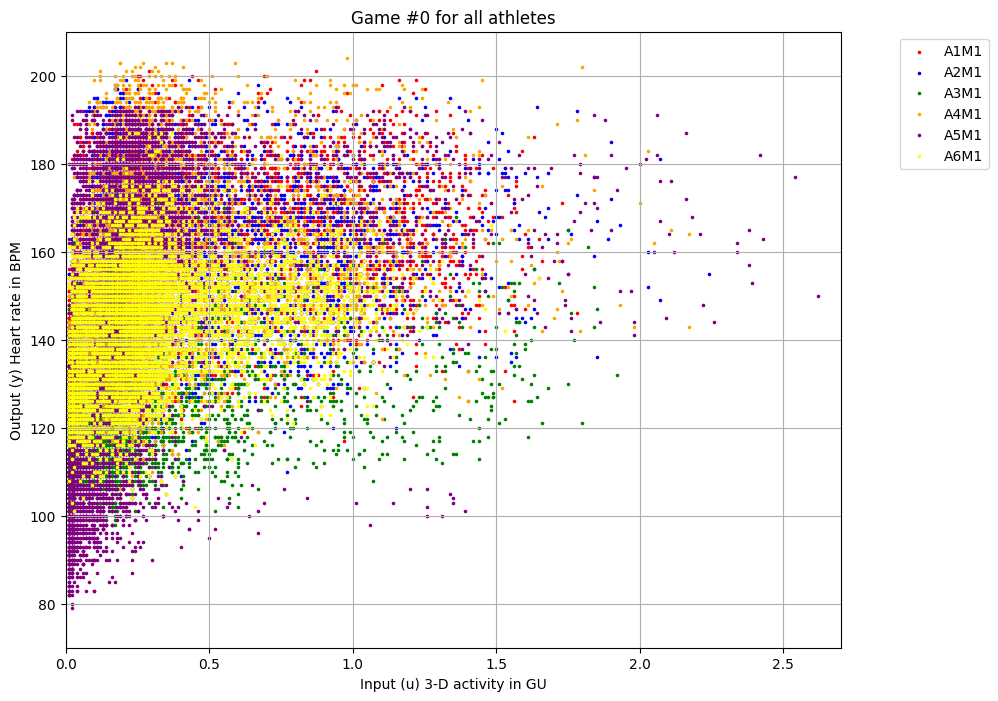

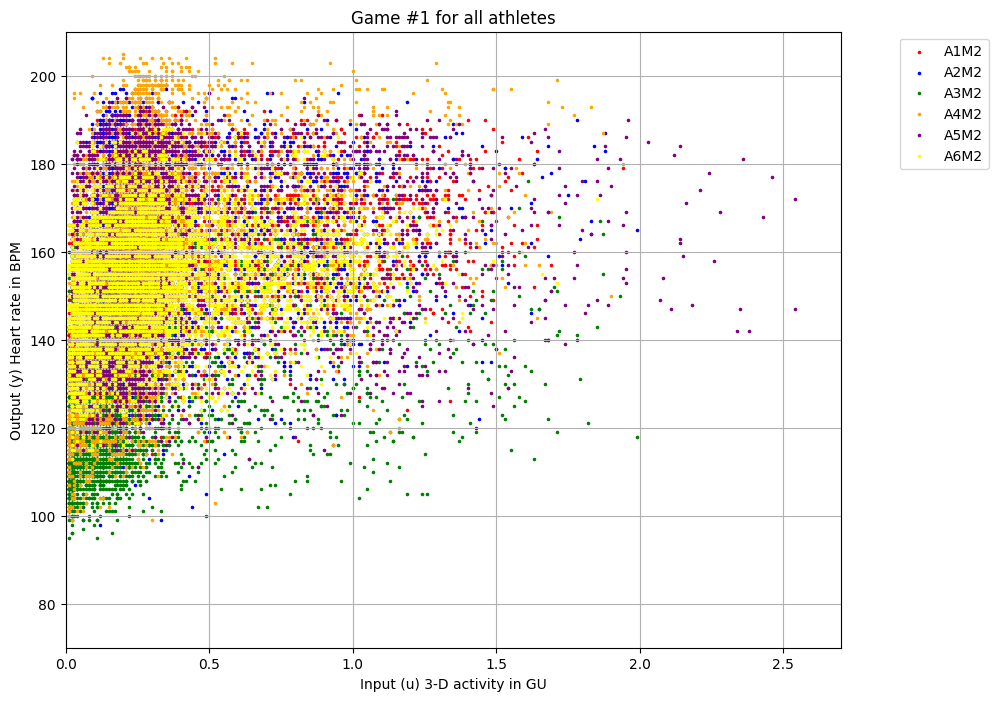

In [11]:
colors = ["Red", "Blue", "Green", "Orange", "Purple", "Yellow"] # Colors for each athlete
marker = '.'


for game in range(2):
    plt.figure(figsize=(10, 8))
    for athl in range(6):
        plt.scatter(athlete_list[athl*2+game]['u'], athlete_list[athl*2+game]['y'], label=code_name[athl*2+game], color=colors[athl], marker=marker, s=10)

    plt.xlabel(k_xlabel)
    plt.ylabel(k_ylabel)
    plt.axis( k_axis)
    plt.title(f'Game #{game} for all athletes')
    plt.legend(loc='upper right', bbox_to_anchor=(1.2, 1))
    plt.grid(True)
    plt.show()



### Plot data for both games of each player

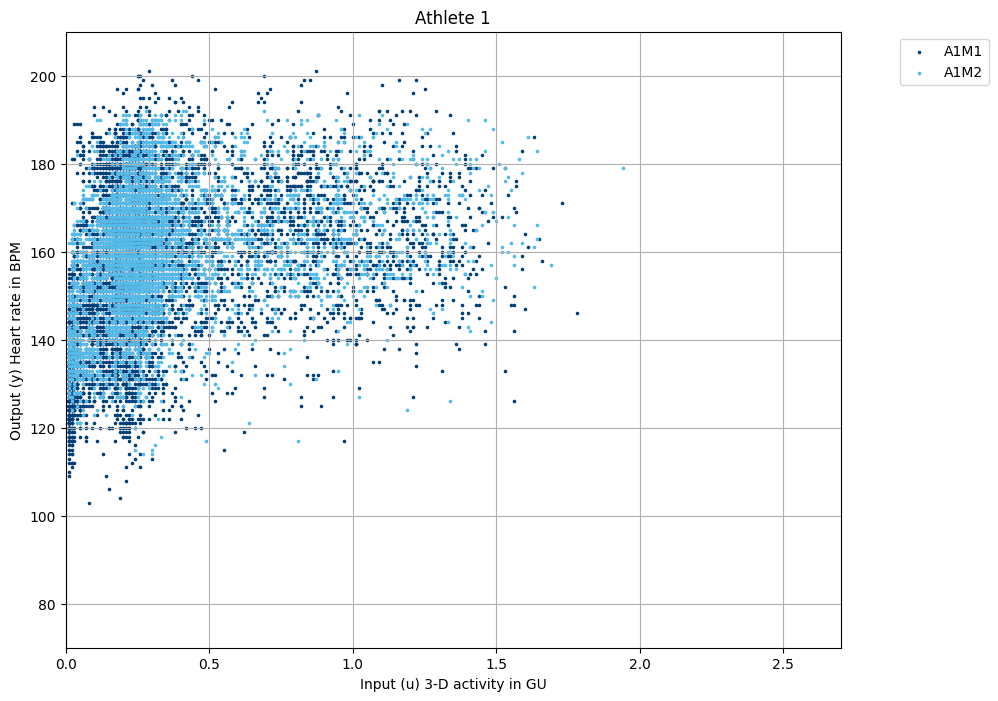

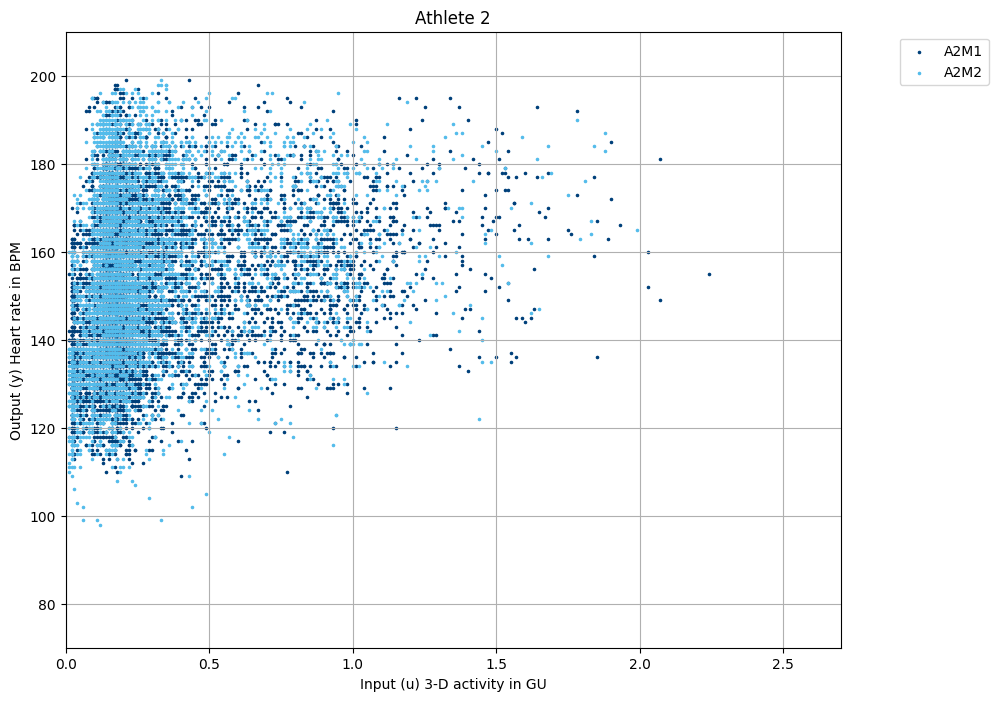

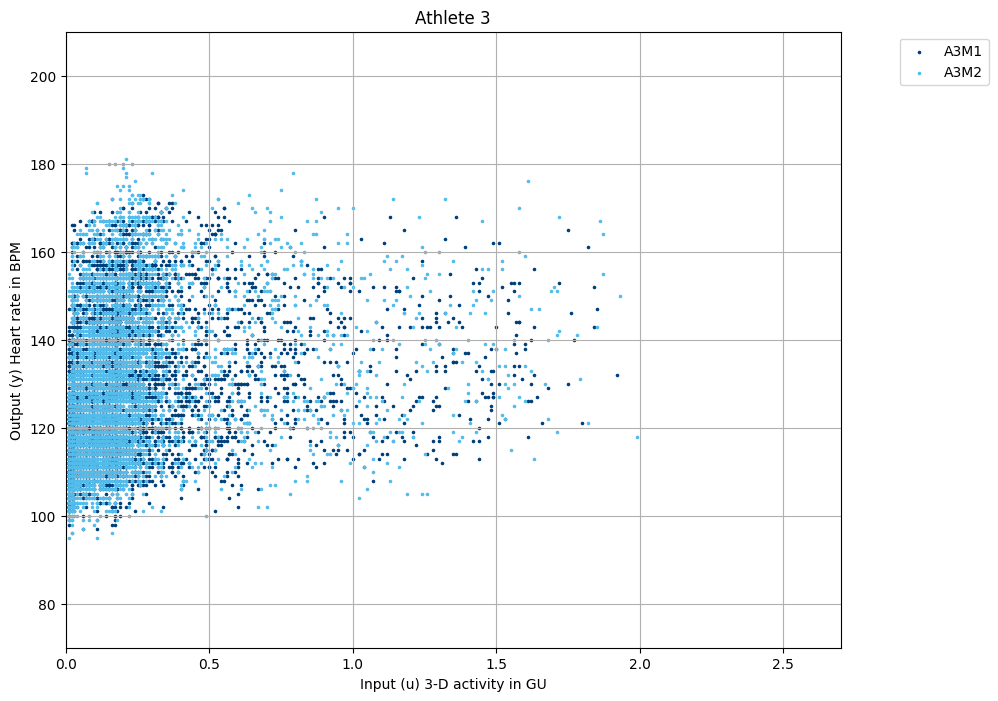

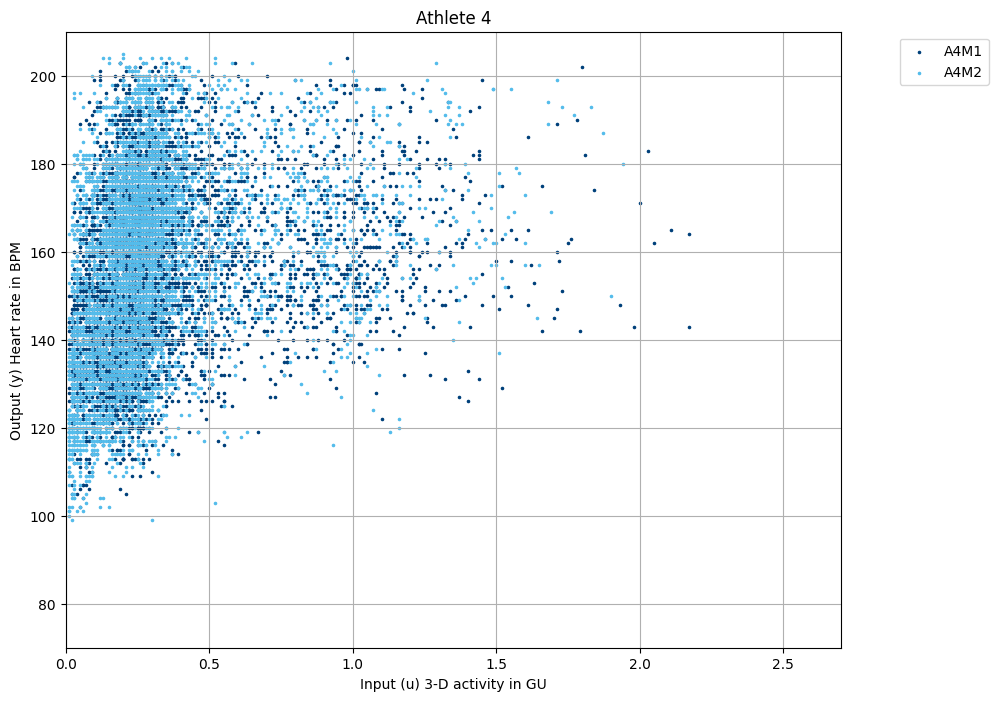

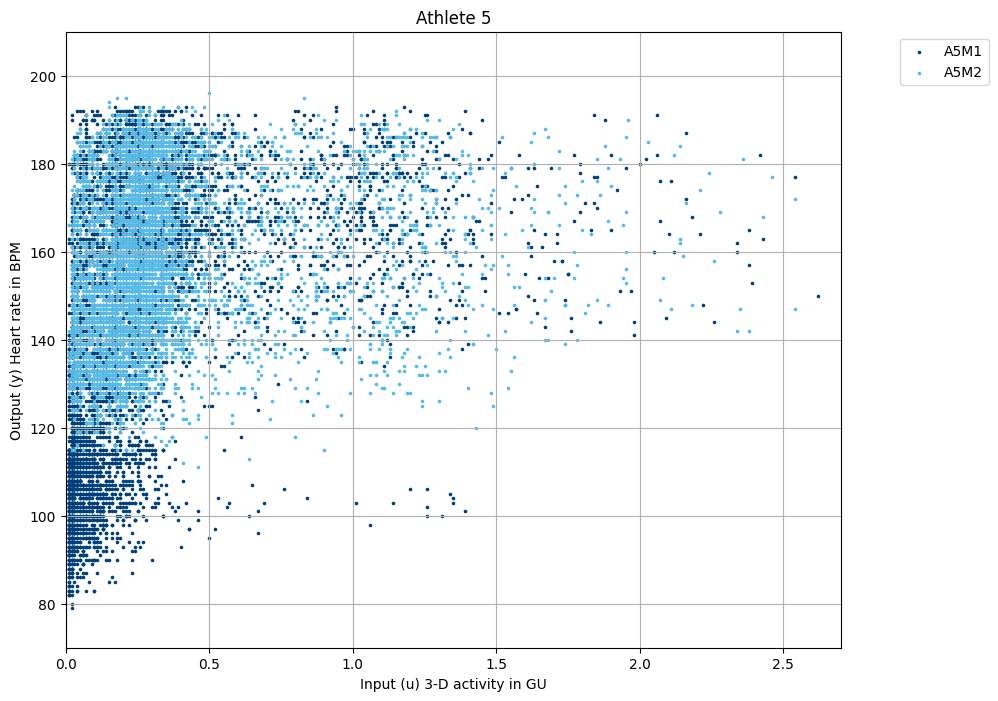

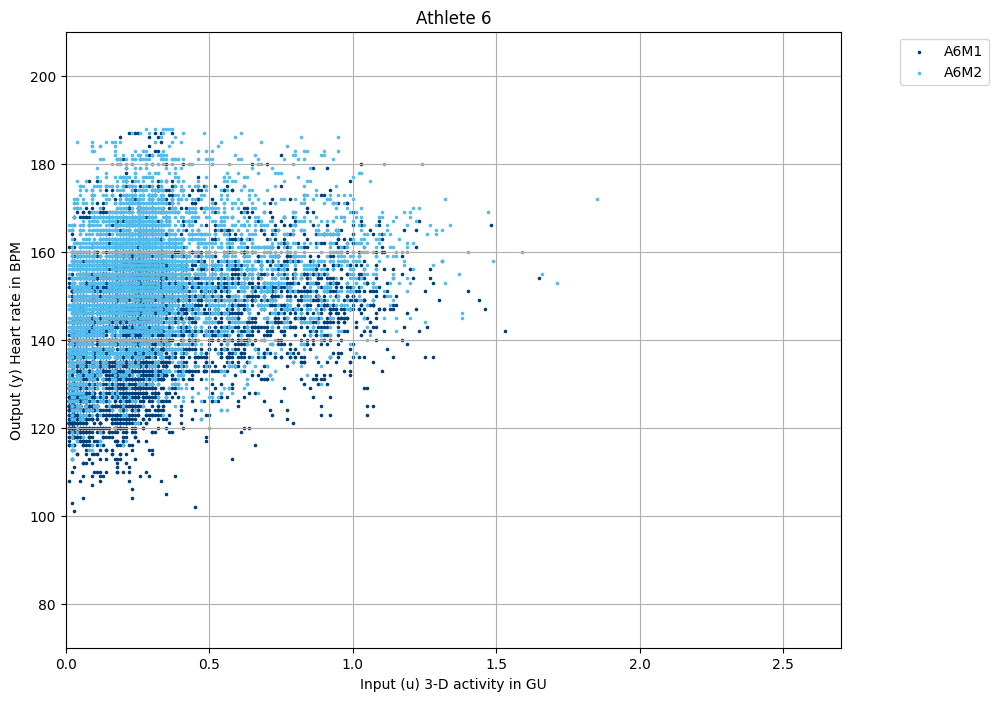

In [12]:
colors = ['green', 'red']  # Colors for each game of the athlete
colors = ["#00407A", '#54BCEB']  # KU Leuven!

marker = '.'

for athl in range(6):
    firstgame = athl * 2
    plt.figure(figsize=(10, 8));  # Create figure with desired size before plotting

    for game in range(2):
        plt.scatter(athlete_list[firstgame + game]['u'], athlete_list[firstgame + game]['y'], label=code_name[firstgame + game], color=colors[game], marker=marker, s=10)

    plt.xlabel(k_xlabel)
    plt.ylabel(k_ylabel)
    plt.axis(k_axis)

    plt.title(f'Athlete {athl + 1}')
    plt.legend(loc='upper right', bbox_to_anchor=(1.2, 1))
    plt.grid(True)

    plt.show()

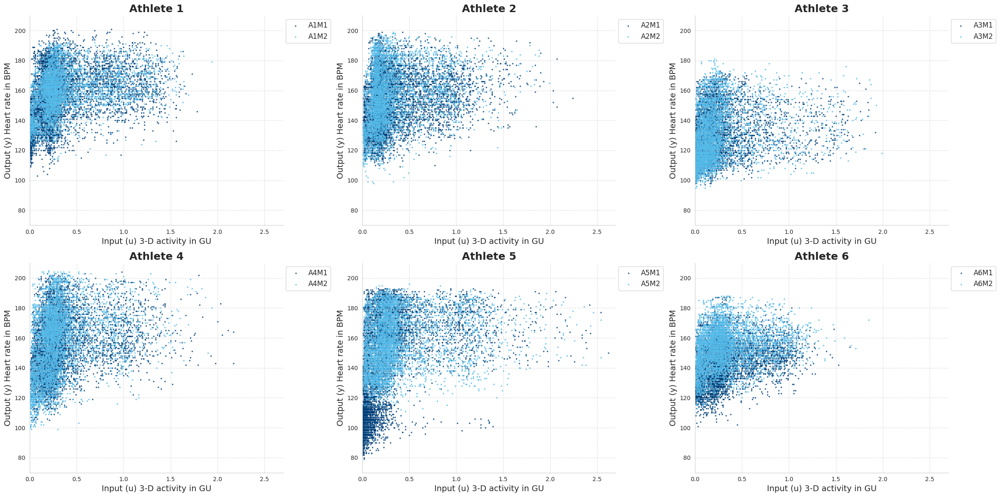

In [13]:
colors = ['green', 'red']  # Colors for each game of the athlete
colors = ["#00407A", '#54BCEB']  # KU Leuven!
marker = '.'

sns.set_style("whitegrid")  # Set a visually appealing style

fig, axes = plt.subplots(2, 3, figsize=(24, 12))  # Create a 3x2 grid of subplots

for athl in range(6):
    firstgame = athl * 2
    row = athl // 3  # Calculate row index
    col = athl % 3   # Calculate column index
    ax = axes[row, col]  # Get the current subplot

    for game in range(2):
        ax.scatter(athlete_list[firstgame + game]['u'], athlete_list[firstgame + game]['y'],
                   label=code_name[firstgame + game], color=colors[game], marker=marker, s=10, alpha=0.7)

    ax.set_xlabel(k_xlabel, fontsize=14)
    ax.set_ylabel(k_ylabel, fontsize=14)
    ax.axis(k_axis)

    ax.set_title(f'Athlete {athl + 1}', fontsize=18, fontweight='bold')
    ax.legend(loc='upper right', bbox_to_anchor=(1.2, 1), fontsize=12)
    ax.grid(True, linestyle='--', alpha=0.7)

    sns.despine(ax=ax)  # Remove spines for the current subplot
    plt.tight_layout()

plt.show()


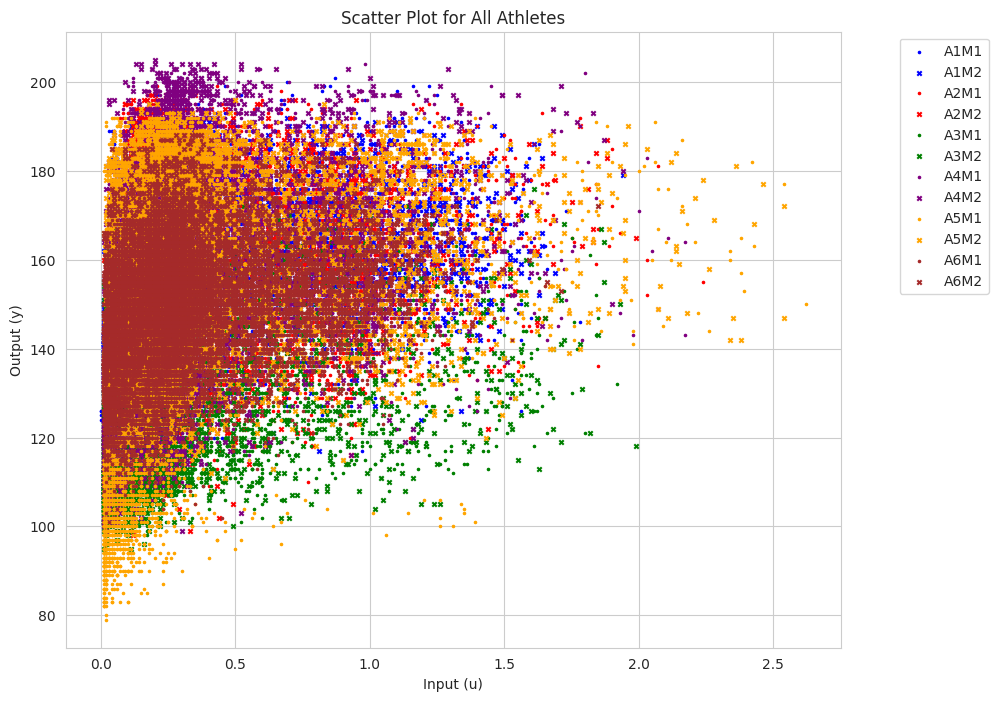

In [14]:

# Define colors and markers for each athlete
colors = ['blue', 'blue', 'red', 'red', 'green', 'green', 'purple', 'purple', 'orange', 'orange', 'brown', 'brown']
markers = ['.', 'x', '.', 'x', '.', 'x', '.', 'x', '.', 'x', '.', 'x']  # Dot for M1, x for M2


plt.figure(figsize=(10, 8))  # Adjust figure size as needed

# Iterate through datasets and create scatter plots with specified colors and markers
for i, dataset in enumerate(athlete_list):

    plt.scatter(dataset['u'], dataset['y'], label=code_name[i], color=colors[i], marker=markers[i], s=10)  # s controls marker size

plt.xlabel('Input (u)')
plt.ylabel('Output (y)')
plt.title('Scatter Plot for All Athletes')
plt.legend(loc='upper right', bbox_to_anchor=(1.2, 1)) # Adjust legend location if needed
plt.grid(True)
plt.show()

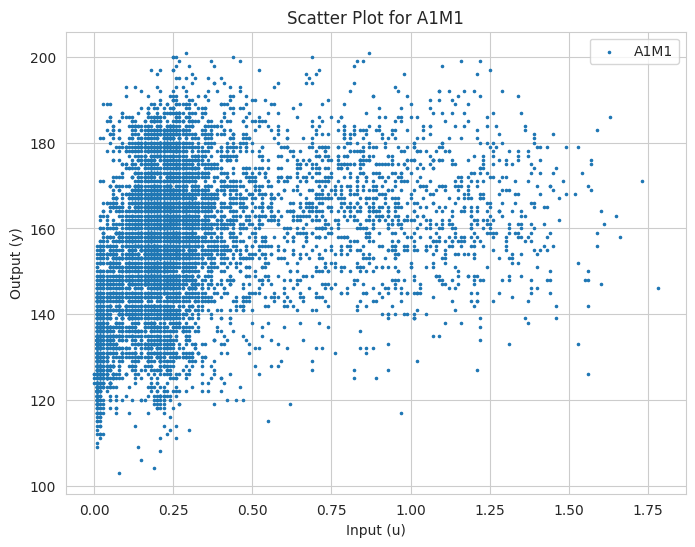

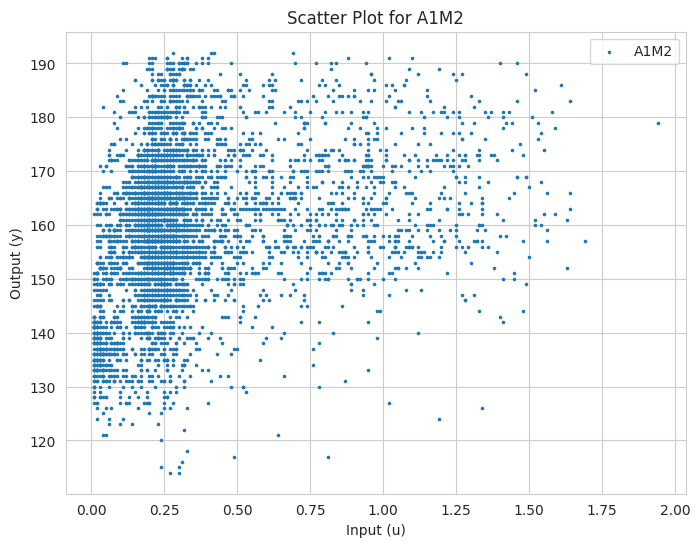

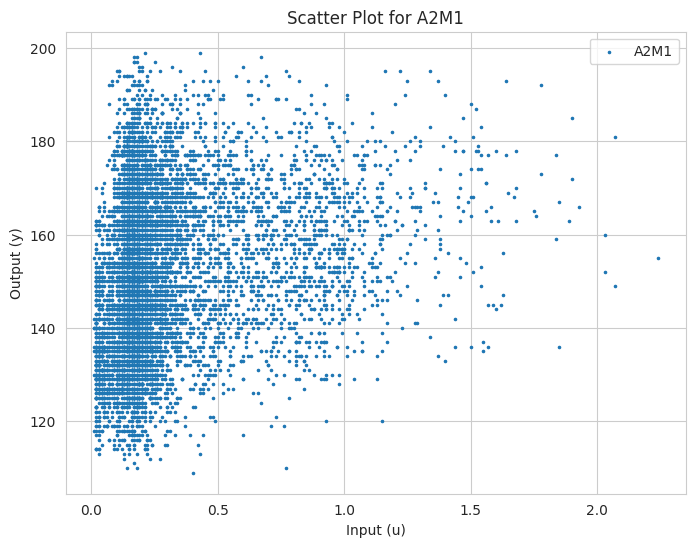

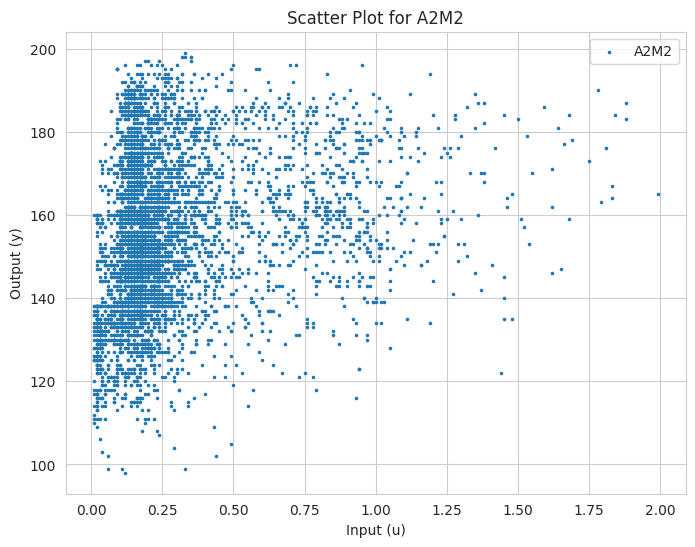

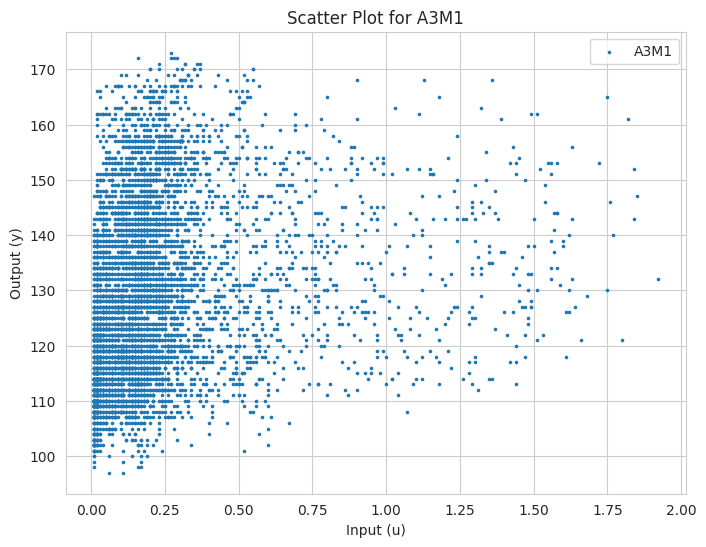

...

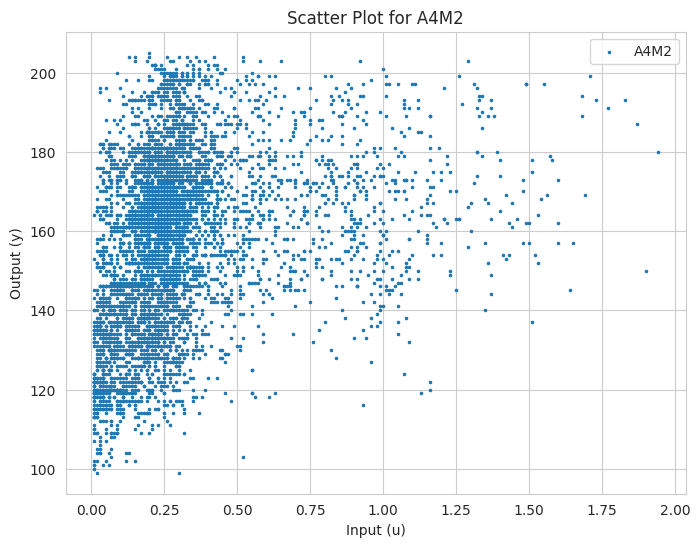

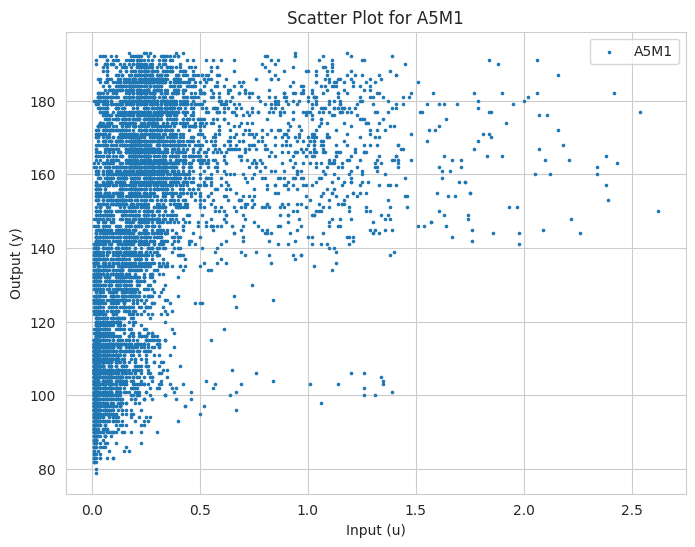

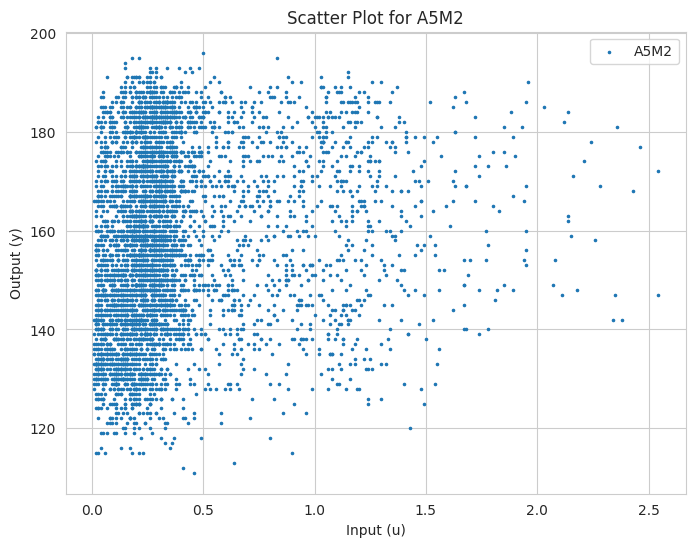

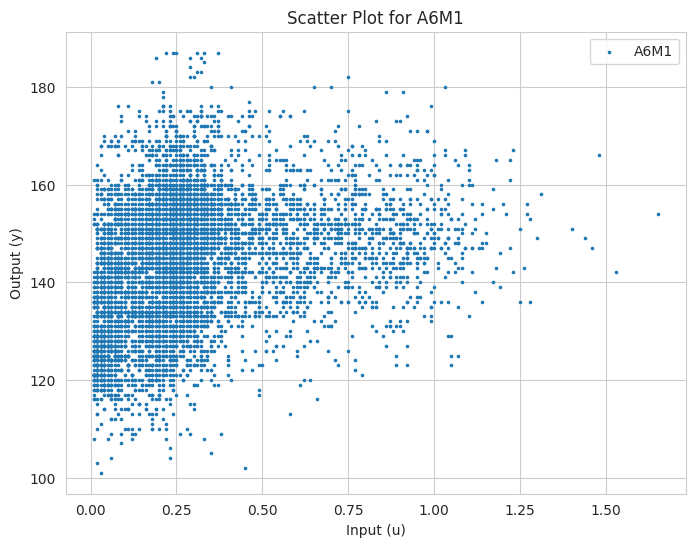

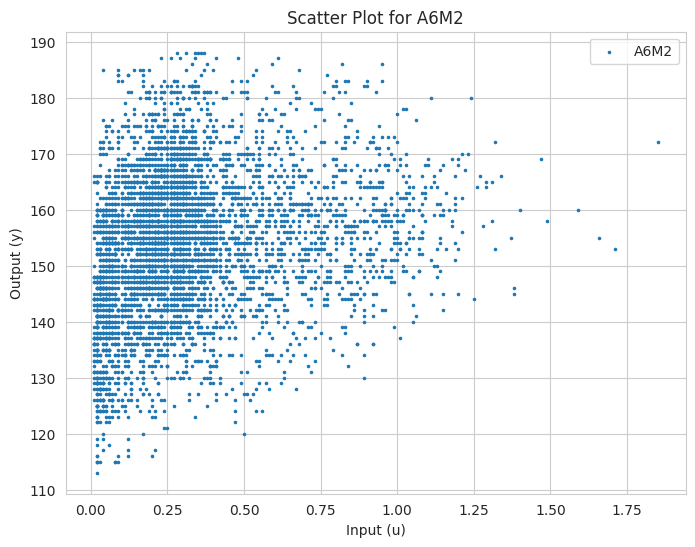

In [15]:
#scatter plot all dfs
#import matplotlib.pyplot as plt

# Iterate through the datasets and create scatter plots
for i, dataset in enumerate(athlete_list):
    plt.figure(figsize=(8, 6))  # Adjust figure size as needed
    plt.scatter(dataset['u'], dataset['y'], label=code_name[i], marker=".", s=10)
    plt.title(f'Scatter Plot for {code_name[i]}')
    plt.xlabel('Input (u)')
    plt.ylabel('Output (y)')
    plt.title(f'Scatter Plot for {code_name[i]}')
    plt.legend()
    plt.grid(True)
    plt.show()



## Data exploration - check the covariance

In [16]:
# Calculate and print individual covariance matrices
# for i, dataset in enumerate(athlete_list):
#     covariance_matrix = np.cov(dataset['u'], dataset['y'])
#     print(f"Covariance Matrix for {code_name[i]}:\n{covariance_matrix}\n")

# Create a table of covariances
covariance_data = []
for i, dataset in enumerate(athlete_list):
    covariance_matrix = np.cov(dataset['u'], dataset['y'])
    covariance_data.append([code_name[i], covariance_matrix[0, 1]])  # Extract covariance between 'u' and 'y'

covariance_table = pd.DataFrame(covariance_data, columns=['Athlete', 'Covariance'])
print("\nCovariance Table:\n", covariance_table)



Covariance Table:
    Athlete  Covariance
0     A1M1    1.662819
1     A1M2    1.283243
2     A2M1    1.207343
3     A2M2    1.255750
4     A3M1    0.975573
5     A3M2    1.348638
6     A4M1    1.355412
7     A4M2    1.899733
8     A5M1    3.938292
9     A5M2    1.133550
10    A6M1    0.957688
11    A6M2    0.802858


## Preprocessing

In [17]:
athlete_list[8]

,y,u
0,120,0.11
1,125,0.19
2,131,0.14
3,132,0.17
4,130,0.13
...,...,...
6818,100,0.12
6819,102,0.06
6820,103,0.04
6821,104,0.03


# TODO!
Here I still have to choose which line to keep for each axis; either the actual or the moving average.<br>
Or: That may just become parameters; if averagex > 1, moving average, else, just use x.
Same for y.

In [58]:
def chart_athlete_game(athlete=1, game=1, normalize_u=True, normalize_y=True):
    '''Graphically one athlete and one game.
    Data is normalized by subtracting the mean.

    Parameters:
    athlete - athlete number
    game - game number
    normalize - if True, subtract the mean from the data
    Return:
    None
    '''
    #Outliers
    dataset = athlete_list[(athlete-1)*2 + game-1].copy()
    # print("dataset")
    # print(dataset.head(10))
    # print("-----------")

    # print(f"u: mean(): {np.mean(dataset['u'])}, min(): {np.min(dataset['u'])}, max(): {np.max(dataset['u'])}")
    # print(f"y: mean(): {np.mean(dataset['y'])}, min(): {np.min(dataset['y'])}, max(): {np.max(dataset['y'])}")
    # print(f"U: mean(): {dataset['u'].mean()}, min(): {dataset['u'].min()}, max(): {dataset['u'].max()}")
    # print(f"Y: mean(): {dataset['y'].mean()}, min(): {dataset['y'].min()}, max(): {dataset['y'].max()}")

    # Center values around zero
    if normalize_u:
        dataset['u'] = dataset['u'] - np.mean(dataset['u'])
    if normalize_y:
        dataset['y'] = dataset['y'] - np.mean(dataset['y'])

    mov_avrg_u = dataset['u'].rolling(window=5, center=True, min_periods=1).mean()
    mov_avrg_y = dataset['y'].rolling(window=2, center=True, min_periods=1).mean()
    # print(f"mov_avrg_u: {mov_avrg_u}")
    # print(f"mov_avrg_y: {mov_avrg_y}")

    #result = mk.original_test(data)
    trend = mk.original_test(dataset['y'])
    #plot
    fig, ax1 = plt.subplots(figsize=(20, 6))

    ax1.set_xlabel('X-axis Time')
    ax1.set_ylabel('U1-axis Output', color='blue')
    ax1.tick_params('y', colors='blue')

    ax2 = ax1.twinx()
    #ax2.plot(dataset['u'], color='green', label='Input')
    ax2.plot(mov_avrg_u, color='orange', label='Mov-Mean_Input')

    ax2.set_ylabel('Y2-axis Input', color='green')
    ax2.tick_params('y', colors='green')


    # Compute the linear trend line
    x_values_trend = range(len(dataset['y']))  # Assuming x-values correspond to indices in the dataset
    linear_trend = [trend.slope * x + trend.intercept for x in x_values_trend]

    # Plot the real output and moving average
    #ax1.plot(dataset['y'], color='blue', label='Real Output')
    ax1.plot(mov_avrg_y, color='red', label='Mov-Mean Output')

    # Add the trend line
    #ax3 = ax1.twinx()
    ax1.plot(linear_trend, color='purple', linestyle='--', label='Trend', linewidth=2)
    # # Add the linear trend line
    #ax1.plot(x_values, linear_trend, color='purple', linestyle='--', label='Linear Trend (y = {:.4f}x + {:.2f})'.format(slope, intercept), linewidth=2)


    fig.legend(loc="upper right")
    ax1.set_title( f'Athlete {athlete} - Game {game}')
    fig.tight_layout()

    #return trend
    return


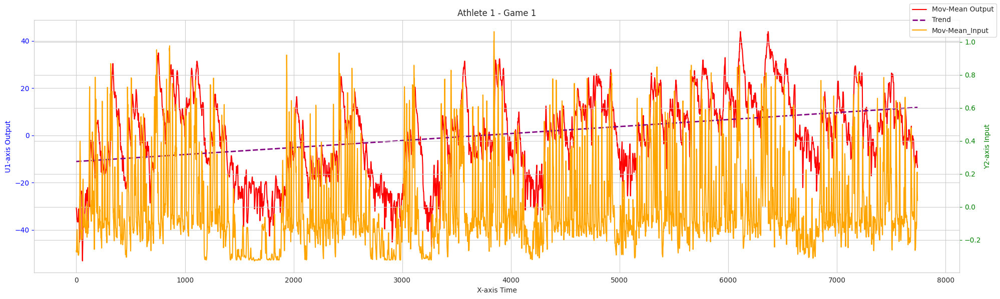

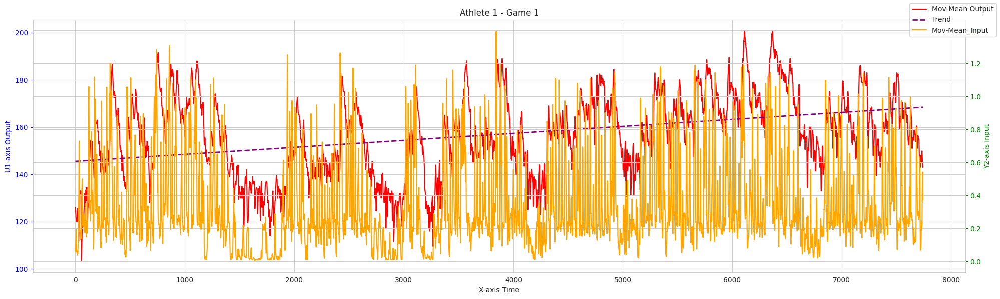

In [60]:
chart_athlete_game(athlete=1, game=1, normalize_u=True, normalize_y=True)
chart_athlete_game(athlete=1, game=1, normalize_u=False, normalize_y=False)



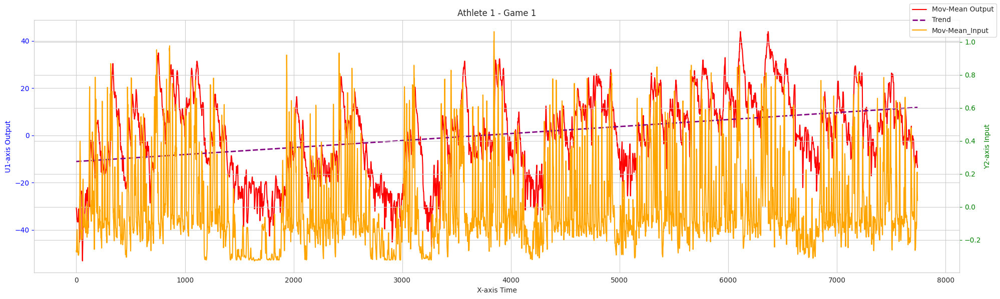

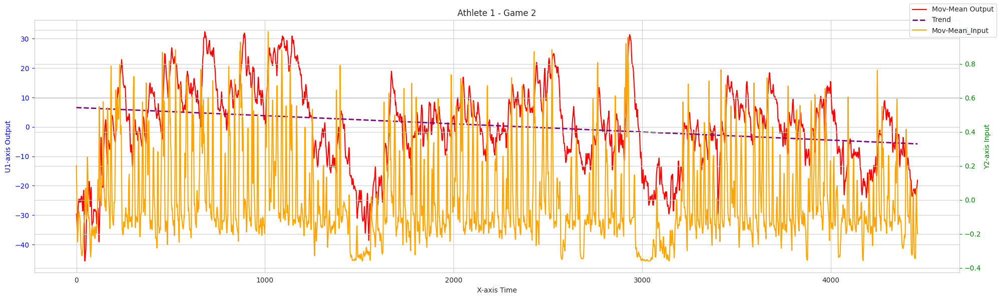

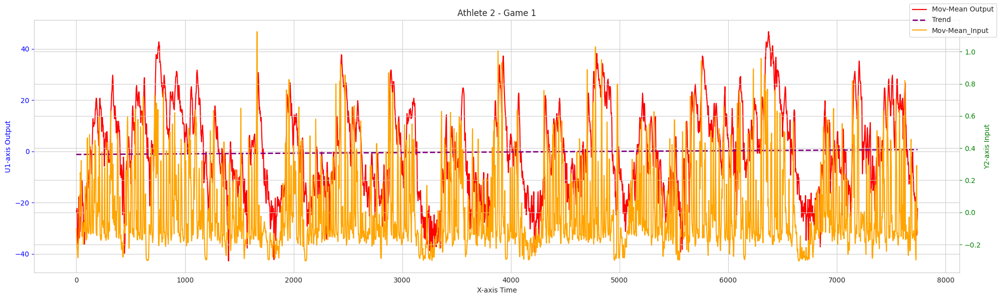

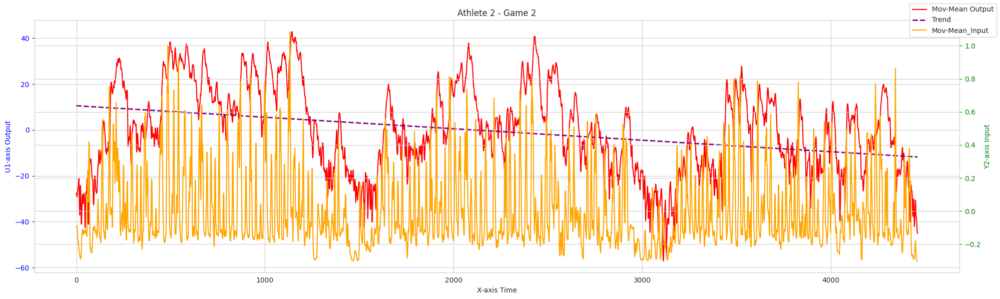

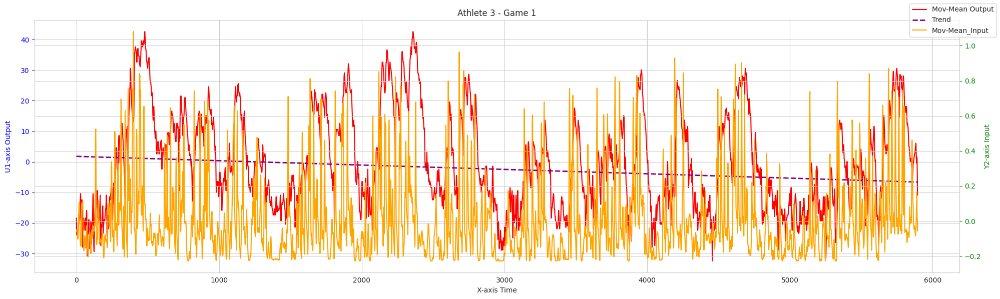

...

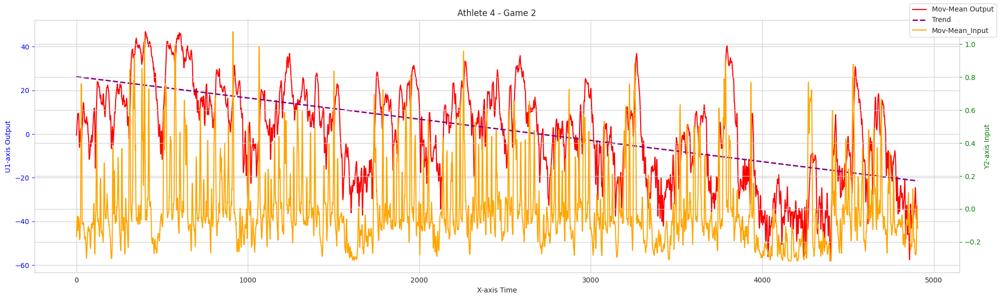

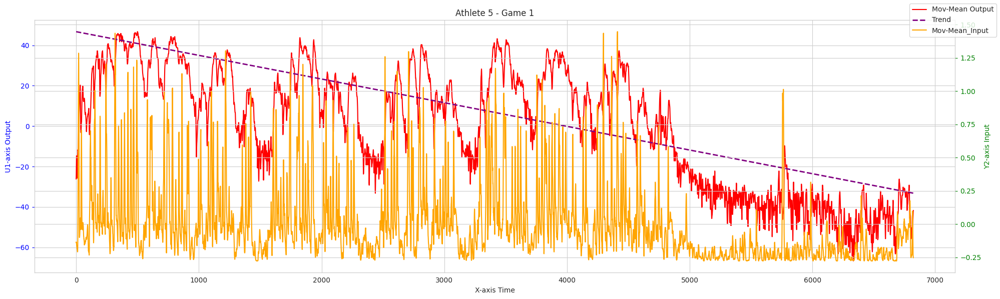

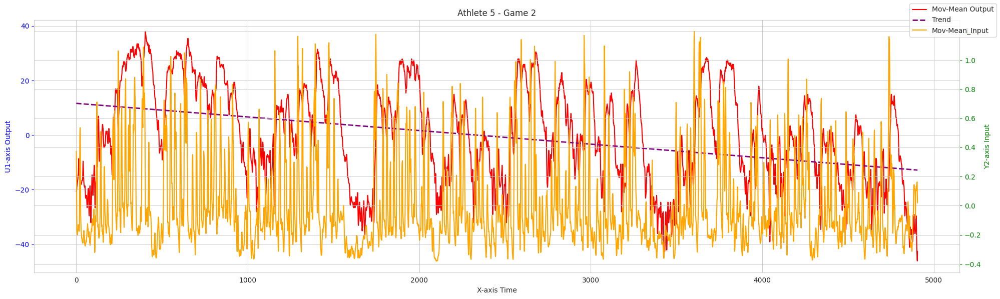

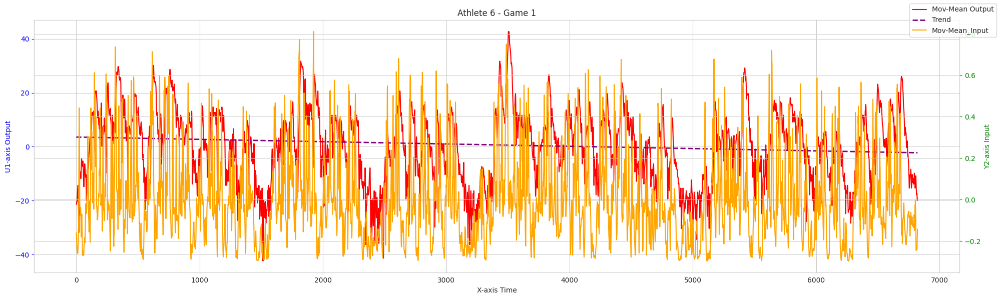

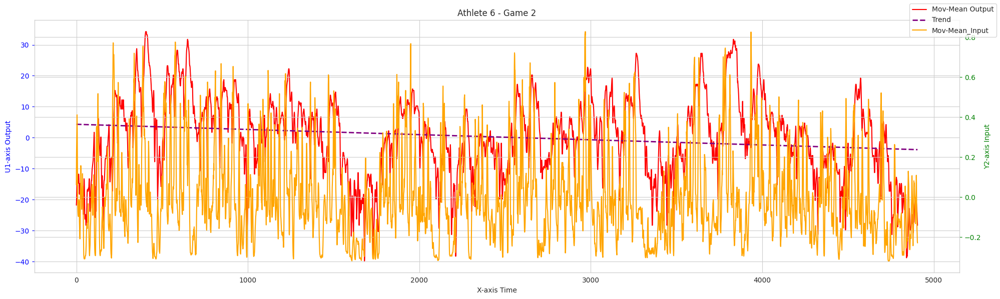

In [57]:
# ath=4, gm=0
for ath in range(1,7):
    for gm in range(1,3):
        chart_athlete_game(athlete=ath, game=gm)


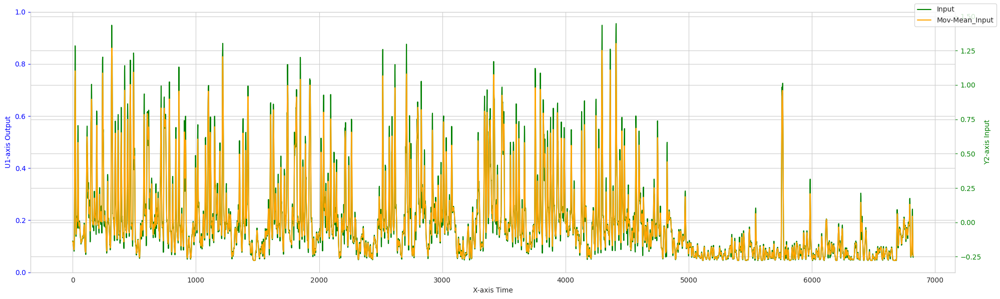

In [ ]:
#1ºData Preparation
#Pre-processing

#High frequency disturbances (too high measurement frequency -> Downsampling)
#1ºlow pass filter | 2º Downsampling


#Outliers
dataset = athlete_list[8]

dataset['u'] = dataset['u'] - np.mean(dataset['u'])
dataset['y'] = dataset['y'] - np.mean(dataset['y'])

mov_avrg_u = dataset['u'].rolling(window=5, center=True, min_periods=1).mean()
mov_avrg_y = dataset['y'].rolling(window=2, center=True, min_periods=1).mean()
#result = mk.original_test(data)
trend = mk.original_test(dataset['y'])
#plot
fig, ax1 = plt.subplots(figsize=(20, 6))

#ax1.plot(dataset['y'], color='blue', label='Real_Output')
#ax1.plot(mov_avrg_y, color='red', label='Mov-Mean-output')
ax1.set_xlabel('X-axis Time')
ax1.set_ylabel('U1-axis Output', color='blue')
ax1.tick_params('y', colors='blue')

ax2 = ax1.twinx()
ax2.plot(dataset['u'], color='green', label='Input')
ax2.plot(mov_avrg_u, color='orange', label='Mov-Mean_Input')

ax2.set_ylabel('Y2-axis Input', color='green')
ax2.tick_params('y', colors='green')

fig.legend(loc="upper right")
fig.tight_layout()


Athlete:(7743, 2)
athlete['u'] Max: 1.3940000000000006 Min: 0.004000000000000095
athlete['y'] Max: 97.5 Min: 0.5
Athlete:(4460, 2)
athlete['u'] Max: 1.348 Min: 0.0
athlete['y'] Max: 78.0 Min: 0.0
Athlete:(7743, 2)
athlete['u'] Max: 1.432 Min: 0.005999999999999911
athlete['y'] Max: 90.0 Min: 0.5
Athlete:(4460, 2)
athlete['u'] Max: 1.388 Min: 0.0019999999999998222
athlete['y'] Max: 100.5 Min: 0.5
Athlete:(5895, 2)
athlete['u'] Max: 1.3080000000000003 Min: 0.0
athlete['y'] Max: 75.0 Min: 0.0
Athlete:(4626, 2)
athlete['u'] Max: 1.2119999999999997 Min: 0.0
athlete['y'] Max: 85.5 Min: 0.5
Athlete:(6823, 2)
athlete['u'] Max: 1.3119999999999998 Min: 0.004000000000000178
athlete['y'] Max: 101.5 Min: 1.0
Athlete:(4906, 2)
athlete['u'] Max: 1.3920000000000001 Min: 0.0
athlete['y'] Max: 105.5 Min: 0.5
Athlete:(6823, 2)
athlete['u'] Max: 1.7240000000000006 Min: 0.0
athlete['y'] Max: 114.0 Min: 0.5
Athlete:(4906, 2)
athlete['u'] Max: 1.5780000000000007 Min: 0.00400000000000071
athlete['y'] Max: 84.5

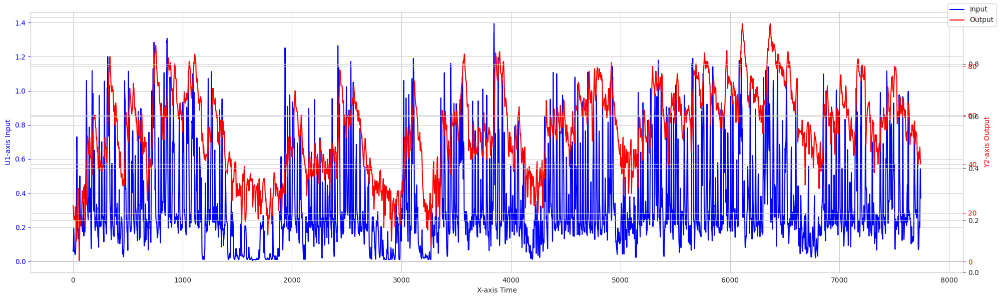

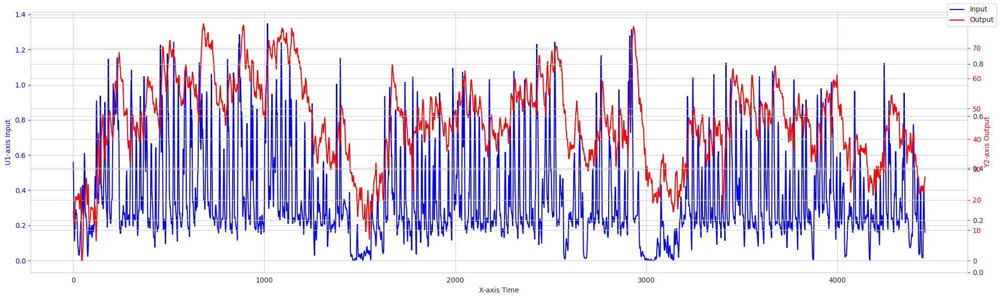

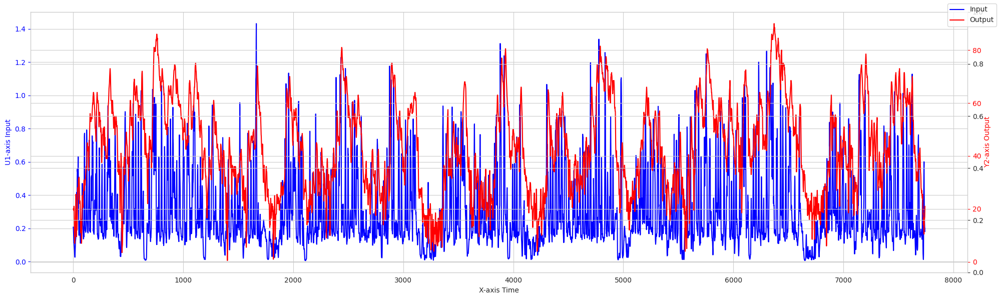

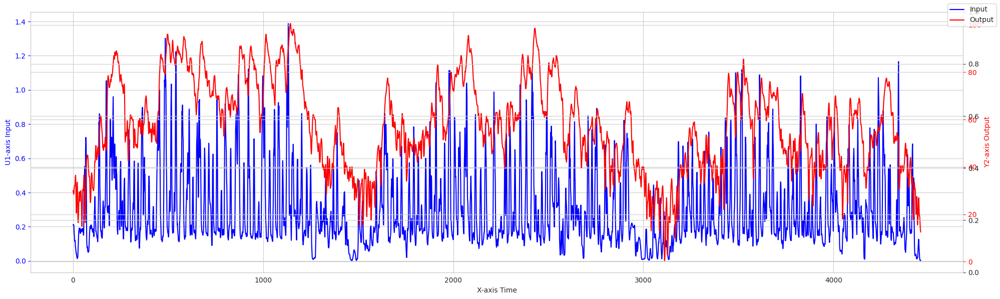

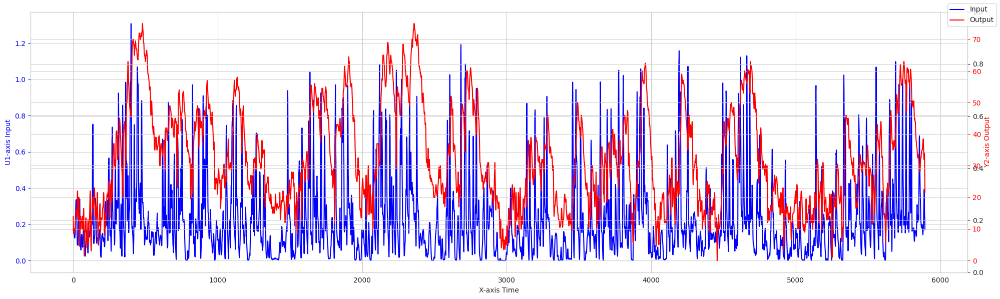

...

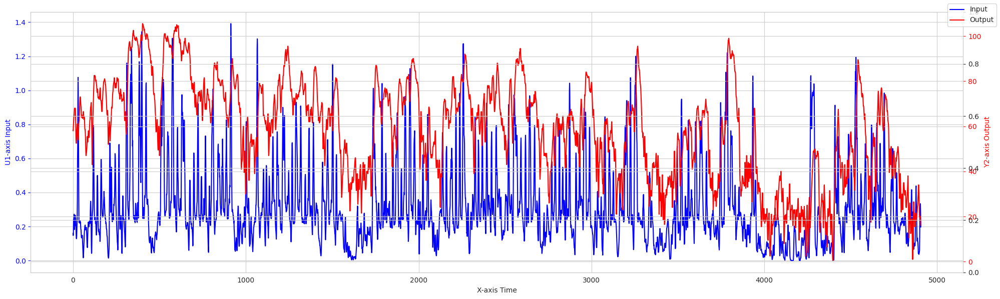

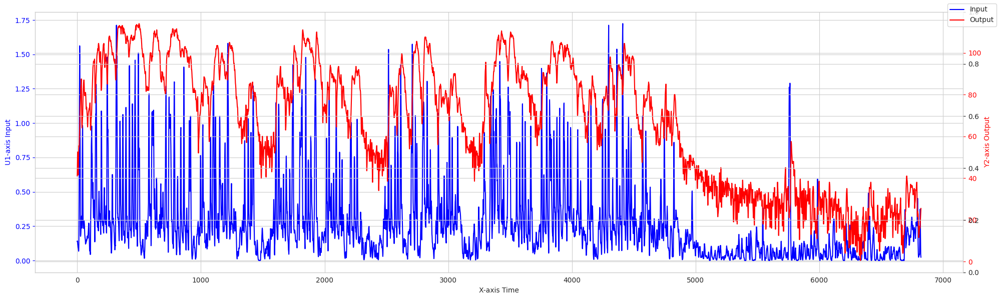

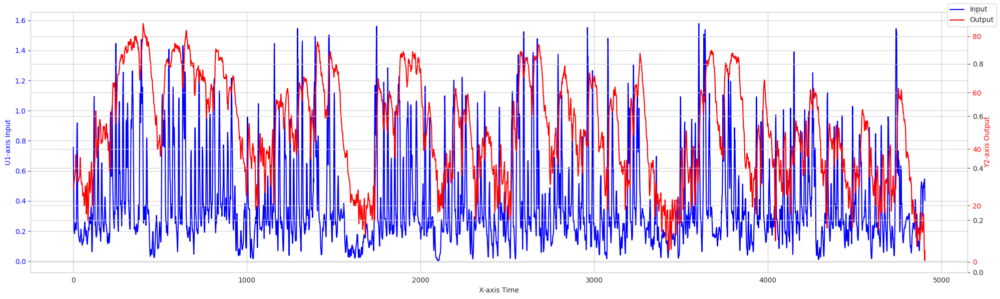

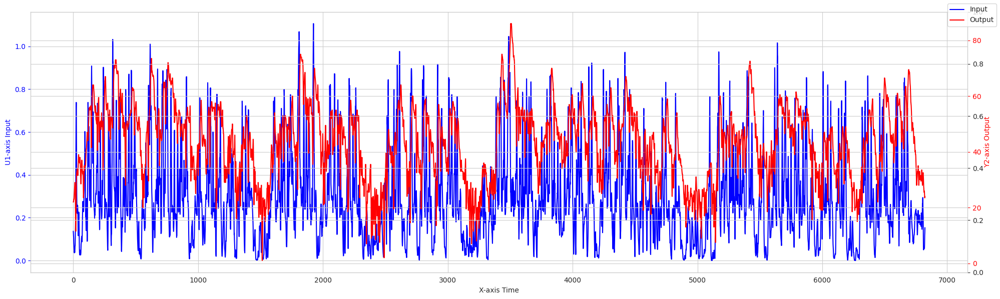

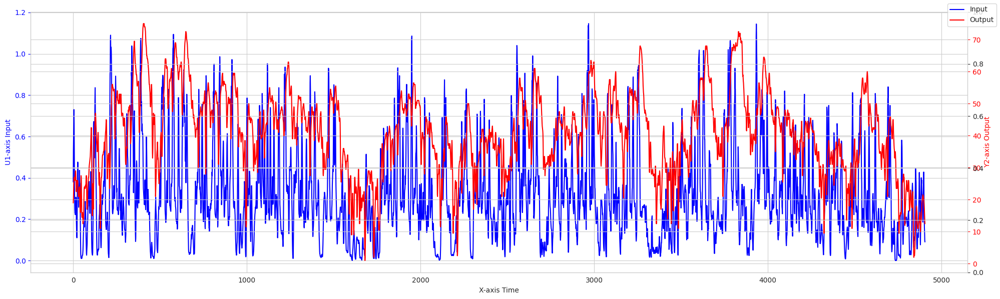

In [ ]:
#1ºData Preparation
#Pre-processing && Ploting
limit = 0
for athlete in athlete_list:
  #Start all values at Zero
  print(f"Athlete:{athlete.shape}")
  #athlete['u'] = athlete['u'] - athlete['u'][0]
  #athlete['y'] = athlete['y'] - athlete['y'][0]

  athlete['u'] = athlete['u'] - athlete['u'].min()
  athlete['y'] = athlete['y'] - athlete['y'].min()

  athlete['u'] = athlete['u'].rolling(window=5, center=True, min_periods=1).mean()
  athlete['y'] = athlete['y'].rolling(window=2, center=True, min_periods=1).mean()


  #Ploting using two axis with different scales
  fig, ax1 = plt.subplots(figsize=(20, 6))
  ax1.plot(athlete['u'], color='blue', label='Input')
  ax1.set_xlabel('X-axis Time')
  ax1.set_ylabel('U1-axis Input', color='blue')
  ax1.tick_params('y', colors='blue')
  ax2 = ax1.twinx()
  print("athlete['u']",'Max:',athlete['u'].max(),'Min:',athlete['u'].min())
  print("athlete['y']",'Max:',athlete['y'].max(),'Min:',athlete['y'].min())

  #trend = mk.original_test(athlete['y'])
  ax3 = ax1.twinx()
  #ax3.plot(trend, color='green', label='Output')

  '''  if athlete.shape[0] == 7743 and limit == 0:
    print("tEAWDAWDrue")
    athlete_list[0]['u'] = athlete['u']
    athlete_list[0]['y'] = athlete['y']
    limit +=+ 1'''
  #y_mean = np.mean(athlete['y'])
  #print("Mean of y:", y_mean)
  #print("Variance of y:", np.var(y))
  ax2.plot(athlete['y'], color='red', label='Output')
  ax2.set_ylabel('Y2-axis Output', color='red')
  ax2.tick_params('y', colors='red')
  fig.legend(loc="upper right")
  fig.tight_layout()


In [ ]:
#Smoothing the Data
#capture important patterns in the data, while leaving out noise or other fine-scale structures/rapid phenomena.

## 2º System Identification

Athlete: A1M1

Model #0 Dataset:A1M1 
with 0 a parameters, 1 b parameters and 0 time delay
        u-0
0  0.066667
1  0.057500
2  0.058000
3  0.086000
4  0.110000
5  0.146000
6  0.182000
7  0.194000
8  0.164000
9  0.144000
New X:
     u-0
2  0.058
3  0.086
4  0.110
5  0.146
6  0.182

Model with 0 a parameters, 1 b parameters and 0 time delay
        u-0
0  0.066667
1  0.057500
2  0.058000
3  0.086000
4  0.110000
5  0.146000
6  0.182000
7  0.194000
8  0.164000
9  0.144000
New X:
     u-0
2  0.058
3  0.086
4  0.110
5  0.146
6  0.182
its regression yield r squared: -2.646507869999436, Akaike's information criteria: 10018.367043276934

Model #1 Dataset:A1M1 
with 0 a parameters, 1 b parameters and 1 time delay
        u-1
0       NaN
1  0.066667
2  0.057500
3  0.058000
4  0.086000
5  0.110000
6  0.146000
7  0.182000
8  0.194000
9  0.164000
New X:


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-34-fae883fd573d>:52: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  results_df = pd.concat([results_df, new_row], ignore_index=True)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


     u-1
4  0.086
5  0.110
6  0.146
7  0.182
8  0.194

Model with 0 a parameters, 1 b parameters and 1 time delay
        u-1
0       NaN
1  0.066667
2  0.057500
3  0.058000
4  0.086000
5  0.110000
6  0.146000
7  0.182000
8  0.194000
9  0.164000
New X:
     u-1
4  0.086
5  0.110
6  0.146
7  0.182
8  0.194
its regression yield r squared: -2.5619477306342553, Akaike's information criteria: 9835.450439536073

Model #2 Dataset:A1M1 
with 0 a parameters, 1 b parameters and 2 time delay
        u-2
0       NaN
1       NaN
2  0.066667
3  0.057500
4  0.058000
5  0.086000
6  0.110000
7  0.146000
8  0.182000
9  0.194000
New X:
      u-2
6   0.110
7   0.146
8   0.182
9   0.194
10  0.164

Model with 0 a parameters, 1 b parameters and 2 time delay
        u-2
0       NaN
1       NaN
2  0.066667
3  0.057500
4  0.058000
5  0.086000
6  0.110000
7  0.146000
8  0.182000
9  0.194000
New X:
      u-2
6   0.110
7   0.146
8   0.182
9   0.194
10  0.164


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.4760005860799175, Akaike's information criteria: 9645.129590322837

Model #3 Dataset:A1M1 
with 0 a parameters, 1 b parameters and 3 time delay
        u-3
0       NaN
1       NaN
2       NaN
3  0.066667
4  0.057500
5  0.058000
6  0.086000
7  0.110000
8  0.146000
9  0.182000
New X:
      u-3
8   0.146
9   0.182
10  0.194
11  0.164
12  0.144

Model with 0 a parameters, 1 b parameters and 3 time delay
        u-3
0       NaN
1       NaN
2       NaN
3  0.066667
4  0.057500
5  0.058000
6  0.086000
7  0.110000
8  0.146000
9  0.182000
New X:
      u-3
8   0.146
9   0.182
10  0.194
11  0.164
12  0.144


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.394949755194794, Akaike's information criteria: 9461.294271137516

Model #4 Dataset:A1M1 
with 0 a parameters, 1 b parameters and 4 time delay
        u-4
0       NaN
1       NaN
2       NaN
3       NaN
4  0.066667
5  0.057500
6  0.058000
7  0.086000
8  0.110000
9  0.146000
New X:
      u-4
10  0.182
11  0.194
12  0.164
13  0.144
14  0.112

Model with 0 a parameters, 1 b parameters and 4 time delay
        u-4
0       NaN
1       NaN
2       NaN
3       NaN
4  0.066667
5  0.057500
6  0.058000
7  0.086000
8  0.110000
9  0.146000
New X:
      u-4
10  0.182
11  0.194
12  0.164
13  0.144
14  0.112
its regression yield r squared: -2.3246057838997696, Akaike's information criteria: 9298.054857034234

Model #5 Dataset:A1M1 
with 0 a parameters, 2 b parameters and 0 time delay
        u-0       u-1
0  0.066667       NaN
1  0.057500  0.066667
2  0.058000  0.057500
3  0.086000  0.058000
4  0.110000  0.086000
5  0.146000  0.110000
6  0.182000  0.146000
7  0.1940

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.361271589707112, Akaike's information criteria: 9388.564101500608

Model #6 Dataset:A1M1 
with 0 a parameters, 2 b parameters and 1 time delay
        u-1       u-2
0       NaN       NaN
1  0.066667       NaN
2  0.057500  0.066667
3  0.058000  0.057500
4  0.086000  0.058000
5  0.110000  0.086000
6  0.146000  0.110000
7  0.182000  0.146000
8  0.194000  0.182000
9  0.164000  0.194000
New X:
      u-1    u-2
6   0.146  0.110
7   0.182  0.146
8   0.194  0.182
9   0.164  0.194
10  0.144  0.164

Model with 0 a parameters, 2 b parameters and 1 time delay
        u-1       u-2
0       NaN       NaN
1  0.066667       NaN
2  0.057500  0.066667
3  0.058000  0.057500
4  0.086000  0.058000
5  0.110000  0.086000
6  0.146000  0.110000
7  0.182000  0.146000
8  0.194000  0.182000
9  0.164000  0.194000
New X:
      u-1    u-2
6   0.146  0.110
7   0.182  0.146
8   0.194  0.182
9   0.164  0.194
10  0.144  0.164


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.2772211105163453, Akaike's information criteria: 9191.347808540935

Model #7 Dataset:A1M1 
with 0 a parameters, 2 b parameters and 2 time delay
        u-2       u-3
0       NaN       NaN
1       NaN       NaN
2  0.066667       NaN
3  0.057500  0.066667
4  0.058000  0.057500
5  0.086000  0.058000
6  0.110000  0.086000
7  0.146000  0.110000
8  0.182000  0.146000
9  0.194000  0.182000
New X:
      u-2    u-3
8   0.182  0.146
9   0.194  0.182
10  0.164  0.194
11  0.144  0.164
12  0.112  0.144

Model with 0 a parameters, 2 b parameters and 2 time delay
        u-2       u-3
0       NaN       NaN
1       NaN       NaN
2  0.066667       NaN
3  0.057500  0.066667
4  0.058000  0.057500
5  0.086000  0.058000
6  0.110000  0.086000
7  0.146000  0.110000
8  0.182000  0.146000
9  0.194000  0.182000
New X:
      u-2    u-3
8   0.182  0.146
9   0.194  0.182
10  0.164  0.194
11  0.144  0.164
12  0.112  0.144


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.1981565993747454, Akaike's information criteria: 9001.164683306446

Model #8 Dataset:A1M1 
with 0 a parameters, 2 b parameters and 3 time delay
        u-3       u-4
0       NaN       NaN
1       NaN       NaN
2       NaN       NaN
3  0.066667       NaN
4  0.057500  0.066667
5  0.058000  0.057500
6  0.086000  0.058000
7  0.110000  0.086000
8  0.146000  0.110000
9  0.182000  0.146000
New X:
      u-3    u-4
10  0.194  0.182
11  0.164  0.194
12  0.144  0.164
13  0.112  0.144
14  0.074  0.112

Model with 0 a parameters, 2 b parameters and 3 time delay
        u-3       u-4
0       NaN       NaN
1       NaN       NaN
2       NaN       NaN
3  0.066667       NaN
4  0.057500  0.066667
5  0.058000  0.057500
6  0.086000  0.058000
7  0.110000  0.086000
8  0.146000  0.110000
9  0.182000  0.146000
New X:
      u-3    u-4
10  0.194  0.182
11  0.164  0.194
12  0.144  0.164
13  0.112  0.144
14  0.074  0.112


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.128114509051194, Akaike's information criteria: 8828.65066552897

Model #9 Dataset:A1M1 
with 0 a parameters, 2 b parameters and 4 time delay
        u-4       u-5
0       NaN       NaN
1       NaN       NaN
2       NaN       NaN
3       NaN       NaN
4  0.066667       NaN
5  0.057500  0.066667
6  0.058000  0.057500
7  0.086000  0.058000
8  0.110000  0.086000
9  0.146000  0.110000
New X:
      u-4    u-5
12  0.164  0.194
13  0.144  0.164
14  0.112  0.144
15  0.074  0.112
16  0.058  0.074

Model with 0 a parameters, 2 b parameters and 4 time delay
        u-4       u-5
0       NaN       NaN
1       NaN       NaN
2       NaN       NaN
3       NaN       NaN
4  0.066667       NaN
5  0.057500  0.066667
6  0.058000  0.057500
7  0.086000  0.058000
8  0.110000  0.086000
9  0.146000  0.110000
New X:
      u-4    u-5
12  0.164  0.194
13  0.144  0.164
14  0.112  0.144
15  0.074  0.112
16  0.058  0.074


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.068037924810121, Akaike's information criteria: 8677.472900327006

Model #10 Dataset:A1M1 
with 0 a parameters, 3 b parameters and 0 time delay
        u-0       u-1       u-2
0  0.066667       NaN       NaN
1  0.057500  0.066667       NaN
2  0.058000  0.057500  0.066667
3  0.086000  0.058000  0.057500
4  0.110000  0.086000  0.058000
5  0.146000  0.110000  0.086000
6  0.182000  0.146000  0.110000
7  0.194000  0.182000  0.146000
8  0.164000  0.194000  0.182000
9  0.144000  0.164000  0.194000
New X:
      u-0    u-1    u-2
6   0.182  0.146  0.110
7   0.194  0.182  0.146
8   0.164  0.194  0.182
9   0.144  0.164  0.194
10  0.112  0.144  0.164

Model with 0 a parameters, 3 b parameters and 0 time delay
        u-0       u-1       u-2
0  0.066667       NaN       NaN
1  0.057500  0.066667       NaN
2  0.058000  0.057500  0.066667
3  0.086000  0.058000  0.057500
4  0.110000  0.086000  0.058000
5  0.146000  0.110000  0.086000
6  0.182000  0.146000  0.110000
7 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.398809200648542, Akaike's information criteria: 9475.310546232115

Model #11 Dataset:A1M1 
with 0 a parameters, 3 b parameters and 1 time delay
        u-1       u-2       u-3
0       NaN       NaN       NaN
1  0.066667       NaN       NaN
2  0.057500  0.066667       NaN
3  0.058000  0.057500  0.066667
4  0.086000  0.058000  0.057500
5  0.110000  0.086000  0.058000
6  0.146000  0.110000  0.086000
7  0.182000  0.146000  0.110000
8  0.194000  0.182000  0.146000
9  0.164000  0.194000  0.182000
New X:
      u-1    u-2    u-3
8   0.194  0.182  0.146
9   0.164  0.194  0.182
10  0.144  0.164  0.194
11  0.112  0.144  0.164
12  0.074  0.112  0.144

Model with 0 a parameters, 3 b parameters and 1 time delay
        u-1       u-2       u-3
0       NaN       NaN       NaN
1  0.066667       NaN       NaN
2  0.057500  0.066667       NaN
3  0.058000  0.057500  0.066667
4  0.086000  0.058000  0.057500
5  0.110000  0.086000  0.058000
6  0.146000  0.110000  0.086000
7 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.31868743127294, Akaike's information criteria: 9289.467220777142

Model #12 Dataset:A1M1 
with 0 a parameters, 3 b parameters and 2 time delay
        u-2       u-3       u-4
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2  0.066667       NaN       NaN
3  0.057500  0.066667       NaN
4  0.058000  0.057500  0.066667
5  0.086000  0.058000  0.057500
6  0.110000  0.086000  0.058000
7  0.146000  0.110000  0.086000
8  0.182000  0.146000  0.110000
9  0.194000  0.182000  0.146000
New X:
      u-2    u-3    u-4
10  0.164  0.194  0.182
11  0.144  0.164  0.194
12  0.112  0.144  0.164
13  0.074  0.112  0.144
14  0.058  0.074  0.112

Model with 0 a parameters, 3 b parameters and 2 time delay
        u-2       u-3       u-4
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2  0.066667       NaN       NaN
3  0.057500  0.066667       NaN
4  0.058000  0.057500  0.066667
5  0.086000  0.058000  0.057500
6  0.110000  0.086000  0.058000
7  

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.2306307645859578, Akaike's information criteria: 9080.177731436132

Model #13 Dataset:A1M1 
with 0 a parameters, 3 b parameters and 3 time delay
        u-3       u-4       u-5
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3  0.066667       NaN       NaN
4  0.057500  0.066667       NaN
5  0.058000  0.057500  0.066667
6  0.086000  0.058000  0.057500
7  0.110000  0.086000  0.058000
8  0.146000  0.110000  0.086000
9  0.182000  0.146000  0.110000
New X:
      u-3    u-4    u-5
12  0.144  0.164  0.194
13  0.112  0.144  0.164
14  0.074  0.112  0.144
15  0.058  0.074  0.112
16  0.064  0.058  0.074

Model with 0 a parameters, 3 b parameters and 3 time delay
        u-3       u-4       u-5
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3  0.066667       NaN       NaN
4  0.057500  0.066667       NaN
5  0.058000  0.057500  0.066667
6  0.086000  0.058000  0.057500
7

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.146102160928307, Akaike's information criteria: 8873.873014131457

Model #14 Dataset:A1M1 
with 0 a parameters, 3 b parameters and 4 time delay
        u-4       u-5       u-6
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3       NaN       NaN       NaN
4  0.066667       NaN       NaN
5  0.057500  0.066667       NaN
6  0.058000  0.057500  0.066667
7  0.086000  0.058000  0.057500
8  0.110000  0.086000  0.058000
9  0.146000  0.110000  0.086000
New X:
      u-4    u-5    u-6
14  0.112  0.144  0.164
15  0.074  0.112  0.144
16  0.058  0.074  0.112
17  0.064  0.058  0.074
18  0.056  0.064  0.058

Model with 0 a parameters, 3 b parameters and 4 time delay
        u-4       u-5       u-6
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3       NaN       NaN       NaN
4  0.066667       NaN       NaN
5  0.057500  0.066667       NaN
6  0.058000  0.057500  0.066667
7 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.096298055879811, Akaike's information criteria: 8749.283072275264

Model #15 Dataset:A1M1 
with 0 a parameters, 4 b parameters and 0 time delay
        u-0       u-1       u-2       u-3
0  0.066667       NaN       NaN       NaN
1  0.057500  0.066667       NaN       NaN
2  0.058000  0.057500  0.066667       NaN
3  0.086000  0.058000  0.057500  0.066667
4  0.110000  0.086000  0.058000  0.057500
5  0.146000  0.110000  0.086000  0.058000
6  0.182000  0.146000  0.110000  0.086000
7  0.194000  0.182000  0.146000  0.110000
8  0.164000  0.194000  0.182000  0.146000
9  0.144000  0.164000  0.194000  0.182000
New X:
      u-0    u-1    u-2    u-3
8   0.164  0.194  0.182  0.146
9   0.144  0.164  0.194  0.182
10  0.112  0.144  0.164  0.194
11  0.074  0.112  0.144  0.164
12  0.058  0.074  0.112  0.144

Model with 0 a parameters, 4 b parameters and 0 time delay
        u-0       u-1       u-2       u-3
0  0.066667       NaN       NaN       NaN
1  0.057500  0.066667 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.792435313301436, Akaike's information criteria: 10324.151818888904

Model #16 Dataset:A1M1 
with 0 a parameters, 4 b parameters and 1 time delay
        u-1       u-2       u-3       u-4
0       NaN       NaN       NaN       NaN
1  0.066667       NaN       NaN       NaN
2  0.057500  0.066667       NaN       NaN
3  0.058000  0.057500  0.066667       NaN
4  0.086000  0.058000  0.057500  0.066667
5  0.110000  0.086000  0.058000  0.057500
6  0.146000  0.110000  0.086000  0.058000
7  0.182000  0.146000  0.110000  0.086000
8  0.194000  0.182000  0.146000  0.110000
9  0.164000  0.194000  0.182000  0.146000
New X:
      u-1    u-2    u-3    u-4
10  0.144  0.164  0.194  0.182
11  0.112  0.144  0.164  0.194
12  0.074  0.112  0.144  0.164
13  0.058  0.074  0.112  0.144
14  0.064  0.058  0.074  0.112

Model with 0 a parameters, 4 b parameters and 1 time delay
        u-1       u-2       u-3       u-4
0       NaN       NaN       NaN       NaN
1  0.066667       NaN

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.6802228244491952, Akaike's information criteria: 10090.407399035457

Model #17 Dataset:A1M1 
with 0 a parameters, 4 b parameters and 2 time delay
        u-2       u-3       u-4       u-5
0       NaN       NaN       NaN       NaN
1       NaN       NaN       NaN       NaN
2  0.066667       NaN       NaN       NaN
3  0.057500  0.066667       NaN       NaN
4  0.058000  0.057500  0.066667       NaN
5  0.086000  0.058000  0.057500  0.066667
6  0.110000  0.086000  0.058000  0.057500
7  0.146000  0.110000  0.086000  0.058000
8  0.182000  0.146000  0.110000  0.086000
9  0.194000  0.182000  0.146000  0.110000
New X:
      u-2    u-3    u-4    u-5
12  0.112  0.144  0.164  0.194
13  0.074  0.112  0.144  0.164
14  0.058  0.074  0.112  0.144
15  0.064  0.058  0.074  0.112
16  0.056  0.064  0.058  0.074

Model with 0 a parameters, 4 b parameters and 2 time delay
        u-2       u-3       u-4       u-5
0       NaN       NaN       NaN       NaN
1       NaN       Na

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.575865620756623, Akaike's information criteria: 9866.541713886036

Model #18 Dataset:A1M1 
with 0 a parameters, 4 b parameters and 3 time delay
        u-3       u-4       u-5       u-6
0       NaN       NaN       NaN       NaN
1       NaN       NaN       NaN       NaN
2       NaN       NaN       NaN       NaN
3  0.066667       NaN       NaN       NaN
4  0.057500  0.066667       NaN       NaN
5  0.058000  0.057500  0.066667       NaN
6  0.086000  0.058000  0.057500  0.066667
7  0.110000  0.086000  0.058000  0.057500
8  0.146000  0.110000  0.086000  0.058000
9  0.182000  0.146000  0.110000  0.086000
New X:
      u-3    u-4    u-5    u-6
14  0.074  0.112  0.144  0.164
15  0.058  0.074  0.112  0.144
16  0.064  0.058  0.074  0.112
17  0.056  0.064  0.058  0.074
18  0.052  0.056  0.064  0.058

Model with 0 a parameters, 4 b parameters and 3 time delay
        u-3       u-4       u-5       u-6
0       NaN       NaN       NaN       NaN
1       NaN       NaN 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.521346758454225, Akaike's information criteria: 9746.41345733807

Model #19 Dataset:A1M1 
with 0 a parameters, 4 b parameters and 4 time delay
        u-4       u-5       u-6       u-7
0       NaN       NaN       NaN       NaN
1       NaN       NaN       NaN       NaN
2       NaN       NaN       NaN       NaN
3       NaN       NaN       NaN       NaN
4  0.066667       NaN       NaN       NaN
5  0.057500  0.066667       NaN       NaN
6  0.058000  0.057500  0.066667       NaN
7  0.086000  0.058000  0.057500  0.066667
8  0.110000  0.086000  0.058000  0.057500
9  0.146000  0.110000  0.086000  0.058000
New X:
      u-4    u-5    u-6    u-7
16  0.058  0.074  0.112  0.144
17  0.064  0.058  0.074  0.112
18  0.056  0.064  0.058  0.074
19  0.052  0.056  0.064  0.058
20  0.054  0.052  0.056  0.064

Model with 0 a parameters, 4 b parameters and 4 time delay
        u-4       u-5       u-6       u-7
0       NaN       NaN       NaN       NaN
1       NaN       NaN  

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.517232943975514, Akaike's information criteria: 9736.112915079033

Model #20 Dataset:A1M1 
with 1 a parameters, 1 b parameters and 0 time delay
    y-1       u-0
0   NaN  0.066667
1  23.0  0.057500
2  22.5  0.058000
3  22.0  0.086000
4  21.5  0.110000
5  20.5  0.146000
6  19.0  0.182000
7  18.0  0.194000
8  18.0  0.164000
9  18.0  0.144000
New X:
    y-1    u-0
2  22.5  0.058
3  22.0  0.086
4  21.5  0.110
5  20.5  0.146
6  19.0  0.182

Model with 1 a parameters, 1 b parameters and 0 time delay
    y-1       u-0
0   NaN  0.066667
1  23.0  0.057500
2  22.5  0.058000
3  22.0  0.086000
4  21.5  0.110000
5  20.5  0.146000
6  19.0  0.182000
7  18.0  0.194000
8  18.0  0.164000
9  18.0  0.144000
New X:
    y-1    u-0
2  22.5  0.058
3  22.0  0.086
4  21.5  0.110
5  20.5  0.146
6  19.0  0.182
its regression yield r squared: 0.721065334492146, Akaike's information criteria: -9880.812940940907

Model #21 Dataset:A1M1 
with 1 a parameters, 1 b parameters and 1 tim

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.4027704749516325, Akaike's information criteria: 5459.997386601917

Model #3 Dataset:A1M2 
with 0 a parameters, 1 b parameters and 3 time delay
     u-3
0    NaN
1    NaN
2    NaN
3  0.560
4  0.500
5  0.438
6  0.306
7  0.220
8  0.162
9  0.112
New X:
      u-3
8   0.162
9   0.112
10  0.116
11  0.168
12  0.182

Model with 0 a parameters, 1 b parameters and 3 time delay
     u-3
0    NaN
1    NaN
2    NaN
3  0.560
4  0.500
5  0.438
6  0.306
7  0.220
8  0.162
9  0.112
New X:
      u-3
8   0.162
9   0.112
10  0.116
11  0.168
12  0.182
its regression yield r squared: -2.3097132896026054, Akaike's information criteria: 5335.215138906473

Model #4 Dataset:A1M2 
with 0 a parameters, 1 b parameters and 4 time delay
     u-4
0    NaN
1    NaN
2    NaN
3    NaN
4  0.560
5  0.500
6  0.438
7  0.306
8  0.220
9  0.162
New X:
      u-4
10  0.112
11  0.116
12  0.168
13  0.182
14  0.212

Model with 0 a parameters, 1 b parameters and 4 time delay
     u-4
0    NaN
1    N

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.283761129846182, Akaike's information criteria: 5304.5149742636895

Model #6 Dataset:A1M2 
with 0 a parameters, 2 b parameters and 1 time delay
     u-1    u-2
0    NaN    NaN
1  0.560    NaN
2  0.500  0.560
3  0.438  0.500
4  0.306  0.438
5  0.220  0.306
6  0.162  0.220
7  0.112  0.162
8  0.116  0.112
9  0.168  0.116
New X:
      u-1    u-2
6   0.162  0.220
7   0.112  0.162
8   0.116  0.112
9   0.168  0.116
10  0.182  0.168

Model with 0 a parameters, 2 b parameters and 1 time delay
     u-1    u-2
0    NaN    NaN
1  0.560    NaN
2  0.500  0.560
3  0.438  0.500
4  0.306  0.438
5  0.220  0.306
6  0.162  0.220
7  0.112  0.162
8  0.116  0.112
9  0.168  0.116
New X:
      u-1    u-2
6   0.162  0.220
7   0.112  0.162
8   0.116  0.112
9   0.168  0.116
10  0.182  0.168
its regression yield r squared: -2.1826217486287867, Akaike's information criteria: 5163.892550512555

Model #7 Dataset:A1M2 
with 0 a parameters, 2 b parameters and 2 time delay
     u-2    

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.0931627613849173, Akaike's information criteria: 5035.688975619944

Model #8 Dataset:A1M2 
with 0 a parameters, 2 b parameters and 3 time delay
     u-3    u-4
0    NaN    NaN
1    NaN    NaN
2    NaN    NaN
3  0.560    NaN
4  0.500  0.560
5  0.438  0.500
6  0.306  0.438
7  0.220  0.306
8  0.162  0.220
9  0.112  0.162
New X:
      u-3    u-4
10  0.116  0.112
11  0.168  0.116
12  0.182  0.168
13  0.212  0.182
14  0.260  0.212

Model with 0 a parameters, 2 b parameters and 3 time delay
     u-3    u-4
0    NaN    NaN
1    NaN    NaN
2    NaN    NaN
3  0.560    NaN
4  0.500  0.560
5  0.438  0.500
6  0.306  0.438
7  0.220  0.306
8  0.162  0.220
9  0.112  0.162
New X:
      u-3    u-4
10  0.116  0.112
11  0.168  0.116
12  0.182  0.168
13  0.212  0.182
14  0.260  0.212
its regression yield r squared: -2.020978439265212, Akaike's information criteria: 4929.36230997346

Model #9 Dataset:A1M2 
with 0 a parameters, 2 b parameters and 4 time delay
     u-4    u-

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.9666650916227697, Akaike's information criteria: 4847.450888173583

Model #10 Dataset:A1M2 
with 0 a parameters, 3 b parameters and 0 time delay
     u-0    u-1    u-2
0  0.560    NaN    NaN
1  0.500  0.560    NaN
2  0.438  0.500  0.560
3  0.306  0.438  0.500
4  0.220  0.306  0.438
5  0.162  0.220  0.306
6  0.112  0.162  0.220
7  0.116  0.112  0.162
8  0.168  0.116  0.112
9  0.182  0.168  0.116
New X:
      u-0    u-1    u-2
6   0.112  0.162  0.220
7   0.116  0.112  0.162
8   0.168  0.116  0.112
9   0.182  0.168  0.116
10  0.212  0.182  0.168

Model with 0 a parameters, 3 b parameters and 0 time delay
     u-0    u-1    u-2
0  0.560    NaN    NaN
1  0.500  0.560    NaN
2  0.438  0.500  0.560
3  0.306  0.438  0.500
4  0.220  0.306  0.438
5  0.162  0.220  0.306
6  0.112  0.162  0.220
7  0.116  0.112  0.162
8  0.168  0.116  0.112
9  0.182  0.168  0.116
New X:
      u-0    u-1    u-2
6   0.112  0.162  0.220
7   0.116  0.112  0.162
8   0.168  0.116  0.112


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.241671233400187, Akaike's information criteria: 5247.828715771116

Model #11 Dataset:A1M2 
with 0 a parameters, 3 b parameters and 1 time delay
     u-1    u-2    u-3
0    NaN    NaN    NaN
1  0.560    NaN    NaN
2  0.500  0.560    NaN
3  0.438  0.500  0.560
4  0.306  0.438  0.500
5  0.220  0.306  0.438
6  0.162  0.220  0.306
7  0.112  0.162  0.220
8  0.116  0.112  0.162
9  0.168  0.116  0.112
New X:
      u-1    u-2    u-3
8   0.116  0.112  0.162
9   0.168  0.116  0.112
10  0.182  0.168  0.116
11  0.212  0.182  0.168
12  0.260  0.212  0.182

Model with 0 a parameters, 3 b parameters and 1 time delay
     u-1    u-2    u-3
0    NaN    NaN    NaN
1  0.560    NaN    NaN
2  0.500  0.560    NaN
3  0.438  0.500  0.560
4  0.306  0.438  0.500
5  0.220  0.306  0.438
6  0.162  0.220  0.306
7  0.112  0.162  0.220
8  0.116  0.112  0.162
9  0.168  0.116  0.112
New X:
      u-1    u-2    u-3
8   0.116  0.112  0.162
9   0.168  0.116  0.112
10  0.182  0.168  0.116
1

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.144129632805673, Akaike's information criteria: 5110.513342221061

Model #12 Dataset:A1M2 
with 0 a parameters, 3 b parameters and 2 time delay
     u-2    u-3    u-4
0    NaN    NaN    NaN
1    NaN    NaN    NaN
2  0.560    NaN    NaN
3  0.500  0.560    NaN
4  0.438  0.500  0.560
5  0.306  0.438  0.500
6  0.220  0.306  0.438
7  0.162  0.220  0.306
8  0.112  0.162  0.220
9  0.116  0.112  0.162
New X:
      u-2    u-3    u-4
10  0.168  0.116  0.112
11  0.182  0.168  0.116
12  0.212  0.182  0.168
13  0.260  0.212  0.182
14  0.272  0.260  0.212

Model with 0 a parameters, 3 b parameters and 2 time delay
     u-2    u-3    u-4
0    NaN    NaN    NaN
1    NaN    NaN    NaN
2  0.560    NaN    NaN
3  0.500  0.560    NaN
4  0.438  0.500  0.560
5  0.306  0.438  0.500
6  0.220  0.306  0.438
7  0.162  0.220  0.306
8  0.112  0.162  0.220
9  0.116  0.112  0.162
New X:
      u-2    u-3    u-4
10  0.168  0.116  0.112
11  0.182  0.168  0.116
12  0.212  0.182  0.168
1

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.040079861485904, Akaike's information criteria: 4959.44226350571

Model #13 Dataset:A1M2 
with 0 a parameters, 3 b parameters and 3 time delay
     u-3    u-4    u-5
0    NaN    NaN    NaN
1    NaN    NaN    NaN
2    NaN    NaN    NaN
3  0.560    NaN    NaN
4  0.500  0.560    NaN
5  0.438  0.500  0.560
6  0.306  0.438  0.500
7  0.220  0.306  0.438
8  0.162  0.220  0.306
9  0.112  0.162  0.220
New X:
      u-3    u-4    u-5
12  0.182  0.168  0.116
13  0.212  0.182  0.168
14  0.260  0.212  0.182
15  0.272  0.260  0.212
16  0.260  0.272  0.260

Model with 0 a parameters, 3 b parameters and 3 time delay
     u-3    u-4    u-5
0    NaN    NaN    NaN
1    NaN    NaN    NaN
2    NaN    NaN    NaN
3  0.560    NaN    NaN
4  0.500  0.560    NaN
5  0.438  0.500  0.560
6  0.306  0.438  0.500
7  0.220  0.306  0.438
8  0.162  0.220  0.306
9  0.112  0.162  0.220
New X:
      u-3    u-4    u-5
12  0.182  0.168  0.116
13  0.212  0.182  0.168
14  0.260  0.212  0.182
15

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.952694740608134, Akaike's information criteria: 4828.426973184488

Model #14 Dataset:A1M2 
with 0 a parameters, 3 b parameters and 4 time delay
     u-4    u-5    u-6
0    NaN    NaN    NaN
1    NaN    NaN    NaN
2    NaN    NaN    NaN
3    NaN    NaN    NaN
4  0.560    NaN    NaN
5  0.500  0.560    NaN
6  0.438  0.500  0.560
7  0.306  0.438  0.500
8  0.220  0.306  0.438
9  0.162  0.220  0.306
New X:
      u-4    u-5    u-6
14  0.212  0.182  0.168
15  0.260  0.212  0.182
16  0.272  0.260  0.212
17  0.260  0.272  0.260
18  0.290  0.260  0.272

Model with 0 a parameters, 3 b parameters and 4 time delay
     u-4    u-5    u-6
0    NaN    NaN    NaN
1    NaN    NaN    NaN
2    NaN    NaN    NaN
3    NaN    NaN    NaN
4  0.560    NaN    NaN
5  0.500  0.560    NaN
6  0.438  0.500  0.560
7  0.306  0.438  0.500
8  0.220  0.306  0.438
9  0.162  0.220  0.306
New X:
      u-4    u-5    u-6
14  0.212  0.182  0.168
15  0.260  0.212  0.182
16  0.272  0.260  0.212
1

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.9089454360320155, Akaike's information criteria: 4760.871641489318

Model #15 Dataset:A1M2 
with 0 a parameters, 4 b parameters and 0 time delay
     u-0    u-1    u-2    u-3
0  0.560    NaN    NaN    NaN
1  0.500  0.560    NaN    NaN
2  0.438  0.500  0.560    NaN
3  0.306  0.438  0.500  0.560
4  0.220  0.306  0.438  0.500
5  0.162  0.220  0.306  0.438
6  0.112  0.162  0.220  0.306
7  0.116  0.112  0.162  0.220
8  0.168  0.116  0.112  0.162
9  0.182  0.168  0.116  0.112
New X:
      u-0    u-1    u-2    u-3
8   0.168  0.116  0.112  0.162
9   0.182  0.168  0.116  0.112
10  0.212  0.182  0.168  0.116
11  0.260  0.212  0.182  0.168
12  0.272  0.260  0.212  0.182

Model with 0 a parameters, 4 b parameters and 0 time delay
     u-0    u-1    u-2    u-3
0  0.560    NaN    NaN    NaN
1  0.500  0.560    NaN    NaN
2  0.438  0.500  0.560    NaN
3  0.306  0.438  0.500  0.560
4  0.220  0.306  0.438  0.500
5  0.162  0.220  0.306  0.438
6  0.112  0.162  0.220  0.3

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.6472488825796687, Akaike's information criteria: 5773.944367969715

Model #16 Dataset:A1M2 
with 0 a parameters, 4 b parameters and 1 time delay
     u-1    u-2    u-3    u-4
0    NaN    NaN    NaN    NaN
1  0.560    NaN    NaN    NaN
2  0.500  0.560    NaN    NaN
3  0.438  0.500  0.560    NaN
4  0.306  0.438  0.500  0.560
5  0.220  0.306  0.438  0.500
6  0.162  0.220  0.306  0.438
7  0.112  0.162  0.220  0.306
8  0.116  0.112  0.162  0.220
9  0.168  0.116  0.112  0.162
New X:
      u-1    u-2    u-3    u-4
10  0.182  0.168  0.116  0.112
11  0.212  0.182  0.168  0.116
12  0.260  0.212  0.182  0.168
13  0.272  0.260  0.212  0.182
14  0.260  0.272  0.260  0.212

Model with 0 a parameters, 4 b parameters and 1 time delay
     u-1    u-2    u-3    u-4
0    NaN    NaN    NaN    NaN
1  0.560    NaN    NaN    NaN
2  0.500  0.560    NaN    NaN
3  0.438  0.500  0.560    NaN
4  0.306  0.438  0.500  0.560
5  0.220  0.306  0.438  0.500
6  0.162  0.220  0.306  0.4

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.499946229357414, Akaike's information criteria: 5588.990581774627

Model #17 Dataset:A1M2 
with 0 a parameters, 4 b parameters and 2 time delay
     u-2    u-3    u-4    u-5
0    NaN    NaN    NaN    NaN
1    NaN    NaN    NaN    NaN
2  0.560    NaN    NaN    NaN
3  0.500  0.560    NaN    NaN
4  0.438  0.500  0.560    NaN
5  0.306  0.438  0.500  0.560
6  0.220  0.306  0.438  0.500
7  0.162  0.220  0.306  0.438
8  0.112  0.162  0.220  0.306
9  0.116  0.112  0.162  0.220
New X:
      u-2    u-3    u-4    u-5
12  0.212  0.182  0.168  0.116
13  0.260  0.212  0.182  0.168
14  0.272  0.260  0.212  0.182
15  0.260  0.272  0.260  0.212
16  0.290  0.260  0.272  0.260

Model with 0 a parameters, 4 b parameters and 2 time delay
     u-2    u-3    u-4    u-5
0    NaN    NaN    NaN    NaN
1    NaN    NaN    NaN    NaN
2  0.560    NaN    NaN    NaN
3  0.500  0.560    NaN    NaN
4  0.438  0.500  0.560    NaN
5  0.306  0.438  0.500  0.560
6  0.220  0.306  0.438  0.50

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.3790489707815463, Akaike's information criteria: 5431.16501358884

Model #18 Dataset:A1M2 
with 0 a parameters, 4 b parameters and 3 time delay
     u-3    u-4    u-5    u-6
0    NaN    NaN    NaN    NaN
1    NaN    NaN    NaN    NaN
2    NaN    NaN    NaN    NaN
3  0.560    NaN    NaN    NaN
4  0.500  0.560    NaN    NaN
5  0.438  0.500  0.560    NaN
6  0.306  0.438  0.500  0.560
7  0.220  0.306  0.438  0.500
8  0.162  0.220  0.306  0.438
9  0.112  0.162  0.220  0.306
New X:
      u-3    u-4    u-5    u-6
14  0.260  0.212  0.182  0.168
15  0.272  0.260  0.212  0.182
16  0.260  0.272  0.260  0.212
17  0.290  0.260  0.272  0.260
18  0.284  0.290  0.260  0.272

Model with 0 a parameters, 4 b parameters and 3 time delay
     u-3    u-4    u-5    u-6
0    NaN    NaN    NaN    NaN
1    NaN    NaN    NaN    NaN
2    NaN    NaN    NaN    NaN
3  0.560    NaN    NaN    NaN
4  0.500  0.560    NaN    NaN
5  0.438  0.500  0.560    NaN
6  0.306  0.438  0.500  0.56

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.330584177033585, Akaike's information criteria: 5365.616784447486

Model #19 Dataset:A1M2 
with 0 a parameters, 4 b parameters and 4 time delay
     u-4    u-5    u-6    u-7
0    NaN    NaN    NaN    NaN
1    NaN    NaN    NaN    NaN
2    NaN    NaN    NaN    NaN
3    NaN    NaN    NaN    NaN
4  0.560    NaN    NaN    NaN
5  0.500  0.560    NaN    NaN
6  0.438  0.500  0.560    NaN
7  0.306  0.438  0.500  0.560
8  0.220  0.306  0.438  0.500
9  0.162  0.220  0.306  0.438
New X:
      u-4    u-5    u-6    u-7
16  0.272  0.260  0.212  0.182
17  0.260  0.272  0.260  0.212
18  0.290  0.260  0.272  0.260
19  0.284  0.290  0.260  0.272
20  0.270  0.284  0.290  0.260

Model with 0 a parameters, 4 b parameters and 4 time delay
     u-4    u-5    u-6    u-7
0    NaN    NaN    NaN    NaN
1    NaN    NaN    NaN    NaN
2    NaN    NaN    NaN    NaN
3    NaN    NaN    NaN    NaN
4  0.560    NaN    NaN    NaN
5  0.500  0.560    NaN    NaN
6  0.438  0.500  0.560    Na

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.343935984145516, Akaike's information criteria: 5382.225351465258

Model #20 Dataset:A1M2 
with 1 a parameters, 1 b parameters and 0 time delay
    y-1    u-0
0   NaN  0.560
1  16.0  0.500
2  15.5  0.438
3  14.0  0.306
4  12.5  0.220
5  11.5  0.162
6  12.0  0.112
7  13.0  0.116
8  14.5  0.168
9  16.5  0.182
New X:
    y-1    u-0
2  15.5  0.438
3  14.0  0.306
4  12.5  0.220
5  11.5  0.162
6  12.0  0.112

Model with 1 a parameters, 1 b parameters and 0 time delay
    y-1    u-0
0   NaN  0.560
1  16.0  0.500
2  15.5  0.438
3  14.0  0.306
4  12.5  0.220
5  11.5  0.162
6  12.0  0.112
7  13.0  0.116
8  14.5  0.168
9  16.5  0.182
New X:
    y-1    u-0
2  15.5  0.438
3  14.0  0.306
4  12.5  0.220
5  11.5  0.162
6  12.0  0.112
its regression yield r squared: 0.8006232754763936, Akaike's information criteria: -7186.401275856017

Model #21 Dataset:A1M2 
with 1 a parameters, 1 b parameters and 1 time delay
    y-1    u-1
0   NaN    NaN
1  16.0  0.560
2  15.5  0.5

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.6295208765445124, Akaike's information criteria: 7486.978400427342

Model #1 Dataset:A2M1 
with 0 a parameters, 1 b parameters and 1 time delay
        u-1
0       NaN
1  0.206667
2  0.207500
3  0.190000
4  0.180000
5  0.154000
6  0.132000
7  0.112000
8  0.114000
9  0.100000
New X:
     u-1
4  0.180
5  0.154
6  0.132
7  0.112
8  0.114

Model with 0 a parameters, 1 b parameters and 1 time delay
        u-1
0       NaN
1  0.206667
2  0.207500
3  0.190000
4  0.180000
5  0.154000
6  0.132000
7  0.112000
8  0.114000
9  0.100000
New X:
     u-1
4  0.180
5  0.154
6  0.132
7  0.112
8  0.114
its regression yield r squared: -1.5448833249840486, Akaike's information criteria: 7232.750468937537

Model #2 Dataset:A2M1 
with 0 a parameters, 1 b parameters and 2 time delay
        u-2
0       NaN
1       NaN
2  0.206667
3  0.207500
4  0.190000
5  0.180000
6  0.154000
7  0.132000
8  0.112000
9  0.114000
New X:
      u-2
6   0.154
7   0.132
8   0.112
9   0.114
10  0.1

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.456901832491437, Akaike's information criteria: 6959.4948121828165

Model #3 Dataset:A2M1 
with 0 a parameters, 1 b parameters and 3 time delay
        u-3
0       NaN
1       NaN
2       NaN
3  0.206667
4  0.207500
5  0.190000
6  0.180000
7  0.154000
8  0.132000
9  0.112000
New X:
      u-3
8   0.132
9   0.112
10  0.114
11  0.100
12  0.092

Model with 0 a parameters, 1 b parameters and 3 time delay
        u-3
0       NaN
1       NaN
2       NaN
3  0.206667
4  0.207500
5  0.190000
6  0.180000
7  0.154000
8  0.132000
9  0.112000
New X:
      u-3
8   0.132
9   0.112
10  0.114
11  0.100
12  0.092
its regression yield r squared: -1.369787815332772, Akaike's information criteria: 6679.212463873639

Model #4 Dataset:A2M1 
with 0 a parameters, 1 b parameters and 4 time delay
        u-4
0       NaN
1       NaN
2       NaN
3       NaN
4  0.206667
5  0.207500
6  0.190000
7  0.180000
8  0.154000
9  0.132000
New X:
      u-4
10  0.112
11  0.114
12  0.100
13  0.

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.2879911093539773, Akaike's information criteria: 6406.542864717718

Model #5 Dataset:A2M1 
with 0 a parameters, 2 b parameters and 0 time delay
        u-0       u-1
0  0.206667       NaN
1  0.207500  0.206667
2  0.190000  0.207500
3  0.180000  0.190000
4  0.154000  0.180000
5  0.132000  0.154000
6  0.112000  0.132000
7  0.114000  0.112000
8  0.100000  0.114000
9  0.092000  0.100000
New X:
     u-0    u-1
4  0.154  0.180
5  0.132  0.154
6  0.112  0.132
7  0.114  0.112
8  0.100  0.114

Model with 0 a parameters, 2 b parameters and 0 time delay
        u-0       u-1
0  0.206667       NaN
1  0.207500  0.206667
2  0.190000  0.207500
3  0.180000  0.190000
4  0.154000  0.180000
5  0.132000  0.154000
6  0.112000  0.132000
7  0.114000  0.112000
8  0.100000  0.114000
9  0.092000  0.100000
New X:
     u-0    u-1
4  0.154  0.180
5  0.132  0.154
6  0.112  0.132
7  0.114  0.112
8  0.100  0.114


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.3943028724499427, Akaike's information criteria: 6762.606041087138

Model #6 Dataset:A2M1 
with 0 a parameters, 2 b parameters and 1 time delay
        u-1       u-2
0       NaN       NaN
1  0.206667       NaN
2  0.207500  0.206667
3  0.190000  0.207500
4  0.180000  0.190000
5  0.154000  0.180000
6  0.132000  0.154000
7  0.112000  0.132000
8  0.114000  0.112000
9  0.100000  0.114000
New X:
      u-1    u-2
6   0.132  0.154
7   0.112  0.132
8   0.114  0.112
9   0.100  0.114
10  0.092  0.100

Model with 0 a parameters, 2 b parameters and 1 time delay
        u-1       u-2
0       NaN       NaN
1  0.206667       NaN
2  0.207500  0.206667
3  0.190000  0.207500
4  0.180000  0.190000
5  0.154000  0.180000
6  0.132000  0.154000
7  0.112000  0.132000
8  0.114000  0.112000
9  0.100000  0.114000
New X:
      u-1    u-2
6   0.132  0.154
7   0.112  0.132
8   0.114  0.112
9   0.100  0.114
10  0.092  0.100


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.3065979433837178, Akaike's information criteria: 6472.888338826453

Model #7 Dataset:A2M1 
with 0 a parameters, 2 b parameters and 2 time delay
        u-2       u-3
0       NaN       NaN
1       NaN       NaN
2  0.206667       NaN
3  0.207500  0.206667
4  0.190000  0.207500
5  0.180000  0.190000
6  0.154000  0.180000
7  0.132000  0.154000
8  0.112000  0.132000
9  0.114000  0.112000
New X:
      u-2    u-3
8   0.112  0.132
9   0.114  0.112
10  0.100  0.114
11  0.092  0.100
12  0.078  0.092

Model with 0 a parameters, 2 b parameters and 2 time delay
        u-2       u-3
0       NaN       NaN
1       NaN       NaN
2  0.206667       NaN
3  0.207500  0.206667
4  0.190000  0.207500
5  0.180000  0.190000
6  0.154000  0.180000
7  0.132000  0.154000
8  0.112000  0.132000
9  0.114000  0.112000
New X:
      u-2    u-3
8   0.112  0.132
9   0.114  0.112
10  0.100  0.114
11  0.092  0.100
12  0.078  0.092


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.220435535890371, Akaike's information criteria: 6177.426333841018

Model #8 Dataset:A2M1 
with 0 a parameters, 2 b parameters and 3 time delay
        u-3       u-4
0       NaN       NaN
1       NaN       NaN
2       NaN       NaN
3  0.206667       NaN
4  0.207500  0.206667
5  0.190000  0.207500
6  0.180000  0.190000
7  0.154000  0.180000
8  0.132000  0.154000
9  0.112000  0.132000
New X:
      u-3    u-4
10  0.114  0.112
11  0.100  0.114
12  0.092  0.100
13  0.078  0.092
14  0.068  0.078

Model with 0 a parameters, 2 b parameters and 3 time delay
        u-3       u-4
0       NaN       NaN
1       NaN       NaN
2       NaN       NaN
3  0.206667       NaN
4  0.207500  0.206667
5  0.190000  0.207500
6  0.180000  0.190000
7  0.154000  0.180000
8  0.132000  0.154000
9  0.112000  0.132000
New X:
      u-3    u-4
10  0.114  0.112
11  0.100  0.114
12  0.092  0.100
13  0.078  0.092
14  0.068  0.078


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.1381626850275044, Akaike's information criteria: 5884.469126616248

Model #9 Dataset:A2M1 
with 0 a parameters, 2 b parameters and 4 time delay
        u-4       u-5
0       NaN       NaN
1       NaN       NaN
2       NaN       NaN
3       NaN       NaN
4  0.206667       NaN
5  0.207500  0.206667
6  0.190000  0.207500
7  0.180000  0.190000
8  0.154000  0.180000
9  0.132000  0.154000
New X:
      u-4    u-5
12  0.100  0.114
13  0.092  0.100
14  0.078  0.092
15  0.068  0.078
16  0.048  0.068

Model with 0 a parameters, 2 b parameters and 4 time delay
        u-4       u-5
0       NaN       NaN
1       NaN       NaN
2       NaN       NaN
3       NaN       NaN
4  0.206667       NaN
5  0.207500  0.206667
6  0.190000  0.207500
7  0.180000  0.190000
8  0.154000  0.180000
9  0.132000  0.154000
New X:
      u-4    u-5
12  0.100  0.114
13  0.092  0.100
14  0.078  0.092
15  0.068  0.078
16  0.048  0.068


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.060958419207155, Akaike's information criteria: 5599.175006872669

Model #10 Dataset:A2M1 
with 0 a parameters, 3 b parameters and 0 time delay
        u-0       u-1       u-2
0  0.206667       NaN       NaN
1  0.207500  0.206667       NaN
2  0.190000  0.207500  0.206667
3  0.180000  0.190000  0.207500
4  0.154000  0.180000  0.190000
5  0.132000  0.154000  0.180000
6  0.112000  0.132000  0.154000
7  0.114000  0.112000  0.132000
8  0.100000  0.114000  0.112000
9  0.092000  0.100000  0.114000
New X:
      u-0    u-1    u-2
6   0.112  0.132  0.154
7   0.114  0.112  0.132
8   0.100  0.114  0.112
9   0.092  0.100  0.114
10  0.078  0.092  0.100

Model with 0 a parameters, 3 b parameters and 0 time delay
        u-0       u-1       u-2
0  0.206667       NaN       NaN
1  0.207500  0.206667       NaN
2  0.190000  0.207500  0.206667
3  0.180000  0.190000  0.207500
4  0.154000  0.180000  0.190000
5  0.132000  0.154000  0.180000
6  0.112000  0.132000  0.154000
7 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.209168994645033, Akaike's information criteria: 6140.851124032528

Model #11 Dataset:A2M1 
with 0 a parameters, 3 b parameters and 1 time delay
        u-1       u-2       u-3
0       NaN       NaN       NaN
1  0.206667       NaN       NaN
2  0.207500  0.206667       NaN
3  0.190000  0.207500  0.206667
4  0.180000  0.190000  0.207500
5  0.154000  0.180000  0.190000
6  0.132000  0.154000  0.180000
7  0.112000  0.132000  0.154000
8  0.114000  0.112000  0.132000
9  0.100000  0.114000  0.112000
New X:
      u-1    u-2    u-3
8   0.114  0.112  0.132
9   0.100  0.114  0.112
10  0.092  0.100  0.114
11  0.078  0.092  0.100
12  0.068  0.078  0.092

Model with 0 a parameters, 3 b parameters and 1 time delay
        u-1       u-2       u-3
0       NaN       NaN       NaN
1  0.206667       NaN       NaN
2  0.207500  0.206667       NaN
3  0.190000  0.207500  0.206667
4  0.180000  0.190000  0.207500
5  0.154000  0.180000  0.190000
6  0.132000  0.154000  0.180000
7 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.1257706075262148, Akaike's information criteria: 5842.245931798514

Model #12 Dataset:A2M1 
with 0 a parameters, 3 b parameters and 2 time delay
        u-2       u-3       u-4
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2  0.206667       NaN       NaN
3  0.207500  0.206667       NaN
4  0.190000  0.207500  0.206667
5  0.180000  0.190000  0.207500
6  0.154000  0.180000  0.190000
7  0.132000  0.154000  0.180000
8  0.112000  0.132000  0.154000
9  0.114000  0.112000  0.132000
New X:
      u-2    u-3    u-4
10  0.100  0.114  0.112
11  0.092  0.100  0.114
12  0.078  0.092  0.100
13  0.068  0.078  0.092
14  0.048  0.068  0.078

Model with 0 a parameters, 3 b parameters and 2 time delay
        u-2       u-3       u-4
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2  0.206667       NaN       NaN
3  0.207500  0.206667       NaN
4  0.190000  0.207500  0.206667
5  0.180000  0.190000  0.207500
6  0.154000  0.180000  0.190000
7

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.0354280728175729, Akaike's information criteria: 5505.44420391227

Model #13 Dataset:A2M1 
with 0 a parameters, 3 b parameters and 3 time delay
        u-3       u-4       u-5
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3  0.206667       NaN       NaN
4  0.207500  0.206667       NaN
5  0.190000  0.207500  0.206667
6  0.180000  0.190000  0.207500
7  0.154000  0.180000  0.190000
8  0.132000  0.154000  0.180000
9  0.112000  0.132000  0.154000
New X:
      u-3    u-4    u-5
12  0.092  0.100  0.114
13  0.078  0.092  0.100
14  0.068  0.078  0.092
15  0.048  0.068  0.078
16  0.042  0.048  0.068

Model with 0 a parameters, 3 b parameters and 3 time delay
        u-3       u-4       u-5
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3  0.206667       NaN       NaN
4  0.207500  0.206667       NaN
5  0.190000  0.207500  0.206667
6  0.180000  0.190000  0.207500
7 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -0.9521601998456535, Akaike's information criteria: 5181.5621199725665

Model #14 Dataset:A2M1 
with 0 a parameters, 3 b parameters and 4 time delay
        u-4       u-5       u-6
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3       NaN       NaN       NaN
4  0.206667       NaN       NaN
5  0.207500  0.206667       NaN
6  0.190000  0.207500  0.206667
7  0.180000  0.190000  0.207500
8  0.154000  0.180000  0.190000
9  0.132000  0.154000  0.180000
New X:
      u-4    u-5    u-6
14  0.078  0.092  0.100
15  0.068  0.078  0.092
16  0.048  0.068  0.078
17  0.042  0.048  0.068
18  0.034  0.042  0.048

Model with 0 a parameters, 3 b parameters and 4 time delay
        u-4       u-5       u-6
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3       NaN       NaN       NaN
4  0.206667       NaN       NaN
5  0.207500  0.206667       NaN
6  0.190000  0.207500  0.206667


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -0.8918817955589482, Akaike's information criteria: 4938.256935974088

Model #15 Dataset:A2M1 
with 0 a parameters, 4 b parameters and 0 time delay
        u-0       u-1       u-2       u-3
0  0.206667       NaN       NaN       NaN
1  0.207500  0.206667       NaN       NaN
2  0.190000  0.207500  0.206667       NaN
3  0.180000  0.190000  0.207500  0.206667
4  0.154000  0.180000  0.190000  0.207500
5  0.132000  0.154000  0.180000  0.190000
6  0.112000  0.132000  0.154000  0.180000
7  0.114000  0.112000  0.132000  0.154000
8  0.100000  0.114000  0.112000  0.132000
9  0.092000  0.100000  0.114000  0.112000
New X:
      u-0    u-1    u-2    u-3
8   0.100  0.114  0.112  0.132
9   0.092  0.100  0.114  0.112
10  0.078  0.092  0.100  0.114
11  0.068  0.078  0.092  0.100
12  0.048  0.068  0.078  0.092

Model with 0 a parameters, 4 b parameters and 0 time delay
        u-0       u-1       u-2       u-3
0  0.206667       NaN       NaN       NaN
1  0.207500  0.206667

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.1890849937201193, Akaike's information criteria: 6071.379932016313

Model #16 Dataset:A2M1 
with 0 a parameters, 4 b parameters and 1 time delay
        u-1       u-2       u-3       u-4
0       NaN       NaN       NaN       NaN
1  0.206667       NaN       NaN       NaN
2  0.207500  0.206667       NaN       NaN
3  0.190000  0.207500  0.206667       NaN
4  0.180000  0.190000  0.207500  0.206667
5  0.154000  0.180000  0.190000  0.207500
6  0.132000  0.154000  0.180000  0.190000
7  0.112000  0.132000  0.154000  0.180000
8  0.114000  0.112000  0.132000  0.154000
9  0.100000  0.114000  0.112000  0.132000
New X:
      u-1    u-2    u-3    u-4
10  0.092  0.100  0.114  0.112
11  0.078  0.092  0.100  0.114
12  0.068  0.078  0.092  0.100
13  0.048  0.068  0.078  0.092
14  0.042  0.048  0.068  0.078

Model with 0 a parameters, 4 b parameters and 1 time delay
        u-1       u-2       u-3       u-4
0       NaN       NaN       NaN       NaN
1  0.206667       NaN

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.0944942283193035, Akaike's information criteria: 5728.7970744067325

Model #17 Dataset:A2M1 
with 0 a parameters, 4 b parameters and 2 time delay
        u-2       u-3       u-4       u-5
0       NaN       NaN       NaN       NaN
1       NaN       NaN       NaN       NaN
2  0.206667       NaN       NaN       NaN
3  0.207500  0.206667       NaN       NaN
4  0.190000  0.207500  0.206667       NaN
5  0.180000  0.190000  0.207500  0.206667
6  0.154000  0.180000  0.190000  0.207500
7  0.132000  0.154000  0.180000  0.190000
8  0.112000  0.132000  0.154000  0.180000
9  0.114000  0.112000  0.132000  0.154000
New X:
      u-2    u-3    u-4    u-5
12  0.078  0.092  0.100  0.114
13  0.068  0.078  0.092  0.100
14  0.048  0.068  0.078  0.092
15  0.042  0.048  0.068  0.078
16  0.034  0.042  0.048  0.068

Model with 0 a parameters, 4 b parameters and 2 time delay
        u-2       u-3       u-4       u-5
0       NaN       NaN       NaN       NaN
1       NaN       Na

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.0123523407572117, Akaike's information criteria: 5418.517806754832

Model #18 Dataset:A2M1 
with 0 a parameters, 4 b parameters and 3 time delay
        u-3       u-4       u-5       u-6
0       NaN       NaN       NaN       NaN
1       NaN       NaN       NaN       NaN
2       NaN       NaN       NaN       NaN
3  0.206667       NaN       NaN       NaN
4  0.207500  0.206667       NaN       NaN
5  0.190000  0.207500  0.206667       NaN
6  0.180000  0.190000  0.207500  0.206667
7  0.154000  0.180000  0.190000  0.207500
8  0.132000  0.154000  0.180000  0.190000
9  0.112000  0.132000  0.154000  0.180000
New X:
      u-3    u-4    u-5    u-6
14  0.068  0.078  0.092  0.100
15  0.048  0.068  0.078  0.092
16  0.042  0.048  0.068  0.078
17  0.034  0.042  0.048  0.068
18  0.026  0.034  0.042  0.048

Model with 0 a parameters, 4 b parameters and 3 time delay
        u-3       u-4       u-5       u-6
0       NaN       NaN       NaN       NaN
1       NaN       NaN

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -0.9614397673669817, Akaike's information criteria: 5219.579032497893

Model #19 Dataset:A2M1 
with 0 a parameters, 4 b parameters and 4 time delay
        u-4       u-5       u-6       u-7
0       NaN       NaN       NaN       NaN
1       NaN       NaN       NaN       NaN
2       NaN       NaN       NaN       NaN
3       NaN       NaN       NaN       NaN
4  0.206667       NaN       NaN       NaN
5  0.207500  0.206667       NaN       NaN
6  0.190000  0.207500  0.206667       NaN
7  0.180000  0.190000  0.207500  0.206667
8  0.154000  0.180000  0.190000  0.207500
9  0.132000  0.154000  0.180000  0.190000
New X:
      u-4    u-5    u-6    u-7
16  0.048  0.068  0.078  0.092
17  0.042  0.048  0.068  0.078
18  0.034  0.042  0.048  0.068
19  0.026  0.034  0.042  0.048
20  0.036  0.026  0.034  0.042

Model with 0 a parameters, 4 b parameters and 4 time delay
        u-4       u-5       u-6       u-7
0       NaN       NaN       NaN       NaN
1       NaN       NaN

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -0.9329669307767581, Akaike's information criteria: 5105.798874401551

Model #20 Dataset:A2M1 
with 1 a parameters, 1 b parameters and 0 time delay
    y-1       u-0
0   NaN  0.206667
1  20.0  0.207500
2  20.0  0.190000
3  20.0  0.180000
4  19.5  0.154000
5  19.5  0.132000
6  20.0  0.112000
7  20.5  0.114000
8  21.0  0.100000
9  20.5  0.092000
New X:
    y-1    u-0
2  20.0  0.190
3  20.0  0.180
4  19.5  0.154
5  19.5  0.132
6  20.0  0.112

Model with 1 a parameters, 1 b parameters and 0 time delay
    y-1       u-0
0   NaN  0.206667
1  20.0  0.207500
2  20.0  0.190000
3  20.0  0.180000
4  19.5  0.154000
5  19.5  0.132000
6  20.0  0.112000
7  20.5  0.114000
8  21.0  0.100000
9  20.5  0.092000
New X:
    y-1    u-0
2  20.0  0.190
3  20.0  0.180
4  19.5  0.154
5  19.5  0.132
6  20.0  0.112
its regression yield r squared: 0.6678127441606628, Akaike's information criteria: -8528.121000710447

Model #21 Dataset:A2M1 
with 1 a parameters, 1 b parameters and 1 t

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.4103290193959848, Akaike's information criteria: 5471.113511225529

Model #2 Dataset:A2M2 
with 0 a parameters, 1 b parameters and 2 time delay
     u-2
0    NaN
1    NaN
2  0.210
3  0.210
4  0.212
5  0.212
6  0.208
7  0.180
8  0.156
9  0.150
New X:
      u-2
6   0.208
7   0.180
8   0.156
9   0.150
10  0.122

Model with 0 a parameters, 1 b parameters and 2 time delay
     u-2
0    NaN
1    NaN
2  0.210
3  0.210
4  0.212
5  0.212
6  0.208
7  0.180
8  0.156
9  0.150
New X:
      u-2
6   0.208
7   0.180
8   0.156
9   0.150
10  0.122
its regression yield r squared: -2.3373745642406076, Akaike's information criteria: 5373.507045835075

Model #3 Dataset:A2M2 
with 0 a parameters, 1 b parameters and 3 time delay
     u-3
0    NaN
1    NaN
2    NaN
3  0.210
4  0.210
5  0.212
6  0.212
7  0.208
8  0.180
9  0.156
New X:
      u-3
8   0.180
9   0.156
10  0.150
11  0.122
12  0.114

Model with 0 a parameters, 1 b parameters and 3 time delay
     u-3
0    NaN
1    N

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.2663063289773917, Akaike's information criteria: 5276.387995134304

Model #4 Dataset:A2M2 
with 0 a parameters, 1 b parameters and 4 time delay
     u-4
0    NaN
1    NaN
2    NaN
3    NaN
4  0.210
5  0.210
6  0.212
7  0.212
8  0.208
9  0.180
New X:
      u-4
10  0.156
11  0.150
12  0.122
13  0.114
14  0.118

Model with 0 a parameters, 1 b parameters and 4 time delay
     u-4
0    NaN
1    NaN
2    NaN
3    NaN
4  0.210
5  0.210
6  0.212
7  0.212
8  0.208
9  0.180
New X:
      u-4
10  0.156
11  0.150
12  0.122
13  0.114
14  0.118
its regression yield r squared: -2.197667634501002, Akaike's information criteria: 5180.588583671968

Model #5 Dataset:A2M2 
with 0 a parameters, 2 b parameters and 0 time delay
     u-0    u-1
0  0.210    NaN
1  0.210  0.210
2  0.212  0.210
3  0.212  0.212
4  0.208  0.212
5  0.180  0.208
6  0.156  0.180
7  0.150  0.156
8  0.122  0.150
9  0.114  0.122
New X:
     u-0    u-1
4  0.208  0.212
5  0.180  0.208
6  0.156  0.180
7  0

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.194682308573239, Akaike's information criteria: 5181.911939015659

Model #6 Dataset:A2M2 
with 0 a parameters, 2 b parameters and 1 time delay
     u-1    u-2
0    NaN    NaN
1  0.210    NaN
2  0.210  0.210
3  0.212  0.210
4  0.212  0.212
5  0.208  0.212
6  0.180  0.208
7  0.156  0.180
8  0.150  0.156
9  0.122  0.150
New X:
      u-1    u-2
6   0.180  0.208
7   0.156  0.180
8   0.150  0.156
9   0.122  0.150
10  0.114  0.122

Model with 0 a parameters, 2 b parameters and 1 time delay
     u-1    u-2
0    NaN    NaN
1  0.210    NaN
2  0.210  0.210
3  0.212  0.210
4  0.212  0.212
5  0.208  0.212
6  0.180  0.208
7  0.156  0.180
8  0.150  0.156
9  0.122  0.150
New X:
      u-1    u-2
6   0.180  0.208
7   0.156  0.180
8   0.150  0.156
9   0.122  0.150
10  0.114  0.122


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.120828002771144, Akaike's information criteria: 5076.504355383058

Model #7 Dataset:A2M2 
with 0 a parameters, 2 b parameters and 2 time delay
     u-2    u-3
0    NaN    NaN
1    NaN    NaN
2  0.210    NaN
3  0.210  0.210
4  0.212  0.210
5  0.212  0.212
6  0.208  0.212
7  0.180  0.208
8  0.156  0.180
9  0.150  0.156
New X:
      u-2    u-3
8   0.156  0.180
9   0.150  0.156
10  0.122  0.150
11  0.114  0.122
12  0.118  0.114

Model with 0 a parameters, 2 b parameters and 2 time delay
     u-2    u-3
0    NaN    NaN
1    NaN    NaN
2  0.210    NaN
3  0.210  0.210
4  0.212  0.210
5  0.212  0.212
6  0.208  0.212
7  0.180  0.208
8  0.156  0.180
9  0.150  0.156
New X:
      u-2    u-3
8   0.156  0.180
9   0.150  0.156
10  0.122  0.150
11  0.114  0.122
12  0.118  0.114


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.04798610583376, Akaike's information criteria: 4970.1276896304735

Model #8 Dataset:A2M2 
with 0 a parameters, 2 b parameters and 3 time delay
     u-3    u-4
0    NaN    NaN
1    NaN    NaN
2    NaN    NaN
3  0.210    NaN
4  0.210  0.210
5  0.212  0.210
6  0.212  0.212
7  0.208  0.212
8  0.180  0.208
9  0.156  0.180
New X:
      u-3    u-4
10  0.150  0.156
11  0.122  0.150
12  0.114  0.122
13  0.118  0.114
14  0.120  0.118

Model with 0 a parameters, 2 b parameters and 3 time delay
     u-3    u-4
0    NaN    NaN
1    NaN    NaN
2    NaN    NaN
3  0.210    NaN
4  0.210  0.210
5  0.212  0.210
6  0.212  0.212
7  0.208  0.212
8  0.180  0.208
9  0.156  0.180
New X:
      u-3    u-4
10  0.150  0.156
11  0.122  0.150
12  0.114  0.122
13  0.118  0.114
14  0.120  0.118


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.9763532803390063, Akaike's information criteria: 4863.0632418380255

Model #9 Dataset:A2M2 
with 0 a parameters, 2 b parameters and 4 time delay
     u-4    u-5
0    NaN    NaN
1    NaN    NaN
2    NaN    NaN
3    NaN    NaN
4  0.210    NaN
5  0.210  0.210
6  0.212  0.210
7  0.212  0.212
8  0.208  0.212
9  0.180  0.208
New X:
      u-4    u-5
12  0.122  0.150
13  0.114  0.122
14  0.118  0.114
15  0.120  0.118
16  0.092  0.120

Model with 0 a parameters, 2 b parameters and 4 time delay
     u-4    u-5
0    NaN    NaN
1    NaN    NaN
2    NaN    NaN
3    NaN    NaN
4  0.210    NaN
5  0.210  0.210
6  0.212  0.210
7  0.212  0.212
8  0.208  0.212
9  0.180  0.208
New X:
      u-4    u-5
12  0.122  0.150
13  0.114  0.122
14  0.118  0.114
15  0.120  0.118
16  0.092  0.120


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.9053404586924039, Akaike's information criteria: 4754.4162874233025

Model #10 Dataset:A2M2 
with 0 a parameters, 3 b parameters and 0 time delay
     u-0    u-1    u-2
0  0.210    NaN    NaN
1  0.210  0.210    NaN
2  0.212  0.210  0.210
3  0.212  0.212  0.210
4  0.208  0.212  0.212
5  0.180  0.208  0.212
6  0.156  0.180  0.208
7  0.150  0.156  0.180
8  0.122  0.150  0.156
9  0.114  0.122  0.150
New X:
      u-0    u-1    u-2
6   0.156  0.180  0.208
7   0.150  0.156  0.180
8   0.122  0.150  0.156
9   0.114  0.122  0.150
10  0.118  0.114  0.122

Model with 0 a parameters, 3 b parameters and 0 time delay
     u-0    u-1    u-2
0  0.210    NaN    NaN
1  0.210  0.210    NaN
2  0.212  0.210  0.210
3  0.212  0.212  0.210
4  0.208  0.212  0.212
5  0.180  0.208  0.212
6  0.156  0.180  0.208
7  0.150  0.156  0.180
8  0.122  0.150  0.156
9  0.114  0.122  0.150
New X:
      u-0    u-1    u-2
6   0.156  0.180  0.208
7   0.150  0.156  0.180
8   0.122  0.150  0.156

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.9119007745894336, Akaike's information criteria: 4769.668587552456

Model #11 Dataset:A2M2 
with 0 a parameters, 3 b parameters and 1 time delay
     u-1    u-2    u-3
0    NaN    NaN    NaN
1  0.210    NaN    NaN
2  0.210  0.210    NaN
3  0.212  0.210  0.210
4  0.212  0.212  0.210
5  0.208  0.212  0.212
6  0.180  0.208  0.212
7  0.156  0.180  0.208
8  0.150  0.156  0.180
9  0.122  0.150  0.156
New X:
      u-1    u-2    u-3
8   0.150  0.156  0.180
9   0.122  0.150  0.156
10  0.114  0.122  0.150
11  0.118  0.114  0.122
12  0.120  0.118  0.114

Model with 0 a parameters, 3 b parameters and 1 time delay
     u-1    u-2    u-3
0    NaN    NaN    NaN
1  0.210    NaN    NaN
2  0.210  0.210    NaN
3  0.212  0.210  0.210
4  0.212  0.212  0.210
5  0.208  0.212  0.212
6  0.180  0.208  0.212
7  0.156  0.180  0.208
8  0.150  0.156  0.180
9  0.122  0.150  0.156
New X:
      u-1    u-2    u-3
8   0.150  0.156  0.180
9   0.122  0.150  0.156
10  0.114  0.122  0.150


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.8322861007129019, Akaike's information criteria: 4645.0711728838905

Model #12 Dataset:A2M2 
with 0 a parameters, 3 b parameters and 2 time delay
     u-2    u-3    u-4
0    NaN    NaN    NaN
1    NaN    NaN    NaN
2  0.210    NaN    NaN
3  0.210  0.210    NaN
4  0.212  0.210  0.210
5  0.212  0.212  0.210
6  0.208  0.212  0.212
7  0.180  0.208  0.212
8  0.156  0.180  0.208
9  0.150  0.156  0.180
New X:
      u-2    u-3    u-4
10  0.122  0.150  0.156
11  0.114  0.122  0.150
12  0.118  0.114  0.122
13  0.120  0.118  0.114
14  0.092  0.120  0.118

Model with 0 a parameters, 3 b parameters and 2 time delay
     u-2    u-3    u-4
0    NaN    NaN    NaN
1    NaN    NaN    NaN
2  0.210    NaN    NaN
3  0.210  0.210    NaN
4  0.212  0.210  0.210
5  0.212  0.212  0.210
6  0.208  0.212  0.212
7  0.180  0.208  0.212
8  0.156  0.180  0.208
9  0.150  0.156  0.180
New X:
      u-2    u-3    u-4
10  0.122  0.150  0.156
11  0.114  0.122  0.150
12  0.118  0.114  0.122

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.751501979758256, Akaike's information criteria: 4515.114604500038

Model #13 Dataset:A2M2 
with 0 a parameters, 3 b parameters and 3 time delay
     u-3    u-4    u-5
0    NaN    NaN    NaN
1    NaN    NaN    NaN
2    NaN    NaN    NaN
3  0.210    NaN    NaN
4  0.210  0.210    NaN
5  0.212  0.210  0.210
6  0.212  0.212  0.210
7  0.208  0.212  0.212
8  0.180  0.208  0.212
9  0.156  0.180  0.208
New X:
      u-3    u-4    u-5
12  0.114  0.122  0.150
13  0.118  0.114  0.122
14  0.120  0.118  0.114
15  0.092  0.120  0.118
16  0.078  0.092  0.120

Model with 0 a parameters, 3 b parameters and 3 time delay
     u-3    u-4    u-5
0    NaN    NaN    NaN
1    NaN    NaN    NaN
2    NaN    NaN    NaN
3  0.210    NaN    NaN
4  0.210  0.210    NaN
5  0.212  0.210  0.210
6  0.212  0.212  0.210
7  0.208  0.212  0.212
8  0.180  0.208  0.212
9  0.156  0.180  0.208
New X:
      u-3    u-4    u-5
12  0.114  0.122  0.150
13  0.118  0.114  0.122
14  0.120  0.118  0.114
1

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.6795283599897464, Akaike's information criteria: 4396.044096285019

Model #14 Dataset:A2M2 
with 0 a parameters, 3 b parameters and 4 time delay
     u-4    u-5    u-6
0    NaN    NaN    NaN
1    NaN    NaN    NaN
2    NaN    NaN    NaN
3    NaN    NaN    NaN
4  0.210    NaN    NaN
5  0.210  0.210    NaN
6  0.212  0.210  0.210
7  0.212  0.212  0.210
8  0.208  0.212  0.212
9  0.180  0.208  0.212
New X:
      u-4    u-5    u-6
14  0.118  0.114  0.122
15  0.120  0.118  0.114
16  0.092  0.120  0.118
17  0.078  0.092  0.120
18  0.072  0.078  0.092

Model with 0 a parameters, 3 b parameters and 4 time delay
     u-4    u-5    u-6
0    NaN    NaN    NaN
1    NaN    NaN    NaN
2    NaN    NaN    NaN
3    NaN    NaN    NaN
4  0.210    NaN    NaN
5  0.210  0.210    NaN
6  0.212  0.210  0.210
7  0.212  0.212  0.210
8  0.208  0.212  0.212
9  0.180  0.208  0.212
New X:
      u-4    u-5    u-6
14  0.118  0.114  0.122
15  0.120  0.118  0.114
16  0.092  0.120  0.118


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.6249958208564896, Akaike's information criteria: 4303.498140657001

Model #15 Dataset:A2M2 
with 0 a parameters, 4 b parameters and 0 time delay
     u-0    u-1    u-2    u-3
0  0.210    NaN    NaN    NaN
1  0.210  0.210    NaN    NaN
2  0.212  0.210  0.210    NaN
3  0.212  0.212  0.210  0.210
4  0.208  0.212  0.212  0.210
5  0.180  0.208  0.212  0.212
6  0.156  0.180  0.208  0.212
7  0.150  0.156  0.180  0.208
8  0.122  0.150  0.156  0.180
9  0.114  0.122  0.150  0.156
New X:
      u-0    u-1    u-2    u-3
8   0.122  0.150  0.156  0.180
9   0.114  0.122  0.150  0.156
10  0.118  0.114  0.122  0.150
11  0.120  0.118  0.114  0.122
12  0.092  0.120  0.118  0.114

Model with 0 a parameters, 4 b parameters and 0 time delay
     u-0    u-1    u-2    u-3
0  0.210    NaN    NaN    NaN
1  0.210  0.210    NaN    NaN
2  0.212  0.210  0.210    NaN
3  0.212  0.212  0.210  0.210
4  0.208  0.212  0.212  0.210
5  0.180  0.208  0.212  0.212
6  0.156  0.180  0.208  0.2

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.8213863915600599, Akaike's information criteria: 4629.889716326097

Model #16 Dataset:A2M2 
with 0 a parameters, 4 b parameters and 1 time delay
     u-1    u-2    u-3    u-4
0    NaN    NaN    NaN    NaN
1  0.210    NaN    NaN    NaN
2  0.210  0.210    NaN    NaN
3  0.212  0.210  0.210    NaN
4  0.212  0.212  0.210  0.210
5  0.208  0.212  0.212  0.210
6  0.180  0.208  0.212  0.212
7  0.156  0.180  0.208  0.212
8  0.150  0.156  0.180  0.208
9  0.122  0.150  0.156  0.180
New X:
      u-1    u-2    u-3    u-4
10  0.114  0.122  0.150  0.156
11  0.118  0.114  0.122  0.150
12  0.120  0.118  0.114  0.122
13  0.092  0.120  0.118  0.114
14  0.078  0.092  0.120  0.118

Model with 0 a parameters, 4 b parameters and 1 time delay
     u-1    u-2    u-3    u-4
0    NaN    NaN    NaN    NaN
1  0.210    NaN    NaN    NaN
2  0.210  0.210    NaN    NaN
3  0.212  0.210  0.210    NaN
4  0.212  0.212  0.210  0.210
5  0.208  0.212  0.212  0.210
6  0.180  0.208  0.212  0.2

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.7378735384052924, Akaike's information criteria: 4494.993752767134

Model #17 Dataset:A2M2 
with 0 a parameters, 4 b parameters and 2 time delay
     u-2    u-3    u-4    u-5
0    NaN    NaN    NaN    NaN
1    NaN    NaN    NaN    NaN
2  0.210    NaN    NaN    NaN
3  0.210  0.210    NaN    NaN
4  0.212  0.210  0.210    NaN
5  0.212  0.212  0.210  0.210
6  0.208  0.212  0.212  0.210
7  0.180  0.208  0.212  0.212
8  0.156  0.180  0.208  0.212
9  0.150  0.156  0.180  0.208
New X:
      u-2    u-3    u-4    u-5
12  0.118  0.114  0.122  0.150
13  0.120  0.118  0.114  0.122
14  0.092  0.120  0.118  0.114
15  0.078  0.092  0.120  0.118
16  0.072  0.078  0.092  0.120

Model with 0 a parameters, 4 b parameters and 2 time delay
     u-2    u-3    u-4    u-5
0    NaN    NaN    NaN    NaN
1    NaN    NaN    NaN    NaN
2  0.210    NaN    NaN    NaN
3  0.210  0.210    NaN    NaN
4  0.212  0.210  0.210    NaN
5  0.212  0.212  0.210  0.210
6  0.208  0.212  0.212  0.2

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.6740223480051548, Akaike's information criteria: 4388.8824062726035

Model #18 Dataset:A2M2 
with 0 a parameters, 4 b parameters and 3 time delay
     u-3    u-4    u-5    u-6
0    NaN    NaN    NaN    NaN
1    NaN    NaN    NaN    NaN
2    NaN    NaN    NaN    NaN
3  0.210    NaN    NaN    NaN
4  0.210  0.210    NaN    NaN
5  0.212  0.210  0.210    NaN
6  0.212  0.212  0.210  0.210
7  0.208  0.212  0.212  0.210
8  0.180  0.208  0.212  0.212
9  0.156  0.180  0.208  0.212
New X:
      u-3    u-4    u-5    u-6
14  0.120  0.118  0.114  0.122
15  0.092  0.120  0.118  0.114
16  0.078  0.092  0.120  0.118
17  0.072  0.078  0.092  0.120
18  0.058  0.072  0.078  0.092

Model with 0 a parameters, 4 b parameters and 3 time delay
     u-3    u-4    u-5    u-6
0    NaN    NaN    NaN    NaN
1    NaN    NaN    NaN    NaN
2    NaN    NaN    NaN    NaN
3  0.210    NaN    NaN    NaN
4  0.210  0.210    NaN    NaN
5  0.212  0.210  0.210    NaN
6  0.212  0.212  0.210  0.

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.6386939170308485, Akaike's information criteria: 4328.674947422474

Model #19 Dataset:A2M2 
with 0 a parameters, 4 b parameters and 4 time delay
     u-4    u-5    u-6    u-7
0    NaN    NaN    NaN    NaN
1    NaN    NaN    NaN    NaN
2    NaN    NaN    NaN    NaN
3    NaN    NaN    NaN    NaN
4  0.210    NaN    NaN    NaN
5  0.210  0.210    NaN    NaN
6  0.212  0.210  0.210    NaN
7  0.212  0.212  0.210  0.210
8  0.208  0.212  0.212  0.210
9  0.180  0.208  0.212  0.212
New X:
      u-4    u-5    u-6    u-7
16  0.092  0.120  0.118  0.114
17  0.078  0.092  0.120  0.118
18  0.072  0.078  0.092  0.120
19  0.058  0.072  0.078  0.092
20  0.048  0.058  0.072  0.078

Model with 0 a parameters, 4 b parameters and 4 time delay
     u-4    u-5    u-6    u-7
0    NaN    NaN    NaN    NaN
1    NaN    NaN    NaN    NaN
2    NaN    NaN    NaN    NaN
3    NaN    NaN    NaN    NaN
4  0.210    NaN    NaN    NaN
5  0.210  0.210    NaN    NaN
6  0.212  0.210  0.210    N

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.6189757102521924, Akaike's information criteria: 4294.311211739447

Model #20 Dataset:A2M2 
with 1 a parameters, 1 b parameters and 0 time delay
    y-1    u-0
0   NaN  0.210
1  30.0  0.210
2  29.5  0.212
3  29.0  0.212
4  28.5  0.208
5  28.5  0.180
6  30.0  0.156
7  31.0  0.150
8  31.5  0.122
9  32.0  0.114
New X:
    y-1    u-0
2  29.5  0.212
3  29.0  0.212
4  28.5  0.208
5  28.5  0.180
6  30.0  0.156

Model with 1 a parameters, 1 b parameters and 0 time delay
    y-1    u-0
0   NaN  0.210
1  30.0  0.210
2  29.5  0.212
3  29.0  0.212
4  28.5  0.208
5  28.5  0.180
6  30.0  0.156
7  31.0  0.150
8  31.5  0.122
9  32.0  0.114
New X:
    y-1    u-0
2  29.5  0.212
3  29.0  0.212
4  28.5  0.208
5  28.5  0.180
6  30.0  0.156
its regression yield r squared: 0.6937308280873249, Akaike's information criteria: -5272.294198540915

Model #21 Dataset:A2M2 
with 1 a parameters, 1 b parameters and 1 time delay
    y-1    u-1
0   NaN    NaN
1  30.0  0.210
2  29.5  0.

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.3999105997583574, Akaike's information criteria: 5160.917750294622

Model #2 Dataset:A3M1 
with 0 a parameters, 1 b parameters and 2 time delay
        u-2
0       NaN
1       NaN
2  0.166667
3  0.172500
4  0.178000
5  0.178000
6  0.168000
7  0.172000
8  0.160000
9  0.148000
New X:
      u-2
6   0.168
7   0.172
8   0.160
9   0.148
10  0.132

Model with 0 a parameters, 1 b parameters and 2 time delay
        u-2
0       NaN
1       NaN
2  0.166667
3  0.172500
4  0.178000
5  0.178000
6  0.168000
7  0.172000
8  0.160000
9  0.148000
New X:
      u-2
6   0.168
7   0.172
8   0.160
9   0.148
10  0.132
its regression yield r squared: -1.3278371848818584, Akaike's information criteria: 4980.384062264388

Model #3 Dataset:A3M1 
with 0 a parameters, 1 b parameters and 3 time delay
        u-3
0       NaN
1       NaN
2       NaN
3  0.166667
4  0.172500
5  0.178000
6  0.178000
7  0.168000
8  0.172000
9  0.160000
New X:
      u-3
8   0.172
9   0.160
10  0.148
11  0

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.1668740027375706, Akaike's information criteria: 4556.652049863086

Model #5 Dataset:A3M1 
with 0 a parameters, 2 b parameters and 0 time delay
        u-0       u-1
0  0.166667       NaN
1  0.172500  0.166667
2  0.178000  0.172500
3  0.178000  0.178000
4  0.168000  0.178000
5  0.172000  0.168000
6  0.160000  0.172000
7  0.148000  0.160000
8  0.132000  0.148000
9  0.130000  0.132000
New X:
     u-0    u-1
4  0.168  0.178
5  0.172  0.168
6  0.160  0.172
7  0.148  0.160
8  0.132  0.148

Model with 0 a parameters, 2 b parameters and 0 time delay
        u-0       u-1
0  0.166667       NaN
1  0.172500  0.166667
2  0.178000  0.172500
3  0.178000  0.178000
4  0.168000  0.178000
5  0.172000  0.168000
6  0.160000  0.172000
7  0.148000  0.160000
8  0.132000  0.148000
9  0.130000  0.132000
New X:
     u-0    u-1
4  0.168  0.178
5  0.172  0.168
6  0.160  0.172
7  0.148  0.160
8  0.132  0.148


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.2675655418040166, Akaike's information criteria: 4828.639216387689

Model #6 Dataset:A3M1 
with 0 a parameters, 2 b parameters and 1 time delay
        u-1       u-2
0       NaN       NaN
1  0.166667       NaN
2  0.172500  0.166667
3  0.178000  0.172500
4  0.178000  0.178000
5  0.168000  0.178000
6  0.172000  0.168000
7  0.160000  0.172000
8  0.148000  0.160000
9  0.132000  0.148000
New X:
      u-1    u-2
6   0.172  0.168
7   0.160  0.172
8   0.148  0.160
9   0.132  0.148
10  0.130  0.132

Model with 0 a parameters, 2 b parameters and 1 time delay
        u-1       u-2
0       NaN       NaN
1  0.166667       NaN
2  0.172500  0.166667
3  0.178000  0.172500
4  0.178000  0.178000
5  0.168000  0.178000
6  0.172000  0.168000
7  0.160000  0.172000
8  0.148000  0.160000
9  0.132000  0.148000
New X:
      u-1    u-2
6   0.172  0.168
7   0.160  0.172
8   0.148  0.160
9   0.132  0.148
10  0.130  0.132


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.1947394236544624, Akaike's information criteria: 4635.485116103002

Model #7 Dataset:A3M1 
with 0 a parameters, 2 b parameters and 2 time delay
        u-2       u-3
0       NaN       NaN
1       NaN       NaN
2  0.166667       NaN
3  0.172500  0.166667
4  0.178000  0.172500
5  0.178000  0.178000
6  0.168000  0.178000
7  0.172000  0.168000
8  0.160000  0.172000
9  0.148000  0.160000
New X:
      u-2    u-3
8   0.160  0.172
9   0.148  0.160
10  0.132  0.148
11  0.130  0.132
12  0.124  0.130

Model with 0 a parameters, 2 b parameters and 2 time delay
        u-2       u-3
0       NaN       NaN
1       NaN       NaN
2  0.166667       NaN
3  0.172500  0.166667
4  0.178000  0.172500
5  0.178000  0.178000
6  0.168000  0.178000
7  0.172000  0.168000
8  0.160000  0.172000
9  0.148000  0.160000
New X:
      u-2    u-3
8   0.160  0.172
9   0.148  0.160
10  0.132  0.148
11  0.130  0.132
12  0.124  0.130
its regression yield r squared: -1.1153928330999747, Akaike

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


        u-4       u-5
0       NaN       NaN
1       NaN       NaN
2       NaN       NaN
3       NaN       NaN
4  0.166667       NaN
5  0.172500  0.166667
6  0.178000  0.172500
7  0.178000  0.178000
8  0.168000  0.178000
9  0.172000  0.168000
New X:
      u-4    u-5
12  0.132  0.148
13  0.130  0.132
14  0.124  0.130
15  0.126  0.124
16  0.138  0.126

Model with 0 a parameters, 2 b parameters and 4 time delay
        u-4       u-5
0       NaN       NaN
1       NaN       NaN
2       NaN       NaN
3       NaN       NaN
4  0.166667       NaN
5  0.172500  0.166667
6  0.178000  0.172500
7  0.178000  0.178000
8  0.168000  0.178000
9  0.172000  0.168000
New X:
      u-4    u-5
12  0.132  0.148
13  0.130  0.132
14  0.124  0.130
15  0.126  0.124
16  0.138  0.126
its regression yield r squared: -0.9636223713045506, Akaike's information criteria: 3977.843705159215

Model #10 Dataset:A3M1 
with 0 a parameters, 3 b parameters and 0 time delay
        u-0       u-1       u-2
0  0.166667       NaN     

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.2472594356987248, Akaike's information criteria: 4776.819835343896

Model #11 Dataset:A3M1 
with 0 a parameters, 3 b parameters and 1 time delay
        u-1       u-2       u-3
0       NaN       NaN       NaN
1  0.166667       NaN       NaN
2  0.172500  0.166667       NaN
3  0.178000  0.172500  0.166667
4  0.178000  0.178000  0.172500
5  0.168000  0.178000  0.178000
6  0.172000  0.168000  0.178000
7  0.160000  0.172000  0.168000
8  0.148000  0.160000  0.172000
9  0.132000  0.148000  0.160000
New X:
      u-1    u-2    u-3
8   0.148  0.160  0.172
9   0.132  0.148  0.160
10  0.130  0.132  0.148
11  0.124  0.130  0.132
12  0.126  0.124  0.130

Model with 0 a parameters, 3 b parameters and 1 time delay
        u-1       u-2       u-3
0       NaN       NaN       NaN
1  0.166667       NaN       NaN
2  0.172500  0.166667       NaN
3  0.178000  0.172500  0.166667
4  0.178000  0.178000  0.172500
5  0.168000  0.178000  0.178000
6  0.172000  0.168000  0.178000
7

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.177521695973227, Akaike's information criteria: 4590.301934533835

Model #12 Dataset:A3M1 
with 0 a parameters, 3 b parameters and 2 time delay
        u-2       u-3       u-4
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2  0.166667       NaN       NaN
3  0.172500  0.166667       NaN
4  0.178000  0.172500  0.166667
5  0.178000  0.178000  0.172500
6  0.168000  0.178000  0.178000
7  0.172000  0.168000  0.178000
8  0.160000  0.172000  0.168000
9  0.148000  0.160000  0.172000
New X:
      u-2    u-3    u-4
10  0.132  0.148  0.160
11  0.130  0.132  0.148
12  0.124  0.130  0.132
13  0.126  0.124  0.130
14  0.138  0.126  0.124

Model with 0 a parameters, 3 b parameters and 2 time delay
        u-2       u-3       u-4
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2  0.166667       NaN       NaN
3  0.172500  0.166667       NaN
4  0.178000  0.172500  0.166667
5  0.178000  0.178000  0.172500
6  0.168000  0.178000  0.178000
7 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.1095689370047999, Akaike's information criteria: 4402.788588701374

Model #13 Dataset:A3M1 
with 0 a parameters, 3 b parameters and 3 time delay
        u-3       u-4       u-5
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3  0.166667       NaN       NaN
4  0.172500  0.166667       NaN
5  0.178000  0.172500  0.166667
6  0.178000  0.178000  0.172500
7  0.168000  0.178000  0.178000
8  0.172000  0.168000  0.178000
9  0.160000  0.172000  0.168000
New X:
      u-3    u-4    u-5
12  0.130  0.132  0.148
13  0.124  0.130  0.132
14  0.126  0.124  0.130
15  0.138  0.126  0.124
16  0.142  0.138  0.126

Model with 0 a parameters, 3 b parameters and 3 time delay
        u-3       u-4       u-5
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3  0.166667       NaN       NaN
4  0.172500  0.166667       NaN
5  0.178000  0.172500  0.166667
6  0.178000  0.178000  0.172500
7

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.0390797902264017, Akaike's information criteria: 4201.904390052757

Model #14 Dataset:A3M1 
with 0 a parameters, 3 b parameters and 4 time delay
        u-4       u-5       u-6
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3       NaN       NaN       NaN
4  0.166667       NaN       NaN
5  0.172500  0.166667       NaN
6  0.178000  0.172500  0.166667
7  0.178000  0.178000  0.172500
8  0.168000  0.178000  0.178000
9  0.172000  0.168000  0.178000
New X:
      u-4    u-5    u-6
14  0.124  0.130  0.132
15  0.126  0.124  0.130
16  0.138  0.126  0.124
17  0.142  0.138  0.126
18  0.156  0.142  0.138

Model with 0 a parameters, 3 b parameters and 4 time delay
        u-4       u-5       u-6
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3       NaN       NaN       NaN
4  0.166667       NaN       NaN
5  0.172500  0.166667       NaN
6  0.178000  0.172500  0.166667
7

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -0.9615236218568304, Akaike's information criteria: 3972.872364791227

Model #15 Dataset:A3M1 
with 0 a parameters, 4 b parameters and 0 time delay
        u-0       u-1       u-2       u-3
0  0.166667       NaN       NaN       NaN
1  0.172500  0.166667       NaN       NaN
2  0.178000  0.172500  0.166667       NaN
3  0.178000  0.178000  0.172500  0.166667
4  0.168000  0.178000  0.178000  0.172500
5  0.172000  0.168000  0.178000  0.178000
6  0.160000  0.172000  0.168000  0.178000
7  0.148000  0.160000  0.172000  0.168000
8  0.132000  0.148000  0.160000  0.172000
9  0.130000  0.132000  0.148000  0.160000
New X:
      u-0    u-1    u-2    u-3
8   0.132  0.148  0.160  0.172
9   0.130  0.132  0.148  0.160
10  0.124  0.130  0.132  0.148
11  0.126  0.124  0.130  0.132
12  0.138  0.126  0.124  0.130

Model with 0 a parameters, 4 b parameters and 0 time delay
        u-0       u-1       u-2       u-3
0  0.166667       NaN       NaN       NaN
1  0.172500  0.166667

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.316520399169828, Akaike's information criteria: 4956.8301719247775

Model #16 Dataset:A3M1 
with 0 a parameters, 4 b parameters and 1 time delay
        u-1       u-2       u-3       u-4
0       NaN       NaN       NaN       NaN
1  0.166667       NaN       NaN       NaN
2  0.172500  0.166667       NaN       NaN
3  0.178000  0.172500  0.166667       NaN
4  0.178000  0.178000  0.172500  0.166667
5  0.168000  0.178000  0.178000  0.172500
6  0.172000  0.168000  0.178000  0.178000
7  0.160000  0.172000  0.168000  0.178000
8  0.148000  0.160000  0.172000  0.168000
9  0.132000  0.148000  0.160000  0.172000
New X:
      u-1    u-2    u-3    u-4
10  0.130  0.132  0.148  0.160
11  0.124  0.130  0.132  0.148
12  0.126  0.124  0.130  0.132
13  0.138  0.126  0.124  0.130
14  0.142  0.138  0.126  0.124

Model with 0 a parameters, 4 b parameters and 1 time delay
        u-1       u-2       u-3       u-4
0       NaN       NaN       NaN       NaN
1  0.166667       NaN

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.2507912431263684, Akaike's information criteria: 4786.449908072378

Model #17 Dataset:A3M1 
with 0 a parameters, 4 b parameters and 2 time delay
        u-2       u-3       u-4       u-5
0       NaN       NaN       NaN       NaN
1       NaN       NaN       NaN       NaN
2  0.166667       NaN       NaN       NaN
3  0.172500  0.166667       NaN       NaN
4  0.178000  0.172500  0.166667       NaN
5  0.178000  0.178000  0.172500  0.166667
6  0.168000  0.178000  0.178000  0.172500
7  0.172000  0.168000  0.178000  0.178000
8  0.160000  0.172000  0.168000  0.178000
9  0.148000  0.160000  0.172000  0.168000
New X:
      u-2    u-3    u-4    u-5
12  0.124  0.130  0.132  0.148
13  0.126  0.124  0.130  0.132
14  0.138  0.126  0.124  0.130
15  0.142  0.138  0.126  0.124
16  0.156  0.142  0.138  0.126

Model with 0 a parameters, 4 b parameters and 2 time delay
        u-2       u-3       u-4       u-5
0       NaN       NaN       NaN       NaN
1       NaN       NaN

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.174333815331439, Akaike's information criteria: 4582.117776766323

Model #18 Dataset:A3M1 
with 0 a parameters, 4 b parameters and 3 time delay
        u-3       u-4       u-5       u-6
0       NaN       NaN       NaN       NaN
1       NaN       NaN       NaN       NaN
2       NaN       NaN       NaN       NaN
3  0.166667       NaN       NaN       NaN
4  0.172500  0.166667       NaN       NaN
5  0.178000  0.172500  0.166667       NaN
6  0.178000  0.178000  0.172500  0.166667
7  0.168000  0.178000  0.178000  0.172500
8  0.172000  0.168000  0.178000  0.178000
9  0.160000  0.172000  0.168000  0.178000
New X:
      u-3    u-4    u-5    u-6
14  0.126  0.124  0.130  0.132
15  0.138  0.126  0.124  0.130
16  0.142  0.138  0.126  0.124
17  0.156  0.142  0.138  0.126
18  0.200  0.156  0.142  0.138

Model with 0 a parameters, 4 b parameters and 3 time delay
        u-3       u-4       u-5       u-6
0       NaN       NaN       NaN       NaN
1       NaN       NaN 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.0864765465711237, Akaike's information criteria: 4338.487283148792

Model #19 Dataset:A3M1 
with 0 a parameters, 4 b parameters and 4 time delay
        u-4       u-5       u-6       u-7
0       NaN       NaN       NaN       NaN
1       NaN       NaN       NaN       NaN
2       NaN       NaN       NaN       NaN
3       NaN       NaN       NaN       NaN
4  0.166667       NaN       NaN       NaN
5  0.172500  0.166667       NaN       NaN
6  0.178000  0.172500  0.166667       NaN
7  0.178000  0.178000  0.172500  0.166667
8  0.168000  0.178000  0.178000  0.172500
9  0.172000  0.168000  0.178000  0.178000
New X:
      u-4    u-5    u-6    u-7
16  0.138  0.126  0.124  0.130
17  0.142  0.138  0.126  0.124
18  0.156  0.142  0.138  0.126
19  0.200  0.156  0.142  0.138
20  0.248  0.200  0.156  0.142

Model with 0 a parameters, 4 b parameters and 4 time delay
        u-4       u-5       u-6       u-7
0       NaN       NaN       NaN       NaN
1       NaN       NaN

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.0129346493716045, Akaike's information criteria: 4126.508004959147

Model #20 Dataset:A3M1 
with 1 a parameters, 1 b parameters and 0 time delay
    y-1       u-0
0   NaN  0.166667
1  14.0  0.172500
2  12.0  0.178000
3   9.0  0.178000
4   8.5  0.168000
5   9.5  0.172000
6  10.0  0.160000
7  10.0  0.148000
8   9.5  0.132000
9   8.5  0.130000
New X:
    y-1    u-0
2  12.0  0.178
3   9.0  0.178
4   8.5  0.168
5   9.5  0.172
6  10.0  0.160

Model with 1 a parameters, 1 b parameters and 0 time delay
    y-1       u-0
0   NaN  0.166667
1  14.0  0.172500
2  12.0  0.178000
3   9.0  0.178000
4   8.5  0.168000
5   9.5  0.172000
6  10.0  0.160000
7  10.0  0.148000
8   9.5  0.132000
9   8.5  0.130000
New X:
    y-1    u-0
2  12.0  0.178
3   9.0  0.178
4   8.5  0.168
5   9.5  0.172
6  10.0  0.160
its regression yield r squared: 0.676145286358917, Akaike's information criteria: -6641.250881159278

Model #21 Dataset:A3M1 
with 1 a parameters, 1 b parameters and 1 ti

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.2115020378027888, Akaike's information criteria: 3671.1453776173003

Model #3 Dataset:A3M2 
with 0 a parameters, 1 b parameters and 3 time delay
        u-3
0       NaN
1       NaN
2       NaN
3  0.113333
4  0.100000
5  0.086000
6  0.070000
7  0.054000
8  0.058000
9  0.070000
New X:
      u-3
8   0.058
9   0.070
10  0.086
11  0.102
12  0.116

Model with 0 a parameters, 1 b parameters and 3 time delay
        u-3
0       NaN
1       NaN
2       NaN
3  0.113333
4  0.100000
5  0.086000
6  0.070000
7  0.054000
8  0.058000
9  0.070000
New X:
      u-3
8   0.058
9   0.070
10  0.086
11  0.102
12  0.116
its regression yield r squared: -1.144312462045605, Akaike's information criteria: 3527.749281578091

Model #4 Dataset:A3M2 
with 0 a parameters, 1 b parameters and 4 time delay
        u-4
0       NaN
1       NaN
2       NaN
3       NaN
4  0.113333
5  0.100000
6  0.086000
7  0.070000
8  0.054000
9  0.058000
New X:
      u-4
10  0.070
11  0.086
12  0.102
13  0

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.1539912722723389, Akaike's information criteria: 3552.0993641827727

Model #6 Dataset:A3M2 
with 0 a parameters, 2 b parameters and 1 time delay
        u-1       u-2
0       NaN       NaN
1  0.113333       NaN
2  0.100000  0.113333
3  0.086000  0.100000
4  0.070000  0.086000
5  0.054000  0.070000
6  0.058000  0.054000
7  0.070000  0.058000
8  0.086000  0.070000
9  0.102000  0.086000
New X:
      u-1    u-2
6   0.058  0.054
7   0.070  0.058
8   0.086  0.070
9   0.102  0.086
10  0.116  0.102

Model with 0 a parameters, 2 b parameters and 1 time delay
        u-1       u-2
0       NaN       NaN
1  0.113333       NaN
2  0.100000  0.113333
3  0.086000  0.100000
4  0.070000  0.086000
5  0.054000  0.070000
6  0.058000  0.054000
7  0.070000  0.058000
8  0.086000  0.070000
9  0.102000  0.086000
New X:
      u-1    u-2
6   0.058  0.054
7   0.070  0.058
8   0.086  0.070
9   0.102  0.086
10  0.116  0.102
its regression yield r squared: -1.09012702417979, Akaike'

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.0230027352042024, Akaike's information criteria: 3260.5822111208704

Model #8 Dataset:A3M2 
with 0 a parameters, 2 b parameters and 3 time delay
        u-3       u-4
0       NaN       NaN
1       NaN       NaN
2       NaN       NaN
3  0.113333       NaN
4  0.100000  0.113333
5  0.086000  0.100000
6  0.070000  0.086000
7  0.054000  0.070000
8  0.058000  0.054000
9  0.070000  0.058000
New X:
      u-3    u-4
10  0.086  0.070
11  0.102  0.086
12  0.116  0.102
13  0.108  0.116
14  0.102  0.108

Model with 0 a parameters, 2 b parameters and 3 time delay
        u-3       u-4
0       NaN       NaN
1       NaN       NaN
2       NaN       NaN
3  0.113333       NaN
4  0.100000  0.113333
5  0.086000  0.100000
6  0.070000  0.086000
7  0.054000  0.070000
8  0.058000  0.054000
9  0.070000  0.058000
New X:
      u-3    u-4
10  0.086  0.070
11  0.102  0.086
12  0.116  0.102
13  0.108  0.116
14  0.102  0.108
its regression yield r squared: -0.9570685198351006, Akaik

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -0.8967468928315936, Akaike's information criteria: 2961.4479877133294

Model #10 Dataset:A3M2 
with 0 a parameters, 3 b parameters and 0 time delay
        u-0       u-1       u-2
0  0.113333       NaN       NaN
1  0.100000  0.113333       NaN
2  0.086000  0.100000  0.113333
3  0.070000  0.086000  0.100000
4  0.054000  0.070000  0.086000
5  0.058000  0.054000  0.070000
6  0.070000  0.058000  0.054000
7  0.086000  0.070000  0.058000
8  0.102000  0.086000  0.070000
9  0.116000  0.102000  0.086000
New X:
      u-0    u-1    u-2
6   0.070  0.058  0.054
7   0.086  0.070  0.058
8   0.102  0.086  0.070
9   0.116  0.102  0.086
10  0.108  0.116  0.102

Model with 0 a parameters, 3 b parameters and 0 time delay
        u-0       u-1       u-2
0  0.113333       NaN       NaN
1  0.100000  0.113333       NaN
2  0.086000  0.100000  0.113333
3  0.070000  0.086000  0.100000
4  0.054000  0.070000  0.086000
5  0.058000  0.054000  0.070000
6  0.070000  0.058000  0.054000


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.21735664646048, Akaike's information criteria: 3687.3678816616807

Model #11 Dataset:A3M2 
with 0 a parameters, 3 b parameters and 1 time delay
        u-1       u-2       u-3
0       NaN       NaN       NaN
1  0.113333       NaN       NaN
2  0.100000  0.113333       NaN
3  0.086000  0.100000  0.113333
4  0.070000  0.086000  0.100000
5  0.054000  0.070000  0.086000
6  0.058000  0.054000  0.070000
7  0.070000  0.058000  0.054000
8  0.086000  0.070000  0.058000
9  0.102000  0.086000  0.070000
New X:
      u-1    u-2    u-3
8   0.086  0.070  0.058
9   0.102  0.086  0.070
10  0.116  0.102  0.086
11  0.108  0.116  0.102
12  0.102  0.108  0.116

Model with 0 a parameters, 3 b parameters and 1 time delay
        u-1       u-2       u-3
0       NaN       NaN       NaN
1  0.113333       NaN       NaN
2  0.100000  0.113333       NaN
3  0.086000  0.100000  0.113333
4  0.070000  0.086000  0.100000
5  0.054000  0.070000  0.086000
6  0.058000  0.054000  0.070000
7 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.1529095350091185, Akaike's information criteria: 3550.2429615778833

Model #12 Dataset:A3M2 
with 0 a parameters, 3 b parameters and 2 time delay
        u-2       u-3       u-4
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2  0.113333       NaN       NaN
3  0.100000  0.113333       NaN
4  0.086000  0.100000  0.113333
5  0.070000  0.086000  0.100000
6  0.054000  0.070000  0.086000
7  0.058000  0.054000  0.070000
8  0.070000  0.058000  0.054000
9  0.086000  0.070000  0.058000
New X:
      u-2    u-3    u-4
10  0.102  0.086  0.070
11  0.116  0.102  0.086
12  0.108  0.116  0.102
13  0.102  0.108  0.116
14  0.116  0.102  0.108

Model with 0 a parameters, 3 b parameters and 2 time delay
        u-2       u-3       u-4
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2  0.113333       NaN       NaN
3  0.100000  0.113333       NaN
4  0.086000  0.100000  0.113333
5  0.070000  0.086000  0.100000
6  0.054000  0.070000  0.086000


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.0917725371578992, Akaike's information criteria: 3416.352576057646

Model #13 Dataset:A3M2 
with 0 a parameters, 3 b parameters and 3 time delay
        u-3       u-4       u-5
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3  0.113333       NaN       NaN
4  0.100000  0.113333       NaN
5  0.086000  0.100000  0.113333
6  0.070000  0.086000  0.100000
7  0.054000  0.070000  0.086000
8  0.058000  0.054000  0.070000
9  0.070000  0.058000  0.054000
New X:
      u-3    u-4    u-5
12  0.116  0.102  0.086
13  0.108  0.116  0.102
14  0.102  0.108  0.116
15  0.116  0.102  0.108
16  0.106  0.116  0.102

Model with 0 a parameters, 3 b parameters and 3 time delay
        u-3       u-4       u-5
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3  0.113333       NaN       NaN
4  0.100000  0.113333       NaN
5  0.086000  0.100000  0.113333
6  0.070000  0.086000  0.100000
7

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.031998645921131, Akaike's information criteria: 3281.6717686244115

Model #14 Dataset:A3M2 
with 0 a parameters, 3 b parameters and 4 time delay
        u-4       u-5       u-6
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3       NaN       NaN       NaN
4  0.113333       NaN       NaN
5  0.100000  0.113333       NaN
6  0.086000  0.100000  0.113333
7  0.070000  0.086000  0.100000
8  0.054000  0.070000  0.086000
9  0.058000  0.054000  0.070000
New X:
      u-4    u-5    u-6
14  0.108  0.116  0.102
15  0.102  0.108  0.116
16  0.116  0.102  0.108
17  0.106  0.116  0.102
18  0.112  0.106  0.116

Model with 0 a parameters, 3 b parameters and 4 time delay
        u-4       u-5       u-6
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3       NaN       NaN       NaN
4  0.113333       NaN       NaN
5  0.100000  0.113333       NaN
6  0.086000  0.100000  0.113333
7

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -0.9688477481446054, Akaike's information criteria: 3135.1344931403974

Model #15 Dataset:A3M2 
with 0 a parameters, 4 b parameters and 0 time delay
        u-0       u-1       u-2       u-3
0  0.113333       NaN       NaN       NaN
1  0.100000  0.113333       NaN       NaN
2  0.086000  0.100000  0.113333       NaN
3  0.070000  0.086000  0.100000  0.113333
4  0.054000  0.070000  0.086000  0.100000
5  0.058000  0.054000  0.070000  0.086000
6  0.070000  0.058000  0.054000  0.070000
7  0.086000  0.070000  0.058000  0.054000
8  0.102000  0.086000  0.070000  0.058000
9  0.116000  0.102000  0.086000  0.070000
New X:
      u-0    u-1    u-2    u-3
8   0.102  0.086  0.070  0.058
9   0.116  0.102  0.086  0.070
10  0.108  0.116  0.102  0.086
11  0.102  0.108  0.116  0.102
12  0.116  0.102  0.108  0.116

Model with 0 a parameters, 4 b parameters and 0 time delay
        u-0       u-1       u-2       u-3
0  0.113333       NaN       NaN       NaN
1  0.100000  0.11333

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.271320628561099, Akaike's information criteria: 3799.710561927421

Model #16 Dataset:A3M2 
with 0 a parameters, 4 b parameters and 1 time delay
        u-1       u-2       u-3       u-4
0       NaN       NaN       NaN       NaN
1  0.113333       NaN       NaN       NaN
2  0.100000  0.113333       NaN       NaN
3  0.086000  0.100000  0.113333       NaN
4  0.070000  0.086000  0.100000  0.113333
5  0.054000  0.070000  0.086000  0.100000
6  0.058000  0.054000  0.070000  0.086000
7  0.070000  0.058000  0.054000  0.070000
8  0.086000  0.070000  0.058000  0.054000
9  0.102000  0.086000  0.070000  0.058000
New X:
      u-1    u-2    u-3    u-4
10  0.116  0.102  0.086  0.070
11  0.108  0.116  0.102  0.086
12  0.102  0.108  0.116  0.102
13  0.116  0.102  0.108  0.116
14  0.106  0.116  0.102  0.108

Model with 0 a parameters, 4 b parameters and 1 time delay
        u-1       u-2       u-3       u-4
0       NaN       NaN       NaN       NaN
1  0.113333       NaN 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.2092372366080735, Akaike's information criteria: 3670.823238678917

Model #17 Dataset:A3M2 
with 0 a parameters, 4 b parameters and 2 time delay
        u-2       u-3       u-4       u-5
0       NaN       NaN       NaN       NaN
1       NaN       NaN       NaN       NaN
2  0.113333       NaN       NaN       NaN
3  0.100000  0.113333       NaN       NaN
4  0.086000  0.100000  0.113333       NaN
5  0.070000  0.086000  0.100000  0.113333
6  0.054000  0.070000  0.086000  0.100000
7  0.058000  0.054000  0.070000  0.086000
8  0.070000  0.058000  0.054000  0.070000
9  0.086000  0.070000  0.058000  0.054000
New X:
      u-2    u-3    u-4    u-5
12  0.108  0.116  0.102  0.086
13  0.102  0.108  0.116  0.102
14  0.116  0.102  0.108  0.116
15  0.106  0.116  0.102  0.108
16  0.112  0.106  0.116  0.102

Model with 0 a parameters, 4 b parameters and 2 time delay
        u-2       u-3       u-4       u-5
0       NaN       NaN       NaN       NaN
1       NaN       NaN

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.1446429867813723, Akaike's information criteria: 3532.9357164485505

Model #18 Dataset:A3M2 
with 0 a parameters, 4 b parameters and 3 time delay
        u-3       u-4       u-5       u-6
0       NaN       NaN       NaN       NaN
1       NaN       NaN       NaN       NaN
2       NaN       NaN       NaN       NaN
3  0.113333       NaN       NaN       NaN
4  0.100000  0.113333       NaN       NaN
5  0.086000  0.100000  0.113333       NaN
6  0.070000  0.086000  0.100000  0.113333
7  0.054000  0.070000  0.086000  0.100000
8  0.058000  0.054000  0.070000  0.086000
9  0.070000  0.058000  0.054000  0.070000
New X:
      u-3    u-4    u-5    u-6
14  0.102  0.108  0.116  0.102
15  0.116  0.102  0.108  0.116
16  0.106  0.116  0.102  0.108
17  0.112  0.106  0.116  0.102
18  0.118  0.112  0.106  0.116

Model with 0 a parameters, 4 b parameters and 3 time delay
        u-3       u-4       u-5       u-6
0       NaN       NaN       NaN       NaN
1       NaN       Na

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.076236633745181, Akaike's information criteria: 3382.4425254177

Model #19 Dataset:A3M2 
with 0 a parameters, 4 b parameters and 4 time delay
        u-4       u-5       u-6       u-7
0       NaN       NaN       NaN       NaN
1       NaN       NaN       NaN       NaN
2       NaN       NaN       NaN       NaN
3       NaN       NaN       NaN       NaN
4  0.113333       NaN       NaN       NaN
5  0.100000  0.113333       NaN       NaN
6  0.086000  0.100000  0.113333       NaN
7  0.070000  0.086000  0.100000  0.113333
8  0.054000  0.070000  0.086000  0.100000
9  0.058000  0.054000  0.070000  0.086000
New X:
      u-4    u-5    u-6    u-7
16  0.116  0.102  0.108  0.116
17  0.106  0.116  0.102  0.108
18  0.112  0.106  0.116  0.102
19  0.118  0.112  0.106  0.116
20  0.116  0.118  0.112  0.106

Model with 0 a parameters, 4 b parameters and 4 time delay
        u-4       u-5       u-6       u-7
0       NaN       NaN       NaN       NaN
1       NaN       NaN   

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.0189986893030554, Akaike's information criteria: 3252.6146051091873

Model #20 Dataset:A3M2 
with 1 a parameters, 1 b parameters and 0 time delay
    y-1       u-0
0   NaN  0.113333
1  14.0  0.100000
2  12.5  0.086000
3   9.5  0.070000
4   9.0  0.054000
5  10.5  0.058000
6  11.5  0.070000
7  11.5  0.086000
8  11.0  0.102000
9  11.5  0.116000
New X:
    y-1    u-0
2  12.5  0.086
3   9.5  0.070
4   9.0  0.054
5  10.5  0.058
6  11.5  0.070

Model with 1 a parameters, 1 b parameters and 0 time delay
    y-1       u-0
0   NaN  0.113333
1  14.0  0.100000
2  12.5  0.086000
3   9.5  0.070000
4   9.0  0.054000
5  10.5  0.058000
6  11.5  0.070000
7  11.5  0.086000
8  11.0  0.102000
9  11.5  0.116000
New X:
    y-1    u-0
2  12.5  0.086
3   9.5  0.070
4   9.0  0.054
5  10.5  0.058
6  11.5  0.070
its regression yield r squared: 0.8194072680183637, Akaike's information criteria: -7911.737831761704

Model #21 Dataset:A3M2 
with 1 a parameters, 1 b parameters and 1 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.8400396352572992, Akaike's information criteria: 7122.926451614603

Model #1 Dataset:A4M1 
with 0 a parameters, 1 b parameters and 1 time delay
        u-1
0       NaN
1  0.116667
2  0.122500
3  0.118000
4  0.124000
5  0.116000
6  0.122000
7  0.110000
8  0.118000
9  0.180000
New X:
     u-1
4  0.124
5  0.116
6  0.122
7  0.110
8  0.118

Model with 0 a parameters, 1 b parameters and 1 time delay
        u-1
0       NaN
1  0.116667
2  0.122500
3  0.118000
4  0.124000
5  0.116000
6  0.122000
7  0.110000
8  0.118000
9  0.180000
New X:
     u-1
4  0.124
5  0.116
6  0.122
7  0.110
8  0.118


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.7736237073877494, Akaike's information criteria: 6960.474955417167

Model #2 Dataset:A4M1 
with 0 a parameters, 1 b parameters and 2 time delay
        u-2
0       NaN
1       NaN
2  0.116667
3  0.122500
4  0.118000
5  0.124000
6  0.116000
7  0.122000
8  0.110000
9  0.118000
New X:
      u-2
6   0.116
7   0.122
8   0.110
9   0.118
10  0.180

Model with 0 a parameters, 1 b parameters and 2 time delay
        u-2
0       NaN
1       NaN
2  0.116667
3  0.122500
4  0.118000
5  0.124000
6  0.116000
7  0.122000
8  0.110000
9  0.118000
New X:
      u-2
6   0.116
7   0.122
8   0.110
9   0.118
10  0.180


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.7046367501308866, Akaike's information criteria: 6787.679134125759

Model #3 Dataset:A4M1 
with 0 a parameters, 1 b parameters and 3 time delay
        u-3
0       NaN
1       NaN
2       NaN
3  0.116667
4  0.122500
5  0.118000
6  0.124000
7  0.116000
8  0.122000
9  0.110000
New X:
      u-3
8   0.122
9   0.110
10  0.118
11  0.180
12  0.250

Model with 0 a parameters, 1 b parameters and 3 time delay
        u-3
0       NaN
1       NaN
2       NaN
3  0.116667
4  0.122500
5  0.118000
6  0.124000
7  0.116000
8  0.122000
9  0.110000
New X:
      u-3
8   0.122
9   0.110
10  0.118
11  0.180
12  0.250


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.6372007243313278, Akaike's information criteria: 6614.507198265583

Model #4 Dataset:A4M1 
with 0 a parameters, 1 b parameters and 4 time delay
        u-4
0       NaN
1       NaN
2       NaN
3       NaN
4  0.116667
5  0.122500
6  0.118000
7  0.124000
8  0.116000
9  0.122000
New X:
      u-4
10  0.110
11  0.118
12  0.180
13  0.250
14  0.316

Model with 0 a parameters, 1 b parameters and 4 time delay
        u-4
0       NaN
1       NaN
2       NaN
3       NaN
4  0.116667
5  0.122500
6  0.118000
7  0.124000
8  0.116000
9  0.122000
New X:
      u-4
10  0.110
11  0.118
12  0.180
13  0.250
14  0.316


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.5738274428801602, Akaike's information criteria: 6447.696758478407

Model #5 Dataset:A4M1 
with 0 a parameters, 2 b parameters and 0 time delay
        u-0       u-1
0  0.116667       NaN
1  0.122500  0.116667
2  0.118000  0.122500
3  0.124000  0.118000
4  0.116000  0.124000
5  0.122000  0.116000
6  0.110000  0.122000
7  0.118000  0.110000
8  0.180000  0.118000
9  0.250000  0.180000
New X:
     u-0    u-1
4  0.116  0.124
5  0.122  0.116
6  0.110  0.122
7  0.118  0.110
8  0.180  0.118

Model with 0 a parameters, 2 b parameters and 0 time delay
        u-0       u-1
0  0.116667       NaN
1  0.122500  0.116667
2  0.118000  0.122500
3  0.124000  0.118000
4  0.116000  0.124000
5  0.122000  0.116000
6  0.110000  0.122000
7  0.118000  0.110000
8  0.180000  0.118000
9  0.250000  0.180000
New X:
     u-0    u-1
4  0.116  0.124
5  0.122  0.116
6  0.110  0.122
7  0.118  0.110
8  0.180  0.118


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.6123976612102666, Akaike's information criteria: 6553.9910550314

Model #6 Dataset:A4M1 
with 0 a parameters, 2 b parameters and 1 time delay
        u-1       u-2
0       NaN       NaN
1  0.116667       NaN
2  0.122500  0.116667
3  0.118000  0.122500
4  0.124000  0.118000
5  0.116000  0.124000
6  0.122000  0.116000
7  0.110000  0.122000
8  0.118000  0.110000
9  0.180000  0.118000
New X:
      u-1    u-2
6   0.122  0.116
7   0.110  0.122
8   0.118  0.110
9   0.180  0.118
10  0.250  0.180

Model with 0 a parameters, 2 b parameters and 1 time delay
        u-1       u-2
0       NaN       NaN
1  0.116667       NaN
2  0.122500  0.116667
3  0.118000  0.122500
4  0.124000  0.118000
5  0.116000  0.124000
6  0.122000  0.116000
7  0.110000  0.122000
8  0.118000  0.110000
9  0.180000  0.118000
New X:
      u-1    u-2
6   0.122  0.116
7   0.110  0.122
8   0.118  0.110
9   0.180  0.118
10  0.250  0.180


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.5444522218120325, Akaike's information criteria: 6373.302958617767

Model #7 Dataset:A4M1 
with 0 a parameters, 2 b parameters and 2 time delay
        u-2       u-3
0       NaN       NaN
1       NaN       NaN
2  0.116667       NaN
3  0.122500  0.116667
4  0.118000  0.122500
5  0.124000  0.118000
6  0.116000  0.124000
7  0.122000  0.116000
8  0.110000  0.122000
9  0.118000  0.110000
New X:
      u-2    u-3
8   0.110  0.122
9   0.118  0.110
10  0.180  0.118
11  0.250  0.180
12  0.316  0.250

Model with 0 a parameters, 2 b parameters and 2 time delay
        u-2       u-3
0       NaN       NaN
1       NaN       NaN
2  0.116667       NaN
3  0.122500  0.116667
4  0.118000  0.122500
5  0.124000  0.118000
6  0.116000  0.124000
7  0.122000  0.116000
8  0.110000  0.122000
9  0.118000  0.110000
New X:
      u-2    u-3
8   0.110  0.122
9   0.118  0.110
10  0.180  0.118
11  0.250  0.180
12  0.316  0.250


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.4770761682433031, Akaike's information criteria: 6189.371020692906

Model #8 Dataset:A4M1 
with 0 a parameters, 2 b parameters and 3 time delay
        u-3       u-4
0       NaN       NaN
1       NaN       NaN
2       NaN       NaN
3  0.116667       NaN
4  0.122500  0.116667
5  0.118000  0.122500
6  0.124000  0.118000
7  0.116000  0.124000
8  0.122000  0.116000
9  0.110000  0.122000
New X:
      u-3    u-4
10  0.118  0.110
11  0.180  0.118
12  0.250  0.180
13  0.316  0.250
14  0.438  0.316

Model with 0 a parameters, 2 b parameters and 3 time delay
        u-3       u-4
0       NaN       NaN
1       NaN       NaN
2       NaN       NaN
3  0.116667       NaN
4  0.122500  0.116667
5  0.118000  0.122500
6  0.124000  0.118000
7  0.116000  0.124000
8  0.122000  0.116000
9  0.110000  0.122000
New X:
      u-3    u-4
10  0.118  0.110
11  0.180  0.118
12  0.250  0.180
13  0.316  0.250
14  0.438  0.316


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.412499556467909, Akaike's information criteria: 6008.362859274623

Model #9 Dataset:A4M1 
with 0 a parameters, 2 b parameters and 4 time delay
        u-4       u-5
0       NaN       NaN
1       NaN       NaN
2       NaN       NaN
3       NaN       NaN
4  0.116667       NaN
5  0.122500  0.116667
6  0.118000  0.122500
7  0.124000  0.118000
8  0.116000  0.124000
9  0.122000  0.116000
New X:
      u-4    u-5
12  0.180  0.118
13  0.250  0.180
14  0.316  0.250
15  0.438  0.316
16  0.574  0.438

Model with 0 a parameters, 2 b parameters and 4 time delay
        u-4       u-5
0       NaN       NaN
1       NaN       NaN
2       NaN       NaN
3       NaN       NaN
4  0.116667       NaN
5  0.122500  0.116667
6  0.118000  0.122500
7  0.124000  0.118000
8  0.116000  0.124000
9  0.122000  0.116000
New X:
      u-4    u-5
12  0.180  0.118
13  0.250  0.180
14  0.316  0.250
15  0.438  0.316
16  0.574  0.438


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.3512465397228763, Akaike's information criteria: 5832.164359413296

Model #10 Dataset:A4M1 
with 0 a parameters, 3 b parameters and 0 time delay
        u-0       u-1       u-2
0  0.116667       NaN       NaN
1  0.122500  0.116667       NaN
2  0.118000  0.122500  0.116667
3  0.124000  0.118000  0.122500
4  0.116000  0.124000  0.118000
5  0.122000  0.116000  0.124000
6  0.110000  0.122000  0.116000
7  0.118000  0.110000  0.122000
8  0.180000  0.118000  0.110000
9  0.250000  0.180000  0.118000
New X:
      u-0    u-1    u-2
6   0.110  0.122  0.116
7   0.118  0.110  0.122
8   0.180  0.118  0.110
9   0.250  0.180  0.118
10  0.316  0.250  0.180

Model with 0 a parameters, 3 b parameters and 0 time delay
        u-0       u-1       u-2
0  0.116667       NaN       NaN
1  0.122500  0.116667       NaN
2  0.118000  0.122500  0.116667
3  0.124000  0.118000  0.122500
4  0.116000  0.124000  0.118000
5  0.122000  0.116000  0.124000
6  0.110000  0.122000  0.116000
7

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.502017966803777, Akaike's information criteria: 6260.60558423044

Model #11 Dataset:A4M1 
with 0 a parameters, 3 b parameters and 1 time delay
        u-1       u-2       u-3
0       NaN       NaN       NaN
1  0.116667       NaN       NaN
2  0.122500  0.116667       NaN
3  0.118000  0.122500  0.116667
4  0.124000  0.118000  0.122500
5  0.116000  0.124000  0.118000
6  0.122000  0.116000  0.124000
7  0.110000  0.122000  0.116000
8  0.118000  0.110000  0.122000
9  0.180000  0.118000  0.110000
New X:
      u-1    u-2    u-3
8   0.118  0.110  0.122
9   0.180  0.118  0.110
10  0.250  0.180  0.118
11  0.316  0.250  0.180
12  0.438  0.316  0.250

Model with 0 a parameters, 3 b parameters and 1 time delay
        u-1       u-2       u-3
0       NaN       NaN       NaN
1  0.116667       NaN       NaN
2  0.122500  0.116667       NaN
3  0.118000  0.122500  0.116667
4  0.124000  0.118000  0.122500
5  0.116000  0.124000  0.118000
6  0.122000  0.116000  0.124000
7  

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.4283585598911577, Akaike's information criteria: 6055.922762825843

Model #12 Dataset:A4M1 
with 0 a parameters, 3 b parameters and 2 time delay
        u-2       u-3       u-4
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2  0.116667       NaN       NaN
3  0.122500  0.116667       NaN
4  0.118000  0.122500  0.116667
5  0.124000  0.118000  0.122500
6  0.116000  0.124000  0.118000
7  0.122000  0.116000  0.124000
8  0.110000  0.122000  0.116000
9  0.118000  0.110000  0.122000
New X:
      u-2    u-3    u-4
10  0.180  0.118  0.110
11  0.250  0.180  0.118
12  0.316  0.250  0.180
13  0.438  0.316  0.250
14  0.574  0.438  0.316

Model with 0 a parameters, 3 b parameters and 2 time delay
        u-2       u-3       u-4
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2  0.116667       NaN       NaN
3  0.122500  0.116667       NaN
4  0.118000  0.122500  0.116667
5  0.124000  0.118000  0.122500
6  0.116000  0.124000  0.118000
7

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.3547015914114575, Akaike's information criteria: 5845.0306974296145

Model #13 Dataset:A4M1 
with 0 a parameters, 3 b parameters and 3 time delay
        u-3       u-4       u-5
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3  0.116667       NaN       NaN
4  0.122500  0.116667       NaN
5  0.118000  0.122500  0.116667
6  0.124000  0.118000  0.122500
7  0.116000  0.124000  0.118000
8  0.122000  0.116000  0.124000
9  0.110000  0.122000  0.116000
New X:
      u-3    u-4    u-5
12  0.250  0.180  0.118
13  0.316  0.250  0.180
14  0.438  0.316  0.250
15  0.574  0.438  0.316
16  0.704  0.574  0.438

Model with 0 a parameters, 3 b parameters and 3 time delay
        u-3       u-4       u-5
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3  0.116667       NaN       NaN
4  0.122500  0.116667       NaN
5  0.118000  0.122500  0.116667
6  0.124000  0.118000  0.122500


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.2881436381193914, Akaike's information criteria: 5648.709377486116

Model #14 Dataset:A4M1 
with 0 a parameters, 3 b parameters and 4 time delay
        u-4       u-5       u-6
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3       NaN       NaN       NaN
4  0.116667       NaN       NaN
5  0.122500  0.116667       NaN
6  0.118000  0.122500  0.116667
7  0.124000  0.118000  0.122500
8  0.116000  0.124000  0.118000
9  0.122000  0.116000  0.124000
New X:
      u-4    u-5    u-6
14  0.316  0.250  0.180
15  0.438  0.316  0.250
16  0.574  0.438  0.316
17  0.704  0.574  0.438
18  0.806  0.704  0.574

Model with 0 a parameters, 3 b parameters and 4 time delay
        u-4       u-5       u-6
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3       NaN       NaN       NaN
4  0.116667       NaN       NaN
5  0.122500  0.116667       NaN
6  0.118000  0.122500  0.116667
7

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.2364958532194286, Akaike's information criteria: 5492.268534940287

Model #15 Dataset:A4M1 
with 0 a parameters, 4 b parameters and 0 time delay
        u-0       u-1       u-2       u-3
0  0.116667       NaN       NaN       NaN
1  0.122500  0.116667       NaN       NaN
2  0.118000  0.122500  0.116667       NaN
3  0.124000  0.118000  0.122500  0.116667
4  0.116000  0.124000  0.118000  0.122500
5  0.122000  0.116000  0.124000  0.118000
6  0.110000  0.122000  0.116000  0.124000
7  0.118000  0.110000  0.122000  0.116000
8  0.180000  0.118000  0.110000  0.122000
9  0.250000  0.180000  0.118000  0.110000
New X:
      u-0    u-1    u-2    u-3
8   0.180  0.118  0.110  0.122
9   0.250  0.180  0.118  0.110
10  0.316  0.250  0.180  0.118
11  0.438  0.316  0.250  0.180
12  0.574  0.438  0.316  0.250

Model with 0 a parameters, 4 b parameters and 0 time delay
        u-0       u-1       u-2       u-3
0  0.116667       NaN       NaN       NaN
1  0.122500  0.116667

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.6725408486706042, Akaike's information criteria: 6711.279173913823

Model #16 Dataset:A4M1 
with 0 a parameters, 4 b parameters and 1 time delay
        u-1       u-2       u-3       u-4
0       NaN       NaN       NaN       NaN
1  0.116667       NaN       NaN       NaN
2  0.122500  0.116667       NaN       NaN
3  0.118000  0.122500  0.116667       NaN
4  0.124000  0.118000  0.122500  0.116667
5  0.116000  0.124000  0.118000  0.122500
6  0.122000  0.116000  0.124000  0.118000
7  0.110000  0.122000  0.116000  0.124000
8  0.118000  0.110000  0.122000  0.116000
9  0.180000  0.118000  0.110000  0.122000
New X:
      u-1    u-2    u-3    u-4
10  0.250  0.180  0.118  0.110
11  0.316  0.250  0.180  0.118
12  0.438  0.316  0.250  0.180
13  0.574  0.438  0.316  0.250
14  0.704  0.574  0.438  0.316

Model with 0 a parameters, 4 b parameters and 1 time delay
        u-1       u-2       u-3       u-4
0       NaN       NaN       NaN       NaN
1  0.116667       NaN

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.5863826720927139, Akaike's information criteria: 6486.874369382665

Model #17 Dataset:A4M1 
with 0 a parameters, 4 b parameters and 2 time delay
        u-2       u-3       u-4       u-5
0       NaN       NaN       NaN       NaN
1       NaN       NaN       NaN       NaN
2  0.116667       NaN       NaN       NaN
3  0.122500  0.116667       NaN       NaN
4  0.118000  0.122500  0.116667       NaN
5  0.124000  0.118000  0.122500  0.116667
6  0.116000  0.124000  0.118000  0.122500
7  0.122000  0.116000  0.124000  0.118000
8  0.110000  0.122000  0.116000  0.124000
9  0.118000  0.110000  0.122000  0.116000
New X:
      u-2    u-3    u-4    u-5
12  0.316  0.250  0.180  0.118
13  0.438  0.316  0.250  0.180
14  0.574  0.438  0.316  0.250
15  0.704  0.574  0.438  0.316
16  0.806  0.704  0.574  0.438

Model with 0 a parameters, 4 b parameters and 2 time delay
        u-2       u-3       u-4       u-5
0       NaN       NaN       NaN       NaN
1       NaN       NaN

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.5179840692765536, Akaike's information criteria: 6303.217336634535

Model #18 Dataset:A4M1 
with 0 a parameters, 4 b parameters and 3 time delay
        u-3       u-4       u-5       u-6
0       NaN       NaN       NaN       NaN
1       NaN       NaN       NaN       NaN
2       NaN       NaN       NaN       NaN
3  0.116667       NaN       NaN       NaN
4  0.122500  0.116667       NaN       NaN
5  0.118000  0.122500  0.116667       NaN
6  0.124000  0.118000  0.122500  0.116667
7  0.116000  0.124000  0.118000  0.122500
8  0.122000  0.116000  0.124000  0.118000
9  0.110000  0.122000  0.116000  0.124000
New X:
      u-3    u-4    u-5    u-6
14  0.438  0.316  0.250  0.180
15  0.574  0.438  0.316  0.250
16  0.704  0.574  0.438  0.316
17  0.806  0.704  0.574  0.438
18  0.858  0.806  0.704  0.574

Model with 0 a parameters, 4 b parameters and 3 time delay
        u-3       u-4       u-5       u-6
0       NaN       NaN       NaN       NaN
1       NaN       NaN

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.4780056977685034, Akaike's information criteria: 6193.207026632955

Model #19 Dataset:A4M1 
with 0 a parameters, 4 b parameters and 4 time delay
        u-4       u-5       u-6       u-7
0       NaN       NaN       NaN       NaN
1       NaN       NaN       NaN       NaN
2       NaN       NaN       NaN       NaN
3       NaN       NaN       NaN       NaN
4  0.116667       NaN       NaN       NaN
5  0.122500  0.116667       NaN       NaN
6  0.118000  0.122500  0.116667       NaN
7  0.124000  0.118000  0.122500  0.116667
8  0.116000  0.124000  0.118000  0.122500
9  0.122000  0.116000  0.124000  0.118000
New X:
      u-4    u-5    u-6    u-7
16  0.574  0.438  0.316  0.250
17  0.704  0.574  0.438  0.316
18  0.806  0.704  0.574  0.438
19  0.858  0.806  0.704  0.574
20  0.790  0.858  0.806  0.704

Model with 0 a parameters, 4 b parameters and 4 time delay
        u-4       u-5       u-6       u-7
0       NaN       NaN       NaN       NaN
1       NaN       NaN

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.4589975965073623, Akaike's information criteria: 6139.822050272813

Model #20 Dataset:A4M1 
with 1 a parameters, 1 b parameters and 0 time delay
    y-1       u-0
0   NaN  0.116667
1  35.0  0.122500
2  36.0  0.118000
3  37.5  0.124000
4  39.0  0.116000
5  40.5  0.122000
6  40.0  0.110000
7  38.5  0.118000
8  39.0  0.180000
9  39.5  0.250000
New X:
    y-1    u-0
2  36.0  0.118
3  37.5  0.124
4  39.0  0.116
5  40.5  0.122
6  40.0  0.110

Model with 1 a parameters, 1 b parameters and 0 time delay
    y-1       u-0
0   NaN  0.116667
1  35.0  0.122500
2  36.0  0.118000
3  37.5  0.124000
4  39.0  0.116000
5  40.5  0.122000
6  40.0  0.110000
7  38.5  0.118000
8  39.0  0.180000
9  39.5  0.250000
New X:
    y-1    u-0
2  36.0  0.118
3  37.5  0.124
4  39.0  0.116
5  40.5  0.122
6  40.0  0.110
its regression yield r squared: 0.5243393149930263, Akaike's information criteria: -5065.090685443217

Model #21 Dataset:A4M1 
with 1 a parameters, 1 b parameters and 1 t

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.4797172906254343, Akaike's information criteria: 4454.63276769423

Model #3 Dataset:A4M2 
with 0 a parameters, 1 b parameters and 3 time delay
      u-3
0     NaN
1     NaN
2     NaN
3  0.1600
4  0.1475
5  0.1600
6  0.2400
7  0.2320
8  0.2580
9  0.2720
New X:
      u-3
8   0.258
9   0.272
10  0.254
11  0.182
12  0.206

Model with 0 a parameters, 1 b parameters and 3 time delay
      u-3
0     NaN
1     NaN
2     NaN
3  0.1600
4  0.1475
5  0.1600
6  0.2400
7  0.2320
8  0.2580
9  0.2720
New X:
      u-3
8   0.258
9   0.272
10  0.254
11  0.182
12  0.206
its regression yield r squared: -1.4230349596605594, Akaike's information criteria: 4340.372304665311

Model #4 Dataset:A4M2 
with 0 a parameters, 1 b parameters and 4 time delay
      u-4
0     NaN
1     NaN
2     NaN
3     NaN
4  0.1600
5  0.1475
6  0.1600
7  0.2400
8  0.2320
9  0.2580
New X:
      u-4
10  0.272
11  0.254
12  0.182
13  0.206
14  0.202

Model with 0 a parameters, 1 b parameters and 4 tim

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.393454225079437, Akaike's information criteria: 4283.905214861017

Model #6 Dataset:A4M2 
with 0 a parameters, 2 b parameters and 1 time delay
      u-1     u-2
0     NaN     NaN
1  0.1600     NaN
2  0.1475  0.1600
3  0.1600  0.1475
4  0.2400  0.1600
5  0.2320  0.2400
6  0.2580  0.2320
7  0.2720  0.2580
8  0.2540  0.2720
9  0.1820  0.2540
New X:
      u-1    u-2
6   0.258  0.232
7   0.272  0.258
8   0.254  0.272
9   0.182  0.254
10  0.206  0.182

Model with 0 a parameters, 2 b parameters and 1 time delay
      u-1     u-2
0     NaN     NaN
1  0.1600     NaN
2  0.1475  0.1600
3  0.1600  0.1475
4  0.2400  0.1600
5  0.2320  0.2400
6  0.2580  0.2320
7  0.2720  0.2580
8  0.2540  0.2720
9  0.1820  0.2540
New X:
      u-1    u-2
6   0.258  0.232
7   0.272  0.258
8   0.254  0.272
9   0.182  0.254
10  0.206  0.182


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.335544925271372, Akaike's information criteria: 4162.946395054272

Model #7 Dataset:A4M2 
with 0 a parameters, 2 b parameters and 2 time delay
      u-2     u-3
0     NaN     NaN
1     NaN     NaN
2  0.1600     NaN
3  0.1475  0.1600
4  0.1600  0.1475
5  0.2400  0.1600
6  0.2320  0.2400
7  0.2580  0.2320
8  0.2720  0.2580
9  0.2540  0.2720
New X:
      u-2    u-3
8   0.272  0.258
9   0.254  0.272
10  0.182  0.254
11  0.206  0.182
12  0.202  0.206

Model with 0 a parameters, 2 b parameters and 2 time delay
      u-2     u-3
0     NaN     NaN
1     NaN     NaN
2  0.1600     NaN
3  0.1475  0.1600
4  0.1600  0.1475
5  0.2400  0.1600
6  0.2320  0.2400
7  0.2580  0.2320
8  0.2720  0.2580
9  0.2540  0.2720
New X:
      u-2    u-3
8   0.272  0.258
9   0.254  0.272
10  0.182  0.254
11  0.206  0.182
12  0.202  0.206


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.2791875922773932, Akaike's information criteria: 4042.3610335563144

Model #8 Dataset:A4M2 
with 0 a parameters, 2 b parameters and 3 time delay
      u-3     u-4
0     NaN     NaN
1     NaN     NaN
2     NaN     NaN
3  0.1600     NaN
4  0.1475  0.1600
5  0.1600  0.1475
6  0.2400  0.1600
7  0.2320  0.2400
8  0.2580  0.2320
9  0.2720  0.2580
New X:
      u-3    u-4
10  0.254  0.272
11  0.182  0.254
12  0.206  0.182
13  0.202  0.206
14  0.226  0.202

Model with 0 a parameters, 2 b parameters and 3 time delay
      u-3     u-4
0     NaN     NaN
1     NaN     NaN
2     NaN     NaN
3  0.1600     NaN
4  0.1475  0.1600
5  0.1600  0.1475
6  0.2400  0.1600
7  0.2320  0.2400
8  0.2580  0.2320
9  0.2720  0.2580
New X:
      u-3    u-4
10  0.254  0.272
11  0.182  0.254
12  0.206  0.182
13  0.202  0.206
14  0.226  0.202


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.2268305936122008, Akaike's information criteria: 3927.639227992185

Model #9 Dataset:A4M2 
with 0 a parameters, 2 b parameters and 4 time delay
      u-4     u-5
0     NaN     NaN
1     NaN     NaN
2     NaN     NaN
3     NaN     NaN
4  0.1600     NaN
5  0.1475  0.1600
6  0.1600  0.1475
7  0.2400  0.1600
8  0.2320  0.2400
9  0.2580  0.2320
New X:
      u-4    u-5
12  0.182  0.254
13  0.206  0.182
14  0.202  0.206
15  0.226  0.202
16  0.266  0.226

Model with 0 a parameters, 2 b parameters and 4 time delay
      u-4     u-5
0     NaN     NaN
1     NaN     NaN
2     NaN     NaN
3     NaN     NaN
4  0.1600     NaN
5  0.1475  0.1600
6  0.1600  0.1475
7  0.2400  0.1600
8  0.2320  0.2400
9  0.2580  0.2320
New X:
      u-4    u-5
12  0.182  0.254
13  0.206  0.182
14  0.202  0.206
15  0.226  0.202
16  0.266  0.226


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.1786146044971484, Akaike's information criteria: 3819.5769440712156

Model #10 Dataset:A4M2 
with 0 a parameters, 3 b parameters and 0 time delay
      u-0     u-1     u-2
0  0.1600     NaN     NaN
1  0.1475  0.1600     NaN
2  0.1600  0.1475  0.1600
3  0.2400  0.1600  0.1475
4  0.2320  0.2400  0.1600
5  0.2580  0.2320  0.2400
6  0.2720  0.2580  0.2320
7  0.2540  0.2720  0.2580
8  0.1820  0.2540  0.2720
9  0.2060  0.1820  0.2540
New X:
      u-0    u-1    u-2
6   0.272  0.258  0.232
7   0.254  0.272  0.258
8   0.182  0.254  0.272
9   0.206  0.182  0.254
10  0.202  0.206  0.182

Model with 0 a parameters, 3 b parameters and 0 time delay
      u-0     u-1     u-2
0  0.1600     NaN     NaN
1  0.1475  0.1600     NaN
2  0.1600  0.1475  0.1600
3  0.2400  0.1600  0.1475
4  0.2320  0.2400  0.1600
5  0.2580  0.2320  0.2400
6  0.2720  0.2580  0.2320
7  0.2540  0.2720  0.2580
8  0.1820  0.2540  0.2720
9  0.2060  0.1820  0.2540
New X:
      u-0    u-1    u-2
6   0

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.2524868494912655, Akaike's information criteria: 3987.4069788851143

Model #11 Dataset:A4M2 
with 0 a parameters, 3 b parameters and 1 time delay
      u-1     u-2     u-3
0     NaN     NaN     NaN
1  0.1600     NaN     NaN
2  0.1475  0.1600     NaN
3  0.1600  0.1475  0.1600
4  0.2400  0.1600  0.1475
5  0.2320  0.2400  0.1600
6  0.2580  0.2320  0.2400
7  0.2720  0.2580  0.2320
8  0.2540  0.2720  0.2580
9  0.1820  0.2540  0.2720
New X:
      u-1    u-2    u-3
8   0.254  0.272  0.258
9   0.182  0.254  0.272
10  0.206  0.182  0.254
11  0.202  0.206  0.182
12  0.226  0.202  0.206

Model with 0 a parameters, 3 b parameters and 1 time delay
      u-1     u-2     u-3
0     NaN     NaN     NaN
1  0.1600     NaN     NaN
2  0.1475  0.1600     NaN
3  0.1600  0.1475  0.1600
4  0.2400  0.1600  0.1475
5  0.2320  0.2400  0.1600
6  0.2580  0.2320  0.2400
7  0.2720  0.2580  0.2320
8  0.2540  0.2720  0.2580
9  0.1820  0.2540  0.2720
New X:
      u-1    u-2    u-3
8   0

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.197771174453273, Akaike's information criteria: 3866.0492345968332

Model #12 Dataset:A4M2 
with 0 a parameters, 3 b parameters and 2 time delay
      u-2     u-3     u-4
0     NaN     NaN     NaN
1     NaN     NaN     NaN
2  0.1600     NaN     NaN
3  0.1475  0.1600     NaN
4  0.1600  0.1475  0.1600
5  0.2400  0.1600  0.1475
6  0.2320  0.2400  0.1600
7  0.2580  0.2320  0.2400
8  0.2720  0.2580  0.2320
9  0.2540  0.2720  0.2580
New X:
      u-2    u-3    u-4
10  0.182  0.254  0.272
11  0.206  0.182  0.254
12  0.202  0.206  0.182
13  0.226  0.202  0.206
14  0.266  0.226  0.202

Model with 0 a parameters, 3 b parameters and 2 time delay
      u-2     u-3     u-4
0     NaN     NaN     NaN
1     NaN     NaN     NaN
2  0.1600     NaN     NaN
3  0.1475  0.1600     NaN
4  0.1600  0.1475  0.1600
5  0.2400  0.1600  0.1475
6  0.2320  0.2400  0.1600
7  0.2580  0.2320  0.2400
8  0.2720  0.2580  0.2320
9  0.2540  0.2720  0.2580
New X:
      u-2    u-3    u-4
10  0.

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.1408999136082278, Akaike's information criteria: 3736.7699052468793

Model #13 Dataset:A4M2 
with 0 a parameters, 3 b parameters and 3 time delay
      u-3     u-4     u-5
0     NaN     NaN     NaN
1     NaN     NaN     NaN
2     NaN     NaN     NaN
3  0.1600     NaN     NaN
4  0.1475  0.1600     NaN
5  0.1600  0.1475  0.1600
6  0.2400  0.1600  0.1475
7  0.2320  0.2400  0.1600
8  0.2580  0.2320  0.2400
9  0.2720  0.2580  0.2320
New X:
      u-3    u-4    u-5
12  0.206  0.182  0.254
13  0.202  0.206  0.182
14  0.226  0.202  0.206
15  0.266  0.226  0.202
16  0.266  0.266  0.226

Model with 0 a parameters, 3 b parameters and 3 time delay
      u-3     u-4     u-5
0     NaN     NaN     NaN
1     NaN     NaN     NaN
2     NaN     NaN     NaN
3  0.1600     NaN     NaN
4  0.1475  0.1600     NaN
5  0.1600  0.1475  0.1600
6  0.2400  0.1600  0.1475
7  0.2320  0.2400  0.1600
8  0.2580  0.2320  0.2400
9  0.2720  0.2580  0.2320
New X:
      u-3    u-4    u-5
12  0

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.081440811407023, Akaike's information criteria: 3597.9957233333525

Model #14 Dataset:A4M2 
with 0 a parameters, 3 b parameters and 4 time delay
      u-4     u-5     u-6
0     NaN     NaN     NaN
1     NaN     NaN     NaN
2     NaN     NaN     NaN
3     NaN     NaN     NaN
4  0.1600     NaN     NaN
5  0.1475  0.1600     NaN
6  0.1600  0.1475  0.1600
7  0.2400  0.1600  0.1475
8  0.2320  0.2400  0.1600
9  0.2580  0.2320  0.2400
New X:
      u-4    u-5    u-6
14  0.202  0.206  0.182
15  0.226  0.202  0.206
16  0.266  0.226  0.202
17  0.266  0.266  0.226
18  0.252  0.266  0.266

Model with 0 a parameters, 3 b parameters and 4 time delay
      u-4     u-5     u-6
0     NaN     NaN     NaN
1     NaN     NaN     NaN
2     NaN     NaN     NaN
3     NaN     NaN     NaN
4  0.1600     NaN     NaN
5  0.1475  0.1600     NaN
6  0.1600  0.1475  0.1600
7  0.2400  0.1600  0.1475
8  0.2320  0.2400  0.1600
9  0.2580  0.2320  0.2400
New X:
      u-4    u-5    u-6
14  0.

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.0351301558270003, Akaike's information criteria: 3487.0323401090423

Model #15 Dataset:A4M2 
with 0 a parameters, 4 b parameters and 0 time delay
      u-0     u-1     u-2     u-3
0  0.1600     NaN     NaN     NaN
1  0.1475  0.1600     NaN     NaN
2  0.1600  0.1475  0.1600     NaN
3  0.2400  0.1600  0.1475  0.1600
4  0.2320  0.2400  0.1600  0.1475
5  0.2580  0.2320  0.2400  0.1600
6  0.2720  0.2580  0.2320  0.2400
7  0.2540  0.2720  0.2580  0.2320
8  0.1820  0.2540  0.2720  0.2580
9  0.2060  0.1820  0.2540  0.2720
New X:
      u-0    u-1    u-2    u-3
8   0.182  0.254  0.272  0.258
9   0.206  0.182  0.254  0.272
10  0.202  0.206  0.182  0.254
11  0.226  0.202  0.206  0.182
12  0.266  0.226  0.202  0.206

Model with 0 a parameters, 4 b parameters and 0 time delay
      u-0     u-1     u-2     u-3
0  0.1600     NaN     NaN     NaN
1  0.1475  0.1600     NaN     NaN
2  0.1600  0.1475  0.1600     NaN
3  0.2400  0.1600  0.1475  0.1600
4  0.2320  0.2400  0.1

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.3946894351249703, Akaike's information criteria: 4288.688903438607

Model #16 Dataset:A4M2 
with 0 a parameters, 4 b parameters and 1 time delay
      u-1     u-2     u-3     u-4
0     NaN     NaN     NaN     NaN
1  0.1600     NaN     NaN     NaN
2  0.1475  0.1600     NaN     NaN
3  0.1600  0.1475  0.1600     NaN
4  0.2400  0.1600  0.1475  0.1600
5  0.2320  0.2400  0.1600  0.1475
6  0.2580  0.2320  0.2400  0.1600
7  0.2720  0.2580  0.2320  0.2400
8  0.2540  0.2720  0.2580  0.2320
9  0.1820  0.2540  0.2720  0.2580
New X:
      u-1    u-2    u-3    u-4
10  0.206  0.182  0.254  0.272
11  0.202  0.206  0.182  0.254
12  0.226  0.202  0.206  0.182
13  0.266  0.226  0.202  0.206
14  0.266  0.266  0.226  0.202

Model with 0 a parameters, 4 b parameters and 1 time delay
      u-1     u-2     u-3     u-4
0     NaN     NaN     NaN     NaN
1  0.1600     NaN     NaN     NaN
2  0.1475  0.1600     NaN     NaN
3  0.1600  0.1475  0.1600     NaN
4  0.2400  0.1600  0.14

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.3283692175816513, Akaike's information criteria: 4150.168936081321

Model #17 Dataset:A4M2 
with 0 a parameters, 4 b parameters and 2 time delay
      u-2     u-3     u-4     u-5
0     NaN     NaN     NaN     NaN
1     NaN     NaN     NaN     NaN
2  0.1600     NaN     NaN     NaN
3  0.1475  0.1600     NaN     NaN
4  0.1600  0.1475  0.1600     NaN
5  0.2400  0.1600  0.1475  0.1600
6  0.2320  0.2400  0.1600  0.1475
7  0.2580  0.2320  0.2400  0.1600
8  0.2720  0.2580  0.2320  0.2400
9  0.2540  0.2720  0.2580  0.2320
New X:
      u-2    u-3    u-4    u-5
12  0.202  0.206  0.182  0.254
13  0.226  0.202  0.206  0.182
14  0.266  0.226  0.202  0.206
15  0.266  0.266  0.226  0.202
16  0.252  0.266  0.266  0.226

Model with 0 a parameters, 4 b parameters and 2 time delay
      u-2     u-3     u-4     u-5
0     NaN     NaN     NaN     NaN
1     NaN     NaN     NaN     NaN
2  0.1600     NaN     NaN     NaN
3  0.1475  0.1600     NaN     NaN
4  0.1600  0.1475  0.16

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.2626972291354162, Akaike's information criteria: 4009.1320728664723

Model #18 Dataset:A4M2 
with 0 a parameters, 4 b parameters and 3 time delay
      u-3     u-4     u-5     u-6
0     NaN     NaN     NaN     NaN
1     NaN     NaN     NaN     NaN
2     NaN     NaN     NaN     NaN
3  0.1600     NaN     NaN     NaN
4  0.1475  0.1600     NaN     NaN
5  0.1600  0.1475  0.1600     NaN
6  0.2400  0.1600  0.1475  0.1600
7  0.2320  0.2400  0.1600  0.1475
8  0.2580  0.2320  0.2400  0.1600
9  0.2720  0.2580  0.2320  0.2400
New X:
      u-3    u-4    u-5    u-6
14  0.226  0.202  0.206  0.182
15  0.266  0.226  0.202  0.206
16  0.266  0.266  0.226  0.202
17  0.252  0.266  0.266  0.226
18  0.244  0.252  0.266  0.266

Model with 0 a parameters, 4 b parameters and 3 time delay
      u-3     u-4     u-5     u-6
0     NaN     NaN     NaN     NaN
1     NaN     NaN     NaN     NaN
2     NaN     NaN     NaN     NaN
3  0.1600     NaN     NaN     NaN
4  0.1475  0.1600     

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.2192258492308161, Akaike's information criteria: 3913.2790922595877

Model #19 Dataset:A4M2 
with 0 a parameters, 4 b parameters and 4 time delay
      u-4     u-5     u-6     u-7
0     NaN     NaN     NaN     NaN
1     NaN     NaN     NaN     NaN
2     NaN     NaN     NaN     NaN
3     NaN     NaN     NaN     NaN
4  0.1600     NaN     NaN     NaN
5  0.1475  0.1600     NaN     NaN
6  0.1600  0.1475  0.1600     NaN
7  0.2400  0.1600  0.1475  0.1600
8  0.2320  0.2400  0.1600  0.1475
9  0.2580  0.2320  0.2400  0.1600
New X:
      u-4    u-5    u-6    u-7
16  0.266  0.226  0.202  0.206
17  0.266  0.266  0.226  0.202
18  0.252  0.266  0.266  0.226
19  0.244  0.252  0.266  0.266
20  0.228  0.244  0.252  0.266

Model with 0 a parameters, 4 b parameters and 4 time delay
      u-4     u-5     u-6     u-7
0     NaN     NaN     NaN     NaN
1     NaN     NaN     NaN     NaN
2     NaN     NaN     NaN     NaN
3     NaN     NaN     NaN     NaN
4  0.1600     NaN     

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.203961514902316, Akaike's information criteria: 3878.675992475349

Model #20 Dataset:A4M2 
with 1 a parameters, 1 b parameters and 0 time delay
    y-1     u-0
0   NaN  0.1600
1  58.0  0.1475
2  58.5  0.1600
3  60.0  0.2400
4  61.5  0.2320
5  63.0  0.2580
6  64.5  0.2720
7  65.0  0.2540
8  66.0  0.1820
9  67.5  0.2060
New X:
    y-1    u-0
2  58.5  0.160
3  60.0  0.240
4  61.5  0.232
5  63.0  0.258
6  64.5  0.272

Model with 1 a parameters, 1 b parameters and 0 time delay
    y-1     u-0
0   NaN  0.1600
1  58.0  0.1475
2  58.5  0.1600
3  60.0  0.2400
4  61.5  0.2320
5  63.0  0.2580
6  64.5  0.2720
7  65.0  0.2540
8  66.0  0.1820
9  67.5  0.2060
New X:
    y-1    u-0
2  58.5  0.160
3  60.0  0.240
4  61.5  0.232
5  63.0  0.258
6  64.5  0.272
its regression yield r squared: 0.6000497615559615, Akaike's information criteria: -4491.0162788815505

Model #21 Dataset:A4M2 
with 1 a parameters, 1 b parameters and 1 time delay
    y-1     u-1
0   NaN     NaN
1 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.6162972806718021, Akaike's information criteria: 6562.16541386266

Model #2 Dataset:A5M1 
with 0 a parameters, 1 b parameters and 2 time delay
        u-2
0       NaN
1       NaN
2  0.136667
3  0.142500
4  0.138000
5  0.136000
6  0.118000
7  0.116000
8  0.106000
9  0.098000
New X:
      u-2
6   0.118
7   0.116
8   0.106
9   0.098
10  0.092

Model with 0 a parameters, 1 b parameters and 2 time delay
        u-2
0       NaN
1       NaN
2  0.136667
3  0.142500
4  0.138000
5  0.136000
6  0.118000
7  0.116000
8  0.106000
9  0.098000
New X:
      u-2
6   0.118
7   0.116
8   0.106
9   0.098
10  0.092
its regression yield r squared: -1.5793779499662088, Akaike's information criteria: 6464.27916865625

Model #3 Dataset:A5M1 
with 0 a parameters, 1 b parameters and 3 time delay
        u-3
0       NaN
1       NaN
2       NaN
3  0.136667
4  0.142500
5  0.138000
6  0.136000
7  0.118000
8  0.116000
9  0.106000
New X:
      u-3
8   0.116
9   0.106
10  0.098
11  0.0

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


        u-4
0       NaN
1       NaN
2       NaN
3       NaN
4  0.136667
5  0.142500
6  0.138000
7  0.136000
8  0.118000
9  0.116000
New X:
      u-4
10  0.106
11  0.098
12  0.092
13  0.088
14  0.076

Model with 0 a parameters, 1 b parameters and 4 time delay
        u-4
0       NaN
1       NaN
2       NaN
3       NaN
4  0.136667
5  0.142500
6  0.138000
7  0.136000
8  0.118000
9  0.116000
New X:
      u-4
10  0.106
11  0.098
12  0.092
13  0.088
14  0.076


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.4986514272954583, Akaike's information criteria: 6245.591390117739

Model #5 Dataset:A5M1 
with 0 a parameters, 2 b parameters and 0 time delay
        u-0       u-1
0  0.136667       NaN
1  0.142500  0.136667
2  0.138000  0.142500
3  0.136000  0.138000
4  0.118000  0.136000
5  0.116000  0.118000
6  0.106000  0.116000
7  0.098000  0.106000
8  0.092000  0.098000
9  0.088000  0.092000
New X:
     u-0    u-1
4  0.118  0.136
5  0.116  0.118
6  0.106  0.116
7  0.098  0.106
8  0.092  0.098

Model with 0 a parameters, 2 b parameters and 0 time delay
        u-0       u-1
0  0.136667       NaN
1  0.142500  0.136667
2  0.138000  0.142500
3  0.136000  0.138000
4  0.118000  0.136000
5  0.116000  0.118000
6  0.106000  0.116000
7  0.098000  0.106000
8  0.092000  0.098000
9  0.088000  0.092000
New X:
     u-0    u-1
4  0.118  0.136
5  0.116  0.118
6  0.106  0.116
7  0.098  0.106
8  0.092  0.098


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.491072918605075, Akaike's information criteria: 6229.61884267763

Model #6 Dataset:A5M1 
with 0 a parameters, 2 b parameters and 1 time delay
        u-1       u-2
0       NaN       NaN
1  0.136667       NaN
2  0.142500  0.136667
3  0.138000  0.142500
4  0.136000  0.138000
5  0.118000  0.136000
6  0.116000  0.118000
7  0.106000  0.116000
8  0.098000  0.106000
9  0.092000  0.098000
New X:
      u-1    u-2
6   0.116  0.118
7   0.106  0.116
8   0.098  0.106
9   0.092  0.098
10  0.088  0.092

Model with 0 a parameters, 2 b parameters and 1 time delay
        u-1       u-2
0       NaN       NaN
1  0.136667       NaN
2  0.142500  0.136667
3  0.138000  0.142500
4  0.136000  0.138000
5  0.118000  0.136000
6  0.116000  0.118000
7  0.106000  0.116000
8  0.098000  0.106000
9  0.092000  0.098000
New X:
      u-1    u-2
6   0.116  0.118
7   0.106  0.116
8   0.098  0.106
9   0.092  0.098
10  0.088  0.092


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.4539514499745096, Akaike's information criteria: 6126.311013225643

Model #7 Dataset:A5M1 
with 0 a parameters, 2 b parameters and 2 time delay
        u-2       u-3
0       NaN       NaN
1       NaN       NaN
2  0.136667       NaN
3  0.142500  0.136667
4  0.138000  0.142500
5  0.136000  0.138000
6  0.118000  0.136000
7  0.116000  0.118000
8  0.106000  0.116000
9  0.098000  0.106000
New X:
      u-2    u-3
8   0.106  0.116
9   0.098  0.106
10  0.092  0.098
11  0.088  0.092
12  0.076  0.088

Model with 0 a parameters, 2 b parameters and 2 time delay
        u-2       u-3
0       NaN       NaN
1       NaN       NaN
2  0.136667       NaN
3  0.142500  0.136667
4  0.138000  0.142500
5  0.136000  0.138000
6  0.118000  0.136000
7  0.116000  0.118000
8  0.106000  0.116000
9  0.098000  0.106000
New X:
      u-2    u-3
8   0.106  0.116
9   0.098  0.106
10  0.092  0.098
11  0.088  0.092
12  0.076  0.088


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.4139980646194914, Akaike's information criteria: 6013.477784511966

Model #8 Dataset:A5M1 
with 0 a parameters, 2 b parameters and 3 time delay
        u-3       u-4
0       NaN       NaN
1       NaN       NaN
2       NaN       NaN
3  0.136667       NaN
4  0.142500  0.136667
5  0.138000  0.142500
6  0.136000  0.138000
7  0.118000  0.136000
8  0.116000  0.118000
9  0.106000  0.116000
New X:
      u-3    u-4
10  0.098  0.106
11  0.092  0.098
12  0.088  0.092
13  0.076  0.088
14  0.068  0.076

Model with 0 a parameters, 2 b parameters and 3 time delay
        u-3       u-4
0       NaN       NaN
1       NaN       NaN
2       NaN       NaN
3  0.136667       NaN
4  0.142500  0.136667
5  0.138000  0.142500
6  0.136000  0.138000
7  0.118000  0.136000
8  0.116000  0.118000
9  0.106000  0.116000
New X:
      u-3    u-4
10  0.098  0.106
11  0.092  0.098
12  0.088  0.092
13  0.076  0.088
14  0.068  0.076


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.3735560771595203, Akaike's information criteria: 5897.4061457274975

Model #9 Dataset:A5M1 
with 0 a parameters, 2 b parameters and 4 time delay
        u-4       u-5
0       NaN       NaN
1       NaN       NaN
2       NaN       NaN
3       NaN       NaN
4  0.136667       NaN
5  0.142500  0.136667
6  0.138000  0.142500
7  0.136000  0.138000
8  0.118000  0.136000
9  0.116000  0.118000
New X:
      u-4    u-5
12  0.092  0.098
13  0.088  0.092
14  0.076  0.088
15  0.068  0.076
16  0.070  0.068

Model with 0 a parameters, 2 b parameters and 4 time delay
        u-4       u-5
0       NaN       NaN
1       NaN       NaN
2       NaN       NaN
3       NaN       NaN
4  0.136667       NaN
5  0.142500  0.136667
6  0.138000  0.142500
7  0.136000  0.138000
8  0.118000  0.136000
9  0.116000  0.118000
New X:
      u-4    u-5
12  0.092  0.098
13  0.088  0.092
14  0.076  0.088
15  0.068  0.076
16  0.070  0.068


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.334678263417111, Akaike's information criteria: 5783.9576915765165

Model #10 Dataset:A5M1 
with 0 a parameters, 3 b parameters and 0 time delay
        u-0       u-1       u-2
0  0.136667       NaN       NaN
1  0.142500  0.136667       NaN
2  0.138000  0.142500  0.136667
3  0.136000  0.138000  0.142500
4  0.118000  0.136000  0.138000
5  0.116000  0.118000  0.136000
6  0.106000  0.116000  0.118000
7  0.098000  0.106000  0.116000
8  0.092000  0.098000  0.106000
9  0.088000  0.092000  0.098000
New X:
      u-0    u-1    u-2
6   0.106  0.116  0.118
7   0.098  0.106  0.116
8   0.092  0.098  0.106
9   0.088  0.092  0.098
10  0.076  0.088  0.092

Model with 0 a parameters, 3 b parameters and 0 time delay
        u-0       u-1       u-2
0  0.136667       NaN       NaN
1  0.142500  0.136667       NaN
2  0.138000  0.142500  0.136667
3  0.136000  0.138000  0.142500
4  0.118000  0.136000  0.138000
5  0.116000  0.118000  0.136000
6  0.106000  0.116000  0.118000
7

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.46874210837411, Akaike's information criteria: 6169.293695829851

Model #11 Dataset:A5M1 
with 0 a parameters, 3 b parameters and 1 time delay
        u-1       u-2       u-3
0       NaN       NaN       NaN
1  0.136667       NaN       NaN
2  0.142500  0.136667       NaN
3  0.138000  0.142500  0.136667
4  0.136000  0.138000  0.142500
5  0.118000  0.136000  0.138000
6  0.116000  0.118000  0.136000
7  0.106000  0.116000  0.118000
8  0.098000  0.106000  0.116000
9  0.092000  0.098000  0.106000
New X:
      u-1    u-2    u-3
8   0.098  0.106  0.116
9   0.092  0.098  0.106
10  0.088  0.092  0.098
11  0.076  0.088  0.092
12  0.068  0.076  0.088

Model with 0 a parameters, 3 b parameters and 1 time delay
        u-1       u-2       u-3
0       NaN       NaN       NaN
1  0.136667       NaN       NaN
2  0.142500  0.136667       NaN
3  0.138000  0.142500  0.136667
4  0.136000  0.138000  0.142500
5  0.118000  0.136000  0.138000
6  0.116000  0.118000  0.136000
7  

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.4332268528994447, Akaike's information criteria: 6069.579583924724

Model #12 Dataset:A5M1 
with 0 a parameters, 3 b parameters and 2 time delay
        u-2       u-3       u-4
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2  0.136667       NaN       NaN
3  0.142500  0.136667       NaN
4  0.138000  0.142500  0.136667
5  0.136000  0.138000  0.142500
6  0.118000  0.136000  0.138000
7  0.116000  0.118000  0.136000
8  0.106000  0.116000  0.118000
9  0.098000  0.106000  0.116000
New X:
      u-2    u-3    u-4
10  0.092  0.098  0.106
11  0.088  0.092  0.098
12  0.076  0.088  0.092
13  0.068  0.076  0.088
14  0.070  0.068  0.076

Model with 0 a parameters, 3 b parameters and 2 time delay
        u-2       u-3       u-4
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2  0.136667       NaN       NaN
3  0.142500  0.136667       NaN
4  0.138000  0.142500  0.136667
5  0.136000  0.138000  0.142500
6  0.118000  0.136000  0.138000
7

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.3936426228215626, Akaike's information criteria: 5956.861639991118

Model #13 Dataset:A5M1 
with 0 a parameters, 3 b parameters and 3 time delay
        u-3       u-4       u-5
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3  0.136667       NaN       NaN
4  0.142500  0.136667       NaN
5  0.138000  0.142500  0.136667
6  0.136000  0.138000  0.142500
7  0.118000  0.136000  0.138000
8  0.116000  0.118000  0.136000
9  0.106000  0.116000  0.118000
New X:
      u-3    u-4    u-5
12  0.088  0.092  0.098
13  0.076  0.088  0.092
14  0.068  0.076  0.088
15  0.070  0.068  0.076
16  0.116  0.070  0.068

Model with 0 a parameters, 3 b parameters and 3 time delay
        u-3       u-4       u-5
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3  0.136667       NaN       NaN
4  0.142500  0.136667       NaN
5  0.138000  0.142500  0.136667
6  0.136000  0.138000  0.142500
7

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.3519578584158527, Akaike's information criteria: 5836.226383155624

Model #14 Dataset:A5M1 
with 0 a parameters, 3 b parameters and 4 time delay
        u-4       u-5       u-6
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3       NaN       NaN       NaN
4  0.136667       NaN       NaN
5  0.142500  0.136667       NaN
6  0.138000  0.142500  0.136667
7  0.136000  0.138000  0.142500
8  0.118000  0.136000  0.138000
9  0.116000  0.118000  0.136000
New X:
      u-4    u-5    u-6
14  0.076  0.088  0.092
15  0.068  0.076  0.088
16  0.070  0.068  0.076
17  0.116  0.070  0.068
18  0.266  0.116  0.070

Model with 0 a parameters, 3 b parameters and 4 time delay
        u-4       u-5       u-6
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3       NaN       NaN       NaN
4  0.136667       NaN       NaN
5  0.142500  0.136667       NaN
6  0.138000  0.142500  0.136667
7

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.3134588265830551, Akaike's information criteria: 5722.87727855059

Model #15 Dataset:A5M1 
with 0 a parameters, 4 b parameters and 0 time delay
        u-0       u-1       u-2       u-3
0  0.136667       NaN       NaN       NaN
1  0.142500  0.136667       NaN       NaN
2  0.138000  0.142500  0.136667       NaN
3  0.136000  0.138000  0.142500  0.136667
4  0.118000  0.136000  0.138000  0.142500
5  0.116000  0.118000  0.136000  0.138000
6  0.106000  0.116000  0.118000  0.136000
7  0.098000  0.106000  0.116000  0.118000
8  0.092000  0.098000  0.106000  0.116000
9  0.088000  0.092000  0.098000  0.106000
New X:
      u-0    u-1    u-2    u-3
8   0.092  0.098  0.106  0.116
9   0.088  0.092  0.098  0.106
10  0.076  0.088  0.092  0.098
11  0.068  0.076  0.088  0.092
12  0.070  0.068  0.076  0.088

Model with 0 a parameters, 4 b parameters and 0 time delay
        u-0       u-1       u-2       u-3
0  0.136667       NaN       NaN       NaN
1  0.142500  0.136667 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.6969888541701108, Akaike's information criteria: 6773.374780327881

Model #16 Dataset:A5M1 
with 0 a parameters, 4 b parameters and 1 time delay
        u-1       u-2       u-3       u-4
0       NaN       NaN       NaN       NaN
1  0.136667       NaN       NaN       NaN
2  0.142500  0.136667       NaN       NaN
3  0.138000  0.142500  0.136667       NaN
4  0.136000  0.138000  0.142500  0.136667
5  0.118000  0.136000  0.138000  0.142500
6  0.116000  0.118000  0.136000  0.138000
7  0.106000  0.116000  0.118000  0.136000
8  0.098000  0.106000  0.116000  0.118000
9  0.092000  0.098000  0.106000  0.116000
New X:
      u-1    u-2    u-3    u-4
10  0.088  0.092  0.098  0.106
11  0.076  0.088  0.092  0.098
12  0.068  0.076  0.088  0.092
13  0.070  0.068  0.076  0.088
14  0.116  0.070  0.068  0.076

Model with 0 a parameters, 4 b parameters and 1 time delay
        u-1       u-2       u-3       u-4
0       NaN       NaN       NaN       NaN
1  0.136667       NaN

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.655887054271909, Akaike's information criteria: 6667.677217255478

Model #17 Dataset:A5M1 
with 0 a parameters, 4 b parameters and 2 time delay
        u-2       u-3       u-4       u-5
0       NaN       NaN       NaN       NaN
1       NaN       NaN       NaN       NaN
2  0.136667       NaN       NaN       NaN
3  0.142500  0.136667       NaN       NaN
4  0.138000  0.142500  0.136667       NaN
5  0.136000  0.138000  0.142500  0.136667
6  0.118000  0.136000  0.138000  0.142500
7  0.116000  0.118000  0.136000  0.138000
8  0.106000  0.116000  0.118000  0.136000
9  0.098000  0.106000  0.116000  0.118000
New X:
      u-2    u-3    u-4    u-5
12  0.076  0.088  0.092  0.098
13  0.068  0.076  0.088  0.092
14  0.070  0.068  0.076  0.088
15  0.116  0.070  0.068  0.076
16  0.266  0.116  0.070  0.068

Model with 0 a parameters, 4 b parameters and 2 time delay
        u-2       u-3       u-4       u-5
0       NaN       NaN       NaN       NaN
1       NaN       NaN 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.6102384864151982, Akaike's information criteria: 6548.513327658158

Model #18 Dataset:A5M1 
with 0 a parameters, 4 b parameters and 3 time delay
        u-3       u-4       u-5       u-6
0       NaN       NaN       NaN       NaN
1       NaN       NaN       NaN       NaN
2       NaN       NaN       NaN       NaN
3  0.136667       NaN       NaN       NaN
4  0.142500  0.136667       NaN       NaN
5  0.138000  0.142500  0.136667       NaN
6  0.136000  0.138000  0.142500  0.136667
7  0.118000  0.136000  0.138000  0.142500
8  0.116000  0.118000  0.136000  0.138000
9  0.106000  0.116000  0.118000  0.136000
New X:
      u-3    u-4    u-5    u-6
14  0.068  0.076  0.088  0.092
15  0.070  0.068  0.076  0.088
16  0.116  0.070  0.068  0.076
17  0.266  0.116  0.070  0.068
18  0.438  0.266  0.116  0.070

Model with 0 a parameters, 4 b parameters and 3 time delay
        u-3       u-4       u-5       u-6
0       NaN       NaN       NaN       NaN
1       NaN       NaN

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.5681358986779186, Akaike's information criteria: 6436.71695529081

Model #19 Dataset:A5M1 
with 0 a parameters, 4 b parameters and 4 time delay
        u-4       u-5       u-6       u-7
0       NaN       NaN       NaN       NaN
1       NaN       NaN       NaN       NaN
2       NaN       NaN       NaN       NaN
3       NaN       NaN       NaN       NaN
4  0.136667       NaN       NaN       NaN
5  0.142500  0.136667       NaN       NaN
6  0.138000  0.142500  0.136667       NaN
7  0.136000  0.138000  0.142500  0.136667
8  0.118000  0.136000  0.138000  0.142500
9  0.116000  0.118000  0.136000  0.138000
New X:
      u-4    u-5    u-6    u-7
16  0.070  0.068  0.076  0.088
17  0.116  0.070  0.068  0.076
18  0.266  0.116  0.070  0.068
19  0.438  0.266  0.116  0.070
20  0.646  0.438  0.266  0.116

Model with 0 a parameters, 4 b parameters and 4 time delay
        u-4       u-5       u-6       u-7
0       NaN       NaN       NaN       NaN
1       NaN       NaN 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.5352841480337225, Akaike's information criteria: 6348.033486677278

Model #20 Dataset:A5M1 
with 1 a parameters, 1 b parameters and 0 time delay
    y-1       u-0
0   NaN  0.136667
1  41.0  0.142500
2  43.5  0.138000
3  49.0  0.136000
4  52.5  0.118000
5  52.0  0.116000
6  49.5  0.106000
7  46.5  0.098000
8  43.0  0.092000
9  41.5  0.088000
New X:
    y-1    u-0
2  43.5  0.138
3  49.0  0.136
4  52.5  0.118
5  52.0  0.116
6  49.5  0.106

Model with 1 a parameters, 1 b parameters and 0 time delay
    y-1       u-0
0   NaN  0.136667
1  41.0  0.142500
2  43.5  0.138000
3  49.0  0.136000
4  52.5  0.118000
5  52.0  0.116000
6  49.5  0.106000
7  46.5  0.098000
8  43.0  0.092000
9  41.5  0.088000
New X:
    y-1    u-0
2  43.5  0.138
3  49.0  0.136
4  52.5  0.118
5  52.0  0.116
6  49.5  0.106
its regression yield r squared: 0.841598487666666, Akaike's information criteria: -12566.369003747492

Model #21 Dataset:A5M1 
with 1 a parameters, 1 b parameters and 1 t

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.937410945386671, Akaike's information criteria: 5285.122542166038

Model #3 Dataset:A5M2 
with 0 a parameters, 1 b parameters and 3 time delay
        u-3
0       NaN
1       NaN
2       NaN
3  0.756667
4  0.625000
5  0.532000
6  0.314000
7  0.204000
8  0.198000
9  0.186000
New X:
      u-3
8   0.198
9   0.186
10  0.182
11  0.204
12  0.212

Model with 0 a parameters, 1 b parameters and 3 time delay
        u-3
0       NaN
1       NaN
2       NaN
3  0.756667
4  0.625000
5  0.532000
6  0.314000
7  0.204000
8  0.198000
9  0.186000
New X:
      u-3
8   0.198
9   0.186
10  0.182
11  0.204
12  0.212
its regression yield r squared: -1.8435376947330764, Akaike's information criteria: 5124.829924139996

Model #4 Dataset:A5M2 
with 0 a parameters, 1 b parameters and 4 time delay
        u-4
0       NaN
1       NaN
2       NaN
3       NaN
4  0.756667
5  0.625000
6  0.532000
7  0.314000
8  0.204000
9  0.198000
New X:
      u-4
10  0.186
11  0.182
12  0.204
13  0.

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.8646884732224174, Akaike's information criteria: 5165.261922068376

Model #6 Dataset:A5M2 
with 0 a parameters, 2 b parameters and 1 time delay
        u-1       u-2
0       NaN       NaN
1  0.756667       NaN
2  0.625000  0.756667
3  0.532000  0.625000
4  0.314000  0.532000
5  0.204000  0.314000
6  0.198000  0.204000
7  0.186000  0.198000
8  0.182000  0.186000
9  0.204000  0.182000
New X:
      u-1    u-2
6   0.198  0.204
7   0.186  0.198
8   0.182  0.186
9   0.204  0.182
10  0.212  0.204

Model with 0 a parameters, 2 b parameters and 1 time delay
        u-1       u-2
0       NaN       NaN
1  0.756667       NaN
2  0.625000  0.756667
3  0.532000  0.625000
4  0.314000  0.532000
5  0.204000  0.314000
6  0.198000  0.204000
7  0.186000  0.198000
8  0.182000  0.186000
9  0.204000  0.182000
New X:
      u-1    u-2
6   0.198  0.204
7   0.186  0.198
8   0.182  0.186
9   0.204  0.182
10  0.212  0.204
its regression yield r squared: -1.7775192380021996, Akaike

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.6840581040492029, Akaike's information criteria: 4843.891008914331

Model #8 Dataset:A5M2 
with 0 a parameters, 2 b parameters and 3 time delay
        u-3       u-4
0       NaN       NaN
1       NaN       NaN
2       NaN       NaN
3  0.756667       NaN
4  0.625000  0.756667
5  0.532000  0.625000
6  0.314000  0.532000
7  0.204000  0.314000
8  0.198000  0.204000
9  0.186000  0.198000
New X:
      u-3    u-4
10  0.182  0.186
11  0.204  0.182
12  0.212  0.204
13  0.220  0.212
14  0.236  0.220

Model with 0 a parameters, 2 b parameters and 3 time delay
        u-3       u-4
0       NaN       NaN
1       NaN       NaN
2       NaN       NaN
3  0.756667       NaN
4  0.625000  0.756667
5  0.532000  0.625000
6  0.314000  0.532000
7  0.204000  0.314000
8  0.198000  0.204000
9  0.186000  0.198000
New X:
      u-3    u-4
10  0.182  0.186
11  0.204  0.182
12  0.212  0.204
13  0.220  0.212
14  0.236  0.220
its regression yield r squared: -1.5889068399338253, Akaike

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.4965721765725317, Akaike's information criteria: 4487.101442061324

Model #10 Dataset:A5M2 
with 0 a parameters, 3 b parameters and 0 time delay
        u-0       u-1       u-2
0  0.756667       NaN       NaN
1  0.625000  0.756667       NaN
2  0.532000  0.625000  0.756667
3  0.314000  0.532000  0.625000
4  0.204000  0.314000  0.532000
5  0.198000  0.204000  0.314000
6  0.186000  0.198000  0.204000
7  0.182000  0.186000  0.198000
8  0.204000  0.182000  0.186000
9  0.212000  0.204000  0.182000
New X:
      u-0    u-1    u-2
6   0.186  0.198  0.204
7   0.182  0.186  0.198
8   0.204  0.182  0.186
9   0.212  0.204  0.182
10  0.220  0.212  0.204

Model with 0 a parameters, 3 b parameters and 0 time delay
        u-0       u-1       u-2
0  0.756667       NaN       NaN
1  0.625000  0.756667       NaN
2  0.532000  0.625000  0.756667
3  0.314000  0.532000  0.625000
4  0.204000  0.314000  0.532000
5  0.198000  0.204000  0.314000
6  0.186000  0.198000  0.204000
7

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.8071710371126652, Akaike's information criteria: 5066.764948274358

Model #11 Dataset:A5M2 
with 0 a parameters, 3 b parameters and 1 time delay
        u-1       u-2       u-3
0       NaN       NaN       NaN
1  0.756667       NaN       NaN
2  0.625000  0.756667       NaN
3  0.532000  0.625000  0.756667
4  0.314000  0.532000  0.625000
5  0.204000  0.314000  0.532000
6  0.198000  0.204000  0.314000
7  0.186000  0.198000  0.204000
8  0.182000  0.186000  0.198000
9  0.204000  0.182000  0.186000
New X:
      u-1    u-2    u-3
8   0.182  0.186  0.198
9   0.204  0.182  0.186
10  0.212  0.204  0.182
11  0.220  0.212  0.204
12  0.236  0.220  0.212

Model with 0 a parameters, 3 b parameters and 1 time delay
        u-1       u-2       u-3
0       NaN       NaN       NaN
1  0.756667       NaN       NaN
2  0.625000  0.756667       NaN
3  0.532000  0.625000  0.756667
4  0.314000  0.532000  0.625000
5  0.204000  0.314000  0.532000
6  0.198000  0.204000  0.314000
7

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.7184936365301113, Akaike's information criteria: 4908.38194814981

Model #12 Dataset:A5M2 
with 0 a parameters, 3 b parameters and 2 time delay
        u-2       u-3       u-4
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2  0.756667       NaN       NaN
3  0.625000  0.756667       NaN
4  0.532000  0.625000  0.756667
5  0.314000  0.532000  0.625000
6  0.204000  0.314000  0.532000
7  0.198000  0.204000  0.314000
8  0.186000  0.198000  0.204000
9  0.182000  0.186000  0.198000
New X:
      u-2    u-3    u-4
10  0.204  0.182  0.186
11  0.212  0.204  0.182
12  0.220  0.212  0.204
13  0.236  0.220  0.212
14  0.252  0.236  0.220

Model with 0 a parameters, 3 b parameters and 2 time delay
        u-2       u-3       u-4
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2  0.756667       NaN       NaN
3  0.625000  0.756667       NaN
4  0.532000  0.625000  0.756667
5  0.314000  0.532000  0.625000
6  0.204000  0.314000  0.532000
7 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.6225132574859136, Akaike's information criteria: 4731.216404265064

Model #13 Dataset:A5M2 
with 0 a parameters, 3 b parameters and 3 time delay
        u-3       u-4       u-5
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3  0.756667       NaN       NaN
4  0.625000  0.756667       NaN
5  0.532000  0.625000  0.756667
6  0.314000  0.532000  0.625000
7  0.204000  0.314000  0.532000
8  0.198000  0.204000  0.314000
9  0.186000  0.198000  0.204000
New X:
      u-3    u-4    u-5
12  0.212  0.204  0.182
13  0.220  0.212  0.204
14  0.236  0.220  0.212
15  0.252  0.236  0.220
16  0.228  0.252  0.236

Model with 0 a parameters, 3 b parameters and 3 time delay
        u-3       u-4       u-5
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3  0.756667       NaN       NaN
4  0.625000  0.756667       NaN
5  0.532000  0.625000  0.756667
6  0.314000  0.532000  0.625000
7

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.531558149629149, Akaike's information criteria: 4557.291414682787

Model #14 Dataset:A5M2 
with 0 a parameters, 3 b parameters and 4 time delay
        u-4       u-5       u-6
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3       NaN       NaN       NaN
4  0.756667       NaN       NaN
5  0.625000  0.756667       NaN
6  0.532000  0.625000  0.756667
7  0.314000  0.532000  0.625000
8  0.204000  0.314000  0.532000
9  0.198000  0.204000  0.314000
New X:
      u-4    u-5    u-6
14  0.220  0.212  0.204
15  0.236  0.220  0.212
16  0.252  0.236  0.220
17  0.228  0.252  0.236
18  0.230  0.228  0.252

Model with 0 a parameters, 3 b parameters and 4 time delay
        u-4       u-5       u-6
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3       NaN       NaN       NaN
4  0.756667       NaN       NaN
5  0.625000  0.756667       NaN
6  0.532000  0.625000  0.756667
7 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.4497858465841578, Akaike's information criteria: 4395.506994164505

Model #15 Dataset:A5M2 
with 0 a parameters, 4 b parameters and 0 time delay
        u-0       u-1       u-2       u-3
0  0.756667       NaN       NaN       NaN
1  0.625000  0.756667       NaN       NaN
2  0.532000  0.625000  0.756667       NaN
3  0.314000  0.532000  0.625000  0.756667
4  0.204000  0.314000  0.532000  0.625000
5  0.198000  0.204000  0.314000  0.532000
6  0.186000  0.198000  0.204000  0.314000
7  0.182000  0.186000  0.198000  0.204000
8  0.204000  0.182000  0.186000  0.198000
9  0.212000  0.204000  0.182000  0.186000
New X:
      u-0    u-1    u-2    u-3
8   0.204  0.182  0.186  0.198
9   0.212  0.204  0.182  0.186
10  0.220  0.212  0.204  0.182
11  0.236  0.220  0.212  0.204
12  0.252  0.236  0.220  0.212

Model with 0 a parameters, 4 b parameters and 0 time delay
        u-0       u-1       u-2       u-3
0  0.756667       NaN       NaN       NaN
1  0.625000  0.756667

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.9685701958992974, Akaike's information criteria: 5341.770225579413

Model #16 Dataset:A5M2 
with 0 a parameters, 4 b parameters and 1 time delay
        u-1       u-2       u-3       u-4
0       NaN       NaN       NaN       NaN
1  0.756667       NaN       NaN       NaN
2  0.625000  0.756667       NaN       NaN
3  0.532000  0.625000  0.756667       NaN
4  0.314000  0.532000  0.625000  0.756667
5  0.204000  0.314000  0.532000  0.625000
6  0.198000  0.204000  0.314000  0.532000
7  0.186000  0.198000  0.204000  0.314000
8  0.182000  0.186000  0.198000  0.204000
9  0.204000  0.182000  0.186000  0.198000
New X:
      u-1    u-2    u-3    u-4
10  0.212  0.204  0.182  0.186
11  0.220  0.212  0.204  0.182
12  0.236  0.220  0.212  0.204
13  0.252  0.236  0.220  0.212
14  0.228  0.252  0.236  0.220

Model with 0 a parameters, 4 b parameters and 1 time delay
        u-1       u-2       u-3       u-4
0       NaN       NaN       NaN       NaN
1  0.756667       NaN

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.8698491719474895, Akaike's information criteria: 5174.925687279619

Model #17 Dataset:A5M2 
with 0 a parameters, 4 b parameters and 2 time delay
        u-2       u-3       u-4       u-5
0       NaN       NaN       NaN       NaN
1       NaN       NaN       NaN       NaN
2  0.756667       NaN       NaN       NaN
3  0.625000  0.756667       NaN       NaN
4  0.532000  0.625000  0.756667       NaN
5  0.314000  0.532000  0.625000  0.756667
6  0.204000  0.314000  0.532000  0.625000
7  0.198000  0.204000  0.314000  0.532000
8  0.186000  0.198000  0.204000  0.314000
9  0.182000  0.186000  0.198000  0.204000
New X:
      u-2    u-3    u-4    u-5
12  0.220  0.212  0.204  0.182
13  0.236  0.220  0.212  0.204
14  0.252  0.236  0.220  0.212
15  0.228  0.252  0.236  0.220
16  0.230  0.228  0.252  0.236

Model with 0 a parameters, 4 b parameters and 2 time delay
        u-2       u-3       u-4       u-5
0       NaN       NaN       NaN       NaN
1       NaN       NaN

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.7755400958828473, Akaike's information criteria: 5010.142251297116

Model #18 Dataset:A5M2 
with 0 a parameters, 4 b parameters and 3 time delay
        u-3       u-4       u-5       u-6
0       NaN       NaN       NaN       NaN
1       NaN       NaN       NaN       NaN
2       NaN       NaN       NaN       NaN
3  0.756667       NaN       NaN       NaN
4  0.625000  0.756667       NaN       NaN
5  0.532000  0.625000  0.756667       NaN
6  0.314000  0.532000  0.625000  0.756667
7  0.204000  0.314000  0.532000  0.625000
8  0.198000  0.204000  0.314000  0.532000
9  0.186000  0.198000  0.204000  0.314000
New X:
      u-3    u-4    u-5    u-6
14  0.236  0.220  0.212  0.204
15  0.252  0.236  0.220  0.212
16  0.228  0.252  0.236  0.220
17  0.230  0.228  0.252  0.236
18  0.220  0.230  0.228  0.252

Model with 0 a parameters, 4 b parameters and 3 time delay
        u-3       u-4       u-5       u-6
0       NaN       NaN       NaN       NaN
1       NaN       NaN

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.6971995342000668, Akaike's information criteria: 4868.856509360187

Model #19 Dataset:A5M2 
with 0 a parameters, 4 b parameters and 4 time delay
        u-4       u-5       u-6       u-7
0       NaN       NaN       NaN       NaN
1       NaN       NaN       NaN       NaN
2       NaN       NaN       NaN       NaN
3       NaN       NaN       NaN       NaN
4  0.756667       NaN       NaN       NaN
5  0.625000  0.756667       NaN       NaN
6  0.532000  0.625000  0.756667       NaN
7  0.314000  0.532000  0.625000  0.756667
8  0.204000  0.314000  0.532000  0.625000
9  0.198000  0.204000  0.314000  0.532000
New X:
      u-4    u-5    u-6    u-7
16  0.252  0.236  0.220  0.212
17  0.228  0.252  0.236  0.220
18  0.230  0.228  0.252  0.236
19  0.220  0.230  0.228  0.252
20  0.210  0.220  0.230  0.228

Model with 0 a parameters, 4 b parameters and 4 time delay
        u-4       u-5       u-6       u-7
0       NaN       NaN       NaN       NaN
1       NaN       NaN

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.633509137917196, Akaike's information criteria: 4750.817791613359

Model #20 Dataset:A5M2 
with 1 a parameters, 1 b parameters and 0 time delay
    y-1       u-0
0   NaN  0.756667
1  26.0  0.625000
2  26.0  0.532000
3  26.5  0.314000
4  27.5  0.204000
5  28.0  0.198000
6  28.5  0.186000
7  29.0  0.182000
8  29.5  0.204000
9  30.0  0.212000
New X:
    y-1    u-0
2  26.0  0.532
3  26.5  0.314
4  27.5  0.204
5  28.0  0.198
6  28.5  0.186

Model with 1 a parameters, 1 b parameters and 0 time delay
    y-1       u-0
0   NaN  0.756667
1  26.0  0.625000
2  26.0  0.532000
3  26.5  0.314000
4  27.5  0.204000
5  28.0  0.198000
6  28.5  0.186000
7  29.0  0.182000
8  29.5  0.204000
9  30.0  0.212000
New X:
    y-1    u-0
2  26.0  0.532
3  26.5  0.314
4  27.5  0.204
5  28.0  0.198
6  28.5  0.186
its regression yield r squared: 0.6394472782220848, Akaike's information criteria: -4999.674310198695

Model #21 Dataset:A5M2 
with 1 a parameters, 1 b parameters and 1 ti

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.420903383079372, Akaike's information criteria: 8391.179708321844

Model #2 Dataset:A6M1 
with 0 a parameters, 1 b parameters and 2 time delay
        u-2
0       NaN
1       NaN
2  0.136667
3  0.130000
4  0.118000
5  0.106000
6  0.082000
7  0.070000
8  0.056000
9  0.050000
New X:
      u-2
6   0.082
7   0.070
8   0.056
9   0.050
10  0.042

Model with 0 a parameters, 1 b parameters and 2 time delay
        u-2
0       NaN
1       NaN
2  0.136667
3  0.130000
4  0.118000
5  0.106000
6  0.082000
7  0.070000
8  0.056000
9  0.050000
New X:
      u-2
6   0.082
7   0.070
8   0.056
9   0.050
10  0.042
its regression yield r squared: -2.2799452102468227, Akaike's information criteria: 8102.978217193028

Model #3 Dataset:A6M1 
with 0 a parameters, 1 b parameters and 3 time delay
        u-3
0       NaN
1       NaN
2       NaN
3  0.136667
4  0.130000
5  0.118000
6  0.106000
7  0.082000
8  0.070000
9  0.056000
New X:
      u-3
8   0.070
9   0.056
10  0.050
11  0.

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


        u-4
0       NaN
1       NaN
2       NaN
3       NaN
4  0.136667
5  0.130000
6  0.118000
7  0.106000
8  0.082000
9  0.070000
New X:
      u-4
10  0.056
11  0.050
12  0.042
13  0.036
14  0.044

Model with 0 a parameters, 1 b parameters and 4 time delay
        u-4
0       NaN
1       NaN
2       NaN
3       NaN
4  0.136667
5  0.130000
6  0.118000
7  0.106000
8  0.082000
9  0.070000
New X:
      u-4
10  0.056
11  0.050
12  0.042
13  0.036
14  0.044
its regression yield r squared: -2.040371948910157, Akaike's information criteria: 7583.478682404844

Model #5 Dataset:A6M1 
with 0 a parameters, 2 b parameters and 0 time delay
        u-0       u-1
0  0.136667       NaN
1  0.130000  0.136667
2  0.118000  0.130000
3  0.106000  0.118000
4  0.082000  0.106000
5  0.070000  0.082000
6  0.056000  0.070000
7  0.050000  0.056000
8  0.042000  0.050000
9  0.036000  0.042000
New X:
     u-0    u-1
4  0.082  0.106
5  0.070  0.082
6  0.056  0.070
7  0.050  0.056
8  0.042  0.050

Model with 0 a par

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.2229238694071847, Akaike's information criteria: 7986.541142949607

Model #6 Dataset:A6M1 
with 0 a parameters, 2 b parameters and 1 time delay
        u-1       u-2
0       NaN       NaN
1  0.136667       NaN
2  0.130000  0.136667
3  0.118000  0.130000
4  0.106000  0.118000
5  0.082000  0.106000
6  0.070000  0.082000
7  0.056000  0.070000
8  0.050000  0.056000
9  0.042000  0.050000
New X:
      u-1    u-2
6   0.070  0.082
7   0.056  0.070
8   0.050  0.056
9   0.042  0.050
10  0.036  0.042

Model with 0 a parameters, 2 b parameters and 1 time delay
        u-1       u-2
0       NaN       NaN
1  0.136667       NaN
2  0.130000  0.136667
3  0.118000  0.130000
4  0.106000  0.118000
5  0.082000  0.106000
6  0.070000  0.082000
7  0.056000  0.070000
8  0.050000  0.056000
9  0.042000  0.050000
New X:
      u-1    u-2
6   0.070  0.082
7   0.056  0.070
8   0.050  0.056
9   0.042  0.050
10  0.036  0.042


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.0901975148927803, Akaike's information criteria: 7698.562765090693

Model #7 Dataset:A6M1 
with 0 a parameters, 2 b parameters and 2 time delay
        u-2       u-3
0       NaN       NaN
1       NaN       NaN
2  0.136667       NaN
3  0.130000  0.136667
4  0.118000  0.130000
5  0.106000  0.118000
6  0.082000  0.106000
7  0.070000  0.082000
8  0.056000  0.070000
9  0.050000  0.056000
New X:
      u-2    u-3
8   0.056  0.070
9   0.050  0.056
10  0.042  0.050
11  0.036  0.042
12  0.044  0.036

Model with 0 a parameters, 2 b parameters and 2 time delay
        u-2       u-3
0       NaN       NaN
1       NaN       NaN
2  0.136667       NaN
3  0.130000  0.136667
4  0.118000  0.130000
5  0.106000  0.118000
6  0.082000  0.106000
7  0.070000  0.082000
8  0.056000  0.070000
9  0.050000  0.056000
New X:
      u-2    u-3
8   0.056  0.070
9   0.050  0.056
10  0.042  0.050
11  0.036  0.042
12  0.044  0.036


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.9659054578603512, Akaike's information criteria: 7417.496566763038

Model #8 Dataset:A6M1 
with 0 a parameters, 2 b parameters and 3 time delay
        u-3       u-4
0       NaN       NaN
1       NaN       NaN
2       NaN       NaN
3  0.136667       NaN
4  0.130000  0.136667
5  0.118000  0.130000
6  0.106000  0.118000
7  0.082000  0.106000
8  0.070000  0.082000
9  0.056000  0.070000
New X:
      u-3    u-4
10  0.050  0.056
11  0.042  0.050
12  0.036  0.042
13  0.044  0.036
14  0.042  0.044

Model with 0 a parameters, 2 b parameters and 3 time delay
        u-3       u-4
0       NaN       NaN
1       NaN       NaN
2       NaN       NaN
3  0.136667       NaN
4  0.130000  0.136667
5  0.118000  0.130000
6  0.106000  0.118000
7  0.082000  0.106000
8  0.070000  0.082000
9  0.056000  0.070000
New X:
      u-3    u-4
10  0.050  0.056
11  0.042  0.050
12  0.036  0.042
13  0.044  0.036
14  0.042  0.044


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.854908460219292, Akaike's information criteria: 7156.353217472817

Model #9 Dataset:A6M1 
with 0 a parameters, 2 b parameters and 4 time delay
        u-4       u-5
0       NaN       NaN
1       NaN       NaN
2       NaN       NaN
3       NaN       NaN
4  0.136667       NaN
5  0.130000  0.136667
6  0.118000  0.130000
7  0.106000  0.118000
8  0.082000  0.106000
9  0.070000  0.082000
New X:
      u-4    u-5
12  0.042  0.050
13  0.036  0.042
14  0.044  0.036
15  0.042  0.044
16  0.038  0.042

Model with 0 a parameters, 2 b parameters and 4 time delay
        u-4       u-5
0       NaN       NaN
1       NaN       NaN
2       NaN       NaN
3       NaN       NaN
4  0.136667       NaN
5  0.130000  0.136667
6  0.118000  0.130000
7  0.106000  0.118000
8  0.082000  0.106000
9  0.070000  0.082000
New X:
      u-4    u-5
12  0.042  0.050
13  0.036  0.042
14  0.044  0.036
15  0.042  0.044
16  0.038  0.042


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.7579400845373088, Akaike's information criteria: 6919.737802198457

Model #10 Dataset:A6M1 
with 0 a parameters, 3 b parameters and 0 time delay
        u-0       u-1       u-2
0  0.136667       NaN       NaN
1  0.130000  0.136667       NaN
2  0.118000  0.130000  0.136667
3  0.106000  0.118000  0.130000
4  0.082000  0.106000  0.118000
5  0.070000  0.082000  0.106000
6  0.056000  0.070000  0.082000
7  0.050000  0.056000  0.070000
8  0.042000  0.050000  0.056000
9  0.036000  0.042000  0.050000
New X:
      u-0    u-1    u-2
6   0.056  0.070  0.082
7   0.050  0.056  0.070
8   0.042  0.050  0.056
9   0.036  0.042  0.050
10  0.044  0.036  0.042

Model with 0 a parameters, 3 b parameters and 0 time delay
        u-0       u-1       u-2
0  0.136667       NaN       NaN
1  0.130000  0.136667       NaN
2  0.118000  0.130000  0.136667
3  0.106000  0.118000  0.130000
4  0.082000  0.106000  0.118000
5  0.070000  0.082000  0.106000
6  0.056000  0.070000  0.082000
7

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.9996261069611219, Akaike's information criteria: 7497.685772236571

Model #11 Dataset:A6M1 
with 0 a parameters, 3 b parameters and 1 time delay
        u-1       u-2       u-3
0       NaN       NaN       NaN
1  0.136667       NaN       NaN
2  0.130000  0.136667       NaN
3  0.118000  0.130000  0.136667
4  0.106000  0.118000  0.130000
5  0.082000  0.106000  0.118000
6  0.070000  0.082000  0.106000
7  0.056000  0.070000  0.082000
8  0.050000  0.056000  0.070000
9  0.042000  0.050000  0.056000
New X:
      u-1    u-2    u-3
8   0.050  0.056  0.070
9   0.042  0.050  0.056
10  0.036  0.042  0.050
11  0.044  0.036  0.042
12  0.042  0.044  0.036

Model with 0 a parameters, 3 b parameters and 1 time delay
        u-1       u-2       u-3
0       NaN       NaN       NaN
1  0.136667       NaN       NaN
2  0.130000  0.136667       NaN
3  0.118000  0.130000  0.136667
4  0.106000  0.118000  0.130000
5  0.082000  0.106000  0.118000
6  0.070000  0.082000  0.106000
7

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.8615193730783295, Akaike's information criteria: 7175.174286987636

Model #12 Dataset:A6M1 
with 0 a parameters, 3 b parameters and 2 time delay
        u-2       u-3       u-4
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2  0.136667       NaN       NaN
3  0.130000  0.136667       NaN
4  0.118000  0.130000  0.136667
5  0.106000  0.118000  0.130000
6  0.082000  0.106000  0.118000
7  0.070000  0.082000  0.106000
8  0.056000  0.070000  0.082000
9  0.050000  0.056000  0.070000
New X:
      u-2    u-3    u-4
10  0.042  0.050  0.056
11  0.036  0.042  0.050
12  0.044  0.036  0.042
13  0.042  0.044  0.036
14  0.038  0.042  0.044

Model with 0 a parameters, 3 b parameters and 2 time delay
        u-2       u-3       u-4
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2  0.136667       NaN       NaN
3  0.130000  0.136667       NaN
4  0.118000  0.130000  0.136667
5  0.106000  0.118000  0.130000
6  0.082000  0.106000  0.118000
7

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.7224030011407687, Akaike's information criteria: 6834.328905863117

Model #13 Dataset:A6M1 
with 0 a parameters, 3 b parameters and 3 time delay
        u-3       u-4       u-5
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3  0.136667       NaN       NaN
4  0.130000  0.136667       NaN
5  0.118000  0.130000  0.136667
6  0.106000  0.118000  0.130000
7  0.082000  0.106000  0.118000
8  0.070000  0.082000  0.106000
9  0.056000  0.070000  0.082000
New X:
      u-3    u-4    u-5
12  0.036  0.042  0.050
13  0.044  0.036  0.042
14  0.042  0.044  0.036
15  0.038  0.042  0.044
16  0.048  0.038  0.042

Model with 0 a parameters, 3 b parameters and 3 time delay
        u-3       u-4       u-5
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3  0.136667       NaN       NaN
4  0.130000  0.136667       NaN
5  0.118000  0.130000  0.136667
6  0.106000  0.118000  0.130000
7

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.6024522165953976, Akaike's information criteria: 6526.148013902911

Model #14 Dataset:A6M1 
with 0 a parameters, 3 b parameters and 4 time delay
        u-4       u-5       u-6
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3       NaN       NaN       NaN
4  0.136667       NaN       NaN
5  0.130000  0.136667       NaN
6  0.118000  0.130000  0.136667
7  0.106000  0.118000  0.130000
8  0.082000  0.106000  0.118000
9  0.070000  0.082000  0.106000
New X:
      u-4    u-5    u-6
14  0.044  0.036  0.042
15  0.042  0.044  0.036
16  0.038  0.042  0.044
17  0.048  0.038  0.042
18  0.066  0.048  0.038

Model with 0 a parameters, 3 b parameters and 4 time delay
        u-4       u-5       u-6
0       NaN       NaN       NaN
1       NaN       NaN       NaN
2       NaN       NaN       NaN
3       NaN       NaN       NaN
4  0.136667       NaN       NaN
5  0.130000  0.136667       NaN
6  0.118000  0.130000  0.136667
7

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.5190348002636704, Akaike's information criteria: 6303.137537220746

Model #15 Dataset:A6M1 
with 0 a parameters, 4 b parameters and 0 time delay
        u-0       u-1       u-2       u-3
0  0.136667       NaN       NaN       NaN
1  0.130000  0.136667       NaN       NaN
2  0.118000  0.130000  0.136667       NaN
3  0.106000  0.118000  0.130000  0.136667
4  0.082000  0.106000  0.118000  0.130000
5  0.070000  0.082000  0.106000  0.118000
6  0.056000  0.070000  0.082000  0.106000
7  0.050000  0.056000  0.070000  0.082000
8  0.042000  0.050000  0.056000  0.070000
9  0.036000  0.042000  0.050000  0.056000
New X:
      u-0    u-1    u-2    u-3
8   0.042  0.050  0.056  0.070
9   0.036  0.042  0.050  0.056
10  0.044  0.036  0.042  0.050
11  0.042  0.044  0.036  0.042
12  0.038  0.042  0.044  0.036

Model with 0 a parameters, 4 b parameters and 0 time delay
        u-0       u-1       u-2       u-3
0  0.136667       NaN       NaN       NaN
1  0.130000  0.136667

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.29921992614057, Akaike's information criteria: 8147.745205709465

Model #16 Dataset:A6M1 
with 0 a parameters, 4 b parameters and 1 time delay
        u-1       u-2       u-3       u-4
0       NaN       NaN       NaN       NaN
1  0.136667       NaN       NaN       NaN
2  0.130000  0.136667       NaN       NaN
3  0.118000  0.130000  0.136667       NaN
4  0.106000  0.118000  0.130000  0.136667
5  0.082000  0.106000  0.118000  0.130000
6  0.070000  0.082000  0.106000  0.118000
7  0.056000  0.070000  0.082000  0.106000
8  0.050000  0.056000  0.070000  0.082000
9  0.042000  0.050000  0.056000  0.070000
New X:
      u-1    u-2    u-3    u-4
10  0.036  0.042  0.050  0.056
11  0.044  0.036  0.042  0.050
12  0.042  0.044  0.036  0.042
13  0.038  0.042  0.044  0.036
14  0.048  0.038  0.042  0.044

Model with 0 a parameters, 4 b parameters and 1 time delay
        u-1       u-2       u-3       u-4
0       NaN       NaN       NaN       NaN
1  0.136667       NaN  

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.1072561743404545, Akaike's information criteria: 7737.8398498748065

Model #17 Dataset:A6M1 
with 0 a parameters, 4 b parameters and 2 time delay
        u-2       u-3       u-4       u-5
0       NaN       NaN       NaN       NaN
1       NaN       NaN       NaN       NaN
2  0.136667       NaN       NaN       NaN
3  0.130000  0.136667       NaN       NaN
4  0.118000  0.130000  0.136667       NaN
5  0.106000  0.118000  0.130000  0.136667
6  0.082000  0.106000  0.118000  0.130000
7  0.070000  0.082000  0.106000  0.118000
8  0.056000  0.070000  0.082000  0.106000
9  0.050000  0.056000  0.070000  0.082000
New X:
      u-2    u-3    u-4    u-5
12  0.044  0.036  0.042  0.050
13  0.042  0.044  0.036  0.042
14  0.038  0.042  0.044  0.036
15  0.048  0.038  0.042  0.044
16  0.066  0.048  0.038  0.042

Model with 0 a parameters, 4 b parameters and 2 time delay
        u-2       u-3       u-4       u-5
0       NaN       NaN       NaN       NaN
1       NaN       Na

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.9690444798635203, Akaike's information criteria: 7426.53328728169

Model #18 Dataset:A6M1 
with 0 a parameters, 4 b parameters and 3 time delay
        u-3       u-4       u-5       u-6
0       NaN       NaN       NaN       NaN
1       NaN       NaN       NaN       NaN
2       NaN       NaN       NaN       NaN
3  0.136667       NaN       NaN       NaN
4  0.130000  0.136667       NaN       NaN
5  0.118000  0.130000  0.136667       NaN
6  0.106000  0.118000  0.130000  0.136667
7  0.082000  0.106000  0.118000  0.130000
8  0.070000  0.082000  0.106000  0.118000
9  0.056000  0.070000  0.082000  0.106000
New X:
      u-3    u-4    u-5    u-6
14  0.042  0.044  0.036  0.042
15  0.038  0.042  0.044  0.036
16  0.048  0.038  0.042  0.044
17  0.066  0.048  0.038  0.042
18  0.070  0.066  0.048  0.038

Model with 0 a parameters, 4 b parameters and 3 time delay
        u-3       u-4       u-5       u-6
0       NaN       NaN       NaN       NaN
1       NaN       NaN 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.9080005614948354, Akaike's information criteria: 7283.846570795197

Model #19 Dataset:A6M1 
with 0 a parameters, 4 b parameters and 4 time delay
        u-4       u-5       u-6       u-7
0       NaN       NaN       NaN       NaN
1       NaN       NaN       NaN       NaN
2       NaN       NaN       NaN       NaN
3       NaN       NaN       NaN       NaN
4  0.136667       NaN       NaN       NaN
5  0.130000  0.136667       NaN       NaN
6  0.118000  0.130000  0.136667       NaN
7  0.106000  0.118000  0.130000  0.136667
8  0.082000  0.106000  0.118000  0.130000
9  0.070000  0.082000  0.106000  0.118000
New X:
      u-4    u-5    u-6    u-7
16  0.038  0.042  0.044  0.036
17  0.048  0.038  0.042  0.044
18  0.066  0.048  0.038  0.042
19  0.070  0.066  0.048  0.038
20  0.100  0.070  0.066  0.048

Model with 0 a parameters, 4 b parameters and 4 time delay
        u-4       u-5       u-6       u-7
0       NaN       NaN       NaN       NaN
1       NaN       NaN

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.9015576299000347, Akaike's information criteria: 7267.66312018661

Model #20 Dataset:A6M1 
with 1 a parameters, 1 b parameters and 0 time delay
    y-1       u-0
0   NaN  0.136667
1  22.0  0.130000
2  22.0  0.118000
3  22.0  0.106000
4  22.5  0.082000
5  23.0  0.070000
6  23.0  0.056000
7  23.0  0.050000
8  23.5  0.042000
9  24.5  0.036000
New X:
    y-1    u-0
2  22.0  0.118
3  22.0  0.106
4  22.5  0.082
5  23.0  0.070
6  23.0  0.056

Model with 1 a parameters, 1 b parameters and 0 time delay
    y-1       u-0
0   NaN  0.136667
1  22.0  0.130000
2  22.0  0.118000
3  22.0  0.106000
4  22.5  0.082000
5  23.0  0.070000
6  23.0  0.056000
7  23.0  0.050000
8  23.5  0.042000
9  24.5  0.036000
New X:
    y-1    u-0
2  22.0  0.118
3  22.0  0.106
4  22.5  0.082
5  23.0  0.070
6  23.0  0.056
its regression yield r squared: 0.7441779668036624, Akaike's information criteria: -9296.25017345065

Model #21 Dataset:A6M1 
with 1 a parameters, 1 b parameters and 1 tim

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.3477432728850633, Akaike's information criteria: 5927.436843720415

Model #2 Dataset:A6M2 
with 0 a parameters, 1 b parameters and 2 time delay
     u-2
0    NaN
1    NaN
2  0.380
3  0.530
4  0.600
5  0.692
6  0.730
7  0.660
8  0.502
9  0.382
New X:
      u-2
6   0.730
7   0.660
8   0.502
9   0.382
10  0.292

Model with 0 a parameters, 1 b parameters and 2 time delay
     u-2
0    NaN
1    NaN
2  0.380
3  0.530
4  0.600
5  0.692
6  0.730
7  0.660
8  0.502
9  0.382
New X:
      u-2
6   0.730
7   0.660
8   0.502
9   0.382
10  0.292
its regression yield r squared: -2.2293776155131293, Akaike's information criteria: 5749.735075153146

Model #3 Dataset:A6M2 
with 0 a parameters, 1 b parameters and 3 time delay
     u-3
0    NaN
1    NaN
2    NaN
3  0.380
4  0.530
5  0.600
6  0.692
7  0.730
8  0.660
9  0.502
New X:
      u-3
8   0.660
9   0.502
10  0.382
11  0.292
12  0.246

Model with 0 a parameters, 1 b parameters and 3 time delay
     u-3
0    NaN
1    N

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.1140163730321317, Akaike's information criteria: 5570.247149914936

Model #4 Dataset:A6M2 
with 0 a parameters, 1 b parameters and 4 time delay
     u-4
0    NaN
1    NaN
2    NaN
3    NaN
4  0.380
5  0.530
6  0.600
7  0.692
8  0.730
9  0.660
New X:
      u-4
10  0.502
11  0.382
12  0.292
13  0.246
14  0.230

Model with 0 a parameters, 1 b parameters and 4 time delay
     u-4
0    NaN
1    NaN
2    NaN
3    NaN
4  0.380
5  0.530
6  0.600
7  0.692
8  0.730
9  0.660
New X:
      u-4
10  0.502
11  0.382
12  0.292
13  0.246
14  0.230
its regression yield r squared: -2.008719871464225, Akaike's information criteria: 5400.523527184786

Model #5 Dataset:A6M2 
with 0 a parameters, 2 b parameters and 0 time delay
     u-0    u-1
0  0.380    NaN
1  0.530  0.380
2  0.600  0.530
3  0.692  0.600
4  0.730  0.692
5  0.660  0.730
6  0.502  0.660
7  0.382  0.502
8  0.292  0.382
9  0.246  0.292
New X:
     u-0    u-1
4  0.730  0.692
5  0.660  0.730
6  0.502  0.660
7  0

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.163268428403499, Akaike's information criteria: 5651.474871897324

Model #6 Dataset:A6M2 
with 0 a parameters, 2 b parameters and 1 time delay
     u-1    u-2
0    NaN    NaN
1  0.380    NaN
2  0.530  0.380
3  0.600  0.530
4  0.692  0.600
5  0.730  0.692
6  0.660  0.730
7  0.502  0.660
8  0.382  0.502
9  0.292  0.382
New X:
      u-1    u-2
6   0.660  0.730
7   0.502  0.660
8   0.382  0.502
9   0.292  0.382
10  0.246  0.292

Model with 0 a parameters, 2 b parameters and 1 time delay
     u-1    u-2
0    NaN    NaN
1  0.380    NaN
2  0.530  0.380
3  0.600  0.530
4  0.692  0.600
5  0.730  0.692
6  0.660  0.730
7  0.502  0.660
8  0.382  0.502
9  0.292  0.382
New X:
      u-1    u-2
6   0.660  0.730
7   0.502  0.660
8   0.382  0.502
9   0.292  0.382
10  0.246  0.292


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.049318800013435, Akaike's information criteria: 5470.444039604546

Model #7 Dataset:A6M2 
with 0 a parameters, 2 b parameters and 2 time delay
     u-2    u-3
0    NaN    NaN
1    NaN    NaN
2  0.380    NaN
3  0.530  0.380
4  0.600  0.530
5  0.692  0.600
6  0.730  0.692
7  0.660  0.730
8  0.502  0.660
9  0.382  0.502
New X:
      u-2    u-3
8   0.502  0.660
9   0.382  0.502
10  0.292  0.382
11  0.246  0.292
12  0.230  0.246

Model with 0 a parameters, 2 b parameters and 2 time delay
     u-2    u-3
0    NaN    NaN
1    NaN    NaN
2  0.380    NaN
3  0.530  0.380
4  0.600  0.530
5  0.692  0.600
6  0.730  0.692
7  0.660  0.730
8  0.502  0.660
9  0.382  0.502
New X:
      u-2    u-3
8   0.502  0.660
9   0.382  0.502
10  0.292  0.382
11  0.246  0.292
12  0.230  0.246


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.9380376633247676, Akaike's information criteria: 5287.090779313926

Model #8 Dataset:A6M2 
with 0 a parameters, 2 b parameters and 3 time delay
     u-3    u-4
0    NaN    NaN
1    NaN    NaN
2    NaN    NaN
3  0.380    NaN
4  0.530  0.380
5  0.600  0.530
6  0.692  0.600
7  0.730  0.692
8  0.660  0.730
9  0.502  0.660
New X:
      u-3    u-4
10  0.382  0.502
11  0.292  0.382
12  0.246  0.292
13  0.230  0.246
14  0.238  0.230

Model with 0 a parameters, 2 b parameters and 3 time delay
     u-3    u-4
0    NaN    NaN
1    NaN    NaN
2    NaN    NaN
3  0.380    NaN
4  0.530  0.380
5  0.600  0.530
6  0.692  0.600
7  0.730  0.692
8  0.660  0.730
9  0.502  0.660
New X:
      u-3    u-4
10  0.382  0.502
11  0.292  0.382
12  0.246  0.292
13  0.230  0.246
14  0.238  0.230


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.8327606962114147, Akaike's information criteria: 5107.174812940178

Model #9 Dataset:A6M2 
with 0 a parameters, 2 b parameters and 4 time delay
     u-4    u-5
0    NaN    NaN
1    NaN    NaN
2    NaN    NaN
3    NaN    NaN
4  0.380    NaN
5  0.530  0.380
6  0.600  0.530
7  0.692  0.600
8  0.730  0.692
9  0.660  0.730
New X:
      u-4    u-5
12  0.292  0.382
13  0.246  0.292
14  0.230  0.246
15  0.238  0.230
16  0.222  0.238

Model with 0 a parameters, 2 b parameters and 4 time delay
     u-4    u-5
0    NaN    NaN
1    NaN    NaN
2    NaN    NaN
3    NaN    NaN
4  0.380    NaN
5  0.530  0.380
6  0.600  0.530
7  0.692  0.600
8  0.730  0.692
9  0.660  0.730
New X:
      u-4    u-5
12  0.292  0.382
13  0.246  0.292
14  0.230  0.246
15  0.238  0.230
16  0.222  0.238


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.7352871088928623, Akaike's information criteria: 4934.558390348482

Model #10 Dataset:A6M2 
with 0 a parameters, 3 b parameters and 0 time delay
     u-0    u-1    u-2
0  0.380    NaN    NaN
1  0.530  0.380    NaN
2  0.600  0.530  0.380
3  0.692  0.600  0.530
4  0.730  0.692  0.600
5  0.660  0.730  0.692
6  0.502  0.660  0.730
7  0.382  0.502  0.660
8  0.292  0.382  0.502
9  0.246  0.292  0.382
New X:
      u-0    u-1    u-2
6   0.502  0.660  0.730
7   0.382  0.502  0.660
8   0.292  0.382  0.502
9   0.246  0.292  0.382
10  0.230  0.246  0.292

Model with 0 a parameters, 3 b parameters and 0 time delay
     u-0    u-1    u-2
0  0.380    NaN    NaN
1  0.530  0.380    NaN
2  0.600  0.530  0.380
3  0.692  0.600  0.530
4  0.730  0.692  0.600
5  0.660  0.730  0.692
6  0.502  0.660  0.730
7  0.382  0.502  0.660
8  0.292  0.382  0.502
9  0.246  0.292  0.382
New X:
      u-0    u-1    u-2
6   0.502  0.660  0.730
7   0.382  0.502  0.660
8   0.292  0.382  0.502


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.8870068654936634, Akaike's information criteria: 5204.260026710764

Model #11 Dataset:A6M2 
with 0 a parameters, 3 b parameters and 1 time delay
     u-1    u-2    u-3
0    NaN    NaN    NaN
1  0.380    NaN    NaN
2  0.530  0.380    NaN
3  0.600  0.530  0.380
4  0.692  0.600  0.530
5  0.730  0.692  0.600
6  0.660  0.730  0.692
7  0.502  0.660  0.730
8  0.382  0.502  0.660
9  0.292  0.382  0.502
New X:
      u-1    u-2    u-3
8   0.382  0.502  0.660
9   0.292  0.382  0.502
10  0.246  0.292  0.382
11  0.230  0.246  0.292
12  0.238  0.230  0.246

Model with 0 a parameters, 3 b parameters and 1 time delay
     u-1    u-2    u-3
0    NaN    NaN    NaN
1  0.380    NaN    NaN
2  0.530  0.380    NaN
3  0.600  0.530  0.380
4  0.692  0.600  0.530
5  0.730  0.692  0.600
6  0.660  0.730  0.692
7  0.502  0.660  0.730
8  0.382  0.502  0.660
9  0.292  0.382  0.502
New X:
      u-1    u-2    u-3
8   0.382  0.502  0.660
9   0.292  0.382  0.502
10  0.246  0.292  0.382


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.7748158778175265, Akaike's information criteria: 5008.904702628665

Model #12 Dataset:A6M2 
with 0 a parameters, 3 b parameters and 2 time delay
     u-2    u-3    u-4
0    NaN    NaN    NaN
1    NaN    NaN    NaN
2  0.380    NaN    NaN
3  0.530  0.380    NaN
4  0.600  0.530  0.380
5  0.692  0.600  0.530
6  0.730  0.692  0.600
7  0.660  0.730  0.692
8  0.502  0.660  0.730
9  0.382  0.502  0.660
New X:
      u-2    u-3    u-4
10  0.292  0.382  0.502
11  0.246  0.292  0.382
12  0.230  0.246  0.292
13  0.238  0.230  0.246
14  0.222  0.238  0.230

Model with 0 a parameters, 3 b parameters and 2 time delay
     u-2    u-3    u-4
0    NaN    NaN    NaN
1    NaN    NaN    NaN
2  0.380    NaN    NaN
3  0.530  0.380    NaN
4  0.600  0.530  0.380
5  0.692  0.600  0.530
6  0.730  0.692  0.600
7  0.660  0.730  0.692
8  0.502  0.660  0.730
9  0.382  0.502  0.660
New X:
      u-2    u-3    u-4
10  0.292  0.382  0.502
11  0.246  0.292  0.382
12  0.230  0.246  0.292


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.6508873315741726, Akaike's information criteria: 4783.957582093036

Model #13 Dataset:A6M2 
with 0 a parameters, 3 b parameters and 3 time delay
     u-3    u-4    u-5
0    NaN    NaN    NaN
1    NaN    NaN    NaN
2    NaN    NaN    NaN
3  0.380    NaN    NaN
4  0.530  0.380    NaN
5  0.600  0.530  0.380
6  0.692  0.600  0.530
7  0.730  0.692  0.600
8  0.660  0.730  0.692
9  0.502  0.660  0.730
New X:
      u-3    u-4    u-5
12  0.246  0.292  0.382
13  0.230  0.246  0.292
14  0.238  0.230  0.246
15  0.222  0.238  0.230
16  0.286  0.222  0.238

Model with 0 a parameters, 3 b parameters and 3 time delay
     u-3    u-4    u-5
0    NaN    NaN    NaN
1    NaN    NaN    NaN
2    NaN    NaN    NaN
3  0.380    NaN    NaN
4  0.530  0.380    NaN
5  0.600  0.530  0.380
6  0.692  0.600  0.530
7  0.730  0.692  0.600
8  0.660  0.730  0.692
9  0.502  0.660  0.730
New X:
      u-3    u-4    u-5
12  0.246  0.292  0.382
13  0.230  0.246  0.292
14  0.238  0.230  0.246


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.5353837016098182, Akaike's information criteria: 4564.69043713751

Model #14 Dataset:A6M2 
with 0 a parameters, 3 b parameters and 4 time delay
     u-4    u-5    u-6
0    NaN    NaN    NaN
1    NaN    NaN    NaN
2    NaN    NaN    NaN
3    NaN    NaN    NaN
4  0.380    NaN    NaN
5  0.530  0.380    NaN
6  0.600  0.530  0.380
7  0.692  0.600  0.530
8  0.730  0.692  0.600
9  0.660  0.730  0.692
New X:
      u-4    u-5    u-6
14  0.230  0.246  0.292
15  0.238  0.230  0.246
16  0.222  0.238  0.230
17  0.286  0.222  0.238
18  0.292  0.286  0.222

Model with 0 a parameters, 3 b parameters and 4 time delay
     u-4    u-5    u-6
0    NaN    NaN    NaN
1    NaN    NaN    NaN
2    NaN    NaN    NaN
3    NaN    NaN    NaN
4  0.380    NaN    NaN
5  0.530  0.380    NaN
6  0.600  0.530  0.380
7  0.692  0.600  0.530
8  0.730  0.692  0.600
9  0.660  0.730  0.692
New X:
      u-4    u-5    u-6
14  0.230  0.246  0.292
15  0.238  0.230  0.246
16  0.222  0.238  0.230
1

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.4505134774852544, Akaike's information criteria: 4396.9618701118425

Model #15 Dataset:A6M2 
with 0 a parameters, 4 b parameters and 0 time delay
     u-0    u-1    u-2    u-3
0  0.380    NaN    NaN    NaN
1  0.530  0.380    NaN    NaN
2  0.600  0.530  0.380    NaN
3  0.692  0.600  0.530  0.380
4  0.730  0.692  0.600  0.530
5  0.660  0.730  0.692  0.600
6  0.502  0.660  0.730  0.692
7  0.382  0.502  0.660  0.730
8  0.292  0.382  0.502  0.660
9  0.246  0.292  0.382  0.502
New X:
      u-0    u-1    u-2    u-3
8   0.292  0.382  0.502  0.660
9   0.246  0.292  0.382  0.502
10  0.230  0.246  0.292  0.382
11  0.238  0.230  0.246  0.292
12  0.222  0.238  0.230  0.246

Model with 0 a parameters, 4 b parameters and 0 time delay
     u-0    u-1    u-2    u-3
0  0.380    NaN    NaN    NaN
1  0.530  0.380    NaN    NaN
2  0.600  0.530  0.380    NaN
3  0.692  0.600  0.530  0.380
4  0.730  0.692  0.600  0.530
5  0.660  0.730  0.692  0.600
6  0.502  0.660  0.730  0.

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.170802621047725, Akaike's information criteria: 5664.83323764135

Model #16 Dataset:A6M2 
with 0 a parameters, 4 b parameters and 1 time delay
     u-1    u-2    u-3    u-4
0    NaN    NaN    NaN    NaN
1  0.380    NaN    NaN    NaN
2  0.530  0.380    NaN    NaN
3  0.600  0.530  0.380    NaN
4  0.692  0.600  0.530  0.380
5  0.730  0.692  0.600  0.530
6  0.660  0.730  0.692  0.600
7  0.502  0.660  0.730  0.692
8  0.382  0.502  0.660  0.730
9  0.292  0.382  0.502  0.660
New X:
      u-1    u-2    u-3    u-4
10  0.246  0.292  0.382  0.502
11  0.230  0.246  0.292  0.382
12  0.238  0.230  0.246  0.292
13  0.222  0.238  0.230  0.246
14  0.286  0.222  0.238  0.230

Model with 0 a parameters, 4 b parameters and 1 time delay
     u-1    u-2    u-3    u-4
0    NaN    NaN    NaN    NaN
1  0.380    NaN    NaN    NaN
2  0.530  0.380    NaN    NaN
3  0.600  0.530  0.380    NaN
4  0.692  0.600  0.530  0.380
5  0.730  0.692  0.600  0.530
6  0.660  0.730  0.692  0.600

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -2.0094854743209956, Akaike's information criteria: 5407.7704835133545

Model #17 Dataset:A6M2 
with 0 a parameters, 4 b parameters and 2 time delay
     u-2    u-3    u-4    u-5
0    NaN    NaN    NaN    NaN
1    NaN    NaN    NaN    NaN
2  0.380    NaN    NaN    NaN
3  0.530  0.380    NaN    NaN
4  0.600  0.530  0.380    NaN
5  0.692  0.600  0.530  0.380
6  0.730  0.692  0.600  0.530
7  0.660  0.730  0.692  0.600
8  0.502  0.660  0.730  0.692
9  0.382  0.502  0.660  0.730
New X:
      u-2    u-3    u-4    u-5
12  0.230  0.246  0.292  0.382
13  0.238  0.230  0.246  0.292
14  0.222  0.238  0.230  0.246
15  0.286  0.222  0.238  0.230
16  0.292  0.286  0.222  0.238

Model with 0 a parameters, 4 b parameters and 2 time delay
     u-2    u-3    u-4    u-5
0    NaN    NaN    NaN    NaN
1    NaN    NaN    NaN    NaN
2  0.380    NaN    NaN    NaN
3  0.530  0.380    NaN    NaN
4  0.600  0.530  0.380    NaN
5  0.692  0.600  0.530  0.380
6  0.730  0.692  0.600  0.

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.8792133953171453, Akaike's information criteria: 5189.8339380583675

Model #18 Dataset:A6M2 
with 0 a parameters, 4 b parameters and 3 time delay
     u-3    u-4    u-5    u-6
0    NaN    NaN    NaN    NaN
1    NaN    NaN    NaN    NaN
2    NaN    NaN    NaN    NaN
3  0.380    NaN    NaN    NaN
4  0.530  0.380    NaN    NaN
5  0.600  0.530  0.380    NaN
6  0.692  0.600  0.530  0.380
7  0.730  0.692  0.600  0.530
8  0.660  0.730  0.692  0.600
9  0.502  0.660  0.730  0.692
New X:
      u-3    u-4    u-5    u-6
14  0.238  0.230  0.246  0.292
15  0.222  0.238  0.230  0.246
16  0.286  0.222  0.238  0.230
17  0.292  0.286  0.222  0.238
18  0.306  0.292  0.286  0.222

Model with 0 a parameters, 4 b parameters and 3 time delay
     u-3    u-4    u-5    u-6
0    NaN    NaN    NaN    NaN
1    NaN    NaN    NaN    NaN
2    NaN    NaN    NaN    NaN
3  0.380    NaN    NaN    NaN
4  0.530  0.380    NaN    NaN
5  0.600  0.530  0.380    NaN
6  0.692  0.600  0.530  0.

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.8137801159401534, Akaike's information criteria: 5076.156671124301

Model #19 Dataset:A6M2 
with 0 a parameters, 4 b parameters and 4 time delay
     u-4    u-5    u-6   u-7
0    NaN    NaN    NaN   NaN
1    NaN    NaN    NaN   NaN
2    NaN    NaN    NaN   NaN
3    NaN    NaN    NaN   NaN
4  0.380    NaN    NaN   NaN
5  0.530  0.380    NaN   NaN
6  0.600  0.530  0.380   NaN
7  0.692  0.600  0.530  0.38
8  0.730  0.692  0.600  0.53
9  0.660  0.730  0.692  0.60
New X:
      u-4    u-5    u-6    u-7
16  0.222  0.238  0.230  0.246
17  0.286  0.222  0.238  0.230
18  0.292  0.286  0.222  0.238
19  0.306  0.292  0.286  0.222
20  0.302  0.306  0.292  0.286

Model with 0 a parameters, 4 b parameters and 4 time delay
     u-4    u-5    u-6   u-7
0    NaN    NaN    NaN   NaN
1    NaN    NaN    NaN   NaN
2    NaN    NaN    NaN   NaN
3    NaN    NaN    NaN   NaN
4  0.380    NaN    NaN   NaN
5  0.530  0.380    NaN   NaN
6  0.600  0.530  0.380   NaN
7  0.692  0.600 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


its regression yield r squared: -1.7927812833942838, Akaike's information criteria: 5038.432001800572

Model #20 Dataset:A6M2 
with 1 a parameters, 1 b parameters and 0 time delay
    y-1    u-0
0   NaN  0.380
1  19.0  0.530
2  20.0  0.600
3  22.5  0.692
4  25.0  0.730
5  26.5  0.660
6  27.0  0.502
7  27.0  0.382
8  26.5  0.292
9  26.0  0.246
New X:
    y-1    u-0
2  20.0  0.600
3  22.5  0.692
4  25.0  0.730
5  26.5  0.660
6  27.0  0.502

Model with 1 a parameters, 1 b parameters and 0 time delay
    y-1    u-0
0   NaN  0.380
1  19.0  0.530
2  20.0  0.600
3  22.5  0.692
4  25.0  0.730
5  26.5  0.660
6  27.0  0.502
7  27.0  0.382
8  26.5  0.292
9  26.0  0.246
New X:
    y-1    u-0
2  20.0  0.600
3  22.5  0.692
4  25.0  0.730
5  26.5  0.660
6  27.0  0.502
its regression yield r squared: 0.7335934817801454, Akaike's information criteria: -6483.999836196754

Model #21 Dataset:A6M2 
with 1 a parameters, 1 b parameters and 1 time delay
    y-1    u-1
0   NaN    NaN
1  19.0  0.380
2  20.0  0.

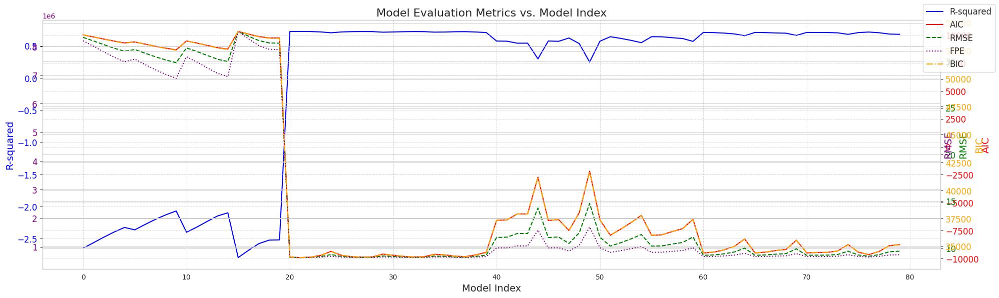

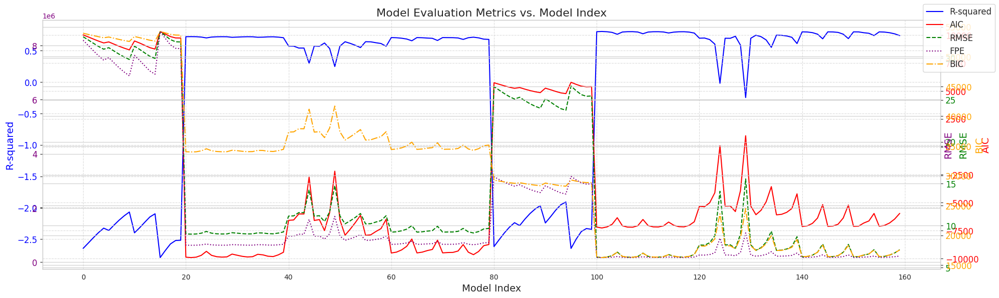

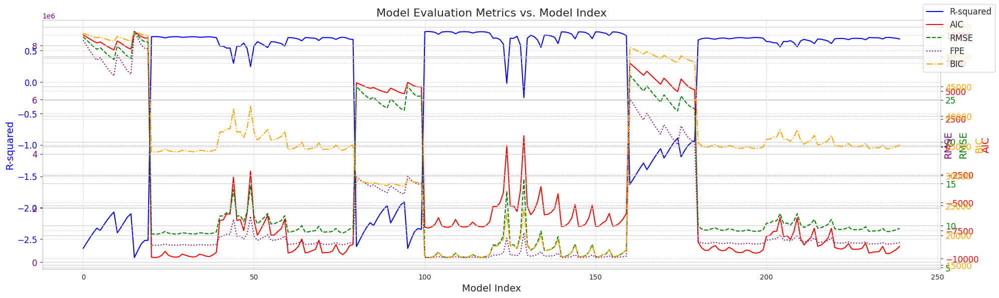

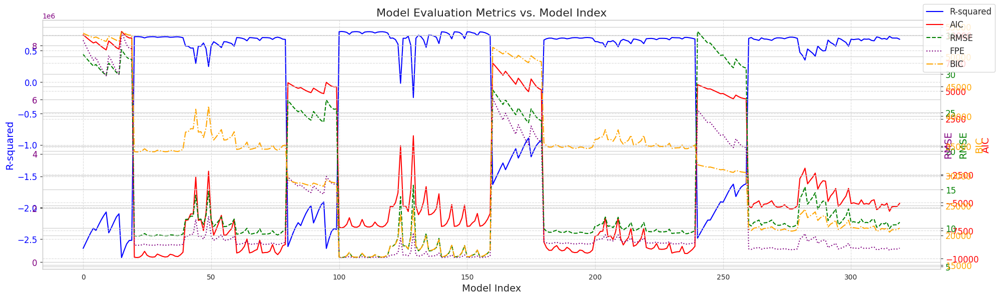

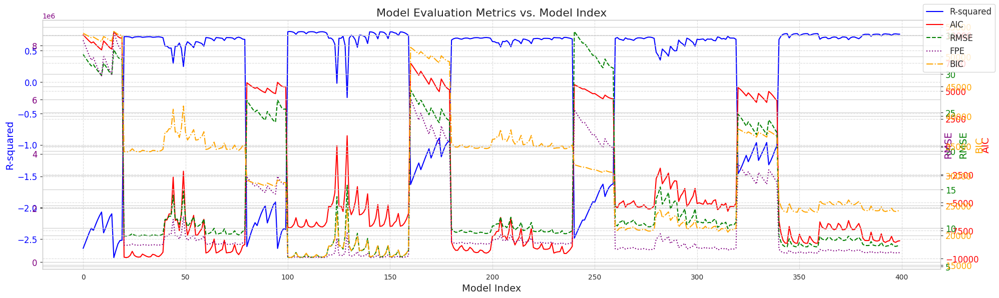

...

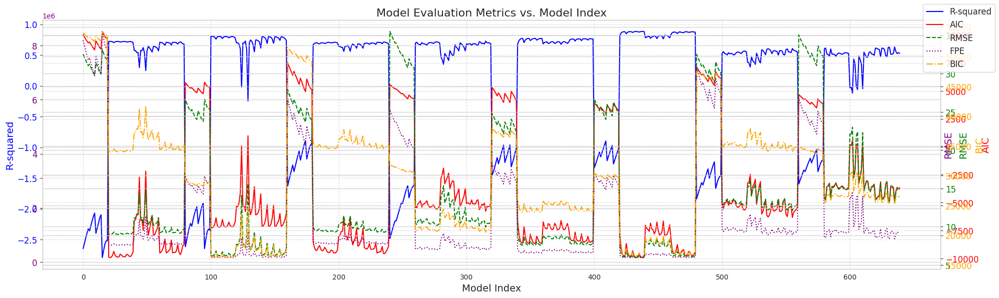

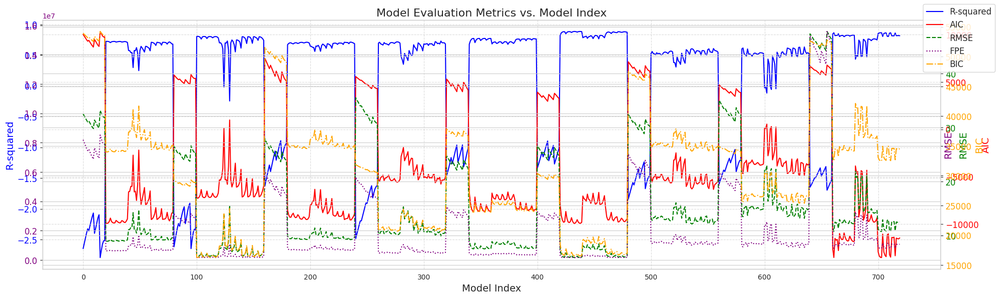

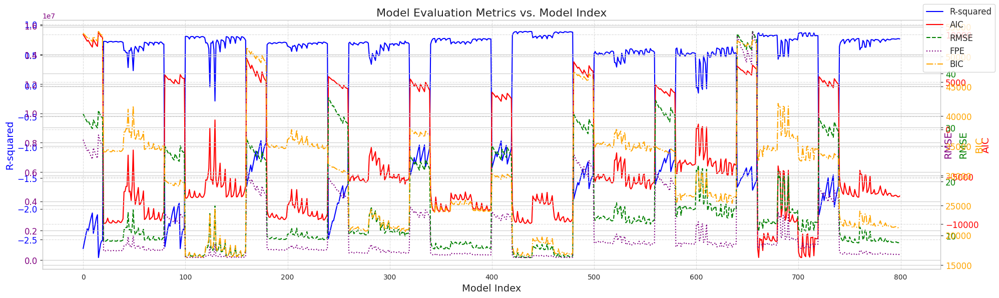

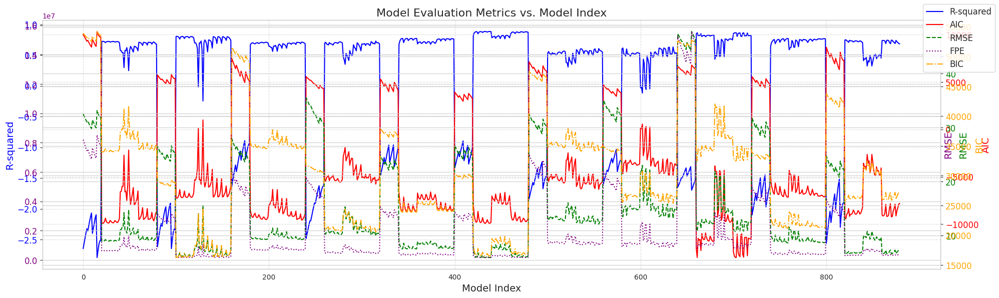

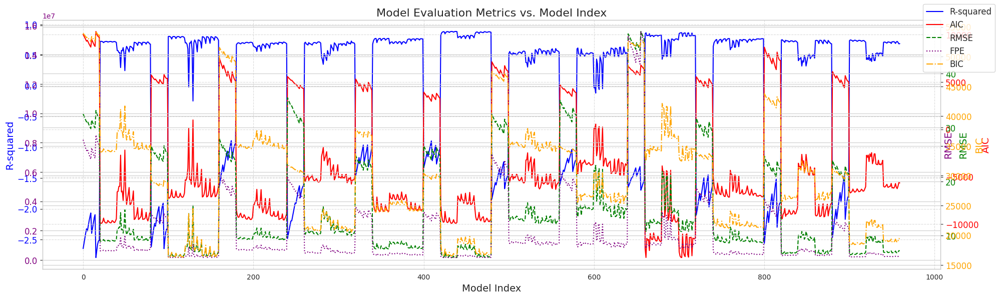

In [ ]:
from re import X
# Find the best model structure (time-invariant modelling)
results_df = pd.DataFrame(columns=['Athlete_Code','Model_Index', 'na', 'nb', 'd', 'AIC', 'Rsq','RMSE','BIC','FPE'])
selected_models = pd.DataFrame(columns=['Athlete_Code','ParamCount','ParamValues','Metrics'])  #ParamCount[na:nb:d] || ParamValues[na,nb] || Metrics[Rsq, AIC, FPE]

# Calculate ARX models to the evaluation data with all possible parameters to find the best fit by checking r-squared and AIC
# Define a max for a, b, and delay (d)
na_max = nb_max = xdelay_max = 4
model_count=0

##Loop through parameters
#Starts 1:1:0 .... 3,3,3               (1,na_max|1,nb_max|xdelay_max) (max=4)
#Starts 1:1:0 .... 4,4,4               (1,na_max+1|1,nb_max+1|xdelay_max+1)(max=4)
#Starts 0:1:0 .... 3,4,4               (na_max|1,nb_max+1|xdelay_max+1)(max=4)

for i in range(len(athlete_list)):
  data = athlete_list[i]
  model_count=0
  print(f"Athlete: {code_name[i]}")
  for na in range(na_max):
    for nb in range(1,nb_max+1):
      for d in range(xdelay_max+1):
        print('\nModel #{} Dataset:{} \nwith {} a parameters, {} b parameters and {} time delay'.format(model_count,code_name[i],na,nb,d))
        #load the associated data using dataloader(data, na, nb, d)
        X_loader, y_loader = dataloader(data, na,  nb, d)
        #print("X_loader:",X_loader)#print("y_loader:",y_loader)


        #Correction to use python## Only when values are equal to zero
        if X_loader.empty:#
            print("Skipping model due to empty X_loader.")
            continue # proceed to next iteration
        if y_loader.empty:
            print("Skipping model due to empty y_loader.")
            continue # proceed to next iteration


        ##Calculate the a and b parameters
        y_loader, ysim, parameters_a, parameters_b, SSG, tau, r_squared, aic, Rmse, bic, fpe = model_generator(data, na, nb, d)


        ## Model evaluation for each generated model use r_squared and aic def above
        # Calculate r-squared and AIC and RMSE and BIC and FPE


        print("its regression yield r squared: {}, Akaike's information criteria: {}".format(r_squared, aic))



        # Save relevant information to the empty lists
        new_row = pd.DataFrame({'Athlete_Code': code_name[i],'Model_Index': [model_count], 'na': [na], 'nb': [nb], 'd': [d], 'AIC': [aic], 'Rsq': [r_squared],'RMSE':[Rmse], 'BIC':[bic],'FPE':[fpe], 'Parameters_a':[parameters_a], 'Parameters_b':[parameters_b]})
        results_df = pd.concat([results_df, new_row], ignore_index=True)

        # Update the model counter
        model_count += 1



  #Plot for each player/game
  fig, ax1 = plt.subplots(figsize=(20, 6))
  X_axis = np.arange(len(results_df)) #results_df['Model_Index']

  #For R-square Error
  ax1.plot(X_axis, results_df['Rsq'], color='blue', label='R-squared')
  ax1.set_xlabel('Model Index', fontsize=14)  # Increased font size
  ax1.set_ylabel('R-squared', color='blue', fontsize=14)  # Increased font size
  ax1.tick_params(axis='y', labelcolor='blue', labelsize=12)  # Increased tick label size

  #For AIC
  ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
  ax2.plot(X_axis, results_df['AIC'], color='red', label='AIC')
  ax2.set_ylabel('AIC', color='red', fontsize=14)  # Increased font size
  ax2.tick_params(axis='y', labelcolor='red', labelsize=12)  # Increased tick label size

  #For RMSE
  ax3 = ax1.twinx()
  ax3.plot(X_axis, results_df['RMSE'], color='green', label='RMSE', linestyle='--')
  ax3.set_ylabel('RMSE', color='green', fontsize=14)
  ax3.tick_params(axis='y', labelcolor='green', labelsize=12)

  #For FPE
  ax4 = ax1.twinx()
  ax4.plot(X_axis, results_df['FPE'], color='purple', label='FPE', linestyle=':')
  ax4.set_ylabel('RMSE', color='purple', fontsize=14)
  ax4.tick_params(axis='y', labelcolor='purple', labelsize=12)

  #For BIC
  ax5 = ax4.twinx()
  ax5.plot(X_axis, results_df['BIC'], color='orange', label='BIC', linestyle='-.')
  ax5.set_ylabel('BIC', color='orange', fontsize=14)
  ax5.tick_params(axis='y', labelcolor='orange', labelsize=12)

  # General graphic configs
  fig.legend(loc="upper right", fontsize=12)  # Add a legend for both plots, increased font size
  ax1.grid(True, linestyle='--', alpha=0.7)  # Added grid with dashed lines and transparency
  ax2.grid(True, linestyle='--', alpha=0.7)  # Added grid with dashed lines and transparency
  plt.title('Model Evaluation Metrics vs. Model Index', fontsize=16)  # Added title with increased font size
  plt.tight_layout()  # Adjust layout to prevent overlapping elements
plt.show()

In [ ]:
results_df

,Athlete_Code,Model_Index,na,nb,d,AIC,Rsq,RMSE,BIC,FPE,Parameters_a,Parameters_b
0,A1M1,0,0,1,0,10018.367043,-2.646508,32.538160,53930.646087,8.198820e+06,[],[108.39783138461151]
1,A1M1,1,0,1,1,9835.450440,-2.561948,32.153837,53739.727384,8.005250e+06,[],[109.04348028704642]
2,A1M1,2,0,1,2,9645.129590,-2.476001,31.758536,53541.294820,7.808617e+06,[],[109.69736133981839]
3,A1M1,3,0,1,3,9461.294271,-2.394950,31.380915,53349.236301,7.623042e+06,[],[110.31272474402218]
4,A1M1,4,0,1,4,9298.054857,-2.324606,31.048527,53177.546996,7.461446e+06,[],[110.85129249317161]
...,...,...,...,...,...,...,...,...,...,...,...,...
955,A6M2,75,3,4,0,-6084.636549,0.711803,6.900740,18997.168715,2.341019e+05,"[2.196355362486569, -1.7895616472482654, 0.584...","[0.8711822507742575, -0.207354745507494, -0.79..."
956,A6M2,76,3,4,1,-6253.779846,0.721650,6.781659,18822.682166,2.260462e+05,"[2.1933011935122946, -1.785554085479578, 0.583...","[1.2161962020509893, -0.8610036760065074, -0.0..."
957,A6M2,77,3,4,2,-5980.964611,0.705790,6.972085,19090.238589,2.388703e+05,"[2.1914459496438137, -1.7862987493540838, 0.58...","[1.0877828060209733, 0.5985560311400908, -2.60..."
958,A6M2,78,3,4,3,-5607.180113,0.682543,7.242186,19458.763800,2.576842e+05,"[2.1862659230030017, -1.780432164054476, 0.583...","[2.3497462940958895, -1.8195026383336055, -1.4..."


In [ ]:
#Select Best Models
scaler = MinMaxScaler()
normalized_metrics = scaler.fit_transform(results_df[['AIC', 'Rsq', 'FPE', 'BIC', 'RMSE']])
# Create a new DataFrame with the normalized metrics
normalized_df = pd.DataFrame(normalized_metrics, columns=['AIC_norm', 'Rsq_norm', 'FPE_norm', 'BIC_norm', 'RMSE_norm'])
selection_df = pd.concat([results_df, normalized_df], axis=1)


#best_models_df = pd.DataFrame(columns=['Athlete_Code','ParamCount','ParamValues','Metrics'])  #ParamCount[na:nb:d] || ParamValues[na,nb] || Metrics[Rsq, AIC, FPE]
best_models_df = pd.DataFrame()


num_models = na_max*nb_max*(xdelay_max+1)
cases = len(results_df)/(num_models) #12

#LOOP for each case (models)
for i in range(int(cases)):
  print("Case: ",i,"Start: ",(i*num_models),"End: ",(i+1)*num_models)
  #Select each dataset models data
  selected_df = selection_df[(i*num_models):(i+1)*num_models].copy()

  #Create a Ranking Selection
  selected_df['AIC_rank'] = selected_df['AIC'].rank()
  selected_df['BIC_rank'] = selected_df['BIC'].rank()

  # Rank by Rsq
  selected_df['Rsq_rank'] = selected_df['Rsq'].rank(ascending=False)  # Note: ascending=False for Rsq

  # Calculate the combined ranking
  selected_df['Ranking'] = selected_df['Rsq_rank'] + selected_df['AIC_rank']+ selected_df['BIC_rank']

  best_df = selected_df.sort_values(by='Ranking', ascending=True).iloc[0]
  #new_row = pd.DataFrame({'Athlete_Code':[filter['Athlete_Code'][0]],'ParamCount'["{}:{}:{}".format(filter['na'][0],filter['nb'][0],filter['d'][0])],'ParamValues':[],'Metrics':[filter['Rsq'][0],filter['AIC'][0],filter['FPE'][0]]})

  #print(best_df)
  #print(selected_df.sort_values(by='Ranking', ascending=True))



  new_row = pd.DataFrame({'Athlete_Code': [best_df['Athlete_Code']],
                          'na': [best_df['na']],
                          'nb': [best_df['nb']],
                          'd': [best_df['d']],
                          'Ranking': [best_df['Ranking']],
                          'AIC_rank': [best_df['AIC_rank']],
                          'Rsq_rank': [best_df['Rsq_rank']],
                          'BIC_rank': [best_df['BIC_rank']],
                          'Rsq': [best_df['Rsq']],
                          'AIC': [best_df['AIC']],
                          'BIC': [best_df['BIC']],
                          'FPE': [best_df['FPE']],
                          'Parameters_a':[parameters_a],
                          'Parameters_b':[parameters_b]})

  best_models_df = pd.concat([best_models_df, new_row], ignore_index=True)

  #print(selected_df.sort_values(by='Rsq', ascending=False)[:3])
  #print(selected_df.sort_values(by='AIC', ascending=True)[:3])
  #print(selected_df.sort_values(by='FPE', ascending=True)[:3])


Case:  0 Start:  0 End:  80
Case:  1 Start:  80 End:  160
Case:  2 Start:  160 End:  240
Case:  3 Start:  240 End:  320
Case:  4 Start:  320 End:  400
Case:  5 Start:  400 End:  480
Case:  6 Start:  480 End:  560
Case:  7 Start:  560 End:  640
Case:  8 Start:  640 End:  720
Case:  9 Start:  720 End:  800
Case:  10 Start:  800 End:  880
Case:  11 Start:  880 End:  960


In [ ]:
best_models_df

,Athlete_Code,na,nb,d,Ranking,AIC_rank,Rsq_rank,BIC_rank,Rsq,AIC,BIC,FPE,Parameters_a,Parameters_b
0,A1M1,1,1,1,3.0,1.0,1.0,1.0,0.722288,-9913.530782,33997.700448,6.243022e+05,"[2.1964651223805656, -1.7982833911242504, 0.59...","[2.0605487782682457, -2.967036503315056, 1.795..."
1,A1M2,1,1,1,3.0,1.0,1.0,1.0,0.804200,-7265.478476,16258.200534,1.705110e+05,"[2.1964651223805656, -1.7982833911242504, 0.59...","[2.0605487782682457, -2.967036503315056, 1.795..."
2,A2M1,3,4,1,3.0,1.0,1.0,1.0,0.709525,-9552.010572,34542.696412,6.677319e+05,"[2.1964651223805656, -1.7982833911242504, 0.59...","[2.0605487782682457, -2.967036503315056, 1.795..."
3,A2M2,3,4,0,3.0,1.0,1.0,1.0,0.726973,-5770.705147,20526.231224,4.416951e+05,"[2.1964651223805656, -1.7982833911242504, 0.59...","[2.0605487782682457, -2.967036503315056, 1.795..."
4,A3M1,1,1,4,5.0,1.0,3.0,1.0,0.769506,-8639.758298,23883.641210,3.389779e+05,"[2.1964651223805656, -1.7982833911242504, 0.59...","[2.0605487782682457, -2.967036503315056, 1.795..."
5,A3M2,1,3,3,3.0,1.0,1.0,1.0,0.883155,-9910.707407,16531.451194,1.645240e+05,"[2.1964651223805656, -1.7982833911242504, 0.59...","[2.0605487782682457, -2.967036503315056, 1.795..."
6,A4M1,3,4,0,3.0,1.0,1.0,1.0,0.605469,-6328.062712,34093.618148,1.004757e+06,"[2.1964651223805656, -1.7982833911242504, 0.59...","[2.0605487782682457, -2.967036503315056, 1.795..."
7,A4M2,3,4,0,3.0,1.0,1.0,1.0,0.631495,-4879.669261,25366.690850,8.584501e+05,"[2.1964651223805656, -1.7982833911242504, 0.59...","[2.0605487782682457, -2.967036503315056, 1.795..."
8,A5M1,3,1,3,3.0,1.0,1.0,1.0,0.862438,-13518.725705,32476.977362,7.950670e+05,"[2.1964651223805656, -1.7982833911242504, 0.59...","[2.0605487782682457, -2.967036503315056, 1.795..."
9,A5M2,1,4,3,3.0,1.0,1.0,1.0,0.767969,-7146.870774,21221.631477,3.702689e+05,"[2.1964651223805656, -1.7982833911242504, 0.59...","[2.0605487782682457, -2.967036503315056, 1.795..."


In [ ]:
results_df.sort_values(by='Rsq', ascending=False)
#Rsq: 1,5,0,16,11,6,15,10,61
#AIC: 1,5,0,6,11,16,15,10,61
#FPE: 0,5,1,60,72,71,62,75,76

,Athlete_Code,Model_Index,na,nb,d,AIC,Rsq,RMSE,BIC,FPE,Parameters_a,Parameters_b
433,A3M2,33,1,3,3,-9910.707407,0.883155,5.962353,16531.451194,1.645240e+05,[0.9814369680556814],"[2.932728065301651, -2.001857153835328, 1.9265..."
438,A3M2,38,1,4,3,-9901.566060,0.883029,5.965100,16540.571662,1.647114e+05,[0.9812392004312193],"[2.8639899515086413, -1.6277990114795693, 1.30..."
437,A3M2,37,1,4,2,-9896.558087,0.882847,5.970198,16552.038664,1.650287e+05,[0.9807220125123799],"[1.6566828504294762, -0.08374367146297601, -0...."
432,A3M2,32,1,3,2,-9896.053258,0.882729,5.973680,16552.563283,1.651854e+05,[0.9815957472667369],"[1.970561973402509, -1.7815802940105494, 2.656..."
428,A3M2,28,1,2,3,-9831.545309,0.881029,6.016823,16610.632865,1.675075e+05,[0.9827136340774631],"[1.5078325739352036, 1.1531925924292383]"
...,...,...,...,...,...,...,...,...,...,...,...,...
80,A1M2,0,0,1,0,5734.788243,-2.617079,26.580349,29260.978261,3.151764e+06,[],[89.04864822739364]
0,A1M1,0,0,1,0,10018.367043,-2.646508,32.538160,53930.646087,8.198820e+06,[],[108.39783138461151]
95,A1M2,15,0,4,0,5773.944368,-2.647249,26.653921,29291.135944,3.171371e+06,[],"[118.83185264517081, -71.70992504561283, -92.5..."
16,A1M1,16,0,4,1,10090.407399,-2.680223,32.666905,53990.761234,8.265967e+06,[],"[149.72151907171812, -89.92180942856018, -117...."



Model with 1 a parameters, 2 b parameters and 0 time delay
    y-1       u-0       u-1
0   NaN  0.206667       NaN
1  20.0  0.207500  0.206667
2  20.0  0.190000  0.207500
3  20.0  0.180000  0.190000
4  19.5  0.154000  0.180000
5  19.5  0.132000  0.154000
6  20.0  0.112000  0.132000
7  20.5  0.114000  0.112000
8  21.0  0.100000  0.114000
9  20.5  0.092000  0.100000
New X:
    y-1    u-0    u-1
4  19.5  0.154  0.180
5  19.5  0.132  0.154
6  20.0  0.112  0.132
7  20.5  0.114  0.112
8  21.0  0.100  0.114
[   0    1    2 ... 7738 7739 7740]


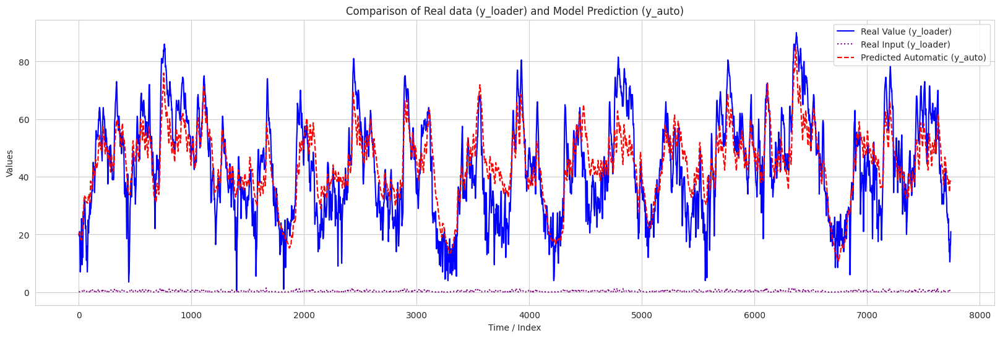

In [ ]:
#Simulation best model structure
number_a=1
number_b=2
d=0

data = athlete_list[2]
# print the relative dataframe and check its columns
y_loader, y_auto, parameters_a, parameters_b, SSG, tau, r_squared, aic, Rmse, bic, fpe = model_generator(data, number_a, number_b, d)


'''y = np.zeros(len(data))
y_auto = np.zeros(len(data))
y_auto[:max(number_a,number_b+d)] = data['y'][0]
#works for (0,1,0),(1,0,0)
for k in range(max(number_a,number_b +d), len(X_loader)):
  ##AUTOMATIC
  # Add the contribution from autoregressive terms (endogenous variables)
  for i_a in range(1, number_a + 1):
      y_auto[k] += den[i_a-1] * y_auto[k - i_a]  # Note: parameters_a starts at index 0
  # Add the contribution from exogenous input terms (with delay d)
  for j_b in range(number_b):
    #print("Input: ",'u-{}'.format(j_b+d))
    y_auto[k] += num[j_b] * X_loader['u-{}'.format(j_b+d)].iloc[k-j_b-d]'''



#Ploting
plt.figure(figsize=(20, 6))
X_axis = np.arange(0,y_loader.shape[0])
print(X_axis)
# Plot the actual values (y_loader)
plt.plot(data['y'], label='Real Value (y_loader)', color='blue')
plt.plot(data['u'], label='Real Input (y_loader)', color='purple', linestyle=':')
# Plot the original data (y)    *AUTOMATIC
plt.plot(X_axis, y_auto, label='Predicted Automatic (y_auto)', color='red', linestyle='--')

# Add labels and title
plt.xlabel('Time / Index')
plt.ylabel('Values')
plt.title('Comparison of Real data (y_loader) and Model Prediction (y_auto)')
plt.legend()  # Add a legend
plt.grid(True) # Add grid lines for better readability
# Adjust the y-axis limits if necessary for better visualization
#plt.ylim([50, 200])
plt.show()

In [ ]:
#Select one model and applie to all the datasets
number_a=1
number_b=2
d=0
one_4_all = pd.DataFrame(columns=['Athlete_Code', 'na', 'nb', 'd','SSG','TC' ,'AIC', 'Rsq','RMSE','BIC','FPE'])
model_count=0

for i in range(len(athlete_list)):
  data = athlete_list[i]
  print(f"Athlete: {code_name[i]}")
  print('\nModel #{} \nwith {} a parameters, {} b parameters and {} time delay'.format(model_count,number_a,number_b,d))
  #load the associated data using dataloader(data, na, nb, d)

  y_loader, y_auto, parameters_a, parameters_b, SSG, tau, r_squared, aic, Rmse, bic, fpe = model_generator(data, number_a, number_b, d)



  new_row = pd.DataFrame({'Athlete_Code': code_name[i],'SSG':[SSG],'TC':[tau], 'Parameters_a':[parameters_a], 'Parameters_b':[parameters_b], 'na': [number_a], 'nb': [number_b], 'd': [d], 'AIC': [aic], 'Rsq': [r_squared],'RMSE':[Rmse], 'BIC':[bic],'FPE':[fpe]})

  one_4_all = pd.concat([one_4_all, new_row], ignore_index=True)



  print("its regression yield r squared: {}, Akaike's information criteria: {}".format(r_squared, aic))

  # Save relevant information to the empty lists
  #new_row = pd.DataFrame({'Athlete_Code': code_name[i],'Model_Index': [model_count], 'na': [na], 'nb': [nb], 'd': [d], 'AIC': [aic], 'Rsq': [r_squared],'RMSE':[Rmse], 'BIC':[bic],'FPE':[fpe]})
  #results_df = pd.concat([results_df, new_row], ignore_index=True)
        # Update the model counter
  model_count += 1



#Do the parameter estimates vary a lot between the subjects or between the volleyball matches?



Athlete: A1M1

Model #0 
with 1 a parameters, 2 b parameters and 0 time delay

Model with 1 a parameters, 2 b parameters and 0 time delay
    y-1       u-0       u-1
0   NaN  0.066667       NaN
1  23.0  0.057500  0.066667
2  22.5  0.058000  0.057500
3  22.0  0.086000  0.058000
4  21.5  0.110000  0.086000
5  20.5  0.146000  0.110000
6  19.0  0.182000  0.146000
7  18.0  0.194000  0.182000
8  18.0  0.164000  0.194000
9  18.0  0.144000  0.164000
New X:
    y-1    u-0    u-1
4  21.5  0.110  0.086
5  20.5  0.146  0.110
6  19.0  0.182  0.146
7  18.0  0.194  0.182
8  18.0  0.164  0.194


<ipython-input-40-d00dfd0a3003>:20: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  one_4_all = pd.concat([one_4_all, new_row], ignore_index=True)


its regression yield r squared: 0.7151370788107558, Akaike's information criteria: -9714.73901872165
Athlete: A1M2

Model #1 
with 1 a parameters, 2 b parameters and 0 time delay

Model with 1 a parameters, 2 b parameters and 0 time delay
    y-1    u-0    u-1
0   NaN  0.560    NaN
1  16.0  0.500  0.560
2  15.5  0.438  0.500
3  14.0  0.306  0.438
4  12.5  0.220  0.306
5  11.5  0.162  0.220
6  12.0  0.112  0.162
7  13.0  0.116  0.112
8  14.5  0.168  0.116
9  16.5  0.182  0.168
New X:
    y-1    u-0    u-1
4  12.5  0.220  0.306
5  11.5  0.162  0.220
6  12.0  0.112  0.162
7  13.0  0.116  0.112
8  14.5  0.168  0.116
its regression yield r squared: 0.7955200529599864, Akaike's information criteria: -7070.118165155924
Athlete: A2M1

Model #2 
with 1 a parameters, 2 b parameters and 0 time delay

Model with 1 a parameters, 2 b parameters and 0 time delay
    y-1       u-0       u-1
0   NaN  0.206667       NaN
1  20.0  0.207500  0.206667
2  20.0  0.190000  0.207500
3  20.0  0.180000  0.190000


In [ ]:
one_4_all

,Athlete_Code,na,nb,d,SSG,TC,AIC,Rsq,RMSE,BIC,FPE,Parameters_a,Parameters_b
0,A1M1,1,2,0,159.137013,-80.249100,-9714.739019,0.715137,9.092996,34203.446498,6.405421e+05,[0.9876161202412641],"[-1.126606594455808, 3.0973402266176726]"
1,A1M2,1,2,0,126.531391,-62.888709,-7070.118165,0.795520,6.317275,16459.963300,1.781493e+05,[0.9842246494978669],"[-1.090307582394874, 3.0863846288538332]"
2,A2M1,1,2,0,143.682432,-56.213342,-8841.284436,0.681111,9.725969,35245.309409,7.328236e+05,[0.982367925707955],"[-1.3266942696185609, 3.8601135938988658]"
3,A2M2,1,2,0,189.671076,-84.550536,-5400.713517,0.702640,10.377003,20885.010972,4.806938e+05,[0.9882424207505923],"[-0.46253168236010284, 2.692604391758069]"
4,A3M1,1,2,0,144.435236,-77.959261,-7132.891273,0.702226,8.622384,25417.350064,4.385643e+05,[0.9872547057214746],"[-3.8514928418954417, 5.69236243487436]"
5,A3M2,1,2,0,154.268093,-78.224008,-8652.283686,0.846256,6.842124,17810.129831,2.167521e+05,[0.9872975666173881],"[-2.85101861035034, 4.8105987838713995]"
6,A4M1,1,2,0,168.738422,-76.501230,-5252.817617,0.537438,13.129390,35152.630516,1.176845e+06,[0.9870133781440189],"[-1.8179498335480364, 4.009291915859838]"
7,A4M2,1,2,0,182.146499,-78.887063,-4479.816848,0.599374,13.775616,25750.897686,9.317597e+05,[0.9874036567906999],"[-1.1769583083308928, 3.471338124611437]"
8,A5M1,1,2,0,225.543030,-158.444814,-12778.087155,0.846526,11.397564,33222.921855,8.868582e+05,[0.993708528998255],"[-2.5388071165275563, 3.957804551633064]"
9,A5M2,1,2,0,124.515497,-79.165850,-5654.619747,0.684718,10.124096,22730.212799,5.032623e+05,[0.9874477358679957],"[-3.1820156633230976, 4.744967067007703]"


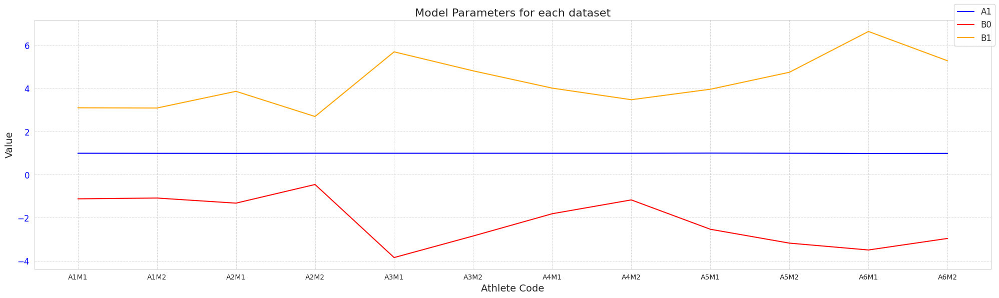

In [ ]:
#Do the parameter estimates vary a lot between the subjects or between the volleyball matches?
athlete_codes = one_4_all['Athlete_Code'].to_list()

#Plot for each player/game
fig, ax1 = plt.subplots(figsize=(20, 6))
X_axis = athlete_codes #results_df['Model_Index']

#plot parameters A
ax1.plot(X_axis, one_4_all['Parameters_a'].str[0].tolist(), color='blue', label='A1')
#ax1.plot(X_axis, one_4_all['Param_a'].str[1].tolist(), color='blue', label='A2')
#ax1.plot(X_axis, one_4_all['Param_a'].str[2].tolist(), color='blue', label='A3')
ax1.set_xlabel('Athlete Code', fontsize=14)  # Increased font size
ax1.set_ylabel('Value', fontsize=14)  # Increased font size
ax1.tick_params(axis='y', labelcolor='blue', labelsize=12)  # Increased tick label size

#Plot parameters B
ax1.plot(X_axis, one_4_all['Parameters_b'].str[0].tolist(), color='red', label='B0')
ax1.plot(X_axis, one_4_all['Parameters_b'].str[1].tolist(), color='orange', label='B1')
#ax1.plot(X_axis, one_4_all['Param_b'].str[2].tolist(), color='red', label='B2')

'''#First param B
x2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
ax2.plot(X_axis, one_4_all['Param_b'].str[0].tolist(), color='red', label='AIC')
#ax2.plot(X_axis, one_4_all['Param_b'].str[1].tolist(), color='red', label='AIC')
ax2.set_ylabel('Param_b', color='red', fontsize=14)  # Increased font size
ax2.tick_params(axis='y', labelcolor='red', labelsize=12)  # Increased tick label size
'''


# General graphic configs
fig.legend(loc="upper right", fontsize=12)  # Add a legend for both plots, increased font size
ax1.grid(True, linestyle='--', alpha=0.7)  # Added grid with dashed lines and transparency
ax2.grid(True, linestyle='--', alpha=0.7)  # Added grid with dashed lines and transparency
plt.title('Model Parameters for each dataset', fontsize=16)  # Added title with increased font size
plt.tight_layout()  # Adjust layout to prevent overlapping elements
plt.show()


In [ ]:
one_4_all

,Athlete_Code,na,nb,d,SSG,TC,AIC,Rsq,RMSE,BIC,FPE,Parameters_a,Parameters_b
0,A1M1,1,2,0,159.137013,-80.249100,-9714.739019,0.715137,9.092996,34203.446498,6.405421e+05,[0.9876161202412641],"[-1.126606594455808, 3.0973402266176726]"
1,A1M2,1,2,0,126.531391,-62.888709,-7070.118165,0.795520,6.317275,16459.963300,1.781493e+05,[0.9842246494978669],"[-1.090307582394874, 3.0863846288538332]"
2,A2M1,1,2,0,143.682432,-56.213342,-8841.284436,0.681111,9.725969,35245.309409,7.328236e+05,[0.982367925707955],"[-1.3266942696185609, 3.8601135938988658]"
3,A2M2,1,2,0,189.671076,-84.550536,-5400.713517,0.702640,10.377003,20885.010972,4.806938e+05,[0.9882424207505923],"[-0.46253168236010284, 2.692604391758069]"
4,A3M1,1,2,0,144.435236,-77.959261,-7132.891273,0.702226,8.622384,25417.350064,4.385643e+05,[0.9872547057214746],"[-3.8514928418954417, 5.69236243487436]"
5,A3M2,1,2,0,154.268093,-78.224008,-8652.283686,0.846256,6.842124,17810.129831,2.167521e+05,[0.9872975666173881],"[-2.85101861035034, 4.8105987838713995]"
6,A4M1,1,2,0,168.738422,-76.501230,-5252.817617,0.537438,13.129390,35152.630516,1.176845e+06,[0.9870133781440189],"[-1.8179498335480364, 4.009291915859838]"
7,A4M2,1,2,0,182.146499,-78.887063,-4479.816848,0.599374,13.775616,25750.897686,9.317597e+05,[0.9874036567906999],"[-1.1769583083308928, 3.471338124611437]"
8,A5M1,1,2,0,225.543030,-158.444814,-12778.087155,0.846526,11.397564,33222.921855,8.868582e+05,[0.993708528998255],"[-2.5388071165275563, 3.957804551633064]"
9,A5M2,1,2,0,124.515497,-79.165850,-5654.619747,0.684718,10.124096,22730.212799,5.032623e+05,[0.9874477358679957],"[-3.1820156633230976, 4.744967067007703]"


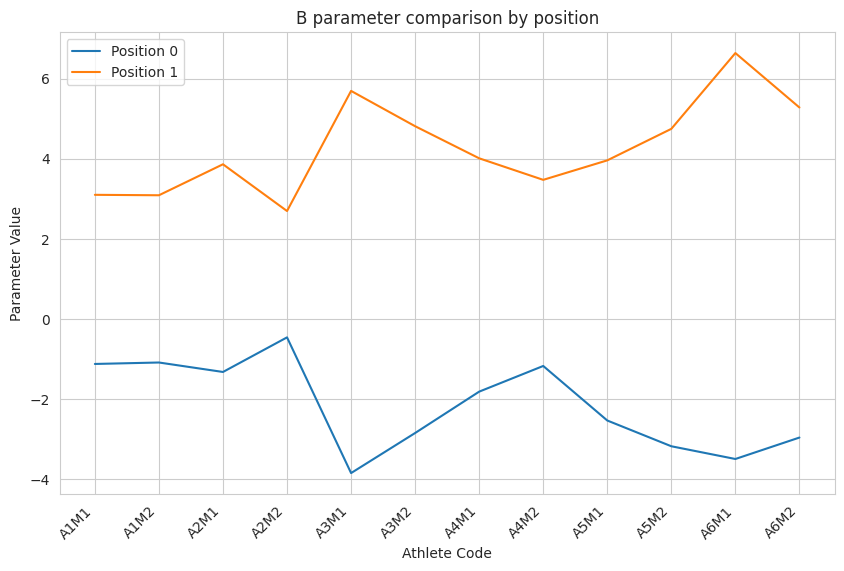

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Extract the 'b' parameter values and athlete codes
b_values = one_4_all['Parameters_b'].to_list()
athlete_codes = one_4_all['Athlete_Code'].to_list()

num_athletes = len(athlete_codes)
num_params = len(b_values[0])  # Assuming all athletes have the same number of 'b' parameters

# Create an array to store the parameter values for each position
param_positions = [[] for _ in range(num_params)]
for athlete_params in b_values:
    for i, param_value in enumerate(athlete_params):
        param_positions[i].append(param_value)

# Create the plot
plt.figure(figsize=(10, 6))  # Adjust figure size as needed

for i, position_values in enumerate(param_positions):
    plt.plot(athlete_codes, position_values, label=f"Position {i}")

# Customize the plot
plt.xlabel("Athlete Code")
plt.ylabel("Parameter Value")
plt.title("B parameter comparison by position")
plt.legend()
plt.grid(True)
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability

plt.show()

In [ ]:
best_models_df

,Athlete_Code,na,nb,d,Ranking,AIC_rank,Rsq_rank,BIC_rank,Rsq,AIC,BIC,FPE,Parameters_a,Parameters_b
0,A1M1,1,1,1,3.0,1.0,1.0,1.0,0.722288,-9913.530782,33997.700448,6.243022e+05,"[2.1964651223805656, -1.7982833911242504, 0.59...","[2.0605487782682457, -2.967036503315056, 1.795..."
1,A1M2,1,1,1,3.0,1.0,1.0,1.0,0.804200,-7265.478476,16258.200534,1.705110e+05,"[2.1964651223805656, -1.7982833911242504, 0.59...","[2.0605487782682457, -2.967036503315056, 1.795..."
2,A2M1,3,4,1,3.0,1.0,1.0,1.0,0.709525,-9552.010572,34542.696412,6.677319e+05,"[2.1964651223805656, -1.7982833911242504, 0.59...","[2.0605487782682457, -2.967036503315056, 1.795..."
3,A2M2,3,4,0,3.0,1.0,1.0,1.0,0.726973,-5770.705147,20526.231224,4.416951e+05,"[2.1964651223805656, -1.7982833911242504, 0.59...","[2.0605487782682457, -2.967036503315056, 1.795..."
4,A3M1,1,1,4,5.0,1.0,3.0,1.0,0.769506,-8639.758298,23883.641210,3.389779e+05,"[2.1964651223805656, -1.7982833911242504, 0.59...","[2.0605487782682457, -2.967036503315056, 1.795..."
5,A3M2,1,3,3,3.0,1.0,1.0,1.0,0.883155,-9910.707407,16531.451194,1.645240e+05,"[2.1964651223805656, -1.7982833911242504, 0.59...","[2.0605487782682457, -2.967036503315056, 1.795..."
6,A4M1,3,4,0,3.0,1.0,1.0,1.0,0.605469,-6328.062712,34093.618148,1.004757e+06,"[2.1964651223805656, -1.7982833911242504, 0.59...","[2.0605487782682457, -2.967036503315056, 1.795..."
7,A4M2,3,4,0,3.0,1.0,1.0,1.0,0.631495,-4879.669261,25366.690850,8.584501e+05,"[2.1964651223805656, -1.7982833911242504, 0.59...","[2.0605487782682457, -2.967036503315056, 1.795..."
8,A5M1,3,1,3,3.0,1.0,1.0,1.0,0.862438,-13518.725705,32476.977362,7.950670e+05,"[2.1964651223805656, -1.7982833911242504, 0.59...","[2.0605487782682457, -2.967036503315056, 1.795..."
9,A5M2,1,4,3,3.0,1.0,1.0,1.0,0.767969,-7146.870774,21221.631477,3.702689e+05,"[2.1964651223805656, -1.7982833911242504, 0.59...","[2.0605487782682457, -2.967036503315056, 1.795..."


In [ ]:
one_4_all

,Athlete_Code,na,nb,d,SSG,TC,AIC,Rsq,RMSE,BIC,FPE,Parameters_a,Parameters_b
0,A1M1,1,2,0,159.137013,-80.249100,-9714.739019,0.715137,9.092996,34203.446498,6.405421e+05,[0.9876161202412641],"[-1.126606594455808, 3.0973402266176726]"
1,A1M2,1,2,0,126.531391,-62.888709,-7070.118165,0.795520,6.317275,16459.963300,1.781493e+05,[0.9842246494978669],"[-1.090307582394874, 3.0863846288538332]"
2,A2M1,1,2,0,143.682432,-56.213342,-8841.284436,0.681111,9.725969,35245.309409,7.328236e+05,[0.982367925707955],"[-1.3266942696185609, 3.8601135938988658]"
3,A2M2,1,2,0,189.671076,-84.550536,-5400.713517,0.702640,10.377003,20885.010972,4.806938e+05,[0.9882424207505923],"[-0.46253168236010284, 2.692604391758069]"
4,A3M1,1,2,0,144.435236,-77.959261,-7132.891273,0.702226,8.622384,25417.350064,4.385643e+05,[0.9872547057214746],"[-3.8514928418954417, 5.69236243487436]"
5,A3M2,1,2,0,154.268093,-78.224008,-8652.283686,0.846256,6.842124,17810.129831,2.167521e+05,[0.9872975666173881],"[-2.85101861035034, 4.8105987838713995]"
6,A4M1,1,2,0,168.738422,-76.501230,-5252.817617,0.537438,13.129390,35152.630516,1.176845e+06,[0.9870133781440189],"[-1.8179498335480364, 4.009291915859838]"
7,A4M2,1,2,0,182.146499,-78.887063,-4479.816848,0.599374,13.775616,25750.897686,9.317597e+05,[0.9874036567906999],"[-1.1769583083308928, 3.471338124611437]"
8,A5M1,1,2,0,225.543030,-158.444814,-12778.087155,0.846526,11.397564,33222.921855,8.868582e+05,[0.993708528998255],"[-2.5388071165275563, 3.957804551633064]"
9,A5M2,1,2,0,124.515497,-79.165850,-5654.619747,0.684718,10.124096,22730.212799,5.032623e+05,[0.9874477358679957],"[-3.1820156633230976, 4.744967067007703]"



Model with 1 a parameters, 2 b parameters and 0 time delay
    y-1       u-0       u-1
0   NaN  0.066667       NaN
1  23.0  0.057500  0.066667
2  22.5  0.058000  0.057500
3  22.0  0.086000  0.058000
4  21.5  0.110000  0.086000
5  20.5  0.146000  0.110000
6  19.0  0.182000  0.146000
7  18.0  0.194000  0.182000
8  18.0  0.164000  0.194000
9  18.0  0.144000  0.164000
New X:
    y-1    u-0    u-1
4  21.5  0.110  0.086
5  20.5  0.146  0.110
6  19.0  0.182  0.146
7  18.0  0.194  0.182
8  18.0  0.164  0.194
Game1: 0.7151370788107558


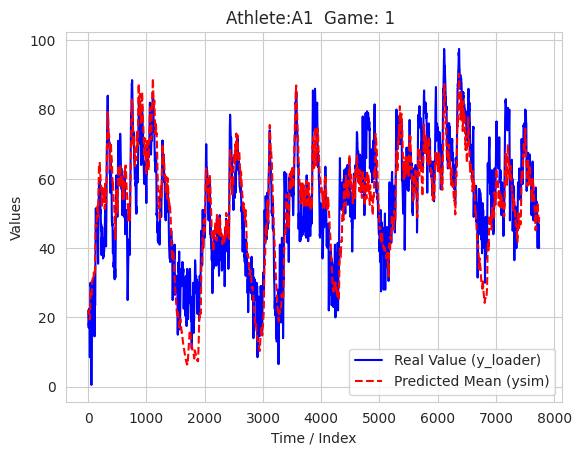

    y-1    u-0    u-1
0   NaN  0.560    NaN
1  16.0  0.500  0.560
2  15.5  0.438  0.500
3  14.0  0.306  0.438
4  12.5  0.220  0.306
5  11.5  0.162  0.220
6  12.0  0.112  0.162
7  13.0  0.116  0.112
8  14.5  0.168  0.116
9  16.5  0.182  0.168
New X:
    y-1    u-0    u-1
4  12.5  0.220  0.306
5  11.5  0.162  0.220
6  12.0  0.112  0.162
7  13.0  0.116  0.112
8  14.5  0.168  0.116

Model with 1 a parameters, 2 b parameters and 0 time delay
    y-1    u-0    u-1
0   NaN  0.560    NaN
1  16.0  0.500  0.560
2  15.5  0.438  0.500
3  14.0  0.306  0.438
4  12.5  0.220  0.306
5  11.5  0.162  0.220
6  12.0  0.112  0.162
7  13.0  0.116  0.112
8  14.5  0.168  0.116
9  16.5  0.182  0.168
New X:
    y-1    u-0    u-1
4  12.5  0.220  0.306
5  11.5  0.162  0.220
6  12.0  0.112  0.162
7  13.0  0.116  0.112
8  14.5  0.168  0.116
Game2: 0.7955200529599864


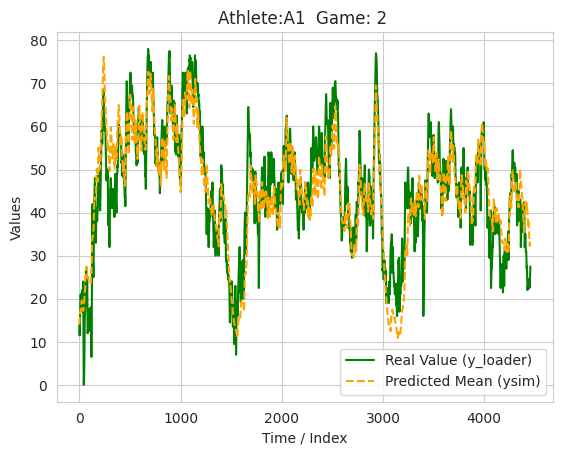

<ipython-input-47-0ca15153b7ea>:73: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  athlete_mean_model = pd.concat([athlete_mean_model, new_row], ignore_index=True)



Model with 1 a parameters, 2 b parameters and 0 time delay
    y-1    u-0    u-1
0   NaN  0.560    NaN
1  16.0  0.500  0.560
2  15.5  0.438  0.500
3  14.0  0.306  0.438
4  12.5  0.220  0.306
5  11.5  0.162  0.220
6  12.0  0.112  0.162
7  13.0  0.116  0.112
8  14.5  0.168  0.116
9  16.5  0.182  0.168
New X:
    y-1    u-0    u-1
4  12.5  0.220  0.306
5  11.5  0.162  0.220
6  12.0  0.112  0.162
7  13.0  0.116  0.112
8  14.5  0.168  0.116
Game1: 0.7955200529599864


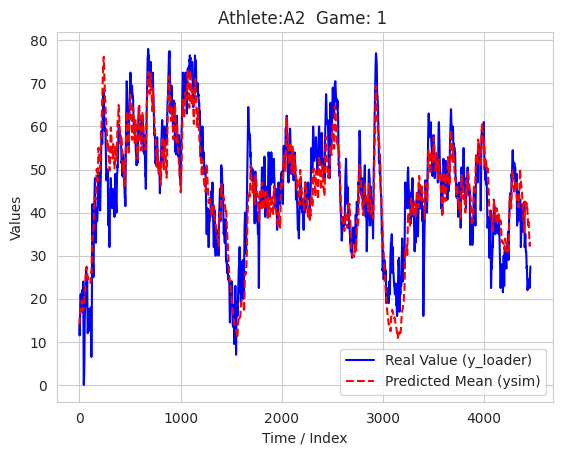

    y-1       u-0       u-1
0   NaN  0.206667       NaN
1  20.0  0.207500  0.206667
2  20.0  0.190000  0.207500
3  20.0  0.180000  0.190000
4  19.5  0.154000  0.180000
5  19.5  0.132000  0.154000
6  20.0  0.112000  0.132000
7  20.5  0.114000  0.112000
8  21.0  0.100000  0.114000
9  20.5  0.092000  0.100000
New X:
    y-1    u-0    u-1
4  19.5  0.154  0.180
5  19.5  0.132  0.154
6  20.0  0.112  0.132
7  20.5  0.114  0.112
8  21.0  0.100  0.114

Model with 1 a parameters, 2 b parameters and 0 time delay
    y-1       u-0       u-1
0   NaN  0.206667       NaN
1  20.0  0.207500  0.206667
2  20.0  0.190000  0.207500
3  20.0  0.180000  0.190000
4  19.5  0.154000  0.180000
5  19.5  0.132000  0.154000
6  20.0  0.112000  0.132000
7  20.5  0.114000  0.112000
8  21.0  0.100000  0.114000
9  20.5  0.092000  0.100000
New X:
    y-1    u-0    u-1
4  19.5  0.154  0.180
5  19.5  0.132  0.154
6  20.0  0.112  0.132
7  20.5  0.114  0.112
8  21.0  0.100  0.114
Game2: 0.6811110453980813


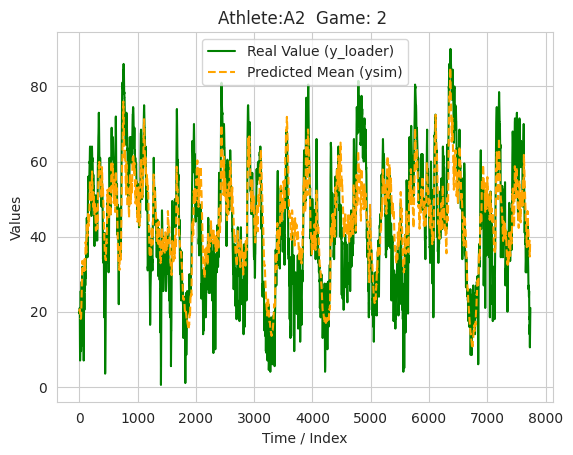


Model with 1 a parameters, 2 b parameters and 0 time delay
    y-1       u-0       u-1
0   NaN  0.206667       NaN
1  20.0  0.207500  0.206667
2  20.0  0.190000  0.207500
3  20.0  0.180000  0.190000
4  19.5  0.154000  0.180000
5  19.5  0.132000  0.154000
6  20.0  0.112000  0.132000
7  20.5  0.114000  0.112000
8  21.0  0.100000  0.114000
9  20.5  0.092000  0.100000
New X:
    y-1    u-0    u-1
4  19.5  0.154  0.180
5  19.5  0.132  0.154
6  20.0  0.112  0.132
7  20.5  0.114  0.112
8  21.0  0.100  0.114
Game1: 0.6811110453980813


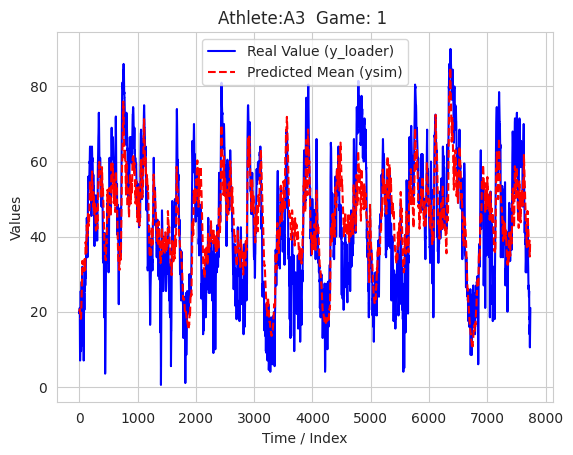

    y-1    u-0    u-1
0   NaN  0.210    NaN
1  30.0  0.210  0.210
2  29.5  0.212  0.210
3  29.0  0.212  0.212
4  28.5  0.208  0.212
5  28.5  0.180  0.208
6  30.0  0.156  0.180
7  31.0  0.150  0.156
8  31.5  0.122  0.150
9  32.0  0.114  0.122
New X:
    y-1    u-0    u-1
4  28.5  0.208  0.212
5  28.5  0.180  0.208
6  30.0  0.156  0.180
7  31.0  0.150  0.156
8  31.5  0.122  0.150

Model with 1 a parameters, 2 b parameters and 0 time delay
    y-1    u-0    u-1
0   NaN  0.210    NaN
1  30.0  0.210  0.210
2  29.5  0.212  0.210
3  29.0  0.212  0.212
4  28.5  0.208  0.212
5  28.5  0.180  0.208
6  30.0  0.156  0.180
7  31.0  0.150  0.156
8  31.5  0.122  0.150
9  32.0  0.114  0.122
New X:
    y-1    u-0    u-1
4  28.5  0.208  0.212
5  28.5  0.180  0.208
6  30.0  0.156  0.180
7  31.0  0.150  0.156
8  31.5  0.122  0.150
Game2: 0.7026399147460015


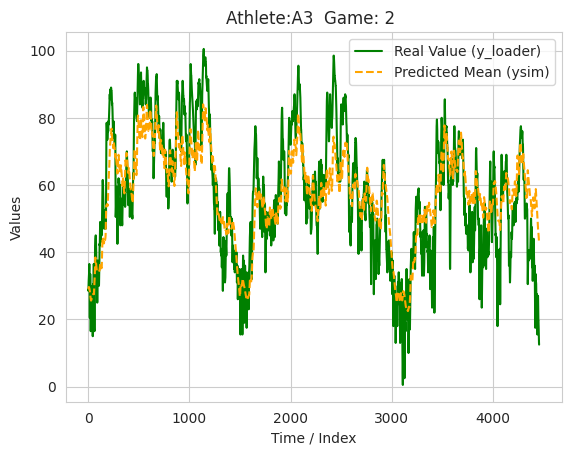


Model with 1 a parameters, 2 b parameters and 0 time delay
    y-1    u-0    u-1
0   NaN  0.210    NaN
1  30.0  0.210  0.210
2  29.5  0.212  0.210
3  29.0  0.212  0.212
4  28.5  0.208  0.212
5  28.5  0.180  0.208
6  30.0  0.156  0.180
7  31.0  0.150  0.156
8  31.5  0.122  0.150
9  32.0  0.114  0.122
New X:
    y-1    u-0    u-1
4  28.5  0.208  0.212
5  28.5  0.180  0.208
6  30.0  0.156  0.180
7  31.0  0.150  0.156
8  31.5  0.122  0.150
Game1: 0.7026399147460015


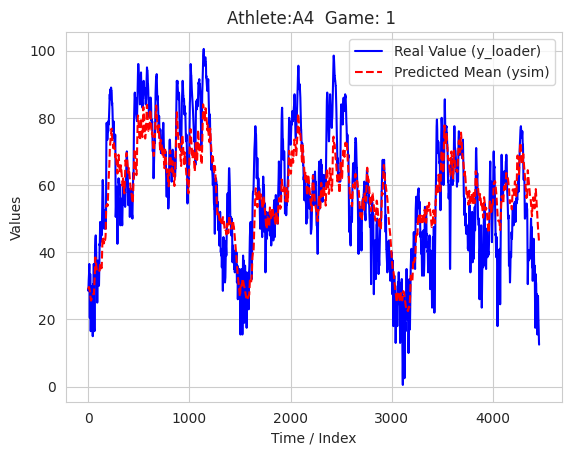

    y-1       u-0       u-1
0   NaN  0.166667       NaN
1  14.0  0.172500  0.166667
2  12.0  0.178000  0.172500
3   9.0  0.178000  0.178000
4   8.5  0.168000  0.178000
5   9.5  0.172000  0.168000
6  10.0  0.160000  0.172000
7  10.0  0.148000  0.160000
8   9.5  0.132000  0.148000
9   8.5  0.130000  0.132000
New X:
    y-1    u-0    u-1
4   8.5  0.168  0.178
5   9.5  0.172  0.168
6  10.0  0.160  0.172
7  10.0  0.148  0.160
8   9.5  0.132  0.148

Model with 1 a parameters, 2 b parameters and 0 time delay
    y-1       u-0       u-1
0   NaN  0.166667       NaN
1  14.0  0.172500  0.166667
2  12.0  0.178000  0.172500
3   9.0  0.178000  0.178000
4   8.5  0.168000  0.178000
5   9.5  0.172000  0.168000
6  10.0  0.160000  0.172000
7  10.0  0.148000  0.160000
8   9.5  0.132000  0.148000
9   8.5  0.130000  0.132000
New X:
    y-1    u-0    u-1
4   8.5  0.168  0.178
5   9.5  0.172  0.168
6  10.0  0.160  0.172
7  10.0  0.148  0.160
8   9.5  0.132  0.148
Game2: 0.7022255172489347


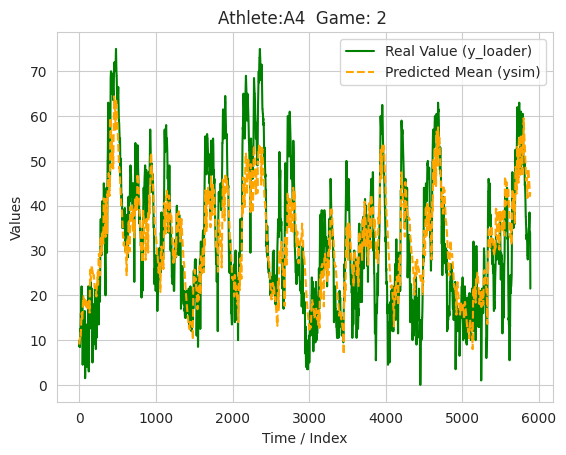


Model with 1 a parameters, 2 b parameters and 0 time delay
    y-1       u-0       u-1
0   NaN  0.166667       NaN
1  14.0  0.172500  0.166667
2  12.0  0.178000  0.172500
3   9.0  0.178000  0.178000
4   8.5  0.168000  0.178000
5   9.5  0.172000  0.168000
6  10.0  0.160000  0.172000
7  10.0  0.148000  0.160000
8   9.5  0.132000  0.148000
9   8.5  0.130000  0.132000
New X:
    y-1    u-0    u-1
4   8.5  0.168  0.178
5   9.5  0.172  0.168
6  10.0  0.160  0.172
7  10.0  0.148  0.160
8   9.5  0.132  0.148
Game1: 0.7022255172489347


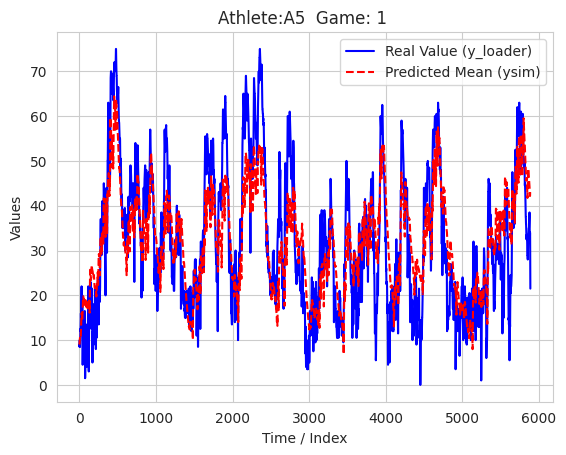

    y-1       u-0       u-1
0   NaN  0.113333       NaN
1  14.0  0.100000  0.113333
2  12.5  0.086000  0.100000
3   9.5  0.070000  0.086000
4   9.0  0.054000  0.070000
5  10.5  0.058000  0.054000
6  11.5  0.070000  0.058000
7  11.5  0.086000  0.070000
8  11.0  0.102000  0.086000
9  11.5  0.116000  0.102000
New X:
    y-1    u-0    u-1
4   9.0  0.054  0.070
5  10.5  0.058  0.054
6  11.5  0.070  0.058
7  11.5  0.086  0.070
8  11.0  0.102  0.086

Model with 1 a parameters, 2 b parameters and 0 time delay
    y-1       u-0       u-1
0   NaN  0.113333       NaN
1  14.0  0.100000  0.113333
2  12.5  0.086000  0.100000
3   9.5  0.070000  0.086000
4   9.0  0.054000  0.070000
5  10.5  0.058000  0.054000
6  11.5  0.070000  0.058000
7  11.5  0.086000  0.070000
8  11.0  0.102000  0.086000
9  11.5  0.116000  0.102000
New X:
    y-1    u-0    u-1
4   9.0  0.054  0.070
5  10.5  0.058  0.054
6  11.5  0.070  0.058
7  11.5  0.086  0.070
8  11.0  0.102  0.086
Game2: 0.8462559688927636


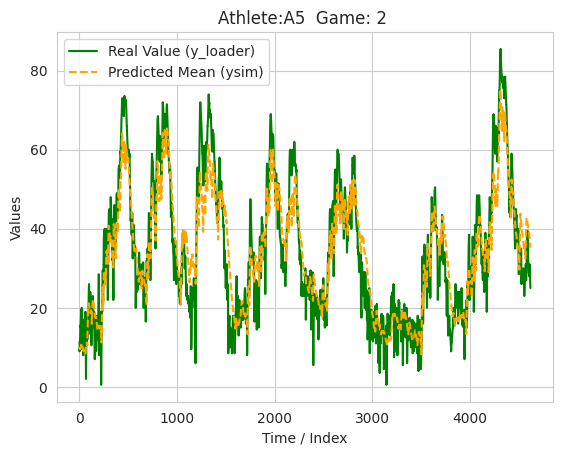


Model with 1 a parameters, 2 b parameters and 0 time delay
    y-1       u-0       u-1
0   NaN  0.113333       NaN
1  14.0  0.100000  0.113333
2  12.5  0.086000  0.100000
3   9.5  0.070000  0.086000
4   9.0  0.054000  0.070000
5  10.5  0.058000  0.054000
6  11.5  0.070000  0.058000
7  11.5  0.086000  0.070000
8  11.0  0.102000  0.086000
9  11.5  0.116000  0.102000
New X:
    y-1    u-0    u-1
4   9.0  0.054  0.070
5  10.5  0.058  0.054
6  11.5  0.070  0.058
7  11.5  0.086  0.070
8  11.0  0.102  0.086
Game1: 0.8462559688927636


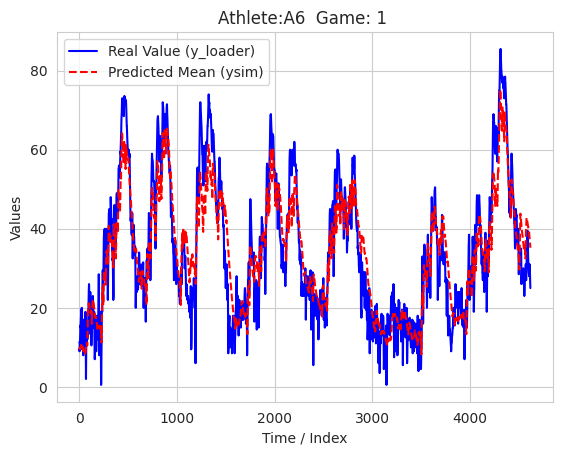

    y-1       u-0       u-1
0   NaN  0.116667       NaN
1  35.0  0.122500  0.116667
2  36.0  0.118000  0.122500
3  37.5  0.124000  0.118000
4  39.0  0.116000  0.124000
5  40.5  0.122000  0.116000
6  40.0  0.110000  0.122000
7  38.5  0.118000  0.110000
8  39.0  0.180000  0.118000
9  39.5  0.250000  0.180000
New X:
    y-1    u-0    u-1
4  39.0  0.116  0.124
5  40.5  0.122  0.116
6  40.0  0.110  0.122
7  38.5  0.118  0.110
8  39.0  0.180  0.118

Model with 1 a parameters, 2 b parameters and 0 time delay
    y-1       u-0       u-1
0   NaN  0.116667       NaN
1  35.0  0.122500  0.116667
2  36.0  0.118000  0.122500
3  37.5  0.124000  0.118000
4  39.0  0.116000  0.124000
5  40.5  0.122000  0.116000
6  40.0  0.110000  0.122000
7  38.5  0.118000  0.110000
8  39.0  0.180000  0.118000
9  39.5  0.250000  0.180000
New X:
    y-1    u-0    u-1
4  39.0  0.116  0.124
5  40.5  0.122  0.116
6  40.0  0.110  0.122
7  38.5  0.118  0.110
8  39.0  0.180  0.118
Game2: 0.5374379556280356


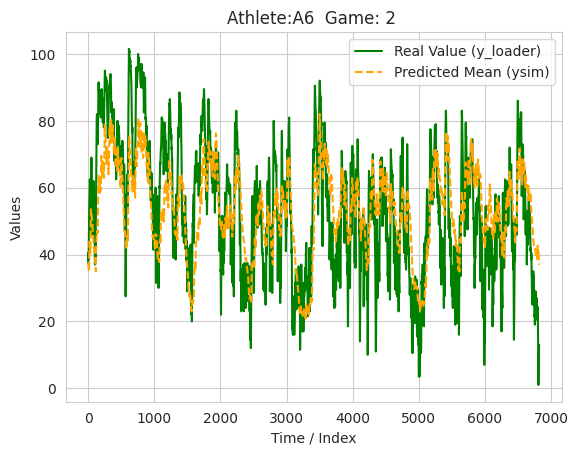

In [ ]:
# Biological interpretation

#First Order Model
##
#  Code Here
##


#Second Order Model
##
#  Code Here
##




#Athlete Average Moder
#structure: 1:2:0
#for p_case in best_models_df.iterrows():
counter = 0
number_a=1
number_b=2
d=0
athlete_mean_model = pd.DataFrame(columns=['Athlete', 'Parameters_a', 'Parameters_b', 'Rsq_M1', 'AIC_M1', 'Rsq_M2', 'AIC_M2'])

for pcase in one_4_all.iterrows():
  #print(pcase)

  if pcase[1]["Athlete_Code"][3] == '1':    #First Game
    params_a_memory = pcase[1]['Parameters_a']
    params_b_memory = pcase[1]['Parameters_b']
    counter += 1

  else: #second game
    mean_a = (params_a_memory + pcase[1]['Parameters_a']) / 2
    mean_b = (params_b_memory + pcase[1]['Parameters_b']) / 2

    #Simulation
    #Simulation for first Game
    y_loader, ysim, parameters_a, parameters_b, SSG, tau, r_squared1, aic1, Rmse1, bic1, fpe1 = model_generator(athlete_list[counter-1], number_a, number_b, d)

    ## Simulate values of Y
    #Plot Simulation
    print("Game1:",r_squared1)
    plt.plot(y_loader, label='Real Value (y_loader)', color='blue')
    plt.plot(np.arange(len(ysim)), ysim, label='Predicted Mean (ysim)', color='red', linestyle='--')
    plt.xlabel('Time / Index')
    plt.ylabel('Values')
    plt.title('Athlete:{}  Game: 1 '.format(pcase[1]['Athlete_Code'][:2]))
    plt.legend()  # Add a legend
    plt.grid(True) # Add grid lines for better readability
    plt.show()


      ##Simulation for Second Game
    X_loader, y_loader = dataloader(athlete_list[counter], number_a, number_b, d)
    y_loader, ysim, parameters_a, parameters_b, SSG, tau, r_squared2, aic2, Rmse2, bic2, fpe2 = model_generator(athlete_list[counter], number_a, number_b, d)

    #Plot Simulation
    print("Game2:",r_squared2)
    plt.plot(y_loader, label='Real Value (y_loader)', color='green')
    plt.plot(np.arange(len(ysim)), ysim, label='Predicted Mean (ysim)', color='orange', linestyle='--')
    plt.xlabel('Time / Index')
    plt.ylabel('Values')
    plt.title('Athlete:{}  Game: 2 '.format(pcase[1]['Athlete_Code'][:2]))
    plt.legend()  # Add a legend
    plt.grid(True) # Add grid lines for better readability
    plt.show()


    #Save to the Dataframe
    new_row = pd.DataFrame({'Athlete': [pcase[1]['Athlete_Code'][:2]],'Parameters_a':[mean_a], 'Parameters_b':[mean_b], 'Rsq_M1':[r_squared1], 'AIC_M1':[aic1], 'Rsq_M2':[r_squared2], 'AIC_M2':[aic2]})
    athlete_mean_model = pd.concat([athlete_mean_model, new_row], ignore_index=True)
    plt.show()







In [ ]:
athlete_mean_model

,Athlete,Parameters_a,Parameters_b,Rsq_M1,AIC_M1,Rsq_M2,AIC_M2
0,A1,[0.9859203848695655],"[-1.1084570884253409, 3.091862427735753]",0.715137,-9714.739019,0.795520,-7070.118165
1,A2,[0.9853051732292737],"[-0.8946129759893319, 3.2763589928284675]",0.795520,-7070.118165,0.681111,-8841.284436
2,A3,[0.9872761361694313],"[-3.351255726122891, 5.25148060937288]",0.681111,-8841.284436,0.702640,-5400.713517
3,A4,[0.9872085174673594],"[-1.4974540709394646, 3.7403150202356374]",0.702640,-5400.713517,0.702226,-7132.891273
4,A5,[0.9905781324331253],"[-2.8604113899253267, 4.351385809320384]",0.702226,-7132.891273,0.846256,-8652.283686
5,A6,[0.9798249585157284],"[-3.232277656521976, 5.957947913614738]",0.846256,-8652.283686,0.537438,-5252.817617


 # Time-varying dynamics

    y-1   y-2    u-1
0   NaN   NaN    NaN
1  16.0   NaN  0.560
2  15.5  16.0  0.500
3  14.0  15.5  0.438
4  12.5  14.0  0.306
5  11.5  12.5  0.220
6  12.0  11.5  0.162
7  13.0  12.0  0.112
8  14.5  13.0  0.116
9  16.5  14.5  0.168
New X:
    y-1   y-2    u-1
4  12.5  14.0  0.306
5  11.5  12.5  0.220
6  12.0  11.5  0.162
7  13.0  12.0  0.112
8  14.5  13.0  0.116


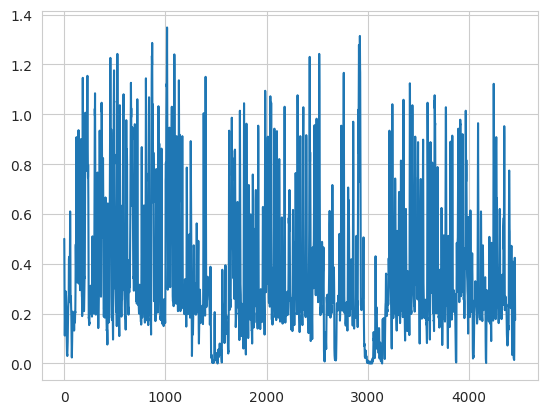

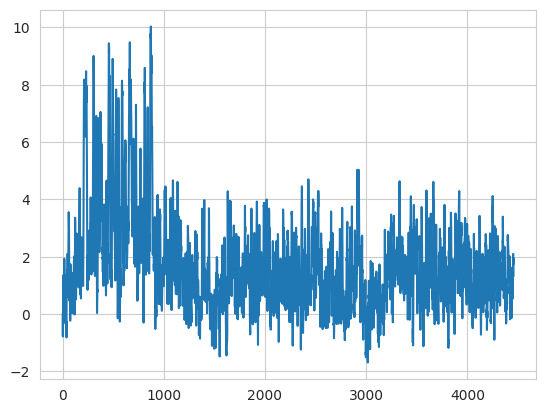

In [ ]:
na = 2
nb = 1
d = 1

#INCORPORATE ASSIGNMENT DATA
X_loader, y_loader = dataloader(athlete_list[1], na, nb, d)
N = len(y_loader)
y = y_loader#.values.reshape(-1,1)
u = X_loader['u-{}'.format(d)].values.reshape(-1,1)

N = len(y_loader)
t = np.arange(N)                                        # example for 'time'/points 0-(N-1)
f = 2 * np.pi / 40                                      # f = chosen frequence for square wave


e = np.random.randn(N, 1) * np.sqrt(0.16)               # Noise vector e-N(0,0.16), 'standard normal distribution'is mean 0, standard deviation 1.
a1 = np.ones((N,1)) * -1                                # a1 = constant
a2 = np.ones((N,1)) * 0.25                              # a2 = constant (if you have a2 means it is second order system)
b0 = np.ones((N,1))
b0[200:899] = 2                                         # b0 = variable
# delay = 1


y = np.zeros((N,1))                                     # start with an empty vector for y
for k in range(max(na, nb+d-1), N):
    y[k] = -a1[k] * y[k-1] - a2[k] * y[k-2] + b0[k] * u[k-d] + e[k]  # if we have a2 means it is a second order system.

plt.plot(u)
plt.show()
plt.plot(y)

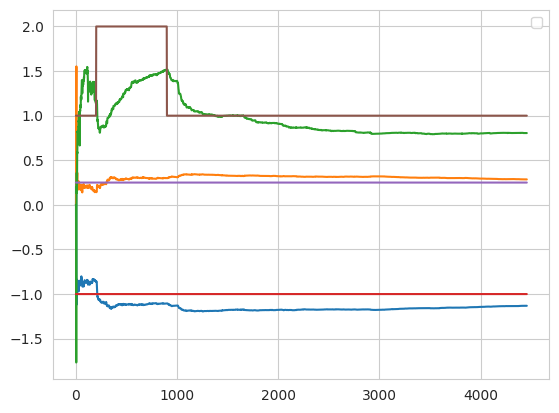

R2: 0.550308411587913


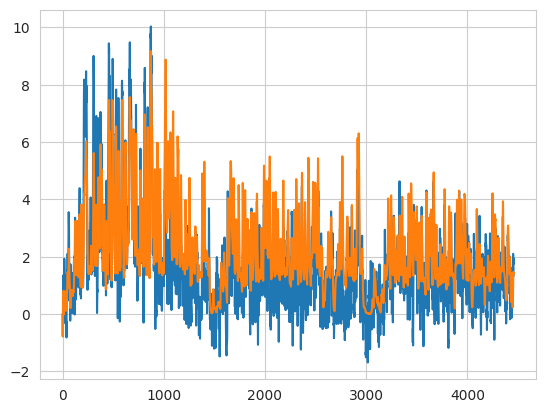

In [ ]:
# Time-variant - recursive ARX

dm = 3                              # Number of parameters to estimate
# Initialise matrix
X = np.zeros((dm,1))              # prepare an input matrix that can be used in the loop, size is the number of parameters
P = 1000 * np.eye(dm)            # Covariance matrix set to large value because of uncertainty at the beginning due to lack of measurement
a_hat = np.ones((dm,1))         # Minimum value to not create error in case of 0 division


# Information to be stored in the loop
a1est = np.zeros((N,1))
a2est = np.zeros((N,1))
b0est = np.zeros((N,1))


# Loop over all the data
for k in range(max(na, nb+d-1), N):
    # 1. Update the matrix X with the new data
    X[0] = - y[k-1]
    X[1] = - y[k-2]
    X[2] = u[k-d]

    # 2. Update gain matrix g
    g = (P @ X) / (1 +( X.T @ P @ X))

    # 3. Update covariance matrix P
    P = P - g @ X.T @ P

    # 4. Re-estimate the parameter coefficients
    yhat =  X.T @ a_hat      # y = data vector * parameters vetor
    error = y[k] - yhat
    a_hat = a_hat + g * error
    # OR: a_hat = a_hat + g * ( y(k) - (X' * a_hat))

    # 5. Store estimates (get the diagonal elements of a_hat that correspond to a1, a2, b0)
    a1est[k] = a_hat[0]
    a2est[k] = a_hat[1]
    b0est[k] = a_hat[2]

# Simulate model (step 2)
ysim2 = np.zeros((N,1))
for k in range(max(na, nb+d-1), N):
    ysim2[k] = - a1est[k] * ysim2[k-1] - a2est[k] * ysim2[k-2] + b0est[k] * u[k-d]

plt.plot(a1est)
plt.plot(a2est)
plt.plot(b0est)

plt.plot(a1)
plt.plot(a2)
plt.plot(b0)
plt.legend()
plt.show()

plt.plot(y)
plt.plot(ysim2)

print('R2:',r_2(y, ysim2))


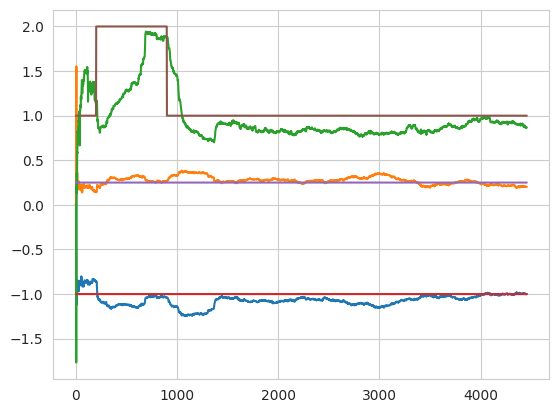

R2: 0.7059906446962914


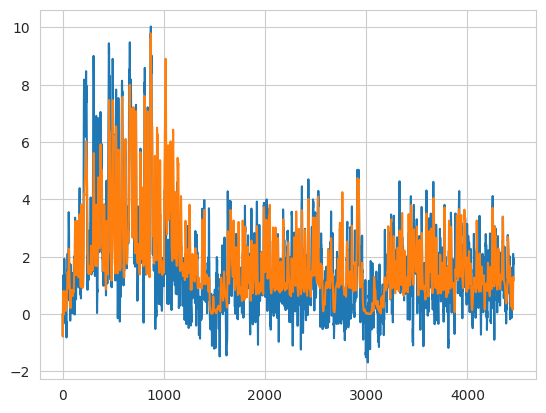

In [ ]:
#Time-variant - recursive ARX RDW (rectancular data weighing)
Win = 500;                  # window size
# Initialise matrix
X_add = np.zeros((dm,1))
X_remove = np.zeros((dm,1))
P = 1000 * np.eye(dm)             # Covariance matrix set to large value because of uncertainty at the beginning due to lack of measurement
A_hat = np.ones((dm,1))           # Minimum value to don't create error in case of 0 division
# Information to be stored in the loop
a1est = np.zeros((N,1))
a2est = np.zeros((N,1))
b0est = np.zeros((N,1))

for k in range(max(na, nb+d-1), N):
    # 1. Update the matrix X with the new data
    X_add[0] = -y[k-1]
    X_add[1] = -y[k-2]
    X_add[2] = u[k-1]

    # 2. Update gain matrix
    g = P @ X_add / (1 + X_add.T @ P @ X_add)  # inverse of matrix is 'devision'

    # 3. Update covariance matrix P
    P = P - g @ X_add.T @ P

    # 4. Re-estimate the parameter coefficients based on the new data
    yhat = X_add.T @ A_hat
    error = y[k] - yhat
    A_hat = A_hat + g * error

    # 5 Remove effect of old data every data at (k-s)th instant
    if k - Win - max(nb + d - 1, na) > 0:
        # 5.a Update the matrix X(k-s) with the new data
        X_remove[0] = -y[k - Win - 1] #a1
        X_remove[1] = -y[k - Win - 2] #a2
        X_remove[2] = u[k - Win - d] #b0
        # 5.b Update gain matrix
        g = -P @ X_remove / (1 + X_remove.T @ P @ X_remove)
        # 5.c Update covariance matrix P
        P = (P - g @ X_remove.T @ P)
        # 5.d Re-estimate the parameter coefficients based on the new data
        yhat = X_remove.T @ A_hat
        error = y[k - Win] - yhat
        A_hat = A_hat + g * error

    a1est[k] = A_hat[0]
    a2est[k] = A_hat[1]
    b0est[k] = A_hat[2]

# Simulate model (step 3)
ysim3 = np.zeros((N,1))
for k in range(max(na, nb+d-1), N):
    ysim3[k] = -a1est[k] * ysim3[k-1] - a2est[k] * ysim3[k-2] + b0est[k] * u[k-d]


plt.plot(a1est)
plt.plot(a2est)
plt.plot(b0est)
plt.plot(a1)
plt.plot(a2)
plt.plot(b0)
plt.show()
plt.plot(y)
plt.plot(ysim3)

print('R2:',r_2(y, ysim3))




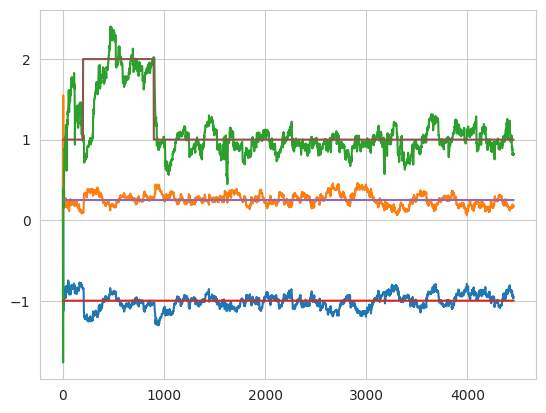

R2: 0.8034144029203696


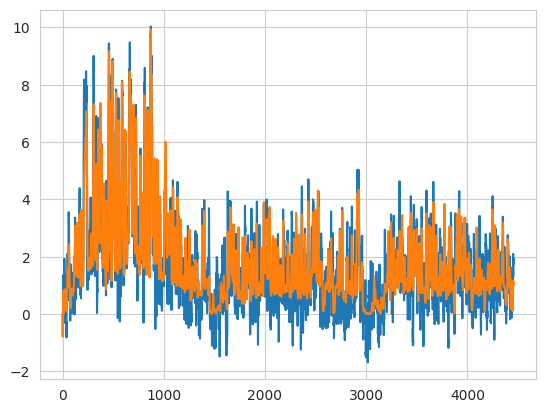

In [ ]:
#Step 4 - Time-varying recursive ARX with EWP (exponentially weighted past)
Alpha = 0.985

# Initialise matrix
X = np.zeros((dm,1))
P = 1000 * np.eye(dm)             # Covariance matrix set to large value because of uncertainty at the beginning due to lack of measurement
a_hat = np.ones((dm,1))       # Minimum value to don't create error in case of 0 division
# Information to be stored in the loop
a1est = np.zeros((N,1))
a2est = np.zeros((N,1))
b0est = np.zeros((N,1))

#Loop over all the data
for k in range(max(na, nb+d-1), N):

    # 1. Update the matrix X with the new data
    X[0] = -y[k-1]
    X[1] = -y[k-2]
    X[2] = u[k-d]

    # 2. Update gain matrix
    g = P @ X / (Alpha + X.T @ P @ X)

    # 3. Update covariance matrix P
    P = (P - g @ X.T @ P) / Alpha

    # 4. Re-estimate the parameter coefficients based on the new data
    yhat = X.T @ a_hat
    error = y[k] - yhat
    a_hat = a_hat + g * error

    a1est[k] = a_hat[0]
    a2est[k] = a_hat[1]
    b0est[k] = a_hat[2]


# Simulate model
ysim4 = np.zeros((N,1))

for k in range(max(na, nb+d-1), N):
    ysim4[k] = -a1est[k] * ysim4[k-1] - a2est[k] * ysim4[k-2] + b0est[k] * u[k-d]

plt.plot(a1est)
plt.plot(a2est)
plt.plot(b0est)

plt.plot(a1)
plt.plot(a2)
plt.plot(b0)
plt.show()
plt.plot(y)
plt.plot(ysim4)

print('R2:',r_2(y, ysim4))


In [ ]:
#2ºSystem Identification
def calcmodel(data, na, nb, d):
    # Load the associated data using dataloader(data, na, nb, d)

    X_loader, y_loader = dataloader(data, na, nb, d)


    # Estimate the a and b parameters vector [a0...an, b0...bm].T by the formula inv(X.T dot X) dot X.T dot y
    params = np.linalg.inv(X_loader.T @ X_loader) @ X_loader.T @ y_loader
    #params = np.linalg.solve(X_loader.T, X_loader) @ X_loader.T @ y_loader
    params = params.values


    parameters_a = params[:na]
    parameters_b = params[na:]


    # Optional: Calculate the predicted values of Y via Matrix-Vector multiplication (this is for prediction, not simulation)
    Y_pred = np.dot(X_loader, params)


    #Calculate a simulation using the predicted parameters use the following structure:
    ysim = np.zeros((len(X_loader)+1,1))  # the plus one is because the first value is initialized and not simulated

    ysim[0] = y_loader.values[0]    # initialize the first value
    max_lag = max(na, nb + d)  # Maximum lag across both endogenous and exogenous variables

    for k in range(max_lag, len(X_loader)):
        #Add the contribution from autoregressive terms (endogenous variables)
        for i_a in range(1, na + 1):
            #ysim[k] += parameters_a[i_a - 1] * ysim[k - i_a]
            ysim[k] += parameters_a[i_a - 1] * X_loader.iloc[k, i_a]

        #Add the contribution from exogenous input ter\ms (with delay d)
        for j_b in range(1, nb + 1):
            #ysim[k] += estimation[i_a - 1] * ysim[k - i_a - X_loader['u-{}'.format(d)]]                    #to get the column at delay u-d use this syntax X_loader['u-{}'.format(d)]
            ysim[k] += parameters_b[j_b-1] * X_loader['u-{}'.format(d)].iloc[k-j_b]


    # Calculate r-squared
    y_loader = y_loader.values.reshape(-1,1)
    SS_res = np.sum((y_loader - ysim[1:]) ** 2)  # Residual sum of squares
    SS_tot = np.sum((y_loader - np.mean(y_loader)) ** 2)  # Total sum of squares
    rsq = 1 - (SS_res / SS_tot)
    #print("ss_red:",SS_res,"ss_tot",SS_tot,"RSQ:",rsq)


    # Calculate AIC
    n = len(y_loader)  # Number of observations
    # Number of parameters (including intercept)
    aic =  2 * (na + nb) + len(y_loader) * np.log(1 - rsq) # Evaluates the complexicity of the Model


    return Y_pred, ysim, params, rsq, aic




# print(calcmodel(data,0,1,0))
# print(calcmodel(data,1,0,0))


In [ ]:
pds = pd.DataFrame(columns=["Athlete", "na", "nb", "d", "Params", "RSQ", "AIC"])

# Parameter ranges
na_max = nb_max = xdelay_max = 3

for i in range(len(athlete_list)):
    print(f"Athlete: {code_name[i]}")


Athlete: A1M1
Athlete: A1M2
Athlete: A2M1
Athlete: A2M2
Athlete: A3M1
Athlete: A3M2
Athlete: A4M1
Athlete: A4M2
Athlete: A5M1
Athlete: A5M2
Athlete: A6M1
Athlete: A6M2


In [ ]:
pds

,Athlete,na,nb,d,Params,RSQ,AIC


In [ ]:
# Initialize an empty DataFrame to store results
pds = pd.DataFrame(columns=["Athlete", "na", "nb", "d", "Params", "RSQ", "AIC"])

# Parameter ranges
na_max = nb_max = xdelay_max = 3
# Iterate over each athlete
for i in range(len(athlete_list)):
    print(f"Athlete: {code_name[i]}")
    athlete = athlete_list[i]
    # Iterate over possible values of na, nb, and d
    for na in range(1,na_max+1):
      for nb in range(1,nb_max+1):
        for d in range(1,xdelay_max+1):
              # Calculate model with specified parameters
              Y_pred, ysim, params, rsq, aic = calcmodel(athlete, na=na, nb=nb, d=d)


              # Add the result as a new row to the DataFrame
              pds = pd.concat([pds, pd.DataFrame({
                  "Athlete": f"{code_name[i]}",
                  "na": [na],
                  "nb": [nb],
                  "d": [d],
                  "Params": [params],
                  "RSQ": [rsq],
                  "AIC": [aic]
              })], ignore_index=True)

# Display final DataFrame with all results
#print(pds)


#Logs
'''
Run   Time
1     24:23       #First version(5)
2     24:23          #Add to dataframe(5)
3     25:xx        #No Idea(5)
4     5:xx         #Normal(3)
'''

Athlete: A1M1
    y-1       u-1
0   NaN       NaN
1  23.0  0.066667
2  22.5  0.057500
3  22.0  0.058000
4  21.5  0.086000
5  20.5  0.110000
6  19.0  0.146000
7  18.0  0.182000
8  18.0  0.194000
9  18.0  0.164000
New X:
    y-1    u-1
4  21.5  0.086
5  20.5  0.110
6  19.0  0.146
7  18.0  0.182
8  18.0  0.194


<ipython-input-56-1af76ed7213c>:19: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  pds = pd.concat([pds, pd.DataFrame({


Streaming output truncated to the last 5000 lines.
7   13.0  12.0  11.5  0.162
8   14.5  13.0  12.0  0.112
9   16.5  14.5  13.0  0.116
10  18.0  16.5  14.5  0.168
    y-1   y-2   y-3    u-3
0   NaN   NaN   NaN    NaN
1  16.0   NaN   NaN    NaN
2  15.5  16.0   NaN    NaN
3  14.0  15.5  16.0  0.560
4  12.5  14.0  15.5  0.500
5  11.5  12.5  14.0  0.438
6  12.0  11.5  12.5  0.306
7  13.0  12.0  11.5  0.220
8  14.5  13.0  12.0  0.162
9  16.5  14.5  13.0  0.112
New X:
     y-1   y-2   y-3    u-3
8   14.5  13.0  12.0  0.162
9   16.5  14.5  13.0  0.112
10  18.0  16.5  14.5  0.116
11  19.0  18.0  16.5  0.168
12  19.5  19.0  18.0  0.182
    y-1   y-2   y-3    u-1    u-2
0   NaN   NaN   NaN    NaN    NaN
1  16.0   NaN   NaN  0.560    NaN
2  15.5  16.0   NaN  0.500  0.560
3  14.0  15.5  16.0  0.438  0.500
4  12.5  14.0  15.5  0.306  0.438
5  11.5  12.5  14.0  0.220  0.306
6  12.0  11.5  12.5  0.162  0.220
7  13.0  12.0  11.5  0.112  0.162
8  14.5  13.0  12.0  0.116  0.112
9  16.5  14.5  13.0  0.16

'\nRun   Time\n1     24:23       #First version(5)\n2     24:23          #Add to dataframe(5)\n3     25:xx        #No Idea(5)\n4     5:xx         #Normal(3)\n'

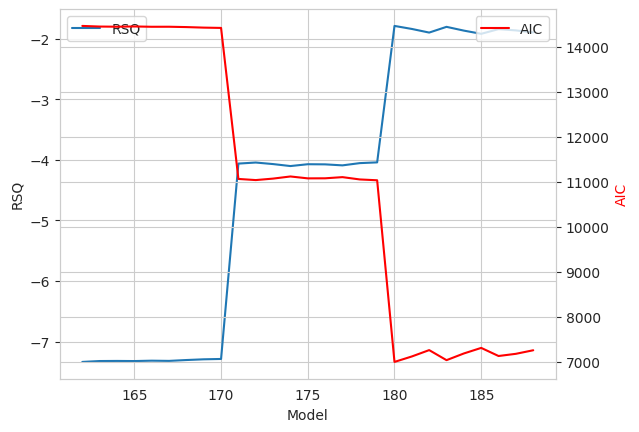

<Figure size 1000x600 with 0 Axes>

,na,nb,d,RSQ,AIC
162,1,1,1,-7.337220,14469.497904
163,1,1,2,-7.322558,14455.372917
164,1,1,3,-7.320939,14451.927324
165,1,2,1,-7.322883,14457.639322
166,1,2,2,-7.316822,14450.552516
167,1,2,3,-7.320278,14451.267115
168,1,3,1,-7.305942,14443.626547
169,1,3,2,-7.294062,14431.750493
170,1,3,3,-7.288414,14424.991359
171,2,1,1,-4.060675,11066.250042


In [ ]:

A1M1 = pds[pds['Athlete'] == "A4M1"]
percentile_75_1 = A1M1['AIC'].quantile(0.9)
percentile_75_2 = np.percentile(A1M1['AIC'],90)
#print(percentile_75_1, percentile_75_2)
#A1M1 = A1M1[A1M1['RSQ'] >= percentile_75]
#print(A1M1)

percentile_95 = A1M1['RSQ'].quantile(0.75)
fig, ax1 = plt.subplots()
plt.figure(figsize=(10, 6))
ax1.plot(A1M1["RSQ"])
ax1.set_xlabel('Model')
ax1.set_ylabel('RSQ')
ax2 = ax1.twinx()
ax2.plot(A1M1["AIC"], color='red')
ax2.set_ylabel('AIC', color='red')
ax1.legend(['RSQ'], loc='upper left')
ax2.legend(['AIC'], loc='upper right')
plt.show()
#pds
#Logs
'''
Total: 1500 Models
'''
A1M1[['na', 'nb','d','RSQ','AIC']][0:]

In [ ]:
#3 Biological interpretation

# 2º Practical assignment

In [ ]:
# uploaded = files.upload()

In [ ]:
os.chdir(datafolder_part2)


In [ ]:
M_334_df = pd.DataFrame()
M_343_df = pd.DataFrame()
WT_df = pd.DataFrame()
Unknown_df = pd.DataFrame()

# Mutant 334
for i in range(1,7):
  load_input = pd.read_csv('Mutation334_C{}_In.csv'.format(i), names=['u_C{}'.format(i)])
  load_output = pd.read_csv('Mutation334_C{}_Out.csv'.format(i), names=['y_C{}'.format(i)])
  M_334_df = pd.concat([M_334_df, load_input, load_output], axis=1)

# Mutant 343
for i in range(1,7):
  load_input = pd.read_csv('Mutation343_C{}_In.csv'.format(i), names=['u_C{}'.format(i)])
  load_output = pd.read_csv('Mutation343_C{}_Out.csv'.format(i), names=['y_C{}'.format(i)])
  M_343_df = pd.concat([M_343_df, load_input, load_output], axis=1)

# WildType
for i in range(1,7):
  load_input = pd.read_csv('WildType_C{}_In.csv'.format(i), names=['u_C{}'.format(i)])
  load_output = pd.read_csv('WildType_C{}_Out.csv'.format(i), names=['y_C{}'.format(i)])
  WT_df = pd.concat([WT_df, load_input, load_output], axis=1)


# WildType
for i in range(1,3):
  load_input = pd.read_csv('Unknown_C{}_In.csv'.format(i), names=['u_C{}'.format(i)])
  load_output = pd.read_csv('Unknown_C{}_Out.csv'.format(i), names=['y_C{}'.format(i)])
  Unknown_df = pd.concat([Unknown_df, load_input, load_output], axis=1)

In [ ]:
# Mutant 334

M334_C1_In_df = pd.read_csv('Mutation334_C1_In.csv', names=['u'])
M334_C2_In_df = pd.read_csv('Mutation334_C2_In.csv', names=['u'])
M334_C3_In_df = pd.read_csv('Mutation334_C3_In.csv', names=['u'])
M334_C4_In_df = pd.read_csv('Mutation334_C4_In.csv', names=['u'])
M334_C5_In_df = pd.read_csv('Mutation334_C5_In.csv', names=['u'])
M334_C6_In_df = pd.read_csv('Mutation334_C6_In.csv', names=['u'])

M334_C1_Out_df = pd.read_csv('Mutation334_C1_Out.csv', names=['y'])
M334_C2_Out_df = pd.read_csv('Mutation334_C2_Out.csv', names=['y'])
M334_C3_Out_df = pd.read_csv('Mutation334_C3_Out.csv', names=['y'])
M334_C4_Out_df = pd.read_csv('Mutation334_C4_Out.csv', names=['y'])
M334_C5_Out_df = pd.read_csv('Mutation334_C5_Out.csv', names=['y'])
M334_C6_Out_df = pd.read_csv('Mutation334_C6_Out.csv', names=['y'])

Mutant_334_list = [M334_C1_In_df,
M334_C2_In_df,
M334_C3_In_df,
M334_C4_In_df,
M334_C5_In_df,
M334_C6_In_df,
M334_C1_Out_df,
M334_C2_Out_df,
M334_C3_Out_df,
M334_C4_Out_df,
M334_C5_Out_df,
M334_C6_Out_df] #12

# Mutant 343

M343_C1_In_df = pd.read_csv('Mutation343_C1_In.csv', names=['u'])
M343_C2_In_df = pd.read_csv('Mutation343_C2_In.csv', names=['u'])
M343_C3_In_df = pd.read_csv('Mutation343_C3_In.csv', names=['u'])
M343_C4_In_df = pd.read_csv('Mutation343_C4_In.csv', names=['u'])
M343_C5_In_df = pd.read_csv('Mutation343_C5_In.csv', names=['u'])
M343_C6_In_df = pd.read_csv('Mutation343_C6_In.csv', names=['u'])

M343_C1_Out_df = pd.read_csv('Mutation343_C1_Out.csv', names=['y'])
M343_C2_Out_df = pd.read_csv('Mutation343_C2_Out.csv', names=['y'])
M343_C3_Out_df = pd.read_csv('Mutation343_C3_Out.csv', names=['y'])
M343_C4_Out_df = pd.read_csv('Mutation343_C4_Out.csv', names=['y'])
M343_C5_Out_df = pd.read_csv('Mutation343_C5_Out.csv', names=['y'])
M343_C6_Out_df = pd.read_csv('Mutation343_C6_Out.csv', names=['y'])

Mutant_343_list = [M343_C1_In_df,
M343_C2_In_df,
M343_C3_In_df,
M343_C4_In_df,
M343_C5_In_df,
M343_C6_In_df,
M343_C1_Out_df,
M343_C2_Out_df,
M343_C3_Out_df,
M343_C4_Out_df,
M343_C5_Out_df,
M343_C6_Out_df] #12

# WildType

WildType_C1_In_df = pd.read_csv('WildType_C1_In.csv', names=['u'])
WildType_C2_In_df = pd.read_csv('WildType_C2_In.csv', names=['u'])
WildType_C3_In_df = pd.read_csv('WildType_C3_In.csv', names=['u'])
WildType_C4_In_df = pd.read_csv('WildType_C4_In.csv', names=['u'])
WildType_C5_In_df = pd.read_csv('WildType_C5_In.csv', names=['u'])
WildType_C6_In_df = pd.read_csv('WildType_C6_In.csv', names=['u'])

WildType_C1_Out_df = pd.read_csv('WildType_C1_Out.csv', names=['y'])
WildType_C2_Out_df = pd.read_csv('WildType_C2_Out.csv', names=['y'])
WildType_C3_Out_df = pd.read_csv('WildType_C3_Out.csv', names=['y'])
WildType_C4_Out_df = pd.read_csv('WildType_C4_Out.csv', names=['y'])
WildType_C5_Out_df = pd.read_csv('WildType_C5_Out.csv', names=['y'])
WildType_C6_Out_df = pd.read_csv('WildType_C6_Out.csv', names=['y'])

WildType_list = [WildType_C1_In_df,
WildType_C2_In_df,
WildType_C3_In_df,
WildType_C4_In_df,
WildType_C5_In_df,
WildType_C6_In_df,
WildType_C1_Out_df,
WildType_C2_Out_df,
WildType_C3_Out_df,
WildType_C4_Out_df,
WildType_C5_Out_df,
WildType_C6_Out_df] #12

# Unknown

Unknown_C1_In_df = pd.read_csv('Unknown_C1_In.csv', names=['u'])
Unknown_C2_In_df = pd.read_csv('Unknown_C2_In.csv', names=['u'])

Unknown_C1_Out_df = pd.read_csv('Unknown_C1_Out.csv', names=['y'])
Unknown_C2_Out_df = pd.read_csv('Unknown_C2_Out.csv', names=['y'])

UnknownType_list = [Unknown_C1_In_df,
Unknown_C2_In_df,
Unknown_C1_Out_df,
Unknown_C2_Out_df] #4


In [ ]:
M_334_df[118:122]

,u_C1,y_C1,u_C2,y_C2,u_C3,y_C3,u_C4,y_C4,u_C5,y_C5,u_C6,y_C6
118,0,0.000000,0,0.000000,0,0.000000,0,0.000000,0,0.000000,0,0.000000
119,0,0.000000,0,0.000000,0,0.000000,0,0.000000,0,0.000000,0,0.000000
120,1,0.000000,1,0.000000,1,0.000000,1,0.000000,1,0.000000,1,0.000000
121,1,-0.000368,1,0.003944,1,0.008307,1,-0.001548,1,0.009084,1,0.006624


In [ ]:
for variation in [M_334_df, M_343_df, WT_df, Unknown_df]:
  for i in range(0,len(variation.columns),2):
    input = variation.columns[i]
    output = variation.columns[i+1]
    print(input, output)
    data = pd.concat([variation[input], variation[output]], axis=1)
    data2 = variation[[input, output]].copy()
    if (data.values == data2.values).all():
      print('Inputs are all the Equal!')

data2

u_C1 y_C1
Inputs are all the Equal!
u_C2 y_C2
Inputs are all the Equal!
u_C3 y_C3
Inputs are all the Equal!
u_C4 y_C4
Inputs are all the Equal!
u_C5 y_C5
Inputs are all the Equal!
u_C6 y_C6
Inputs are all the Equal!
u_C1 y_C1
Inputs are all the Equal!
u_C2 y_C2
Inputs are all the Equal!
u_C3 y_C3
Inputs are all the Equal!
u_C4 y_C4
Inputs are all the Equal!
u_C5 y_C5
Inputs are all the Equal!
u_C6 y_C6
Inputs are all the Equal!
u_C1 y_C1
Inputs are all the Equal!
u_C2 y_C2
Inputs are all the Equal!
u_C3 y_C3
Inputs are all the Equal!
u_C4 y_C4
Inputs are all the Equal!
u_C5 y_C5
Inputs are all the Equal!
u_C6 y_C6
Inputs are all the Equal!
u_C1 y_C1
Inputs are all the Equal!
u_C2 y_C2
Inputs are all the Equal!


,u_C2,y_C2
0,0,0.000000
1,0,0.000000
2,0,0.000000
3,0,0.000000
4,0,0.000000
...,...,...
1281,1,-0.008968
1282,1,-0.010152
1283,1,-0.010319
1284,1,-0.014991


Inputs are all the Equal!
Inputs are all the Equal!
Inputs are all the Equal!


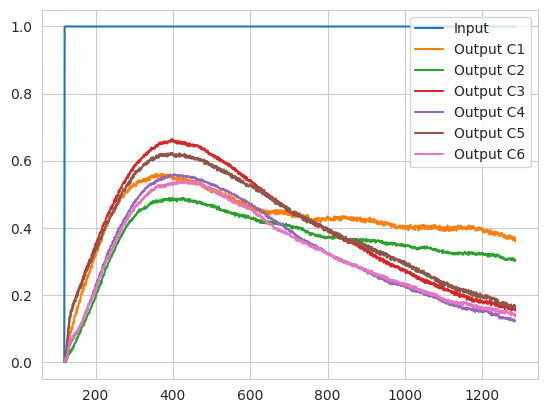

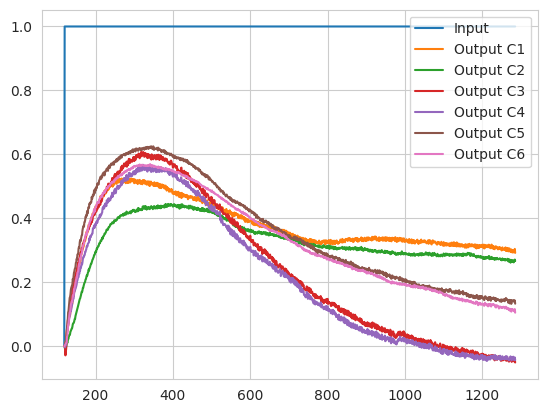

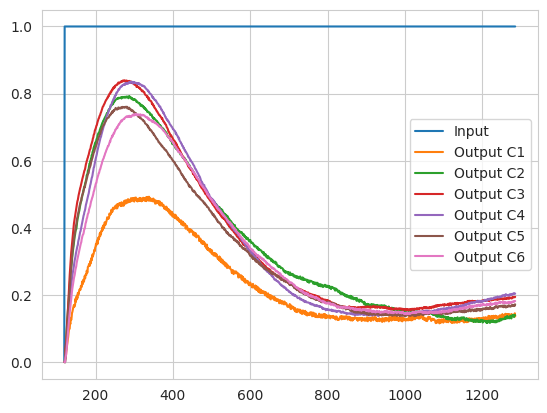

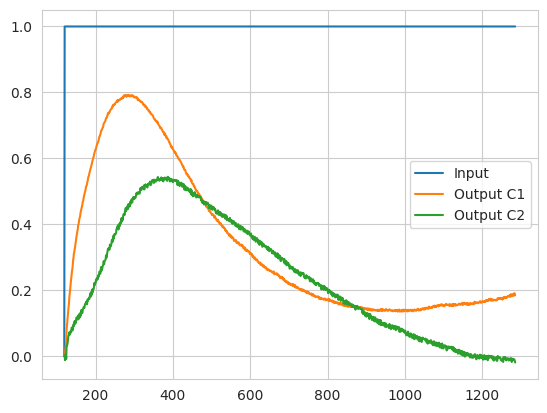

In [ ]:
for variation in [M_334_df, M_343_df, WT_df]:
  i= 0
  if variation.iloc[:, i].all() == variation.iloc[:, i+2].all() == variation.iloc[:, i+4].all() == variation.iloc[:, i+6].all() == variation.iloc[:, i+8].all() == variation.iloc[:, i+10].all():
      print('Inputs are all the Equal!')



for variation in [M_334_df, M_343_df, WT_df, Unknown_df]:
  counter = 1
  #input = variation.iloc[119:, 0] # Access column by index using iloc
  #plt.plot(input, label='Input'.format(counter))
  input = variation.iloc[119:, 0] # Access column by index using iloc
  plt.plot(input, label='Input'.format(counter))
  for i in range(0,len(variation.columns),2): #0,2,..8,10 (6X)
    #variation.iloc[:, i] = variation.iloc[:, i] - variation.iloc[:, i].min()
    #variation.iloc[:, i] = variation.iloc[:, i] - variation.iloc[:, i].mean()
    #variation.iloc[:, i] = variation.iloc[:, i] / variation.iloc[:, i].std()

    output = variation.iloc[119:, i+1] # Access next column for output



    plt.plot(output, label='Output C{}'.format(counter))
    plt.legend()
    counter += 1
  plt.show()





In [ ]:
#1ºData Preparation
#Pre-processing && Ploting
for lists in [Mutant_334_list,Mutant_343_list,WildType_list,UnknownType_list]:
  pds = pd.DataFrame(columns=['Input','Output'])


#Remove the first 119 values (0 or 1) for all the datasets and reset the index for 0
all_datasets_df = [df.iloc[119:].reset_index(drop=True) for df in [M_334_df, M_343_df, WT_df, Unknown_df]]


# 2. System identification

In [ ]:
data = [M_334_df, M_343_df, WT_df, Unknown_df][i]
data

,u_C1,y_C1,u_C2,y_C2,u_C3,y_C3,u_C4,y_C4,u_C5,y_C5,u_C6,y_C6
0,0,0.00000,0,0.00000,0,0.00000,0,0.00000,0,0.00000,0,0.00000
1,0,0.00000,0,0.00000,0,0.00000,0,0.00000,0,0.00000,0,0.00000
2,0,0.00000,0,0.00000,0,0.00000,0,0.00000,0,0.00000,0,0.00000
3,0,0.00000,0,0.00000,0,0.00000,0,0.00000,0,0.00000,0,0.00000
4,0,0.00000,0,0.00000,0,0.00000,0,0.00000,0,0.00000,0,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...
1281,1,0.13916,1,0.13859,1,0.19373,1,0.20339,1,0.16927,1,0.18023
1282,1,0.13626,1,0.13378,1,0.19409,1,0.20399,1,0.16765,1,0.17953
1283,1,0.14153,1,0.14058,1,0.19328,1,0.20335,1,0.17064,1,0.18141
1284,1,0.14536,1,0.13916,1,0.19274,1,0.20446,1,0.16757,1,0.18138


In [ ]:
na_max = nb_max = xdelay_max = 4
model_count=0
code_name = ["M_334","M_343","WT","Unknown"]
all_datasets_df = [df.iloc[119:].reset_index(drop=True) for df in [M_334_df, M_343_df, WT_df, Unknown_df]]

final_results_df = pd.DataFrame(columns=['Athlete_Code','Model_Index','na','nb','d','AIC','Rsq','RMSE','BIC','FPE','Parameters_a','Parameters_b'])

##Loop through parameters
#Starts 1:1:0 .... 3,3,3               (1,na_max|1,nb_max|xdelay_max) (max=4)
#Starts 1:1:0 .... 4,4,4               (1,na_max+1|1,nb_max+1|xdelay_max+1)(max=4)
#Starts 0:1:0 .... 3,4,4               (na_max|1,nb_max+1|xdelay_max+1)(max=4)
counter = nm_count = 0
for variation in [M_334_df, M_343_df, WT_df, Unknown_df]:

  for i in range(0,len(variation.columns),2):
    input = variation.columns[i]
    output = variation.columns[i+1]
    data = pd.concat([variation[input].rename("u"), variation[output].rename("y")], axis=1)
    model_counter = 0

    for na in range(na_max):
      for nb in range(1,nb_max+1):
        for d in range(xdelay_max+1):
          #print(data)
          #Calculate Model
          y_loader, ysim, parameters_a, parameters_b, SSG, tau, r_squared, aic, Rmse, bic, fpe = model_generator(data, na, nb, d)

          #Save Results
          new_row = pd.DataFrame({'Athlete_Code': code_name[nm_count-1],'Model_Index': [model_counter], 'na': [na], 'nb': [nb], 'd': [d], 'AIC': [aic], 'Rsq': [r_squared],'RMSE':[Rmse], 'BIC':[bic],'FPE':[fpe], 'Parameters_a':[parameters_a], 'Parameters_b':[parameters_b]})
          final_results_df = pd.concat([final_results_df, new_row], ignore_index=True)


          model_counter += 1
  nm_count += 1







Model with 0 a parameters, 1 b parameters and 0 time delay
   u-0
0    0
1    0
2    0
3    0
4    0
5    0
6    0
7    0
8    0
9    0
New X:
   u-0
2    0
3    0
4    0
5    0
6    0

Model with 0 a parameters, 1 b parameters and 1 time delay
   u-1
0  NaN
1  0.0
2  0.0
3  0.0
4  0.0
5  0.0
6  0.0
7  0.0
8  0.0
9  0.0
New X:
   u-1
4  0.0
5  0.0
6  0.0
7  0.0
8  0.0

Model with 0 a parameters, 1 b parameters and 2 time delay
   u-2
0  NaN
1  NaN
2  0.0
3  0.0
4  0.0
5  0.0
6  0.0
7  0.0
8  0.0
9  0.0
New X:
    u-2
6   0.0
7   0.0
8   0.0
9   0.0
10  0.0

Model with 0 a parameters, 1 b parameters and 3 time delay
   u-3
0  NaN
1  NaN
2  NaN
3  0.0
4  0.0
5  0.0
6  0.0
7  0.0
8  0.0
9  0.0
New X:
    u-3
8   0.0
9   0.0
10  0.0
11  0.0
12  0.0

Model with 0 a parameters, 1 b parameters and 4 time delay
   u-4
0  NaN
1  NaN
2  NaN
3  NaN
4  0.0
5  0.0
6  0.0
7  0.0
8  0.0
9  0.0
New X:
    u-4
10  0.0
11  0.0
12  0.0
13  0.0
14  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-68-5b892106e006>:30: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  final_results_df = pd.concat([final_results_df, new_row], ignore_index=True)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero 


Model with 0 a parameters, 2 b parameters and 0 time delay
   u-0  u-1
0    0  NaN
1    0  0.0
2    0  0.0
3    0  0.0
4    0  0.0
5    0  0.0
6    0  0.0
7    0  0.0
8    0  0.0
9    0  0.0
New X:
   u-0  u-1
4    0  0.0
5    0  0.0
6    0  0.0
7    0  0.0
8    0  0.0

Model with 0 a parameters, 2 b parameters and 1 time delay
   u-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 2 b parameters and 2 time delay
   u-2  u-3
0  NaN  NaN
1  NaN  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-2  u-3
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0

Model with 0 a parameters, 2 b parameters and 3 time delay
   u-3  u-4
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  0.0  NaN
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-3  u-4
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0

Model with 0 a parameters, 2 b parameters and 4 time delay


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


   u-4  u-5
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  NaN  NaN
4  0.0  NaN
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-4  u-5
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0
15  0.0  0.0
16  0.0  0.0

Model with 0 a parameters, 3 b parameters and 0 time delay
   u-0  u-1  u-2
0    0  NaN  NaN
1    0  0.0  NaN
2    0  0.0  0.0
3    0  0.0  0.0
4    0  0.0  0.0
5    0  0.0  0.0
6    0  0.0  0.0
7    0  0.0  0.0
8    0  0.0  0.0
9    0  0.0  0.0
New X:
    u-0  u-1  u-2
6     0  0.0  0.0
7     0  0.0  0.0
8     0  0.0  0.0
9     0  0.0  0.0
10    0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 1 time delay
   u-1  u-2  u-3
0  NaN  NaN  NaN
1  0.0  NaN  NaN
2  0.0  0.0  NaN
3  0.0  0.0  0.0
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-1  u-2  u-3
8   0.0  0.0  0.0
9   0.0  0.0  0.0
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 2 time delay
   u-2  u-3  u-4
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  0.0  NaN  NaN
3  0.0  0.0  NaN
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-2  u-3  u-4
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 3 time delay
   u-3  u-4  u-5
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  0.0  NaN  NaN
4  0.0  0.0  NaN
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-3  u-4  u-5
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 4 time delay
   u-4  u-5  u-6
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  NaN  NaN  NaN
4  0.0  NaN  NaN
5  0.0  0.0  NaN
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-4  u-5  u-6
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0
17  0.0  0.0  0.0
18  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 0 time delay


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


   u-0  u-1  u-2  u-3
0    0  NaN  NaN  NaN
1    0  0.0  NaN  NaN
2    0  0.0  0.0  NaN
3    0  0.0  0.0  0.0
4    0  0.0  0.0  0.0
5    0  0.0  0.0  0.0
6    0  0.0  0.0  0.0
7    0  0.0  0.0  0.0
8    0  0.0  0.0  0.0
9    0  0.0  0.0  0.0
New X:
    u-0  u-1  u-2  u-3
8     0  0.0  0.0  0.0
9     0  0.0  0.0  0.0
10    0  0.0  0.0  0.0
11    0  0.0  0.0  0.0
12    0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 1 time delay
   u-1  u-2  u-3  u-4
0  NaN  NaN  NaN  NaN
1  0.0  NaN  NaN  NaN
2  0.0  0.0  NaN  NaN
3  0.0  0.0  0.0  NaN
4  0.0  0.0  0.0  0.0
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-1  u-2  u-3  u-4
10  0.0  0.0  0.0  0.0
11  0.0  0.0  0.0  0.0
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 2 time delay
   u-2  u-3  u-4  u-5
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  0.0  NaN  NaN  NaN
3  0.0  0.0  NaN  NaN
4  0.0  0.0  0.0  NaN
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-2  u-3  u-4  u-5
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 3 time delay
   u-3  u-4  u-5  u-6
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  0.0  NaN  NaN  NaN
4  0.0  0.0  NaN  NaN
5  0.0  0.0  0.0  NaN
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-3  u-4  u-5  u-6
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 4 time delay
   u-4  u-5  u-6  u-7
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  NaN  NaN  NaN  NaN
4  0.0  NaN  NaN  NaN
5  0.0  0.0  NaN  NaN
6  0.0  0.0  0.0  NaN
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-4  u-5  u-6  u-7
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0
19  0.0  0.0  0.0  0.0
20  0.0  0.0  0.0  0.0

Model with 1 a parameters, 1 b parameters and 0 time delay
   y-1  u-0
0  NaN    0
1  0.0    0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0
7  0.0    0
8  0.0    0
9  0.0    0
New X:
   y-1  u-0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 1 a parameters, 1 b parameters and 1 time delay
   y-1  u-1
0  NaN  NaN
1  0.0  0.0
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
   y-1  u-1
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0

Model with 1 a parameters, 1 b parameters and 2 time delay
   y-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    y-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 1 a parameters, 1 b parameters and 3 time delay
   y-1  u-3
0  NaN  NaN
1  0.0  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    y-1  u-3
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0

Model with 1 a parameters, 1 b parameters and 4 time delay
   y-1  u-4
0  NaN  NaN
1  0.0  NaN
2  0.0  NaN
3  0.0  NaN
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 1 b parameters and 4 time delay
   u-4
0  NaN
1  NaN
2  NaN
3  NaN
4  0.0
5  0.0
6  0.0
7  0.0
8  0.0
9  0.0
New X:
    u-4
10  0.0
11  0.0
12  0.0
13  0.0
14  0.0

Model with 0 a parameters, 2 b parameters and 0 time delay
   u-0  u-1
0    0  NaN
1    0  0.0
2    0  0.0
3    0  0.0
4    0  0.0
5    0  0.0
6    0  0.0
7    0  0.0
8    0  0.0
9    0  0.0
New X:
   u-0  u-1
4    0  0.0
5    0  0.0
6    0  0.0
7    0  0.0
8    0  0.0

Model with 0 a parameters, 2 b parameters and 1 time delay
   u-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 2 b parameters and 2 time delay
   u-2  u-3
0  NaN  NaN
1  NaN  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-2  u-3
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0

Model with 0 a parameters, 2 b parameters and 3 time delay
   u-3  u-4
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  0.0  NaN
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-3  u-4
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0

Model with 0 a parameters, 2 b parameters and 4 time delay


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


   u-4  u-5
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  NaN  NaN
4  0.0  NaN
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-4  u-5
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0
15  0.0  0.0
16  0.0  0.0

Model with 0 a parameters, 3 b parameters and 0 time delay
   u-0  u-1  u-2
0    0  NaN  NaN
1    0  0.0  NaN
2    0  0.0  0.0
3    0  0.0  0.0
4    0  0.0  0.0
5    0  0.0  0.0
6    0  0.0  0.0
7    0  0.0  0.0
8    0  0.0  0.0
9    0  0.0  0.0
New X:
    u-0  u-1  u-2
6     0  0.0  0.0
7     0  0.0  0.0
8     0  0.0  0.0
9     0  0.0  0.0
10    0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 1 time delay
   u-1  u-2  u-3
0  NaN  NaN  NaN
1  0.0  NaN  NaN
2  0.0  0.0  NaN
3  0.0  0.0  0.0
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-1  u-2  u-3
8   0.0  0.0  0.0
9   0.0  0.0  0.0
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 2 time delay
   u-2  u-3  u-4
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  0.0  NaN  NaN
3  0.0  0.0  NaN
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-2  u-3  u-4
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 3 time delay
   u-3  u-4  u-5
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  0.0  NaN  NaN
4  0.0  0.0  NaN
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-3  u-4  u-5
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 4 time delay
   u-4  u-5  u-6
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  NaN  NaN  NaN
4  0.0  NaN  NaN
5  0.0  0.0  NaN
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-4  u-5  u-6
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0
17  0.0  0.0  0.0
18  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 0 time delay
   u-0  u-1  u-2  u-3
0    0  NaN  NaN  NaN
1    0  0.0  NaN  NaN
2    0  0.0  0.0  NaN
3    0  0.0  0.0  0.0
4    0  0.0  0.0  0.0
5    0  0.0  0.0  0.0
6    0  0.0  0.0  0.0
7    0  0.0  0.0  0.0
8    0  0.0  0.0  0.0
9    0  0.0  0.0  0.0
New X:
    u-0  u-1  u-2  u-3
8     0  0.0  0.0  0.0
9     0  0.0  0.0  0.0
10    0  0.0  0.0  0.0
11    0  0.0  0.0  0.0
12    0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 1 time delay
   u-1  u-2  u-3  u-4
0  NaN  NaN  NaN  NaN
1  0.0  NaN  NaN  NaN
2  0.0  0.0  NaN  NaN
3  0.0  0.0  0.0  NaN
4  0.0  0.0  0.0  0.0

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 2 time delay
   u-2  u-3  u-4  u-5
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  0.0  NaN  NaN  NaN
3  0.0  0.0  NaN  NaN
4  0.0  0.0  0.0  NaN
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-2  u-3  u-4  u-5
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 3 time delay
   u-3  u-4  u-5  u-6
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  0.0  NaN  NaN  NaN
4  0.0  0.0  NaN  NaN
5  0.0  0.0  0.0  NaN
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-3  u-4  u-5  u-6
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 4 time delay
   u-4  u-5  u-6  u-7
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  NaN  NaN  NaN  NaN
4  0.0  NaN  NaN  NaN
5  0.0  0.0  NaN  NaN
6  0.0  0.0  0.0  NaN
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-4  u-5  u-6  u-7
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0
19  0.0  0.0  0.0  0.0
20  0.0  0.0  0.0  0.0

Model with 1 a parameters, 1 b parameters and 0 time delay
   y-1  u-0
0  NaN    0
1  0.0    0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0
7  0.0    0
8  0.0    0
9  0.0    0
New X:
   y-1  u-0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 1 a parameters, 1 b parameters and 1 time delay
   y-1  u-1
0  NaN  NaN
1  0.0  0.0
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
   y-1  u-1
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0

Model with 1 a parameters, 1 b parameters and 2 time delay
   y-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    y-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 1 a parameters, 1 b parameters and 3 time delay
   y-1  u-3
0  NaN  NaN
1  0.0  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    y-1  u-3
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0

Model with 1 a parameters, 1 b parameters and 4 time delay
   y-1  u-4
0  NaN  NaN
1  0.0  NaN
2  0.0  NaN
3  0.0  NaN
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 1 b parameters and 4 time delay
   u-4
0  NaN
1  NaN
2  NaN
3  NaN
4  0.0
5  0.0
6  0.0
7  0.0
8  0.0
9  0.0
New X:
    u-4
10  0.0
11  0.0
12  0.0
13  0.0
14  0.0

Model with 0 a parameters, 2 b parameters and 0 time delay
   u-0  u-1
0    0  NaN
1    0  0.0
2    0  0.0
3    0  0.0
4    0  0.0
5    0  0.0
6    0  0.0
7    0  0.0
8    0  0.0
9    0  0.0
New X:
   u-0  u-1
4    0  0.0
5    0  0.0
6    0  0.0
7    0  0.0
8    0  0.0

Model with 0 a parameters, 2 b parameters and 1 time delay
   u-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 0 a parameters, 2 b parameters and 2 time delay

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



   u-2  u-3
0  NaN  NaN
1  NaN  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-2  u-3
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0

Model with 0 a parameters, 2 b parameters and 3 time delay
   u-3  u-4
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  0.0  NaN
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-3  u-4
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 2 b parameters and 4 time delay
   u-4  u-5
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  NaN  NaN
4  0.0  NaN
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-4  u-5
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0
15  0.0  0.0
16  0.0  0.0

Model with 0 a parameters, 3 b parameters and 0 time delay
   u-0  u-1  u-2
0    0  NaN  NaN
1    0  0.0  NaN
2    0  0.0  0.0
3    0  0.0  0.0
4    0  0.0  0.0
5    0  0.0  0.0
6    0  0.0  0.0
7    0  0.0  0.0
8    0  0.0  0.0
9    0  0.0  0.0
New X:
    u-0  u-1  u-2
6     0  0.0  0.0
7     0  0.0  0.0
8     0  0.0  0.0
9     0  0.0  0.0
10    0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 1 time delay
   u-1  u-2  u-3
0  NaN  NaN  NaN
1  0.0  NaN  NaN
2  0.0  0.0  NaN
3  0.0  0.0  0.0
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-1  u-2  u-3
8   0.0  0.0  0.0
9   0.0  0.0  0.0
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 2 time delay
   u-2  u-3  u-4
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  0.0  NaN  NaN
3  0.0  0.0  NaN
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-2  u-3  u-4
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 3 time delay
   u-3  u-4  u-5
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  0.0  NaN  NaN
4  0.0  0.0  NaN
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-3  u-4  u-5
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 4 time delay
   u-4  u-5  u-6
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  NaN  NaN  NaN
4  0.0  NaN  NaN
5  0.0  0.0  NaN
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-4  u-5  u-6
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0
17  0.0  0.0  0.0
18  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 0 time delay
   u-0  u-1  u-2  u-3
0    0  NaN  NaN  NaN
1    0  0.0  NaN  NaN
2    0  0.0  0.0  NaN
3    0  0.0  0.0  0.0
4    0  0.0  0.0  0.0
5    0  0.0  0.0  0.0
6    0  0.0  0.0  0.0
7    0  0.0  0.0  0.0
8    0  0.0  0.0  0.0
9    0  0.0  0.0  0.0
New X:
    u-0  u-1  u-2  u-3
8     0  0.0  0.0  0.0
9     0  0.0  0.0  0.0
10    0  0.0  0.0  0.0
11    0  0.0  0.0  0.0
12    0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 1 time delay
   u-1  u-2  u-3  u-4
0  NaN  NaN  NaN  NaN
1  0.0  NaN  NaN  NaN
2  0.0  0.0  NaN  NaN
3  0.0  0.0  0.0  NaN
4  0.0  0.0  0.0  0.0
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-1  u-2  u-3  u-4
10  0.0  0.0  0.0  0.0
11  0.0  0.0  0.0  0.0
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 2 time delay
   u-2  u-3  u-4  u-5
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  0.0  NaN  NaN  NaN
3  0.0  0.0  NaN  NaN
4  0.0  0.0  0.0  NaN
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-2  u-3  u-4  u-5
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 3 time delay
   u-3  u-4  u-5  u-6
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  0.0  NaN  NaN  NaN
4  0.0  0.0  NaN  NaN
5  0.0  0.0  0.0  NaN
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-3  u-4  u-5  u-6
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 4 time delay
   u-4  u-5  u-6  u-7
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  NaN  NaN  NaN  NaN
4  0.0  NaN  NaN  NaN
5  0.0  0.0  NaN  NaN
6  0.0  0.0  0.0  NaN
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-4  u-5  u-6  u-7
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0
19  0.0  0.0  0.0  0.0
20  0.0  0.0  0.0  0.0

Model with 1 a parameters, 1 b parameters and 0 time delay
   y-1  u-0
0  NaN    0
1  0.0    0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0
7  0.0    0
8  0.0    0
9  0.0    0
New X:
   y-1  u-0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0

Model with 1 a parameters, 1 b parameters and 1 time delay
   y-1  u-1
0  NaN  NaN
1  0.0  0.0
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
   y-1  u-1
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0

Model with

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 2 b parameters and 1 time delay
   u-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 0 a parameters, 2 b parameters and 2 time delay
   u-2  u-3
0  NaN  NaN
1  NaN  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-2  u-3
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0

Model with 0 a parameters, 2 b parameters and 3 time delay
   u-3  u-4
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  0.0  NaN
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-3  u-4
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0

Model with 0 a parameters, 2 b parameters and 4 time delay


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


   u-4  u-5
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  NaN  NaN
4  0.0  NaN
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-4  u-5
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0
15  0.0  0.0
16  0.0  0.0

Model with 0 a parameters, 3 b parameters and 0 time delay
   u-0  u-1  u-2
0    0  NaN  NaN
1    0  0.0  NaN
2    0  0.0  0.0
3    0  0.0  0.0
4    0  0.0  0.0
5    0  0.0  0.0
6    0  0.0  0.0
7    0  0.0  0.0
8    0  0.0  0.0
9    0  0.0  0.0
New X:
    u-0  u-1  u-2
6     0  0.0  0.0
7     0  0.0  0.0
8     0  0.0  0.0
9     0  0.0  0.0
10    0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 1 time delay
   u-1  u-2  u-3
0  NaN  NaN  NaN
1  0.0  NaN  NaN
2  0.0  0.0  NaN
3  0.0  0.0  0.0
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-1  u-2  u-3
8   0.0  0.0  0.0
9   0.0  0.0  0.0
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 2 time delay
   u-2  u-3  u-4
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  0.0  NaN  NaN
3  0.0  0.0  NaN
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-2  u-3  u-4
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 3 time delay
   u-3  u-4  u-5
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  0.0  NaN  NaN
4  0.0  0.0  NaN
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-3  u-4  u-5
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 4 time delay
   u-4  u-5  u-6
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  NaN  NaN  NaN
4  0.0  NaN  NaN
5  0.0  0.0  NaN
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-4  u-5  u-6
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0
17  0.0  0.0  0.0
18  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 0 time delay
   u-0  u-1  u-2  u-3
0    0  NaN  NaN  NaN
1    0  0.0  NaN  NaN
2    0  0.0  0.0  NaN
3    0  0.0  0.0  0.0
4    0  0.0  0.0  0.0
5    0  0.0  0.0  0.0
6    0  0.0  0.0  0.0
7    0  0.0  0.0  0.0
8    0  0.0  0.0  0.0
9    0  0.0  0.0  0.0
New X:
    u-0  u-1  u-2  u-3
8     0  0.0  0.0  0.0
9     0  0.0  0.0  0.0
10    0  0.0  0.0  0.0
11    0  0.0  0.0  0.0
12    0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 1 time delay
   u-1  u-2  u-3  u-4
0  NaN  NaN  NaN  NaN
1  0.0  NaN  NaN  NaN
2  0.0  0.0  NaN  NaN
3  0.0  0.0  0.0  NaN
4  0.0  0.0  0.0  0.0
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-1  u-2  u-3  u-4
10  0.0  0.0  0.0  0.0
11  0.0  0.0  0.0  0.0
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 2 time delay
   u-2  u-3  u-4  u-5
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  0.0  NaN  NaN  NaN
3  0.0  0.0  NaN  NaN
4  0.0  0.0  0.0  NaN
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-2  u-3  u-4  u-5
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 3 time delay
   u-3  u-4  u-5  u-6
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  0.0  NaN  NaN  NaN
4  0.0  0.0  NaN  NaN
5  0.0  0.0  0.0  NaN
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-3  u-4  u-5  u-6
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 4 time delay
   u-4  u-5  u-6  u-7
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  NaN  NaN  NaN  NaN
4  0.0  NaN  NaN  NaN
5  0.0  0.0  NaN  NaN
6  0.0  0.0  0.0  NaN
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-4  u-5  u-6  u-7
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0
19  0.0  0.0  0.0  0.0
20  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 1 a parameters, 1 b parameters and 0 time delay
   y-1  u-0
0  NaN    0
1  0.0    0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0
7  0.0    0
8  0.0    0
9  0.0    0
New X:
   y-1  u-0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0

Model with 1 a parameters, 1 b parameters and 1 time delay
   y-1  u-1
0  NaN  NaN
1  0.0  0.0
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
   y-1  u-1
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0

Model with 1 a parameters, 1 b parameters and 2 time delay
   y-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    y-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 1 a parameters, 1 b parameters and 3 time delay
   y-1  u-3
0  NaN  NaN
1  0.0  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 1 b parameters and 3 time delay
   u-3
0  NaN
1  NaN
2  NaN
3  0.0
4  0.0
5  0.0
6  0.0
7  0.0
8  0.0
9  0.0
New X:
    u-3
8   0.0
9   0.0
10  0.0
11  0.0
12  0.0

Model with 0 a parameters, 1 b parameters and 4 time delay
   u-4
0  NaN
1  NaN
2  NaN
3  NaN
4  0.0
5  0.0
6  0.0
7  0.0
8  0.0
9  0.0
New X:
    u-4
10  0.0
11  0.0
12  0.0
13  0.0
14  0.0

Model with 0 a parameters, 2 b parameters and 0 time delay
   u-0  u-1
0    0  NaN
1    0  0.0
2    0  0.0
3    0  0.0
4    0  0.0
5    0  0.0
6    0  0.0
7    0  0.0
8    0  0.0
9    0  0.0
New X:
   u-0  u-1
4    0  0.0
5    0  0.0
6    0  0.0
7    0  0.0
8    0  0.0

Model with 0 a parameters, 2 b parameters and 1 time delay
   u-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 0 a parameters, 2 b parameters and 2 time delay
   u-2  

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 2 b parameters and 3 time delay
   u-3  u-4
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  0.0  NaN
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-3  u-4
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0

Model with 0 a parameters, 2 b parameters and 4 time delay
   u-4  u-5
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  NaN  NaN
4  0.0  NaN
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-4  u-5
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0
15  0.0  0.0
16  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 0 time delay
   u-0  u-1  u-2
0    0  NaN  NaN
1    0  0.0  NaN
2    0  0.0  0.0
3    0  0.0  0.0
4    0  0.0  0.0
5    0  0.0  0.0
6    0  0.0  0.0
7    0  0.0  0.0
8    0  0.0  0.0
9    0  0.0  0.0
New X:
    u-0  u-1  u-2
6     0  0.0  0.0
7     0  0.0  0.0
8     0  0.0  0.0
9     0  0.0  0.0
10    0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 1 time delay
   u-1  u-2  u-3
0  NaN  NaN  NaN
1  0.0  NaN  NaN
2  0.0  0.0  NaN
3  0.0  0.0  0.0
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-1  u-2  u-3
8   0.0  0.0  0.0
9   0.0  0.0  0.0
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 2 time delay
   u-2  u-3  u-4
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  0.0  NaN  NaN
3  0.0  0.0  NaN
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-2  u-3  u-4
10  

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 3 time delay
   u-3  u-4  u-5
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  0.0  NaN  NaN
4  0.0  0.0  NaN
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-3  u-4  u-5
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 4 time delay
   u-4  u-5  u-6
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  NaN  NaN  NaN
4  0.0  NaN  NaN
5  0.0  0.0  NaN
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-4  u-5  u-6
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0
17  0.0  0.0  0.0
18  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 0 time delay
   u-0  u-1  u-2  u-3
0    0  NaN  NaN  NaN
1    0  0.0  NaN  NaN
2    0  0.0  0.0  NaN
3    0  0.0  0.0  0.0
4    0  0.0  0.0  0.0
5    0  0.0  0.0  0.0
6    0  0.0  0.0  0.0
7    0  0.0  0.0  0.0
8    0  0.0  0.0  0.0
9    0  0.0  0.0  0.0
New X:
    u-0  u-1  u-2  u-3
8     0  0.0  0.0  0.0
9     0  0.0  0.0  0.0
10    0  0.0  0.0  0.0
11    0  0.0  0.0  0.0
12    0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 1 time delay
   u-1  u-2  u-3  u-4
0  NaN  NaN  NaN  NaN
1  0.0  NaN  NaN  NaN
2  0.0  0.0  NaN  NaN
3  0.0  0.0  0.0  NaN
4  0.0  0.0  0.0  0.0
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-1  u-2  u-3  u-4
10  0.0  0.0  0.0  0.0
11  0.0  0.0  0.0  0.0
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 2 time delay
   u-2  u-3  u-4  u-5
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  0.0  NaN  NaN  NaN
3  0.0  0.0  NaN  NaN
4  0.0  0.0  0.0  NaN
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-2  u-3  u-4  u-5
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 3 time delay
   u-3  u-4  u-5  u-6
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  0.0  NaN  NaN  NaN
4  0.0  0.0  NaN  NaN
5  0.0  0.0  0.0  NaN
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-3  u-4  u-5  u-6
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 4 time delay
   u-4  u-5  u-6  u-7
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  NaN  NaN  NaN  NaN
4  0.0  NaN  NaN  NaN
5  0.0  0.0  NaN  NaN
6  0.0  0.0  0.0  NaN
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-4  u-5  u-6  u-7
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0
19  0.0  0.0  0.0  0.0
20  0.0  0.0  0.0  0.0

Model with 1 a parameters, 1 b parameters and 0 time delay
   y-1  u-0
0  NaN    0
1  0.0    0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0
7  0.0    0
8  0.0    0
9  0.0    0
New X:
   y-1  u-0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0

Model with 1 a parameters, 1 b parameters and 1 time delay
   y-1  u-1
0  NaN  NaN
1  0.0  0.0
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
   y-1  u-1
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0

Model with

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 1 b parameters and 3 time delay
   u-3
0  NaN
1  NaN
2  NaN
3  0.0
4  0.0
5  0.0
6  0.0
7  0.0
8  0.0
9  0.0
New X:
    u-3
8   0.0
9   0.0
10  0.0
11  0.0
12  0.0

Model with 0 a parameters, 1 b parameters and 4 time delay
   u-4
0  NaN
1  NaN
2  NaN
3  NaN
4  0.0
5  0.0
6  0.0
7  0.0
8  0.0
9  0.0
New X:
    u-4
10  0.0
11  0.0
12  0.0
13  0.0
14  0.0

Model with 0 a parameters, 2 b parameters and 0 time delay
   u-0  u-1
0    0  NaN
1    0  0.0
2    0  0.0
3    0  0.0
4    0  0.0
5    0  0.0
6    0  0.0
7    0  0.0
8    0  0.0
9    0  0.0
New X:
   u-0  u-1
4    0  0.0
5    0  0.0
6    0  0.0
7    0  0.0
8    0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 2 b parameters and 1 time delay
   u-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 0 a parameters, 2 b parameters and 2 time delay
   u-2  u-3
0  NaN  NaN
1  NaN  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-2  u-3
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 2 b parameters and 3 time delay
   u-3  u-4
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  0.0  NaN
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-3  u-4
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0

Model with 0 a parameters, 2 b parameters and 4 time delay
   u-4  u-5
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  NaN  NaN
4  0.0  NaN
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-4  u-5
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0
15  0.0  0.0
16  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 0 time delay
   u-0  u-1  u-2
0    0  NaN  NaN
1    0  0.0  NaN
2    0  0.0  0.0
3    0  0.0  0.0
4    0  0.0  0.0
5    0  0.0  0.0
6    0  0.0  0.0
7    0  0.0  0.0
8    0  0.0  0.0
9    0  0.0  0.0
New X:
    u-0  u-1  u-2
6     0  0.0  0.0
7     0  0.0  0.0
8     0  0.0  0.0
9     0  0.0  0.0
10    0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 1 time delay
   u-1  u-2  u-3
0  NaN  NaN  NaN
1  0.0  NaN  NaN
2  0.0  0.0  NaN
3  0.0  0.0  0.0
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-1  u-2  u-3
8   0.0  0.0  0.0
9   0.0  0.0  0.0
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 2 time delay
   u-2  u-3  u-4
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  0.0  NaN  NaN
3  0.0  0.0  NaN
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-2  u-3  u-4
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 3 time delay
   u-3  u-4  u-5
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  0.0  NaN  NaN
4  0.0  0.0  NaN
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-3  u-4  u-5
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 4 time delay
   u-4  u-5  u-6
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  NaN  NaN  NaN
4  0.0  NaN  NaN
5  0.0  0.0  NaN
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-4  u-5  u-6
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0
17  0.0  0.0  0.0
18  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 0 time delay
   u-0  u-1  u-2  u-3
0    0  NaN  NaN  NaN
1    0  0.0  NaN  NaN
2    0  0.0  0.0  NaN
3    0  0.0  0.0  0.0
4    0  0.0  0.0  0.0
5    0  0.0  0.0  0.0
6    0  0.0  0.0  0.0
7    0  0.0  0.0  0.0
8    0  0.0  0.0  0.0
9    0  0.0  0.0  0.0
New X:
    u-0  u-1  u-2  u-3
8     0  0.0  0.0  0.0
9     0  0.0  0.0  0.0
10    0  0.0  0.0  0.0
11    0  0.0  0.0  0.0
12    0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 1 time delay
   u-1  u-2  u-3  u-4
0  NaN  NaN  NaN  NaN
1  0.0  NaN  NaN  NaN
2  0.0  0.0  NaN  NaN
3  0.0  0.0  0.0  NaN
4  0.0  0.0  0.0  0.0
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-1  u-2  u-3  u-4
10  0.0  0.0  0.0  0.0
11  0.0  0.0  0.0  0.0
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 2 time delay
   u-2  u-3  u-4  u-5
0  NaN  NaN  NaN  NaN
1 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)




Model with 0 a parameters, 4 b parameters and 3 time delay
   u-3  u-4  u-5  u-6
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  0.0  NaN  NaN  NaN
4  0.0  0.0  NaN  NaN
5  0.0  0.0  0.0  NaN
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-3  u-4  u-5  u-6
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 4 time delay
   u-4  u-5  u-6  u-7
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  NaN  NaN  NaN  NaN
4  0.0  NaN  NaN  NaN
5  0.0  0.0  NaN  NaN
6  0.0  0.0  0.0  NaN
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-4  u-5  u-6  u-7
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0
19  0.0  0.0  0.0  0.0
20  0.0  0.0  0.0  0.0

Model with 1 a parameters, 1 b parameters and 0 time delay
   y-1  u-0
0  NaN    0
1  0.0    0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0
7  0.0    0
8  0.0    0
9  0.0    0
New X:
   y-1  u-0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0

Model with 1 a parameters, 1 b parameters and 1 time delay
   y-1  u-1
0  NaN  NaN
1  0.0  0.0
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
   y-1  u-1
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0

Model with

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


   u-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 0 a parameters, 2 b parameters and 2 time delay
   u-2  u-3
0  NaN  NaN
1  NaN  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-2  u-3
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0

Model with 0 a parameters, 2 b parameters and 3 time delay
   u-3  u-4
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  0.0  NaN
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-3  u-4
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 2 b parameters and 4 time delay
   u-4  u-5
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  NaN  NaN
4  0.0  NaN
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-4  u-5
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0
15  0.0  0.0
16  0.0  0.0

Model with 0 a parameters, 3 b parameters and 0 time delay
   u-0  u-1  u-2
0    0  NaN  NaN
1    0  0.0  NaN
2    0  0.0  0.0
3    0  0.0  0.0
4    0  0.0  0.0
5    0  0.0  0.0
6    0  0.0  0.0
7    0  0.0  0.0
8    0  0.0  0.0
9    0  0.0  0.0
New X:
    u-0  u-1  u-2
6     0  0.0  0.0
7     0  0.0  0.0
8     0  0.0  0.0
9     0  0.0  0.0
10    0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 1 time delay
   u-1  u-2  u-3
0  NaN  NaN  NaN
1  0.0  NaN  NaN
2  0.0  0.0  NaN
3  0.0  0.0  0.0
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-1  u-2  u-3
8   0.0  0.0  0.0
9   0.0  0.0  0.0
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 2 time delay
   u-2  u-3  u-4
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  0.0  NaN  NaN
3  0.0  0.0  NaN
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-2  u-3  u-4
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 3 time delay
   u-3  u-4  u-5
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  0.0  NaN  NaN
4  0.0  0.0  NaN
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-3  u-4  u-5
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 4 time delay
   u-4  u-5  u-6
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  NaN  NaN  NaN
4  0.0  NaN  NaN
5  0.0  0.0  NaN
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-4  u-5  u-6
14  

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 0 time delay
   u-0  u-1  u-2  u-3
0    0  NaN  NaN  NaN
1    0  0.0  NaN  NaN
2    0  0.0  0.0  NaN
3    0  0.0  0.0  0.0
4    0  0.0  0.0  0.0
5    0  0.0  0.0  0.0
6    0  0.0  0.0  0.0
7    0  0.0  0.0  0.0
8    0  0.0  0.0  0.0
9    0  0.0  0.0  0.0
New X:
    u-0  u-1  u-2  u-3
8     0  0.0  0.0  0.0
9     0  0.0  0.0  0.0
10    0  0.0  0.0  0.0
11    0  0.0  0.0  0.0
12    0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 1 time delay
   u-1  u-2  u-3  u-4
0  NaN  NaN  NaN  NaN
1  0.0  NaN  NaN  NaN
2  0.0  0.0  NaN  NaN
3  0.0  0.0  0.0  NaN
4  0.0  0.0  0.0  0.0
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-1  u-2  u-3  u-4
10  0.0  0.0  0.0  0.0
11  0.0  0.0  0.0  0.0
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 2 time delay
   u-2  u-3  u-4  u-5
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  0.0  NaN  NaN  NaN
3  0.0  0.0  NaN  NaN
4  0.0  0.0  0.0  NaN
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-2  u-3  u-4  u-5
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 3 time delay
   u-3  u-4  u-5  u-6
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  0.0  NaN  NaN  NaN
4  0.0  0.0  NaN  NaN
5  0.0  0.0  0.0  NaN
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-3  u-4  u-5  u-6
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 4 time delay
   u-4  u-5  u-6  u-7
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  NaN  NaN  NaN  NaN
4  0.0  NaN  NaN  NaN
5  0.0  0.0  NaN  NaN
6  0.0  0.0  0.0  NaN
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-4  u-5  u-6  u-7
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0
19  0.0  0.0  0.0  0.0
20  0.0  0.0  0.0  0.0

Model with 1 a parameters, 1 b parameters and 0 time delay
   y-1  u-0
0  NaN    0
1  0.0    0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0
7  0.0    0
8  0.0    0
9  0.0    0
New X:
   y-1  u-0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0

Model with 1 a parameters, 1 b parameters and 1 time delay
   y-1  u-1
0  NaN  NaN
1  0.0  0.0
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
   y-1  u-1
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0

Model with

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



    y-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 1 a parameters, 1 b parameters and 3 time delay
   y-1  u-3
0  NaN  NaN
1  0.0  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    y-1  u-3
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0

Model with 1 a parameters, 1 b parameters and 4 time delay
   y-1  u-4
0  NaN  NaN
1  0.0  NaN
2  0.0  NaN
3  0.0  NaN
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    y-1  u-4
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0

Model with 1 a parameters, 2 b parameters and 0 time delay
   y-1  u-0  u-1
0  NaN    0  NaN
1  0.0    0  0.0
2  0.0    0  0.0
3  0.0    0  0.0
4  0.0    0  0.0
5  0.0    0  0.0
6  0.0    0  0.0
7  0.0    0  0.0
8  0.0    0  0.0
9  0.0    0  0.0
New X:
   y-1  u-0  u-1
4  0.0    0  0.0
5  0.0    0  0.0
6  0.0    0  0.0
7  0.0    0  0.0
8  0.0    0  0.0

Model with

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 1 b parameters and 3 time delay
   u-3
0  NaN
1  NaN
2  NaN
3  0.0
4  0.0
5  0.0
6  0.0
7  0.0
8  0.0
9  0.0
New X:
    u-3
8   0.0
9   0.0
10  0.0
11  0.0
12  0.0

Model with 0 a parameters, 1 b parameters and 4 time delay
   u-4
0  NaN
1  NaN
2  NaN
3  NaN
4  0.0
5  0.0
6  0.0
7  0.0
8  0.0
9  0.0
New X:
    u-4
10  0.0
11  0.0
12  0.0
13  0.0
14  0.0

Model with 0 a parameters, 2 b parameters and 0 time delay
   u-0  u-1
0    0  NaN
1    0  0.0
2    0  0.0
3    0  0.0
4    0  0.0
5    0  0.0
6    0  0.0
7    0  0.0
8    0  0.0
9    0  0.0
New X:
   u-0  u-1
4    0  0.0
5    0  0.0
6    0  0.0
7    0  0.0
8    0  0.0

Model with 0 a parameters, 2 b parameters and 1 time delay
   u-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 0 a parameters, 2 b parameters and 2 time delay


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


   u-2  u-3
0  NaN  NaN
1  NaN  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-2  u-3
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0

Model with 0 a parameters, 2 b parameters and 3 time delay
   u-3  u-4
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  0.0  NaN
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-3  u-4
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0

Model with 0 a parameters, 2 b parameters and 4 time delay
   u-4  u-5
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  NaN  NaN
4  0.0  NaN
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-4  u-5
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0
15  0.0  0.0
16  0.0  0.0

Model with 0 a parameters, 3 b parameters and 0 time delay


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


   u-0  u-1  u-2
0    0  NaN  NaN
1    0  0.0  NaN
2    0  0.0  0.0
3    0  0.0  0.0
4    0  0.0  0.0
5    0  0.0  0.0
6    0  0.0  0.0
7    0  0.0  0.0
8    0  0.0  0.0
9    0  0.0  0.0
New X:
    u-0  u-1  u-2
6     0  0.0  0.0
7     0  0.0  0.0
8     0  0.0  0.0
9     0  0.0  0.0
10    0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 1 time delay
   u-1  u-2  u-3
0  NaN  NaN  NaN
1  0.0  NaN  NaN
2  0.0  0.0  NaN
3  0.0  0.0  0.0
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-1  u-2  u-3
8   0.0  0.0  0.0
9   0.0  0.0  0.0
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 2 time delay
   u-2  u-3  u-4
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  0.0  NaN  NaN
3  0.0  0.0  NaN
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-2  u-3  u-4
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0
13  0.0  0

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 3 time delay
   u-3  u-4  u-5
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  0.0  NaN  NaN
4  0.0  0.0  NaN
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-3  u-4  u-5
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 4 time delay
   u-4  u-5  u-6
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  NaN  NaN  NaN
4  0.0  NaN  NaN
5  0.0  0.0  NaN
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-4  u-5  u-6
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0
17  0.0  0.0  0.0
18  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 0 time delay
   u-0  u-1  u-2  u-3
0    0  NaN  NaN  NaN
1    0  0.0  NaN  NaN
2    0  0.0  0.0  NaN
3    0  0.0  0.0  0.0
4    0  0.0  0.0  0.0
5    0  0.0  0.0  0.0
6    0  0.0  0.0  0.0
7    0  0.0  0.0  0.0
8    0  0.0  0.0  0.0
9    0  0.0  0.0  0.0
New X:
    u-0  u-1  u-2  u-3
8     0  0.0  0.0  0.0
9     0  0.0  0.0  0.0
10    0  0.0  0.0  0.0
11    0  0.0  0.0  0.0
12    0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 1 time delay
   u-1  u-2  u-3  u-4
0  NaN  NaN  NaN  NaN
1  0.0  NaN  NaN  NaN
2  0.0  0.0  NaN  NaN
3  0.0  0.0  0.0  NaN
4  0.0  0.0  0.0  0.0
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-1  u-2  u-3  u-4
10  0.0  0.0  0.0  0.0
11  0.0  0.0  0.0  0.0
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 2 time delay
   u-2  u-3  u-4  u-5
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  0.0  NaN  NaN  NaN
3  0.0  0.0  NaN  NaN
4  0.0  0.0  0.0  NaN
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-2  u-3  u-4  u-5
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 3 time delay
   u-3  u-4  u-5  u-6
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  0.0  NaN  NaN  NaN
4  0.0  0.0  NaN  NaN
5  0.0  0.0  0.0  NaN
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-3  u-4  u-5  u-6
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 4 time delay
   u-4  u-5  u-6  u-7
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  NaN  NaN  NaN  NaN
4  0.0  NaN  NaN  NaN
5  0.0  0.0  NaN  NaN
6  0.0  0.0  0.0  NaN
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-4  u-5  u-6  u-7
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0
19  0.0  0.0  0.0  0.0
20  0.0  0.0  0.0  0.0

Model with 1 a parameters, 1 b parameters and 0 time delay
   y-1  u-0
0  NaN    0
1  0.0    0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0
7  0.0    0
8  0.0    0
9  0.0    0
New X:
   y-1  u-0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0

Model with 1 a parameters, 1 b parameters and 1 time delay
   y-1  u-1
0  NaN  NaN
1  0.0  0.0
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
   y-1  u-1
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0

Model with

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



New X:
    u-3
8   0.0
9   0.0
10  0.0
11  0.0
12  0.0

Model with 0 a parameters, 1 b parameters and 4 time delay
   u-4
0  NaN
1  NaN
2  NaN
3  NaN
4  0.0
5  0.0
6  0.0
7  0.0
8  0.0
9  0.0
New X:
    u-4
10  0.0
11  0.0
12  0.0
13  0.0
14  0.0

Model with 0 a parameters, 2 b parameters and 0 time delay
   u-0  u-1
0    0  NaN
1    0  0.0
2    0  0.0
3    0  0.0
4    0  0.0
5    0  0.0
6    0  0.0
7    0  0.0
8    0  0.0
9    0  0.0
New X:
   u-0  u-1
4    0  0.0
5    0  0.0
6    0  0.0
7    0  0.0
8    0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 2 b parameters and 1 time delay
   u-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 0 a parameters, 2 b parameters and 2 time delay
   u-2  u-3
0  NaN  NaN
1  NaN  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-2  u-3
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0

Model with 0 a parameters, 2 b parameters and 3 time delay
   u-3  u-4
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  0.0  NaN
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-3  u-4
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 2 b parameters and 4 time delay
   u-4  u-5
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  NaN  NaN
4  0.0  NaN
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-4  u-5
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0
15  0.0  0.0
16  0.0  0.0

Model with 0 a parameters, 3 b parameters and 0 time delay
   u-0  u-1  u-2
0    0  NaN  NaN
1    0  0.0  NaN
2    0  0.0  0.0
3    0  0.0  0.0
4    0  0.0  0.0
5    0  0.0  0.0
6    0  0.0  0.0
7    0  0.0  0.0
8    0  0.0  0.0
9    0  0.0  0.0
New X:
    u-0  u-1  u-2
6     0  0.0  0.0
7     0  0.0  0.0
8     0  0.0  0.0
9     0  0.0  0.0
10    0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 1 time delay
   u-1  u-2  u-3
0  NaN  NaN  NaN
1  0.0  NaN  NaN
2  0.0  0.0  NaN
3  0.0  0.0  0.0
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-1  u-2  u-3
8   0.0  0.0  0.0
9   0.0  0.0  0.0
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 2 time delay
   u-2  u-3  u-4
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  0.0  NaN  NaN
3  0.0  0.0  NaN
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-2  u-3  u-4
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 3 time delay
   u-3  u-4  u-5
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  0.0  NaN  NaN
4  0.0  0.0  NaN
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-3  u-4  u-5
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 4 time delay
   u-4  u-5  u-6
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  NaN  NaN  NaN
4  0.0  NaN  NaN
5  0.0  0.0  NaN
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-4  u-5  u-6
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0
17  0.0  0.0  0.0
18  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 0 time delay
   u-0  u-1  u-2  u-3
0    0  NaN  NaN  NaN
1    0  0.0  NaN  NaN
2    0  0.0  0.0  NaN
3    0  0.0  0.0  0.0
4    0  0.0  0.0  0.0
5    0  0.0  0.0  0.0
6    0  0.0  0.0  0.0
7    0  0.0  0.0  0.0
8    0  0.0  0.0  0.0
9    0  0.0  0.0  0.0
New X:
    u-0  u-1  u-2  u-3
8     0  0.0  0.0  0.0
9     0  0.0  0.0  0.0
10    0  0.0  0.0  0.0
11    0  0.0  0.0  0.0
12    0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 1 time delay
   u-1  u-2  u-3  u-4
0  NaN  NaN  NaN  NaN
1  0.0  NaN  NaN  NaN
2  0.0  0.0  NaN  NaN
3  0.0  0.0  0.0  NaN
4  0.0  0.0  0.0  0.0
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-1  u-2  u-3  u-4
10  0.0  0.0  0.0  0.0
11  0.0  0.0  0.0  0.0
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 2 time delay
   u-2  u-3  u-4  u-5
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  0.0  NaN  NaN  NaN
3  0.0  0.0  NaN  NaN
4  0.0  0.0  0.0  NaN
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-2  u-3  u-4  u-5
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 3 time delay
   u-3  u-4  u-5  u-6
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  0.0  NaN  NaN  NaN
4  0.0  0.0  NaN  NaN
5  0.0  0.0  0.0  NaN
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-3  u-4  u-5  u-6
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 4 time delay
   u-4  u-5  u-6  u-7
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  NaN  NaN  NaN  NaN
4  0.0  NaN  NaN  NaN
5  0.0  0.0  NaN  NaN
6  0.0  0.0  0.0  NaN
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-4  u-5  u-6  u-7
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0
19  0.0  0.0  0.0  0.0
20  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 1 a parameters, 1 b parameters and 0 time delay
   y-1  u-0
0  NaN    0
1  0.0    0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0
7  0.0    0
8  0.0    0
9  0.0    0
New X:
   y-1  u-0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0

Model with 1 a parameters, 1 b parameters and 1 time delay
   y-1  u-1
0  NaN  NaN
1  0.0  0.0
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
   y-1  u-1
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0

Model with 1 a parameters, 1 b parameters and 2 time delay
   y-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    y-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 1 a parameters, 1 b parameters and 3 time delay
   y-1  u-3
0  NaN  NaN
1  0.0  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 1 b parameters and 4 time delay
   u-4
0  NaN
1  NaN
2  NaN
3  NaN
4  0.0
5  0.0
6  0.0
7  0.0
8  0.0
9  0.0
New X:
    u-4
10  0.0
11  0.0
12  0.0
13  0.0
14  0.0

Model with 0 a parameters, 2 b parameters and 0 time delay
   u-0  u-1
0    0  NaN
1    0  0.0
2    0  0.0
3    0  0.0
4    0  0.0
5    0  0.0
6    0  0.0
7    0  0.0
8    0  0.0
9    0  0.0
New X:
   u-0  u-1
4    0  0.0
5    0  0.0
6    0  0.0
7    0  0.0
8    0  0.0

Model with 0 a parameters, 2 b parameters and 1 time delay
   u-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 2 b parameters and 2 time delay
   u-2  u-3
0  NaN  NaN
1  NaN  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-2  u-3
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0

Model with 0 a parameters, 2 b parameters and 3 time delay
   u-3  u-4
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  0.0  NaN
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-3  u-4
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0

Model with 0 a parameters, 2 b parameters and 4 time delay
   u-4  u-5
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  NaN  NaN
4  0.0  NaN
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-4  u-5
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0
15  0.0  0.0
16  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 0 time delay
   u-0  u-1  u-2
0    0  NaN  NaN
1    0  0.0  NaN
2    0  0.0  0.0
3    0  0.0  0.0
4    0  0.0  0.0
5    0  0.0  0.0
6    0  0.0  0.0
7    0  0.0  0.0
8    0  0.0  0.0
9    0  0.0  0.0
New X:
    u-0  u-1  u-2
6     0  0.0  0.0
7     0  0.0  0.0
8     0  0.0  0.0
9     0  0.0  0.0
10    0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 1 time delay
   u-1  u-2  u-3
0  NaN  NaN  NaN
1  0.0  NaN  NaN
2  0.0  0.0  NaN
3  0.0  0.0  0.0
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-1  u-2  u-3
8   0.0  0.0  0.0
9   0.0  0.0  0.0
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 2 time delay
   u-2  u-3  u-4
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  0.0  NaN  NaN
3  0.0  0.0  NaN
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-2  u-3  u-4
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 3 time delay
   u-3  u-4  u-5
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  0.0  NaN  NaN
4  0.0  0.0  NaN
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-3  u-4  u-5
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 4 time delay
   u-4  u-5  u-6
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  NaN  NaN  NaN
4  0.0  NaN  NaN
5  0.0  0.0  NaN
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-4  u-5  u-6
14  

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 0 time delay
   u-0  u-1  u-2  u-3
0    0  NaN  NaN  NaN
1    0  0.0  NaN  NaN
2    0  0.0  0.0  NaN
3    0  0.0  0.0  0.0
4    0  0.0  0.0  0.0
5    0  0.0  0.0  0.0
6    0  0.0  0.0  0.0
7    0  0.0  0.0  0.0
8    0  0.0  0.0  0.0
9    0  0.0  0.0  0.0
New X:
    u-0  u-1  u-2  u-3
8     0  0.0  0.0  0.0
9     0  0.0  0.0  0.0
10    0  0.0  0.0  0.0
11    0  0.0  0.0  0.0
12    0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 1 time delay
   u-1  u-2  u-3  u-4
0  NaN  NaN  NaN  NaN
1  0.0  NaN  NaN  NaN
2  0.0  0.0  NaN  NaN
3  0.0  0.0  0.0  NaN
4  0.0  0.0  0.0  0.0
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-1  u-2  u-3  u-4
10  0.0  0.0  0.0  0.0
11  0.0  0.0  0.0  0.0
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 2 time delay
   u-2  u-3  u-4  u-5
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  0.0  NaN  NaN  NaN
3  0.0  0.0  NaN  NaN
4  0.0  0.0  0.0  NaN
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-2  u-3  u-4  u-5
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 3 time delay
   u-3  u-4  u-5  u-6
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  0.0  NaN  NaN  NaN
4  0.0  0.0  NaN  NaN
5  0.0  0.0  0.0  NaN
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-3  u-4  u-5  u-6
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 4 time delay
   u-4  u-5  u-6  u-7
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  NaN  NaN  NaN  NaN
4  0.0  NaN  NaN  NaN
5  0.0  0.0  NaN  NaN
6  0.0  0.0  0.0  NaN
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-4  u-5  u-6  u-7
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0
19  0.0  0.0  0.0  0.0
20  0.0  0.0  0.0  0.0

Model with 1 a parameters, 1 b parameters and 0 time delay
   y-1  u-0
0  NaN    0
1  0.0    0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0
7  0.0    0
8  0.0    0
9  0.0    0
New X:
   y-1  u-0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0

Model with 1 a parameters, 1 b parameters and 1 time delay
   y-1  u-1
0  NaN  NaN
1  0.0  0.0
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
   y-1  u-1
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0

Model with

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 1 b parameters and 1 time delay
   u-1
0  NaN
1  0.0
2  0.0
3  0.0
4  0.0
5  0.0
6  0.0
7  0.0
8  0.0
9  0.0
New X:
   u-1
4  0.0
5  0.0
6  0.0
7  0.0
8  0.0

Model with 0 a parameters, 1 b parameters and 2 time delay
   u-2
0  NaN
1  NaN
2  0.0
3  0.0
4  0.0
5  0.0
6  0.0
7  0.0
8  0.0
9  0.0
New X:
    u-2
6   0.0
7   0.0
8   0.0
9   0.0
10  0.0

Model with 0 a parameters, 1 b parameters and 3 time delay
   u-3
0  NaN
1  NaN
2  NaN
3  0.0
4  0.0
5  0.0
6  0.0
7  0.0
8  0.0
9  0.0
New X:
    u-3
8   0.0
9   0.0
10  0.0
11  0.0
12  0.0

Model with 0 a parameters, 1 b parameters and 4 time delay
   u-4
0  NaN
1  NaN
2  NaN
3  NaN
4  0.0
5  0.0
6  0.0
7  0.0
8  0.0
9  0.0
New X:
    u-4
10  0.0
11  0.0
12  0.0
13  0.0
14  0.0

Model with 0 a parameters, 2 b parameters and 0 time delay
   u-0  u-1
0    0  NaN
1    0  0.0
2    0  0.0
3    0  0.0
4    0  0.0
5    0  0.0
6    0  0.0
7    0  0.0
8    0  0.0
9    0  0.0
New X:
   u-0  u-1
4    0  0.0
5    0  0.0
6  

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 2 b parameters and 1 time delay
   u-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 0 a parameters, 2 b parameters and 2 time delay
   u-2  u-3
0  NaN  NaN
1  NaN  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-2  u-3
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 2 b parameters and 3 time delay
   u-3  u-4
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  0.0  NaN
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-3  u-4
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0

Model with 0 a parameters, 2 b parameters and 4 time delay
   u-4  u-5
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  NaN  NaN
4  0.0  NaN
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-4  u-5
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0
15  0.0  0.0
16  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 0 time delay
   u-0  u-1  u-2
0    0  NaN  NaN
1    0  0.0  NaN
2    0  0.0  0.0
3    0  0.0  0.0
4    0  0.0  0.0
5    0  0.0  0.0
6    0  0.0  0.0
7    0  0.0  0.0
8    0  0.0  0.0
9    0  0.0  0.0
New X:
    u-0  u-1  u-2
6     0  0.0  0.0
7     0  0.0  0.0
8     0  0.0  0.0
9     0  0.0  0.0
10    0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 1 time delay
   u-1  u-2  u-3
0  NaN  NaN  NaN
1  0.0  NaN  NaN
2  0.0  0.0  NaN
3  0.0  0.0  0.0
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-1  u-2  u-3
8   0.0  0.0  0.0
9   0.0  0.0  0.0
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 2 time delay
   u-2  u-3  u-4
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  0.0  NaN  NaN
3  0.0  0.0  NaN
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-2  u-3  u-4
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 3 time delay
   u-3  u-4  u-5
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  0.0  NaN  NaN
4  0.0  0.0  NaN
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-3  u-4  u-5
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 4 time delay
   u-4  u-5  u-6
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  NaN  NaN  NaN
4  0.0  NaN  NaN
5  0.0  0.0  NaN
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-4  u-5  u-6
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0
17  0.0  0.0  0.0
18  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 0 time delay
   u-0  u-1  u-2  u-3
0    0  NaN  NaN  NaN
1    0  0.0  NaN  NaN
2    0  0.0  0.0  NaN
3    0  0.0  0.0  0.0
4    0  0.0  0.0  0.0
5    0  0.0  0.0  0.0
6    0  0.0  0.0  0.0
7    0  0.0  0.0  0.0
8    0  0.0  0.0  0.0
9    0  0.0  0.0  0.0
New X:
    u-0  u-1  u-2  u-3
8     0  0.0  0.0  0.0
9     0  0.0  0.0  0.0
10    0  0.0  0.0  0.0
11    0  0.0  0.0  0.0
12    0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 1 time delay
   u-1  u-2  u-3  u-4
0  NaN  NaN  NaN  NaN
1  0.0  NaN  NaN  NaN
2  0.0  0.0  NaN  NaN
3  0.0  0.0  0.0  NaN
4  0.0  0.0  0.0  0.0
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-1  u-2  u-3  u-4
10  0.0  0.0  0.0  0.0
11  0.0  0.0  0.0  0.0
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 2 time delay
   u-2  u-3  u-4  u-5
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  0.0  NaN  NaN  NaN
3  0.0  0.0  NaN  NaN
4  0.0  0.0  0.0  NaN
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-2  u-3  u-4  u-5
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 3 time delay
   u-3  u-4  u-5  u-6
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  0.0  NaN  NaN  NaN
4  0.0  0.0  NaN  NaN
5  0.0  0.0  0.0  NaN
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-3  u-4  u-5  u-6
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 4 time delay
   u-4  u-5  u-6  u-7
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  NaN  NaN  NaN  NaN
4  0.0  NaN  NaN  NaN
5  0.0  0.0  NaN  NaN
6  0.0  0.0  0.0  NaN
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-4  u-5  u-6  u-7
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0
19  0.0  0.0  0.0  0.0
20  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 1 a parameters, 1 b parameters and 0 time delay
   y-1  u-0
0  NaN    0
1  0.0    0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0
7  0.0    0
8  0.0    0
9  0.0    0
New X:
   y-1  u-0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0

Model with 1 a parameters, 1 b parameters and 1 time delay
   y-1  u-1
0  NaN  NaN
1  0.0  0.0
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
   y-1  u-1
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0

Model with 1 a parameters, 1 b parameters and 2 time delay
   y-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    y-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 1 a parameters, 1 b parameters and 3 time delay
   y-1  u-3
0  NaN  NaN
1  0.0  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 2 b parameters and 1 time delay
   u-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 0 a parameters, 2 b parameters and 2 time delay
   u-2  u-3
0  NaN  NaN
1  NaN  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-2  u-3
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 2 b parameters and 3 time delay
   u-3  u-4
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  0.0  NaN
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-3  u-4
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0

Model with 0 a parameters, 2 b parameters and 4 time delay
   u-4  u-5
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  NaN  NaN
4  0.0  NaN
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-4  u-5
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0
15  0.0  0.0
16  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 0 time delay
   u-0  u-1  u-2
0    0  NaN  NaN
1    0  0.0  NaN
2    0  0.0  0.0
3    0  0.0  0.0
4    0  0.0  0.0
5    0  0.0  0.0
6    0  0.0  0.0
7    0  0.0  0.0
8    0  0.0  0.0
9    0  0.0  0.0
New X:
    u-0  u-1  u-2
6     0  0.0  0.0
7     0  0.0  0.0
8     0  0.0  0.0
9     0  0.0  0.0
10    0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 1 time delay
   u-1  u-2  u-3
0  NaN  NaN  NaN
1  0.0  NaN  NaN
2  0.0  0.0  NaN
3  0.0  0.0  0.0
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-1  u-2  u-3
8   0.0  0.0  0.0
9   0.0  0.0  0.0
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 2 time delay
   u-2  u-3  u-4
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  0.0  NaN  NaN
3  0.0  0.0  NaN
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-2  u-3  u-4
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 3 time delay
   u-3  u-4  u-5
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  0.0  NaN  NaN
4  0.0  0.0  NaN
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-3  u-4  u-5
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 4 time delay
   u-4  u-5  u-6
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  NaN  NaN  NaN
4  0.0  NaN  NaN
5  0.0  0.0  NaN
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-4  u-5  u-6
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0
17  0.0  0.0  0.0
18  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 0 time delay
   u-0  u-1  u-2  u-3
0    0  NaN  NaN  NaN
1    0  0.0  NaN  NaN
2    0  0.0  0.0  NaN
3    0  0.0  0.0  0.0
4    0  0.0  0.0  0.0
5    0  0.0  0.0  0.0
6    0  0.0  0.0  0.0
7    0  0.0  0.0  0.0
8    0  0.0  0.0  0.0
9    0  0.0  0.0  0.0
New X:
    u-0  u-1  u-2  u-3
8     0  0.0  0.0  0.0
9     0  0.0  0.0  0.0
10    0  0.0  0.0  0.0
11    0  0.0  0.0  0.0
12    0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 1 time delay
   u-1  u-2  u-3  u-4
0  NaN  NaN  NaN  NaN
1  0.0  NaN  NaN  NaN
2  0.0  0.0  NaN  NaN
3  0.0  0.0  0.0  NaN
4  0.0  0.0  0.0  0.0
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-1  u-2  u-3  u-4
10  0.0  0.0  0.0  0.0
11  0.0  0.0  0.0  0.0
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 2 time delay
   u-2  u-3  u-4  u-5
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  0.0  NaN  NaN  NaN
3  0.0  0.0  NaN  NaN
4  0.0  0.0  0.0  NaN
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-2  u-3  u-4  u-5
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 3 time delay
   u-3  u-4  u-5  u-6
0  NaN  NaN  NaN  NaN
1 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 4 time delay
   u-4  u-5  u-6  u-7
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  NaN  NaN  NaN  NaN
4  0.0  NaN  NaN  NaN
5  0.0  0.0  NaN  NaN
6  0.0  0.0  0.0  NaN
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-4  u-5  u-6  u-7
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0
19  0.0  0.0  0.0  0.0
20  0.0  0.0  0.0  0.0

Model with 1 a parameters, 1 b parameters and 0 time delay
   y-1  u-0
0  NaN    0
1  0.0    0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0
7  0.0    0
8  0.0    0
9  0.0    0
New X:
   y-1  u-0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 1 a parameters, 1 b parameters and 1 time delay
   y-1  u-1
0  NaN  NaN
1  0.0  0.0
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
   y-1  u-1
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0

Model with 1 a parameters, 1 b parameters and 2 time delay
   y-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    y-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 1 a parameters, 1 b parameters and 3 time delay
   y-1  u-3
0  NaN  NaN
1  0.0  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    y-1  u-3
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0

Model with 1 a parameters, 1 b parameters and 4 time delay
   y-1  u-4
0  NaN  NaN
1  0.0  NaN
2  0.0  NaN
3  0.0  NaN
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 1 b parameters and 3 time delay
   u-3
0  NaN
1  NaN
2  NaN
3  0.0
4  0.0
5  0.0
6  0.0
7  0.0
8  0.0
9  0.0
New X:
    u-3
8   0.0
9   0.0
10  0.0
11  0.0
12  0.0

Model with 0 a parameters, 1 b parameters and 4 time delay
   u-4
0  NaN
1  NaN
2  NaN
3  NaN
4  0.0
5  0.0
6  0.0
7  0.0
8  0.0
9  0.0
New X:
    u-4
10  0.0
11  0.0
12  0.0
13  0.0
14  0.0

Model with 0 a parameters, 2 b parameters and 0 time delay
   u-0  u-1
0    0  NaN
1    0  0.0
2    0  0.0
3    0  0.0
4    0  0.0
5    0  0.0
6    0  0.0
7    0  0.0
8    0  0.0
9    0  0.0
New X:
   u-0  u-1
4    0  0.0
5    0  0.0
6    0  0.0
7    0  0.0
8    0  0.0

Model with 0 a parameters, 2 b parameters and 1 time delay
   u-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 0 a parameters, 2 b parameters and 2 time delay
   u-2  

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 2 b parameters and 3 time delay
   u-3  u-4
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  0.0  NaN
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-3  u-4
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0

Model with 0 a parameters, 2 b parameters and 4 time delay
   u-4  u-5
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  NaN  NaN
4  0.0  NaN
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-4  u-5
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0
15  0.0  0.0
16  0.0  0.0

Model with 0 a parameters, 3 b parameters and 0 time delay
   u-0  u-1  u-2
0    0  NaN  NaN
1    0  0.0  NaN
2    0  0.0  0.0
3    0  0.0  0.0
4    0  0.0  0.0
5    0  0.0  0.0
6    0  0.0  0.0
7    0  0.0  0.0
8    0  0.0  0.0
9    0  0.0  0.0
New X:
    u-0  u-1  u-2
6     0  0.0  0.0
7     0  0.0  0.0
8     0  0.0  0.0
9     0  0.0  0.0
10    0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 1 time delay
   u-1  u-2  u-3
0  NaN  NaN  NaN
1  0.0  NaN  NaN
2  0.0  0.0  NaN
3  0.0  0.0  0.0
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-1  u-2  u-3
8   0.0  0.0  0.0
9   0.0  0.0  0.0
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 2 time delay
   u-2  u-3  u-4
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  0.0  NaN  NaN
3  0.0  0.0  NaN
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-2  u-3  u-4
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 3 time delay
   u-3  u-4  u-5
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  0.0  NaN  NaN
4  0.0  0.0  NaN
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-3  u-4  u-5
12  

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



New X:
    u-0  u-1  u-2  u-3
8     0  0.0  0.0  0.0
9     0  0.0  0.0  0.0
10    0  0.0  0.0  0.0
11    0  0.0  0.0  0.0
12    0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 1 time delay
   u-1  u-2  u-3  u-4
0  NaN  NaN  NaN  NaN
1  0.0  NaN  NaN  NaN
2  0.0  0.0  NaN  NaN
3  0.0  0.0  0.0  NaN
4  0.0  0.0  0.0  0.0
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-1  u-2  u-3  u-4
10  0.0  0.0  0.0  0.0
11  0.0  0.0  0.0  0.0
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 2 time delay
   u-2  u-3  u-4  u-5
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  0.0  NaN  NaN  NaN
3  0.0  0.0  NaN  NaN
4  0.0  0.0  0.0  NaN
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-2  u-3  u-4  u-5
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 3 time delay
   u-3  u-4  u-5  u-6
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  0.0  NaN  NaN  NaN
4  0.0  0.0  NaN  NaN
5  0.0  0.0  0.0  NaN
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-3  u-4  u-5  u-6
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 4 time delay
   u-4  u-5  u-6  u-7
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  NaN  NaN  NaN  NaN
4  0.0  NaN  NaN  NaN
5  0.0  0.0  NaN  NaN
6  0.0  0.0  0.0  NaN
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-4  u-5  u-6  u-7
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0
19  0.0  0.0  0.0  0.0
20  0.0  0.0  0.0  0.0

Model with 1 a parameters, 1 b parameters and 0 time delay
   y-1  u-0
0  NaN    0
1  0.0    0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0
7  0.0    0
8  0.0    0
9  0.0    0
New X:
   y-1  u-0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0

Model with 1 a parameters, 1 b parameters and 1 time delay
   y-1  u-1
0  NaN  NaN
1  0.0  0.0
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
   y-1  u-1
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 1 a parameters, 1 b parameters and 2 time delay
   y-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    y-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 1 a parameters, 1 b parameters and 3 time delay
   y-1  u-3
0  NaN  NaN
1  0.0  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    y-1  u-3
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0

Model with 1 a parameters, 1 b parameters and 4 time delay
   y-1  u-4
0  NaN  NaN
1  0.0  NaN
2  0.0  NaN
3  0.0  NaN
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    y-1  u-4
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0

Model with 1 a parameters, 2 b parameters and 0 time delay
   y-1  u-0  u-1
0  NaN    0  NaN
1  0.0    0  0.0
2  0.0    0  0.0
3  0.0    0  0.0
4  0.0    0  0.0
5  0.0 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 2 b parameters and 0 time delay
   u-0  u-1
0    0  NaN
1    0  0.0
2    0  0.0
3    0  0.0
4    0  0.0
5    0  0.0
6    0  0.0
7    0  0.0
8    0  0.0
9    0  0.0
New X:
   u-0  u-1
4    0  0.0
5    0  0.0
6    0  0.0
7    0  0.0
8    0  0.0

Model with 0 a parameters, 2 b parameters and 1 time delay
   u-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 2 b parameters and 2 time delay
   u-2  u-3
0  NaN  NaN
1  NaN  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-2  u-3
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0

Model with 0 a parameters, 2 b parameters and 3 time delay
   u-3  u-4
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  0.0  NaN
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-3  u-4
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 2 b parameters and 4 time delay
   u-4  u-5
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  NaN  NaN
4  0.0  NaN
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-4  u-5
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0
15  0.0  0.0
16  0.0  0.0

Model with 0 a parameters, 3 b parameters and 0 time delay
   u-0  u-1  u-2
0    0  NaN  NaN
1    0  0.0  NaN
2    0  0.0  0.0
3    0  0.0  0.0
4    0  0.0  0.0
5    0  0.0  0.0
6    0  0.0  0.0
7    0  0.0  0.0
8    0  0.0  0.0
9    0  0.0  0.0
New X:
    u-0  u-1  u-2
6     0  0.0  0.0
7     0  0.0  0.0
8     0  0.0  0.0
9     0  0.0  0.0
10    0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 1 time delay
   u-1  u-2  u-3
0  NaN  NaN  NaN
1  0.0  NaN  NaN
2  0.0  0.0  NaN
3  0.0  0.0  0.0
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-1  u-2  u-3
8   0.0  0.0  0.0
9   0.0  0.0  0.0
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 2 time delay
   u-2  u-3  u-4
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  0.0  NaN  NaN
3  0.0  0.0  NaN
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-2  u-3  u-4
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 3 time delay
   u-3  u-4  u-5
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  0.0  NaN  NaN
4  0.0  0.0  NaN
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-3  u-4  u-5
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 4 time delay
   u-4  u-5  u-6
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  NaN  NaN  NaN
4  0.0  NaN  NaN
5  0.0  0.0  NaN
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-4  u-5  u-6
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0
17  0.0  0.0  0.0
18  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 0 time delay
   u-0  u-1  u-2  u-3
0    0  NaN  NaN  NaN
1    0  0.0  NaN  NaN
2    0  0.0  0.0  NaN
3    0  0.0  0.0  0.0
4    0  0.0  0.0  0.0
5    0  0.0  0.0  0.0
6    0  0.0  0.0  0.0
7    0  0.0  0.0  0.0
8    0  0.0  0.0  0.0
9    0  0.0  0.0  0.0
New X:
    u-0  u-1  u-2  u-3
8     0  0.0  0.0  0.0
9     0  0.0  0.0  0.0
10    0  0.0  0.0  0.0
11    0  0.0  0.0  0.0
12    0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 1 time delay
   u-1  u-2  u-3  u-4
0  NaN  NaN  NaN  NaN
1  0.0  NaN  NaN  NaN
2  0.0  0.0  NaN  NaN
3  0.0  0.0  0.0  NaN
4  0.0  0.0  0.0  0.0
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-1  u-2  u-3  u-4
10  0.0  0.0  0.0  0.0
11  0.0  0.0  0.0  0.0
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 2 time delay
   u-2  u-3  u-4  u-5
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  0.0  NaN  NaN  NaN
3  0.0  0.0  NaN  NaN
4  0.0  0.0  0.0  NaN
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-2  u-3  u-4  u-5
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 3 time delay
   u-3  u-4  u-5  u-6
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  0.0  NaN  NaN  NaN
4  0.0  0.0  NaN  NaN
5  0.0  0.0  0.0  NaN
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-3  u-4  u-5  u-6
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 4 time delay
   u-4  u-5  u-6  u-7
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  NaN  NaN  NaN  NaN
4  0.0  NaN  NaN  NaN
5  0.0  0.0  NaN  NaN
6  0.0  0.0  0.0  NaN
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-4  u-5  u-6  u-7
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0
19  0.0  0.0  0.0  0.0
20  0.0  0.0  0.0  0.0

Model with 1 a parameters, 1 b parameters and 0 time delay
   y-1  u-0
0  NaN    0
1  0.0    0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0
7  0.0    0
8  0.0    0
9  0.0    0
New X:
   y-1  u-0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0

Model with 1 a parameters, 1 b parameters and 1 time delay
   y-1  u-1
0  NaN  NaN
1  0.0  0.0
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
   y-1  u-1
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)




Model with 1 a parameters, 1 b parameters and 2 time delay
   y-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    y-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 1 a parameters, 1 b parameters and 3 time delay
   y-1  u-3
0  NaN  NaN
1  0.0  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    y-1  u-3
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0

Model with 1 a parameters, 1 b parameters and 4 time delay
   y-1  u-4
0  NaN  NaN
1  0.0  NaN
2  0.0  NaN
3  0.0  NaN
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    y-1  u-4
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0

Model with 1 a parameters, 2 b parameters and 0 time delay
   y-1  u-0  u-1
0  NaN    0  NaN
1  0.0    0  0.0
2  0.0    0  0.0
3  0.0    0  0.0
4  0.0    0  0.0
5  0.0

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 2 b parameters and 1 time delay
   u-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 0 a parameters, 2 b parameters and 2 time delay
   u-2  u-3
0  NaN  NaN
1  NaN  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-2  u-3
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0

Model with 0 a parameters, 2 b parameters and 3 time delay
   u-3  u-4
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  0.0  NaN
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-3  u-4
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0

Model with 0 a parameters, 2 b parameters and 4 time delay


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


   u-4  u-5
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  NaN  NaN
4  0.0  NaN
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-4  u-5
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0
15  0.0  0.0
16  0.0  0.0

Model with 0 a parameters, 3 b parameters and 0 time delay
   u-0  u-1  u-2
0    0  NaN  NaN
1    0  0.0  NaN
2    0  0.0  0.0
3    0  0.0  0.0
4    0  0.0  0.0
5    0  0.0  0.0
6    0  0.0  0.0
7    0  0.0  0.0
8    0  0.0  0.0
9    0  0.0  0.0
New X:
    u-0  u-1  u-2
6     0  0.0  0.0
7     0  0.0  0.0
8     0  0.0  0.0
9     0  0.0  0.0
10    0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 1 time delay
   u-1  u-2  u-3
0  NaN  NaN  NaN
1  0.0  NaN  NaN
2  0.0  0.0  NaN
3  0.0  0.0  0.0
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-1  u-2  u-3
8   0.0  0.0  0.0
9   0.0  0.0  0.0
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 2 time delay
   u-2  u-3  u-4
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  0.0  NaN  NaN
3  0.0  0.0  NaN
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-2  u-3  u-4
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 3 time delay
   u-3  u-4  u-5
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  0.0  NaN  NaN
4  0.0  0.0  NaN
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-3  u-4  u-5
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 4 time delay

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



   u-4  u-5  u-6
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  NaN  NaN  NaN
4  0.0  NaN  NaN
5  0.0  0.0  NaN
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-4  u-5  u-6
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0
17  0.0  0.0  0.0
18  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 0 time delay
   u-0  u-1  u-2  u-3
0    0  NaN  NaN  NaN
1    0  0.0  NaN  NaN
2    0  0.0  0.0  NaN
3    0  0.0  0.0  0.0
4    0  0.0  0.0  0.0
5    0  0.0  0.0  0.0
6    0  0.0  0.0  0.0
7    0  0.0  0.0  0.0
8    0  0.0  0.0  0.0
9    0  0.0  0.0  0.0
New X:
    u-0  u-1  u-2  u-3
8     0  0.0  0.0  0.0
9     0  0.0  0.0  0.0
10    0  0.0  0.0  0.0
11    0  0.0  0.0  0.0
12    0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 1 time delay
   u-1  u-2  u-3  u-4
0  NaN  NaN  NaN  NaN
1  0.0  NaN  NaN  NaN
2  0.0  0.0  NaN  NaN
3  0.0  0.0  0.0  NaN
4  0.0  0.0  0.0  0.0
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-1  u-2  u-3  u-4
10  0.0  0.0  0.0  0.0
11  0.0  0.0  0.0  0.0
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 2 time delay
   u-2  u-3  u-4  u-5
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  0.0  NaN  NaN  NaN
3  0.0  0.0  NaN  NaN
4  0.0  0.0  0.0  NaN
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-2  u-3  u-4  u-5
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 3 time delay
   u-3  u-4  u-5  u-6
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  0.0  NaN  NaN  NaN
4  0.0  0.0  NaN  NaN
5  0.0  0.0  0.0  NaN
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-3  u-4  u-5  u-6
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 4 time delay
   u-4  u-5  u-6  u-7
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  NaN  NaN  NaN  NaN
4  0.0  NaN  NaN  NaN
5  0.0  0.0  NaN  NaN
6  0.0  0.0  0.0  NaN
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-4  u-5  u-6  u-7
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0
19  0.0  0.0  0.0  0.0
20  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 1 a parameters, 1 b parameters and 0 time delay
   y-1  u-0
0  NaN    0
1  0.0    0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0
7  0.0    0
8  0.0    0
9  0.0    0
New X:
   y-1  u-0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0

Model with 1 a parameters, 1 b parameters and 1 time delay
   y-1  u-1
0  NaN  NaN
1  0.0  0.0
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
   y-1  u-1
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0

Model with 1 a parameters, 1 b parameters and 2 time delay
   y-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    y-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 1 a parameters, 1 b parameters and 3 time delay
   y-1  u-3
0  NaN  NaN
1  0.0  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


    u-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 0 a parameters, 2 b parameters and 2 time delay
   u-2  u-3
0  NaN  NaN
1  NaN  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-2  u-3
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0

Model with 0 a parameters, 2 b parameters and 3 time delay
   u-3  u-4
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  0.0  NaN
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-3  u-4
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 2 b parameters and 4 time delay
   u-4  u-5
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  NaN  NaN
4  0.0  NaN
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-4  u-5
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0
15  0.0  0.0
16  0.0  0.0

Model with 0 a parameters, 3 b parameters and 0 time delay
   u-0  u-1  u-2
0    0  NaN  NaN
1    0  0.0  NaN
2    0  0.0  0.0
3    0  0.0  0.0
4    0  0.0  0.0
5    0  0.0  0.0
6    0  0.0  0.0
7    0  0.0  0.0
8    0  0.0  0.0
9    0  0.0  0.0
New X:
    u-0  u-1  u-2
6     0  0.0  0.0
7     0  0.0  0.0
8     0  0.0  0.0
9     0  0.0  0.0
10    0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 1 time delay
   u-1  u-2  u-3
0  NaN  NaN  NaN
1  0.0  NaN  NaN
2  0.0  0.0  NaN
3  0.0  0.0  0.0
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-1  u-2  u-3
8   0.0  0.0  0.0
9   0.0  0.0  0.0
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 2 time delay
   u-2  u-3  u-4
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  0.0  NaN  NaN
3  0.0  0.0  NaN
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-2  u-3  u-4
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 3 time delay
   u-3  u-4  u-5
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  0.0  NaN  NaN
4  0.0  0.0  NaN
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-3  u-4  u-5
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 4 time delay
   u-4  u-5  u-6
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  NaN  NaN  NaN
4  0.0  NaN  NaN
5  0.0  0.0  NaN
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-4  u-5  u-6
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0
17  0.0  0.0  0.0
18  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 0 time delay
   u-0  u-1  u-2  u-3
0    0  NaN  NaN  NaN
1    0  0.0  NaN  NaN
2    0  0.0  0.0  NaN
3    0  0.0  0.0  0.0
4    0  0.0  0.0  0.0
5    0  0.0  0.0  0.0
6    0  0.0  0.0  0.0
7    0  0.0  0.0  0.0
8    0  0.0  0.0  0.0
9    0  0.0  0.0  0.0
New X:
    u-0  u-1  u-2  u-3
8     0  0.0  0.0  0.0
9     0  0.0  0.0  0.0
10    0  0.0  0.0  0.0
11    0  0.0  0.0  0.0
12    0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 1 time delay
   u-1  u-2  u-3  u-4
0  NaN  NaN  NaN  NaN
1  0.0  NaN  NaN  NaN
2  0.0  0.0  NaN  NaN
3  0.0  0.0  0.0  NaN
4  0.0  0.0  0.0  0.0
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-1  u-2  u-3  u-4
10  0.0  0.0  0.0  0.0
11  0.0  0.0  0.0  0.0
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 2 time delay
   u-2  u-3  u-4  u-5
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  0.0  NaN  NaN  NaN
3  0.0  0.0  NaN  NaN
4  0.0  0.0  0.0  NaN
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-2  u-3  u-4  u-5
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 3 time delay
   u-3  u-4  u-5  u-6
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  0.0  NaN  NaN  NaN
4  0.0  0.0  NaN  NaN
5  0.0  0.0  0.0  NaN
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-3  u-4  u-5  u-6
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 4 time delay
   u-4  u-5  u-6  u-7
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  NaN  NaN  NaN  NaN
4  0.0  NaN  NaN  NaN
5  0.0  0.0  NaN  NaN
6  0.0  0.0  0.0  NaN
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-4  u-5  u-6  u-7
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0
19  0.0  0.0  0.0  0.0
20  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 1 a parameters, 1 b parameters and 0 time delay
   y-1  u-0
0  NaN    0
1  0.0    0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0
7  0.0    0
8  0.0    0
9  0.0    0
New X:
   y-1  u-0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0

Model with 1 a parameters, 1 b parameters and 1 time delay
   y-1  u-1
0  NaN  NaN
1  0.0  0.0
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
   y-1  u-1
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0

Model with 1 a parameters, 1 b parameters and 2 time delay
   y-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    y-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 1 a parameters, 1 b parameters and 3 time delay
   y-1  u-3
0  NaN  NaN
1  0.0  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


   u-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 0 a parameters, 2 b parameters and 2 time delay
   u-2  u-3
0  NaN  NaN
1  NaN  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-2  u-3
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0

Model with 0 a parameters, 2 b parameters and 3 time delay
   u-3  u-4
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  0.0  NaN
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-3  u-4
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0

Model with 0 a parameters, 2 b parameters and 4 time delay
   u-4  u-5
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  NaN  NaN
4  0.0  NaN
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-4  u-5
12  0.0  0.0
13  

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)




Model with 0 a parameters, 3 b parameters and 0 time delay
   u-0  u-1  u-2
0    0  NaN  NaN
1    0  0.0  NaN
2    0  0.0  0.0
3    0  0.0  0.0
4    0  0.0  0.0
5    0  0.0  0.0
6    0  0.0  0.0
7    0  0.0  0.0
8    0  0.0  0.0
9    0  0.0  0.0
New X:
    u-0  u-1  u-2
6     0  0.0  0.0
7     0  0.0  0.0
8     0  0.0  0.0
9     0  0.0  0.0
10    0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 1 time delay
   u-1  u-2  u-3
0  NaN  NaN  NaN
1  0.0  NaN  NaN
2  0.0  0.0  NaN
3  0.0  0.0  0.0
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-1  u-2  u-3
8   0.0  0.0  0.0
9   0.0  0.0  0.0
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 2 time delay
   u-2  u-3  u-4
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  0.0  NaN  NaN
3  0.0  0.0  NaN
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-2  u-3  u-4
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 3 time delay
   u-3  u-4  u-5
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  0.0  NaN  NaN
4  0.0  0.0  NaN
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-3  u-4  u-5
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 4 time delay
   u-4  u-5  u-6
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  NaN  NaN  NaN
4  0.0  NaN  NaN
5  0.0  0.0  NaN
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-4  u-5  u-6
14  

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 0 time delay
   u-0  u-1  u-2  u-3
0    0  NaN  NaN  NaN
1    0  0.0  NaN  NaN
2    0  0.0  0.0  NaN
3    0  0.0  0.0  0.0
4    0  0.0  0.0  0.0
5    0  0.0  0.0  0.0
6    0  0.0  0.0  0.0
7    0  0.0  0.0  0.0
8    0  0.0  0.0  0.0
9    0  0.0  0.0  0.0
New X:
    u-0  u-1  u-2  u-3
8     0  0.0  0.0  0.0
9     0  0.0  0.0  0.0
10    0  0.0  0.0  0.0
11    0  0.0  0.0  0.0
12    0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 1 time delay
   u-1  u-2  u-3  u-4
0  NaN  NaN  NaN  NaN
1  0.0  NaN  NaN  NaN
2  0.0  0.0  NaN  NaN
3  0.0  0.0  0.0  NaN
4  0.0  0.0  0.0  0.0
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-1  u-2  u-3  u-4
10  0.0  0.0  0.0  0.0
11  0.0  0.0  0.0  0.0
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 2 time delay
   u-2  u-3  u-4  u-5
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  0.0  NaN  NaN  NaN
3  0.0  0.0  NaN  NaN
4  0.0  0.0  0.0  NaN
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-2  u-3  u-4  u-5
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 3 time delay
   u-3  u-4  u-5  u-6
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  0.0  NaN  NaN  NaN
4  0.0  0.0  NaN  NaN
5  0.0  0.0  0.0  NaN
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-3  u-4  u-5  u-6
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 4 time delay
   u-4  u-5  u-6  u-7
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  NaN  NaN  NaN  NaN
4  0.0  NaN  NaN  NaN
5  0.0  0.0  NaN  NaN
6  0.0  0.0  0.0  NaN
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-4  u-5  u-6  u-7
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0
19  0.0  0.0  0.0  0.0
20  0.0  0.0  0.0  0.0

Model with 1 a parameters, 1 b parameters and 0 time delay
   y-1  u-0
0  NaN    0
1  0.0    0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0
7  0.0    0
8  0.0    0
9  0.0    0
New X:
   y-1  u-0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0

Model with 1 a parameters, 1 b parameters and 1 time delay
   y-1  u-1
0  NaN  NaN
1  0.0  0.0
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
   y-1  u-1
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0

Model with

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 1 b parameters and 3 time delay
   u-3
0  NaN
1  NaN
2  NaN
3  0.0
4  0.0
5  0.0
6  0.0
7  0.0
8  0.0
9  0.0
New X:
    u-3
8   0.0
9   0.0
10  0.0
11  0.0
12  0.0

Model with 0 a parameters, 1 b parameters and 4 time delay
   u-4
0  NaN
1  NaN
2  NaN
3  NaN
4  0.0
5  0.0
6  0.0
7  0.0
8  0.0
9  0.0
New X:
    u-4
10  0.0
11  0.0
12  0.0
13  0.0
14  0.0

Model with 0 a parameters, 2 b parameters and 0 time delay
   u-0  u-1
0    0  NaN
1    0  0.0
2    0  0.0
3    0  0.0
4    0  0.0
5    0  0.0
6    0  0.0
7    0  0.0
8    0  0.0
9    0  0.0
New X:
   u-0  u-1
4    0  0.0
5    0  0.0
6    0  0.0
7    0  0.0
8    0  0.0

Model with 0 a parameters, 2 b parameters and 1 time delay
   u-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 2 b parameters and 2 time delay
   u-2  u-3
0  NaN  NaN
1  NaN  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-2  u-3
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0

Model with 0 a parameters, 2 b parameters and 3 time delay
   u-3  u-4
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  0.0  NaN
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-3  u-4
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0

Model with 0 a parameters, 2 b parameters and 4 time delay
   u-4  u-5
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  NaN  NaN
4  0.0  NaN
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-4  u-5
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0
15  0.0  0.0
16  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 0 time delay
   u-0  u-1  u-2
0    0  NaN  NaN
1    0  0.0  NaN
2    0  0.0  0.0
3    0  0.0  0.0
4    0  0.0  0.0
5    0  0.0  0.0
6    0  0.0  0.0
7    0  0.0  0.0
8    0  0.0  0.0
9    0  0.0  0.0
New X:
    u-0  u-1  u-2
6     0  0.0  0.0
7     0  0.0  0.0
8     0  0.0  0.0
9     0  0.0  0.0
10    0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 1 time delay
   u-1  u-2  u-3
0  NaN  NaN  NaN
1  0.0  NaN  NaN
2  0.0  0.0  NaN
3  0.0  0.0  0.0
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-1  u-2  u-3
8   0.0  0.0  0.0
9   0.0  0.0  0.0
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 2 time delay


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)


   u-2  u-3  u-4
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  0.0  NaN  NaN
3  0.0  0.0  NaN
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-2  u-3  u-4
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 3 time delay
   u-3  u-4  u-5
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  0.0  NaN  NaN
4  0.0  0.0  NaN
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-3  u-4  u-5
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 4 time delay
   u-4  u-5  u-6
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  NaN  NaN  NaN
4  0.0  NaN  NaN
5  0.0  0.0  NaN
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-4  u-5  u-6
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0
17  0.0  0

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 0 time delay
   u-0  u-1  u-2  u-3
0    0  NaN  NaN  NaN
1    0  0.0  NaN  NaN
2    0  0.0  0.0  NaN
3    0  0.0  0.0  0.0
4    0  0.0  0.0  0.0
5    0  0.0  0.0  0.0
6    0  0.0  0.0  0.0
7    0  0.0  0.0  0.0
8    0  0.0  0.0  0.0
9    0  0.0  0.0  0.0
New X:
    u-0  u-1  u-2  u-3
8     0  0.0  0.0  0.0
9     0  0.0  0.0  0.0
10    0  0.0  0.0  0.0
11    0  0.0  0.0  0.0
12    0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 1 time delay
   u-1  u-2  u-3  u-4
0  NaN  NaN  NaN  NaN
1  0.0  NaN  NaN  NaN
2  0.0  0.0  NaN  NaN
3  0.0  0.0  0.0  NaN
4  0.0  0.0  0.0  0.0
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-1  u-2  u-3  u-4
10  0.0  0.0  0.0  0.0
11  0.0  0.0  0.0  0.0
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 2 time delay
   u-2  u-3  u-4  u-5
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  0.0  NaN  NaN  NaN
3  0.0  0.0  NaN  NaN
4  0.0  0.0  0.0  NaN
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-2  u-3  u-4  u-5
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 3 time delay
   u-3  u-4  u-5  u-6
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  0.0  NaN  NaN  NaN
4  0.0  0.0  NaN  NaN
5  0.0  0.0  0.0  NaN
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-3  u-4  u-5  u-6
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 4 time delay
   u-4  u-5  u-6  u-7
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  NaN  NaN  NaN  NaN
4  0.0  NaN  NaN  NaN
5  0.0  0.0  NaN  NaN
6  0.0  0.0  0.0  NaN
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-4  u-5  u-6  u-7
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0
19  0.0  0.0  0.0  0.0
20  0.0  0.0  0.0  0.0

Model with 1 a parameters, 1 b parameters and 0 time delay
   y-1  u-0
0  NaN    0
1  0.0    0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0
7  0.0    0
8  0.0    0
9  0.0    0
New X:
   y-1  u-0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0

Model with 1 a parameters, 1 b parameters and 1 time delay
   y-1  u-1
0  NaN  NaN
1  0.0  0.0
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
   y-1  u-1
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0

Model with

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 2 b parameters and 1 time delay
   u-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 0 a parameters, 2 b parameters and 2 time delay
   u-2  u-3
0  NaN  NaN
1  NaN  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-2  u-3
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0

Model with 0 a parameters, 2 b parameters and 3 time delay
   u-3  u-4
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  0.0  NaN
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-3  u-4
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 2 b parameters and 4 time delay
   u-4  u-5
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  NaN  NaN
4  0.0  NaN
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-4  u-5
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0
15  0.0  0.0
16  0.0  0.0

Model with 0 a parameters, 3 b parameters and 0 time delay
   u-0  u-1  u-2
0    0  NaN  NaN
1    0  0.0  NaN
2    0  0.0  0.0
3    0  0.0  0.0
4    0  0.0  0.0
5    0  0.0  0.0
6    0  0.0  0.0
7    0  0.0  0.0
8    0  0.0  0.0
9    0  0.0  0.0
New X:
    u-0  u-1  u-2
6     0  0.0  0.0
7     0  0.0  0.0
8     0  0.0  0.0
9     0  0.0  0.0
10    0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 1 time delay
   u-1  u-2  u-3
0  NaN  NaN  NaN
1  0.0  NaN  NaN
2  0.0  0.0  NaN
3  0.0  0.0  0.0
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-1  u-2  u-3
8   0.0  0.0  0.0
9   0.0  0.0  0.0
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 2 time delay
   u-2  u-3  u-4
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  0.0  NaN  NaN
3  0.0  0.0  NaN
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-2  u-3  u-4
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 3 time delay
   u-3  u-4  u-5
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  0.0  NaN  NaN
4  0.0  0.0  NaN
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-3  u-4  u-5
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 4 time delay
   u-4  u-5  u-6
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  NaN  NaN  NaN
4  0.0  NaN  NaN
5  0.0  0.0  NaN
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-4  u-5  u-6
14  

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 0 time delay
   u-0  u-1  u-2  u-3
0    0  NaN  NaN  NaN
1    0  0.0  NaN  NaN
2    0  0.0  0.0  NaN
3    0  0.0  0.0  0.0
4    0  0.0  0.0  0.0
5    0  0.0  0.0  0.0
6    0  0.0  0.0  0.0
7    0  0.0  0.0  0.0
8    0  0.0  0.0  0.0
9    0  0.0  0.0  0.0
New X:
    u-0  u-1  u-2  u-3
8     0  0.0  0.0  0.0
9     0  0.0  0.0  0.0
10    0  0.0  0.0  0.0
11    0  0.0  0.0  0.0
12    0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 1 time delay
   u-1  u-2  u-3  u-4
0  NaN  NaN  NaN  NaN
1  0.0  NaN  NaN  NaN
2  0.0  0.0  NaN  NaN
3  0.0  0.0  0.0  NaN
4  0.0  0.0  0.0  0.0
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-1  u-2  u-3  u-4
10  0.0  0.0  0.0  0.0
11  0.0  0.0  0.0  0.0
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 2 time delay
   u-2  u-3  u-4  u-5
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  0.0  NaN  NaN  NaN
3  0.0  0.0  NaN  NaN
4  0.0  0.0  0.0  NaN
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-2  u-3  u-4  u-5
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 3 time delay
   u-3  u-4  u-5  u-6
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  0.0  NaN  NaN  NaN
4  0.0  0.0  NaN  NaN
5  0.0  0.0  0.0  NaN
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-3  u-4  u-5  u-6
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 4 time delay
   u-4  u-5  u-6  u-7
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  NaN  NaN  NaN  NaN
4  0.0  NaN  NaN  NaN
5  0.0  0.0  NaN  NaN
6  0.0  0.0  0.0  NaN
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-4  u-5  u-6  u-7
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0
19  0.0  0.0  0.0  0.0
20  0.0  0.0  0.0  0.0

Model with 1 a parameters, 1 b parameters and 0 time delay
   y-1  u-0
0  NaN    0
1  0.0    0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0
7  0.0    0
8  0.0    0
9  0.0    0
New X:
   y-1  u-0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0

Model with 1 a parameters, 1 b parameters and 1 time delay
   y-1  u-1
0  NaN  NaN
1  0.0  0.0
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
   y-1  u-1
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 1 a parameters, 1 b parameters and 2 time delay
   y-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    y-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 1 a parameters, 1 b parameters and 3 time delay
   y-1  u-3
0  NaN  NaN
1  0.0  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    y-1  u-3
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0

Model with 1 a parameters, 1 b parameters and 4 time delay
   y-1  u-4
0  NaN  NaN
1  0.0  NaN
2  0.0  NaN
3  0.0  NaN
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    y-1  u-4
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0

Model with 1 a parameters, 2 b parameters and 0 time delay
   y-1  u-0  u-1
0  NaN    0  NaN
1  0.0    0  0.0
2  0.0    0  0.0
3  0.0    0  0.0
4  0.0    0  0.0
5  0.0 

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 2 b parameters and 1 time delay
   u-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 0 a parameters, 2 b parameters and 2 time delay
   u-2  u-3
0  NaN  NaN
1  NaN  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-2  u-3
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0

Model with 0 a parameters, 2 b parameters and 3 time delay
   u-3  u-4
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  0.0  NaN
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-3  u-4
10  0.0  0.0
11  0.0  0.0
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 2 b parameters and 4 time delay
   u-4  u-5
0  NaN  NaN
1  NaN  NaN
2  NaN  NaN
3  NaN  NaN
4  0.0  NaN
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    u-4  u-5
12  0.0  0.0
13  0.0  0.0
14  0.0  0.0
15  0.0  0.0
16  0.0  0.0

Model with 0 a parameters, 3 b parameters and 0 time delay
   u-0  u-1  u-2
0    0  NaN  NaN
1    0  0.0  NaN
2    0  0.0  0.0
3    0  0.0  0.0
4    0  0.0  0.0
5    0  0.0  0.0
6    0  0.0  0.0
7    0  0.0  0.0
8    0  0.0  0.0
9    0  0.0  0.0
New X:
    u-0  u-1  u-2
6     0  0.0  0.0
7     0  0.0  0.0
8     0  0.0  0.0
9     0  0.0  0.0
10    0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 1 time delay
   u-1  u-2  u-3
0  NaN  NaN  NaN
1  0.0  NaN  NaN
2  0.0  0.0  NaN
3  0.0  0.0  0.0
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-1  u-2  u-3
8   0.0  0.0  0.0
9   0.0  0.0  0.0
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 3 b parameters and 2 time delay
   u-2  u-3  u-4
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  0.0  NaN  NaN
3  0.0  0.0  NaN
4  0.0  0.0  0.0
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-2  u-3  u-4
10  0.0  0.0  0.0
11  0.0  0.0  0.0
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 3 time delay
   u-3  u-4  u-5
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  0.0  NaN  NaN
4  0.0  0.0  NaN
5  0.0  0.0  0.0
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-3  u-4  u-5
12  0.0  0.0  0.0
13  0.0  0.0  0.0
14  0.0  0.0  0.0
15  0.0  0.0  0.0
16  0.0  0.0  0.0

Model with 0 a parameters, 3 b parameters and 4 time delay
   u-4  u-5  u-6
0  NaN  NaN  NaN
1  NaN  NaN  NaN
2  NaN  NaN  NaN
3  NaN  NaN  NaN
4  0.0  NaN  NaN
5  0.0  0.0  NaN
6  0.0  0.0  0.0
7  0.0  0.0  0.0
8  0.0  0.0  0.0
9  0.0  0.0  0.0
New X:
    u-4  u-5  u-6
14  

<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 1 time delay
   u-1  u-2  u-3  u-4
0  NaN  NaN  NaN  NaN
1  0.0  NaN  NaN  NaN
2  0.0  0.0  NaN  NaN
3  0.0  0.0  0.0  NaN
4  0.0  0.0  0.0  0.0
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-1  u-2  u-3  u-4
10  0.0  0.0  0.0  0.0
11  0.0  0.0  0.0  0.0
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 2 time delay
   u-2  u-3  u-4  u-5
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  0.0  NaN  NaN  NaN
3  0.0  0.0  NaN  NaN
4  0.0  0.0  0.0  NaN
5  0.0  0.0  0.0  0.0
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-2  u-3  u-4  u-5
12  0.0  0.0  0.0  0.0
13  0.0  0.0  0.0  0.0
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 0 a parameters, 4 b parameters and 3 time delay
   u-3  u-4  u-5  u-6
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  0.0  NaN  NaN  NaN
4  0.0  0.0  NaN  NaN
5  0.0  0.0  0.0  NaN
6  0.0  0.0  0.0  0.0
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-3  u-4  u-5  u-6
14  0.0  0.0  0.0  0.0
15  0.0  0.0  0.0  0.0
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0

Model with 0 a parameters, 4 b parameters and 4 time delay
   u-4  u-5  u-6  u-7
0  NaN  NaN  NaN  NaN
1  NaN  NaN  NaN  NaN
2  NaN  NaN  NaN  NaN
3  NaN  NaN  NaN  NaN
4  0.0  NaN  NaN  NaN
5  0.0  0.0  NaN  NaN
6  0.0  0.0  0.0  NaN
7  0.0  0.0  0.0  0.0
8  0.0  0.0  0.0  0.0
9  0.0  0.0  0.0  0.0
New X:
    u-4  u-5  u-6  u-7
16  0.0  0.0  0.0  0.0
17  0.0  0.0  0.0  0.0
18  0.0  0.0  0.0  0.0
19  0.0  0.0  0.0  0.0
20  0.0  0.0  0.0  0.0


<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)
<ipython-input-20-20d3b5c001be>:82: RuntimeWarning: divide by zero encountered in scalar divide
  tau = -1 / np.log(dominant_pole)



Model with 1 a parameters, 1 b parameters and 0 time delay
   y-1  u-0
0  NaN    0
1  0.0    0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0
7  0.0    0
8  0.0    0
9  0.0    0
New X:
   y-1  u-0
2  0.0    0
3  0.0    0
4  0.0    0
5  0.0    0
6  0.0    0

Model with 1 a parameters, 1 b parameters and 1 time delay
   y-1  u-1
0  NaN  NaN
1  0.0  0.0
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
   y-1  u-1
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0

Model with 1 a parameters, 1 b parameters and 2 time delay
   y-1  u-2
0  NaN  NaN
1  0.0  NaN
2  0.0  0.0
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9  0.0  0.0
New X:
    y-1  u-2
6   0.0  0.0
7   0.0  0.0
8   0.0  0.0
9   0.0  0.0
10  0.0  0.0

Model with 1 a parameters, 1 b parameters and 3 time delay
   y-1  u-3
0  NaN  NaN
1  0.0  NaN
2  0.0  NaN
3  0.0  0.0
4  0.0  0.0
5  0.0  0.0
6  0.0  0.0
7  0.0  0.0
8  0.0  0.0
9

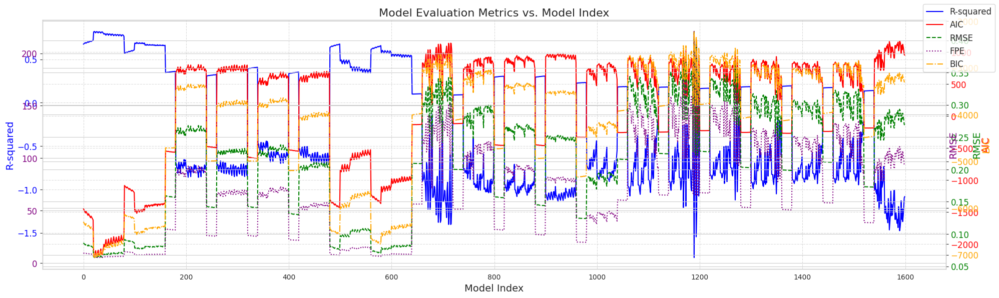

In [ ]:
#Plot for each player/game
fig, ax1 = plt.subplots(figsize=(20, 6))
X_axis = np.arange(len(final_results_df)) #results_df['Model_Index']

#For R-square Error
ax1.plot(X_axis, final_results_df['Rsq'], color='blue', label='R-squared')
ax1.set_xlabel('Model Index', fontsize=14)  # Increased font size
ax1.set_ylabel('R-squared', color='blue', fontsize=14)  # Increased font size
ax1.tick_params(axis='y', labelcolor='blue', labelsize=12)  # Increased tick label size

#For AIC
ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
ax2.plot(X_axis, final_results_df['AIC'], color='red', label='AIC')
ax2.set_ylabel('AIC', color='red', fontsize=14)  # Increased font size
ax2.tick_params(axis='y', labelcolor='red', labelsize=12)  # Increased tick label size

#For RMSE
ax3 = ax1.twinx()
ax3.plot(X_axis, final_results_df['RMSE'], color='green', label='RMSE', linestyle='--')
ax3.set_ylabel('RMSE', color='green', fontsize=14)
ax3.tick_params(axis='y', labelcolor='green', labelsize=12)

#For FPE
ax4 = ax1.twinx()
ax4.plot(X_axis, final_results_df['FPE'], color='purple', label='FPE', linestyle=':')
ax4.set_ylabel('RMSE', color='purple', fontsize=14)
ax4.tick_params(axis='y', labelcolor='purple', labelsize=12)

#For BIC
ax5 = ax4.twinx()
ax5.plot(X_axis, final_results_df['BIC'], color='orange', label='BIC', linestyle='-.')
ax5.set_ylabel('BIC', color='orange', fontsize=14)
ax5.tick_params(axis='y', labelcolor='orange', labelsize=12)

# General graphic configs
fig.legend(loc="upper right", fontsize=12)  # Add a legend for both plots, increased font size
ax1.grid(True, linestyle='--', alpha=0.7)  # Added grid with dashed lines and transparency
ax2.grid(True, linestyle='--', alpha=0.7)  # Added grid with dashed lines and transparency
plt.title('Model Evaluation Metrics vs. Model Index', fontsize=16)  # Added title with increased font size
plt.tight_layout()  # Adjust layout to prevent overlapping elements
plt.show()

In [ ]:
final_results_df.sort_values(by='Rsq', ascending=False)

,Athlete_Code,Model_Index,na,nb,d,AIC,Rsq,RMSE,BIC,FPE,Parameters_a,Parameters_b
22,Unknown,22,1,1,2,-2210.868721,0.822062,0.063536,-7057.957893,5.195439,[0.9885461046149534],[0.005228353666433904]
26,Unknown,26,1,2,1,-2195.049662,0.820135,0.063879,-7036.981877,5.259894,[0.9885461046148104],"[-0.0003678499999680653, 0.0055962036664203236]"
21,Unknown,21,1,1,1,-2195.185670,0.819633,0.064110,-7040.374873,5.293839,[0.9887981709601034],[0.005115382036030049]
30,Unknown,30,1,3,0,-2180.303551,0.818339,0.064197,-7017.078810,5.320697,[0.9885461046149548],"[1.2282245727513205e-13, -0.000367850000048876..."
27,Unknown,27,1,2,2,-2180.369934,0.818307,0.064060,-7024.238691,5.285596,[0.9890008303292618],"[0.01490780395549192, -0.00988324295421771]"
...,...,...,...,...,...,...,...,...,...,...,...,...
1590,WT,70,3,3,0,1156.478971,-1.440087,0.291260,-3122.319916,109.862662,"[0.49576752936259144, 0.31890359997409906, 0.1...","[-4.076691044011075e-14, -0.01225099999995617,..."
1569,WT,49,2,2,4,1163.733237,-1.466787,0.292733,-3116.330457,110.373938,"[0.5756215880985193, 0.4241710016557081]","[-0.013663888005476316, 0.013696130532457943]"
1589,WT,69,3,2,4,1170.597886,-1.476180,0.293289,-3104.311192,110.967466,"[0.4986421086077074, 0.3209009321374756, 0.180...","[-0.010618242793636292, 0.010626328510675322]"
1193,M_343,73,3,3,3,1208.238062,-1.546095,0.395535,-2331.515880,202.139163,"[1.2533174155003124, 0.30630611031324695, -0.5...","[0.003698190323694414, -0.02011725907657046, 0..."


In [ ]:
#Select Best Models
scaler = MinMaxScaler()
normalized_metrics = scaler.fit_transform(final_results_df[['AIC', 'Rsq', 'FPE', 'BIC', 'RMSE']])
# Create a new DataFrame with the normalized metrics
normalized_df = pd.DataFrame(normalized_metrics, columns=['AIC_norm', 'Rsq_norm', 'FPE_norm', 'BIC_norm', 'RMSE_norm'])
selection_df = pd.concat([final_results_df, normalized_df], axis=1)


best_models_df = pd.DataFrame()


num_models = na_max*nb_max*(xdelay_max+1)
cases = len(final_results_df)/(num_models) #12

#LOOP for each case (models)
for i in range(int(cases)):
  print("Case: ",i,"Start: ",(i*num_models),"End: ",(i+1)*num_models)
  #Select each dataset models data
  selected_df = selection_df[(i*num_models):(i+1)*num_models].copy()

  #Create a Ranking Selection
  selected_df['AIC_rank'] = selected_df['AIC'].rank()
  selected_df['BIC_rank'] = selected_df['BIC'].rank()

  # Rank by Rsq
  selected_df['Rsq_rank'] = selected_df['Rsq'].rank(ascending=False)  # Note: ascending=False for Rsq

  # Calculate the combined ranking
  selected_df['Ranking'] = selected_df['Rsq_rank'] + selected_df['AIC_rank']#+ selected_df['BIC_rank']
  best_df = selected_df.sort_values(by='Ranking', ascending=True).iloc[0]

  new_row = pd.DataFrame({'Athlete_Code': [best_df['Athlete_Code']],
                          'na': [best_df['na']],
                          'nb': [best_df['nb']],
                          'd': [best_df['d']],
                          'Ranking': [best_df['Ranking']],
                          'AIC_rank': [best_df['AIC_rank']],
                          'Rsq_rank': [best_df['Rsq_rank']],
                          'BIC_rank': [best_df['BIC_rank']],
                          'Rsq': [best_df['Rsq']],
                          'AIC': [best_df['AIC']],
                          'BIC': [best_df['BIC']],
                          'FPE': [best_df['FPE']],
                          'Parameters_a':[parameters_a],
                          'Parameters_b':[parameters_b]})

  #Save new model
  best_models_df = pd.concat([best_models_df, new_row], ignore_index=True)

  #print(selected_df.sort_values(by='Rsq', ascending=False)[:3])
  #print(selected_df.sort_values(by='AIC', ascending=True)[:3])
  #print(selected_df.sort_values(by='FPE', ascending=True)[:3])

Case:  0 Start:  0 End:  80
Case:  1 Start:  80 End:  160
Case:  2 Start:  160 End:  240
Case:  3 Start:  240 End:  320
Case:  4 Start:  320 End:  400
Case:  5 Start:  400 End:  480
Case:  6 Start:  480 End:  560
Case:  7 Start:  560 End:  640
Case:  8 Start:  640 End:  720
Case:  9 Start:  720 End:  800
Case:  10 Start:  800 End:  880
Case:  11 Start:  880 End:  960
Case:  12 Start:  960 End:  1040
Case:  13 Start:  1040 End:  1120
Case:  14 Start:  1120 End:  1200
Case:  15 Start:  1200 End:  1280
Case:  16 Start:  1280 End:  1360
Case:  17 Start:  1360 End:  1440
Case:  18 Start:  1440 End:  1520
Case:  19 Start:  1520 End:  1600


In [ ]:
best_models_df

,Athlete_Code,na,nb,d,Ranking,AIC_rank,Rsq_rank,BIC_rank,Rsq,AIC,BIC,FPE,Parameters_a,Parameters_b
0,Unknown,1,1,2,2.0,1.0,1.0,1.0,0.822062,-2210.868721,-7057.957893,5.195439,"[0.49508172816276974, 0.3265917145436552, 0.17...","[-0.010635298502905966, 0.041894397379876165, ..."
1,Unknown,1,1,4,2.0,1.0,1.0,1.0,0.695501,-1519.223095,-6564.970750,7.556950,"[0.49508172816276974, 0.3265917145436552, 0.17...","[-0.010635298502905966, 0.041894397379876165, ..."
2,Unknown,0,4,3,3.0,1.0,2.0,18.0,0.361257,-565.316142,-4711.682404,31.621447,"[0.49508172816276974, 0.3265917145436552, 0.17...","[-0.010635298502905966, 0.041894397379876165, ..."
3,Unknown,0,4,4,2.0,1.0,1.0,19.0,0.325140,-494.573062,-4989.736404,25.345244,"[0.49508172816276974, 0.3265917145436552, 0.17...","[-0.010635298502905966, 0.041894397379876165, ..."
4,Unknown,0,4,4,2.0,1.0,1.0,8.0,0.408826,-663.774673,-4995.896476,25.223371,"[0.49508172816276974, 0.3265917145436552, 0.17...","[-0.010635298502905966, 0.041894397379876165, ..."
5,Unknown,0,4,4,2.0,1.0,1.0,17.0,0.353752,-549.939750,-5195.241456,21.580476,"[0.49508172816276974, 0.3265917145436552, 0.17...","[-0.010635298502905966, 0.041894397379876165, ..."
6,M_334,0,4,4,2.0,1.0,1.0,1.0,0.677854,-1439.656202,-6566.444375,7.380639,"[0.49508172816276974, 0.3265917145436552, 0.17...","[-0.010635298502905966, 0.041894397379876165, ..."
7,M_334,0,4,4,2.0,1.0,1.0,1.0,0.659142,-1367.498933,-6774.298822,6.272781,"[0.49508172816276974, 0.3265917145436552, 0.17...","[-0.010635298502905966, 0.041894397379876165, ..."
8,M_334,0,2,4,15.0,4.0,11.0,12.0,0.102125,-133.886654,-3990.837546,56.188912,"[0.49508172816276974, 0.3265917145436552, 0.17...","[-0.010635298502905966, 0.041894397379876165, ..."
9,M_334,0,3,2,17.0,12.0,5.0,13.0,0.091494,-116.916197,-4103.569212,51.414077,"[0.49508172816276974, 0.3265917145436552, 0.17...","[-0.010635298502905966, 0.041894397379876165, ..."



Model with 3 a parameters, 1 b parameters and 0 time delay
        y-1       y-2       y-3  u-0
0       NaN       NaN       NaN    0
1  0.000000       NaN       NaN    1
2  0.000000  0.000000       NaN    1
3 -0.000368  0.000000  0.000000    1
4  0.014544 -0.000368  0.000000    1
5  0.019120  0.014544 -0.000368    1
6  0.021911  0.019120  0.014544    1
7  0.032659  0.021911  0.019120    1
8  0.039653  0.032659  0.021911    1
9  0.040519  0.039653  0.032659    1
New X:
         y-1       y-2       y-3  u-0
6   0.021911  0.019120  0.014544    1
7   0.032659  0.021911  0.019120    1
8   0.039653  0.032659  0.021911    1
9   0.040519  0.039653  0.032659    1
10  0.054585  0.040519  0.039653    1

Model with 3 a parameters, 1 b parameters and 0 time delay
        y-1       y-2       y-3  u-0
0       NaN       NaN       NaN    0
1  0.000000       NaN       NaN    1
2  0.000000  0.000000       NaN    1
3  0.003944  0.000000  0.000000    1
4  0.003578  0.003944  0.000000    1
5 -0.000150  0.0

<ipython-input-73-2b11b15e1f60>:25: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  one_to_all = pd.concat([one_to_all, new_row], ignore_index=True)



New X:
         y-1       y-2       y-3  u-0
6   0.019258  0.017485  0.007497    1
7   0.033390  0.019258  0.017485    1
8   0.052389  0.033390  0.019258    1
9   0.061024  0.052389  0.033390    1
10  0.072202  0.061024  0.052389    1

Model with 3 a parameters, 1 b parameters and 0 time delay
        y-1       y-2       y-3  u-0
0       NaN       NaN       NaN    0
1  0.000000       NaN       NaN    1
2  0.000000  0.000000       NaN    1
3 -0.001548  0.000000  0.000000    1
4  0.008311 -0.001548  0.000000    1
5  0.008183  0.008311 -0.001548    1
6  0.006372  0.008183  0.008311    1
7  0.005526  0.006372  0.008183    1
8  0.008916  0.005526  0.006372    1
9  0.010513  0.008916  0.005526    1
New X:
         y-1       y-2       y-3  u-0
6   0.006372  0.008183  0.008311    1
7   0.005526  0.006372  0.008183    1
8   0.008916  0.005526  0.006372    1
9   0.010513  0.008916  0.005526    1
10  0.022212  0.010513  0.008916    1

Model with 3 a parameters, 1 b parameters and 0 time delay
  

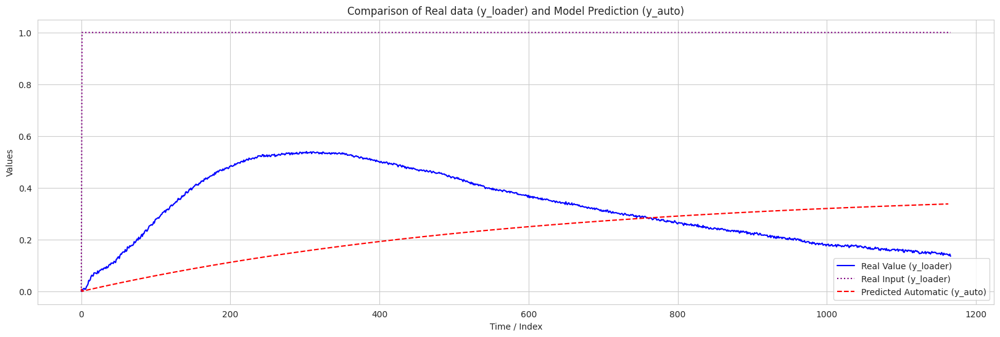


Model with 3 a parameters, 1 b parameters and 0 time delay
        y-1       y-2       y-3  u-0
0       NaN       NaN       NaN    0
1  0.000000       NaN       NaN    1
2  0.000000  0.000000       NaN    1
3 -0.004476  0.000000  0.000000    1
4  0.010440 -0.004476  0.000000    1
5  0.017157  0.010440 -0.004476    1
6  0.023259  0.017157  0.010440    1
7  0.040516  0.023259  0.017157    1
8  0.051815  0.040516  0.023259    1
9  0.047186  0.051815  0.040516    1
New X:
         y-1       y-2       y-3  u-0
6   0.023259  0.017157  0.010440    1
7   0.040516  0.023259  0.017157    1
8   0.051815  0.040516  0.023259    1
9   0.047186  0.051815  0.040516    1
10  0.065388  0.047186  0.051815    1

Model with 3 a parameters, 1 b parameters and 0 time delay
        y-1       y-2       y-3  u-0
0       NaN       NaN       NaN    0
1  0.000000       NaN       NaN    1
2  0.000000  0.000000       NaN    1
3 -0.009410  0.000000  0.000000    1
4 -0.003501 -0.009410  0.000000    1
5 -0.000800 -0.0

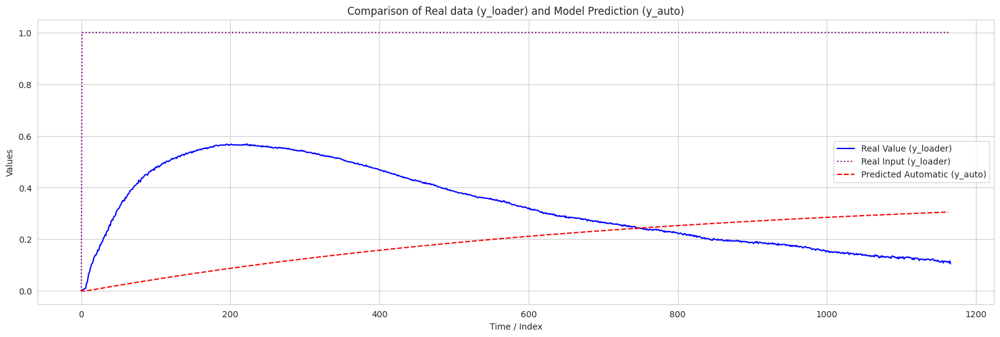


Model with 3 a parameters, 1 b parameters and 0 time delay
        y-1       y-2       y-3  u-0
0       NaN       NaN       NaN    0
1  0.000000       NaN       NaN    1
2  0.000000  0.000000       NaN    1
3  0.009951  0.000000  0.000000    1
4  0.008999  0.009951  0.000000    1
5  0.013841  0.008999  0.009951    1
6  0.028946  0.013841  0.008999    1
7  0.038738  0.028946  0.013841    1
8  0.049647  0.038738  0.028946    1
9  0.057205  0.049647  0.038738    1
New X:
         y-1       y-2       y-3  u-0
6   0.028946  0.013841  0.008999    1
7   0.038738  0.028946  0.013841    1
8   0.049647  0.038738  0.028946    1
9   0.057205  0.049647  0.038738    1
10  0.065903  0.057205  0.049647    1

Model with 3 a parameters, 1 b parameters and 0 time delay
        y-1       y-2       y-3  u-0
0       NaN       NaN       NaN    0
1  0.000000       NaN       NaN    1
2  0.000000  0.000000       NaN    1
3  0.002220  0.000000  0.000000    1
4  0.022985  0.002220  0.000000    1
5  0.037148  0.0

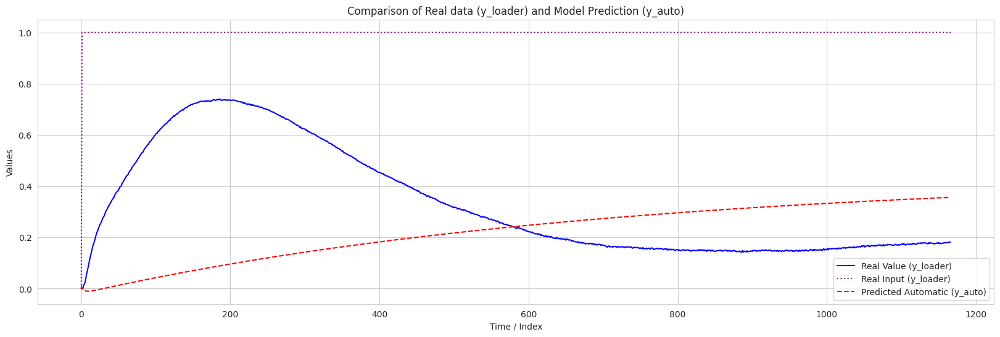


Model with 3 a parameters, 1 b parameters and 0 time delay
        y-1       y-2       y-3  u-0
0       NaN       NaN       NaN    0
1  0.000000       NaN       NaN    1
2  0.000000  0.000000       NaN    1
3 -0.001768  0.000000  0.000000    1
4  0.021867 -0.001768  0.000000    1
5  0.031156  0.021867 -0.001768    1
6  0.040319  0.031156  0.021867    1
7  0.079211  0.040319  0.031156    1
8  0.092941  0.079211  0.040319    1
9  0.104660  0.092941  0.079211    1
New X:
         y-1       y-2       y-3  u-0
6   0.040319  0.031156  0.021867    1
7   0.079211  0.040319  0.031156    1
8   0.092941  0.079211  0.040319    1
9   0.104660  0.092941  0.079211    1
10  0.116760  0.104660  0.092941    1

Model with 3 a parameters, 1 b parameters and 0 time delay
        y-1       y-2       y-3  u-0
0       NaN       NaN       NaN    0
1  0.000000       NaN       NaN    1
2  0.000000  0.000000       NaN    1
3 -0.012251  0.000000  0.000000    1
4  0.003183 -0.012251  0.000000    1
5  0.006595  0.0

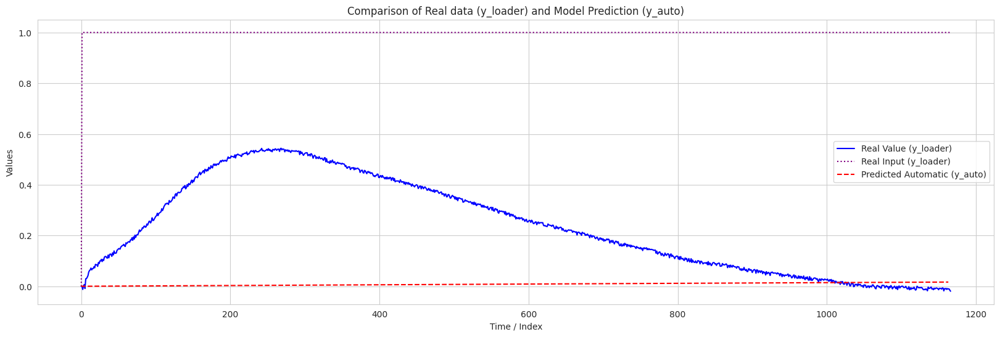

In [ ]:
#Select one model and applie to all the datasets
number_a=3
number_b=1
d=0
one_to_all = pd.DataFrame(columns=['Athlete_Code', 'na', 'nb', 'd','SSG','TC' ,'AIC', 'Rsq','RMSE','BIC','FPE'])
counter = nm_count = 0


for variation in all_datasets_df:
  nm_count += 1
  for i in range(0,len(variation.columns),2):
    input = variation.columns[i]
    output = variation.columns[i+1]
    data = pd.concat([variation[input].rename("u"), variation[output].rename("y")], axis=1)

    #print('\nModel #{} \nwith {} a parameters, {} b parameters and {} time delay'.format(model_count,number_a,number_b,d))
    #load the associated data using dataloader(data, na, nb, d)

    y_loader, y_auto, parameters_a, parameters_b, SSG, tau, r_squared, aic, Rmse, bic, fpe = model_generator(data, number_a, number_b, d)



    new_row = pd.DataFrame({'Athlete_Code': code_name[nm_count-1],'SSG':[SSG],'TC':[tau], 'Parameters_a':[parameters_a], 'Parameters_b':[parameters_b], 'na': [number_a], 'nb': [number_b], 'd': [d], 'AIC': [aic], 'Rsq': [r_squared],'RMSE':[Rmse], 'BIC':[bic],'FPE':[fpe]})

    one_to_all = pd.concat([one_to_all, new_row], ignore_index=True)



  print("its regression yield r squared: {}, Akaike's information criteria: {}".format(r_squared, aic))

  # Save relevant information to the empty lists
  #new_row = pd.DataFrame({'Athlete_Code': code_name[i],'Model_Index': [model_count], 'na': [na], 'nb': [nb], 'd': [d], 'AIC': [aic], 'Rsq': [r_squared],'RMSE':[Rmse], 'BIC':[bic],'FPE':[fpe]})
  #results_df = pd.concat([results_df, new_row], ignore_index=True)
        # Update the model counter
  model_count += 1


  #Plot
  #Ploting
  plt.figure(figsize=(20, 6))
  X_axis = np.arange(0,y_loader.shape[0])
  #print(X_axis)
  # Plot the actual values (y_loader)
  plt.plot(data['y'], label='Real Value (y_loader)', color='blue')
  plt.plot(data['u'], label='Real Input (y_loader)', color='purple', linestyle=':')
  # Plot the original data (y)    *AUTOMATIC
  plt.plot(X_axis, y_auto, label='Predicted Automatic (y_auto)', color='red', linestyle='--')

  # Add labels and title
  plt.xlabel('Time / Index')
  plt.ylabel('Values')
  plt.title('Comparison of Real data (y_loader) and Model Prediction (y_auto)')
  plt.legend()  # Add a legend
  plt.grid(True) # Add grid lines for better readability
  # Adjust the y-axis limits if necessary for better visualization
  #plt.ylim([50, 200])
  plt.show()


#Do the parameter estimates vary a lot between the subjects or between the volleyball matches?



In [ ]:
one_to_all

,Athlete_Code,na,nb,d,SSG,TC,AIC,Rsq,RMSE,BIC,FPE,Parameters_a,Parameters_b
0,M_334,3,1,0,0.460686,-1.174047,-424.433856,0.310306,0.073683,-6043.144218,6.363166,"[0.4266657460728376, 0.2743640705167456, 0.280...",[0.008490116948758984]
1,M_334,3,1,0,0.407063,-1.631587,-224.368884,0.180966,0.086141,-5679.474612,8.696816,"[0.5417772394860487, 0.3100215038027785, 0.138...",[0.003979702164813642]
2,M_334,3,1,0,0.477798,-2.926964,1199.370782,-1.782958,0.278127,-2950.846713,90.662061,"[0.7105962377499453, 0.2784683337872462, 0.008...",[0.0010301585833979163]
3,M_334,3,1,0,0.404963,-3.926595,1097.826151,-1.550468,0.238674,-3306.984758,66.764964,"[0.7751694948913765, 0.2649294376280026, -0.04...",[0.0006790786117531904]
4,M_334,3,1,0,0.460229,-1.887709,1171.369210,-1.716809,0.246593,-3230.998458,71.268810,"[0.5887564762421749, 0.3012892413552004, 0.106...",[0.001468988119589028]
5,M_334,3,1,0,0.393223,-2.034761,1072.667013,-1.495932,0.218202,-3515.758990,55.802527,"[0.6117337453244405, 0.31037288861758183, 0.07...",[0.0009648106243833237]
6,M_343,3,1,0,0.403069,-1.420626,670.195009,-0.766316,0.111793,-5072.660912,14.647571,"[0.4946450257142323, 0.27158326272693967, 0.21...",[0.00604524438088835]
7,M_343,3,1,0,0.358201,-1.623740,237.547127,-0.217994,0.085960,-5684.383394,8.660217,"[0.5401750227460569, 0.31228983139598343, 0.13...",[0.0044877837547688225]
8,M_343,3,1,0,2.900490,-1.814073,1013.240701,-1.371704,0.338569,-2493.052656,134.347918,"[0.576231575107055, 0.29867146323352545, 0.125...",[-6.383761038816644e-05]
9,M_343,3,1,0,4.535756,-1.500537,907.593427,-1.165923,0.309096,-2705.071187,111.976198,"[0.5135397178024488, 0.30770711141749274, 0.17...",[-5.775489211118037e-05]



Model with 1 a parameters, 2 b parameters and 0 time delay
    y-1       u-0       u-1
0   NaN  0.206667       NaN
1  20.0  0.207500  0.206667
2  20.0  0.190000  0.207500
3  20.0  0.180000  0.190000
4  19.5  0.154000  0.180000
5  19.5  0.132000  0.154000
6  20.0  0.112000  0.132000
7  20.5  0.114000  0.112000
8  21.0  0.100000  0.114000
9  20.5  0.092000  0.100000
New X:
    y-1    u-0    u-1
4  19.5  0.154  0.180
5  19.5  0.132  0.154
6  20.0  0.112  0.132
7  20.5  0.114  0.112
8  21.0  0.100  0.114
[   0    1    2 ... 7738 7739 7740]


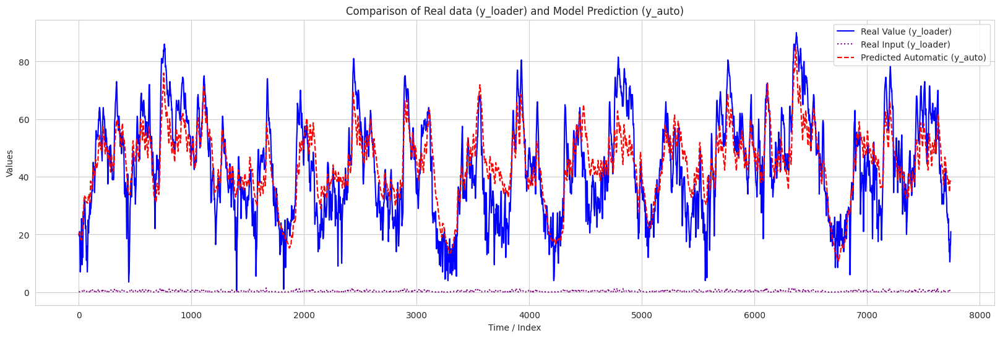

In [ ]:
#Simulation best model structure
number_a=1
number_b=2
d=0

data = athlete_list[2]
# print the relative dataframe and check its columns
y_loader, y_auto, parameters_a, parameters_b, SSG, tau, r_squared, aic, Rmse, bic, fpe = model_generator(data, number_a, number_b, d)


#Ploting
plt.figure(figsize=(20, 6))
X_axis = np.arange(0,y_loader.shape[0])
print(X_axis)
# Plot the actual values (y_loader)
plt.plot(data['y'], label='Real Value (y_loader)', color='blue')
plt.plot(data['u'], label='Real Input (y_loader)', color='purple', linestyle=':')
# Plot the original data (y)    *AUTOMATIC
plt.plot(X_axis, y_auto, label='Predicted Automatic (y_auto)', color='red', linestyle='--')

# Add labels and title
plt.xlabel('Time / Index')
plt.ylabel('Values')
plt.title('Comparison of Real data (y_loader) and Model Prediction (y_auto)')
plt.legend()  # Add a legend
plt.grid(True) # Add grid lines for better readability
# Adjust the y-axis limits if necessary for better visualization
#plt.ylim([50, 200])
plt.show()

In [ ]:
def dataloader(data, na, nb, d):

    # Initialize empty arrays for lagged features
    u = data['u']
    X = pd.DataFrame()
    y = data['y']


    # Create lagged features for input ('b' parameters)
    for i in range(0,nb):
        X['u-{}'.format(i + d)] = u.shift(i + d)
    # Create lagged features for output ('a' parameters)
    for i in range(1,na+1):
        X['y-{}'.format(i)] = y.shift(i)


    X = X.iloc[max(na,nb+d):]
    # Set the target values
    y = y[max(na,nb+d):]

    X.reset_index(drop=True, inplace=True)
    y.reset_index(drop=True, inplace=True)
    return X, y